In [2]:
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os

path = os.getcwd()
path

'/home/alexhang/project/Nuclear'

In [3]:
file_base_name = 'nuclear_burnup_data_20201215.csv'
file_input_name = 'df.csv'

pre_data_X = pd.read_csv(os.path.join(path, file_input_name), index_col=0)
pre_data_base = pd.read_csv(os.path.join(path, file_base_name))
pre_data_X

,kinf_1,kinf_2,kinf_3,kinf_4,kinf_5,kinf_6,kinf_7,kinf_8,kinf_9,kinf_10,...,NODE2DBU_95,NODE2DBU_96,NODE2DBU_97,NODE2DBU_98,NODE2DBU_99,NODE2DBU_100,NODE2DBU_101,NODE2DBU_102,NODE2DBU_103,NODE2DBU_104
0,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,0.0,0.0,36445.0,31803.0,36809.0,31836.0,20806.0,20806.0,20806.0,20806.0
1,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,0.0,0.0,36809.0,36445.0,31836.0,31803.0,20806.0,20806.0,20806.0,20806.0
2,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,0.0,0.0,31836.0,36809.0,31803.0,36445.0,20806.0,20806.0,20806.0,20806.0
3,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,0.0,0.0,31803.0,31836.0,36445.0,36809.0,20806.0,20806.0,20806.0,20806.0
4,1.16708,1.08099,1.18090,1.16216,1.4279,1.1821,1.08632,1.4279,1.1821,1.1821,...,0.0,0.0,26837.0,26864.0,26834.0,26862.0,22008.0,22008.0,22008.0,22008.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119995,1.15988,1.07458,1.09861,1.15534,1.4279,1.1821,1.07427,1.4279,1.1821,1.1821,...,0.0,0.0,26191.0,26191.0,26200.0,26200.0,36146.0,36146.0,36146.0,36146.0
119996,1.09092,1.08161,1.07427,1.07583,1.4279,1.1821,1.09178,1.4279,1.1821,1.1821,...,0.0,0.0,43151.0,45258.0,39658.0,43091.0,36186.0,36186.0,36186.0,36186.0
119997,1.09092,1.08161,1.07427,1.07583,1.4279,1.1821,1.09178,1.4279,1.1821,1.1821,...,0.0,0.0,43091.0,39658.0,45258.0,43151.0,36186.0,36186.0,36186.0,36186.0
119998,1.19730,1.15417,1.21509,1.20422,1.4279,1.1821,1.06296,1.4279,1.1821,1.1821,...,0.0,0.0,31803.0,31836.0,36445.0,36809.0,25238.0,25238.0,25238.0,25238.0


In [4]:
pre_data_base

,kinf,gd157,NODE2DBU,MaxAssBurnupCal,MaxPinBurnupCal
0,1.21509 1.16662 1.07459 1.21975 1.4279 1....,0.0000000 0.0000093 0.0000093 0.0000037 0 0 0....,22488 17604 23821 19746 24565 23770 24755 2448...,56624,62467.5
1,1.21509 1.16662 1.07459 1.21975 1.4279 1....,0.0000000 0.0000093 0.0000093 0.0000037 0 0 0....,23821 22488 19746 17604 24755 24565 24482 2377...,56812,61980.1
2,1.21509 1.16662 1.07459 1.21975 1.4279 1....,0.0000000 0.0000093 0.0000093 0.0000037 0 0 0....,19746 23821 17604 22488 24482 24755 23770 2456...,56724,62521.4
3,1.21509 1.16662 1.07459 1.21975 1.4279 1....,0.0000000 0.0000093 0.0000093 0.0000037 0 0 0....,17604 19746 22488 23821 23770 24482 24565 2475...,56537,62195.7
4,1.16708 1.08099 1.1809 1.16216 1.4279 1.1...,0.0000093 0.0000093 0.0000093 0.0000093 0 0 0....,24579 24391 24637 24672 33613 33447 38668 3901...,57424,64025.7
...,...,...,...,...,...
119995,1.15988 1.07458 1.09861 1.15534 1.4279 1....,0.0000093 0.0000000 0.0000093 0.0000093 0 0 0....,25859 25643 25905 25432 43835 42082 42090 3927...,57359,63599.1
119996,1.09092 1.08161 1.07427 1.07583 1.4279 1....,0.0000093 0.0000093 0.0000093 0.0000093 0 0 0....,36777 31834 38196 32995 33595 38691 33600 3870...,59562,64865.4
119997,1.09092 1.08161 1.07427 1.07583 1.4279 1....,0.0000093 0.0000093 0.0000093 0.0000093 0 0 0....,32995 38196 31834 36777 38700 33600 38691 3359...,59631,63716.2
119998,1.1973 1.15417 1.21509 1.20422 1.4279 1.1...,0.0000093 0.0000093 0.0000000 0.0000000 0 0 0....,19153 19125 19179 18922 26200 26200 26191 2619...,61714,65601.8


In [5]:
pre_data_y = pre_data_base.iloc[:,-2:]
pre_data_y

,MaxAssBurnupCal,MaxPinBurnupCal
0,56624,62467.5
1,56812,61980.1
2,56724,62521.4
3,56537,62195.7
4,57424,64025.7
...,...,...
119995,57359,63599.1
119996,59562,64865.4
119997,59631,63716.2
119998,61714,65601.8


In [6]:
pre_data = pd.concat([pre_data_X, pre_data_y], axis=1)
pre_data

,kinf_1,kinf_2,kinf_3,kinf_4,kinf_5,kinf_6,kinf_7,kinf_8,kinf_9,kinf_10,...,NODE2DBU_97,NODE2DBU_98,NODE2DBU_99,NODE2DBU_100,NODE2DBU_101,NODE2DBU_102,NODE2DBU_103,NODE2DBU_104,MaxAssBurnupCal,MaxPinBurnupCal
0,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,36445.0,31803.0,36809.0,31836.0,20806.0,20806.0,20806.0,20806.0,56624,62467.5
1,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,36809.0,36445.0,31836.0,31803.0,20806.0,20806.0,20806.0,20806.0,56812,61980.1
2,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,31836.0,36809.0,31803.0,36445.0,20806.0,20806.0,20806.0,20806.0,56724,62521.4
3,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,31803.0,31836.0,36445.0,36809.0,20806.0,20806.0,20806.0,20806.0,56537,62195.7
4,1.16708,1.08099,1.18090,1.16216,1.4279,1.1821,1.08632,1.4279,1.1821,1.1821,...,26837.0,26864.0,26834.0,26862.0,22008.0,22008.0,22008.0,22008.0,57424,64025.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119995,1.15988,1.07458,1.09861,1.15534,1.4279,1.1821,1.07427,1.4279,1.1821,1.1821,...,26191.0,26191.0,26200.0,26200.0,36146.0,36146.0,36146.0,36146.0,57359,63599.1
119996,1.09092,1.08161,1.07427,1.07583,1.4279,1.1821,1.09178,1.4279,1.1821,1.1821,...,43151.0,45258.0,39658.0,43091.0,36186.0,36186.0,36186.0,36186.0,59562,64865.4
119997,1.09092,1.08161,1.07427,1.07583,1.4279,1.1821,1.09178,1.4279,1.1821,1.1821,...,43091.0,39658.0,45258.0,43151.0,36186.0,36186.0,36186.0,36186.0,59631,63716.2
119998,1.19730,1.15417,1.21509,1.20422,1.4279,1.1821,1.06296,1.4279,1.1821,1.1821,...,31803.0,31836.0,36445.0,36809.0,25238.0,25238.0,25238.0,25238.0,61714,65601.8


In [7]:
pre_data.describe()

,kinf_1,kinf_2,kinf_3,kinf_4,kinf_5,kinf_6,kinf_7,kinf_8,kinf_9,kinf_10,...,NODE2DBU_97,NODE2DBU_98,NODE2DBU_99,NODE2DBU_100,NODE2DBU_101,NODE2DBU_102,NODE2DBU_103,NODE2DBU_104,MaxAssBurnupCal,MaxPinBurnupCal
count,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,...,120000.000000,120000.000000,120000.00000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000,120000.000000
mean,1.125305,1.133715,1.126235,1.125564,1.427902,1.182114,1.125511,1.427902,1.182114,1.182114,...,29672.874175,29672.876517,29672.99220,29672.979283,29770.748167,29770.748167,29770.748167,29770.748167,58096.474667,63173.228067
std,0.059822,0.057354,0.059747,0.059729,0.000004,0.000033,0.059973,0.000004,0.000033,0.000033,...,9202.246693,9202.339093,9202.36468,9202.447755,8883.510604,8883.510604,8883.510604,8883.510604,2785.030219,2276.981750
min,1.009510,1.014880,1.009510,1.009510,1.427900,1.182100,1.009510,1.427900,1.182100,1.182100,...,13750.000000,13750.000000,13750.00000,13750.000000,17247.000000,17247.000000,17247.000000,17247.000000,47369.000000,51308.300000
25%,1.074390,1.080210,1.074590,1.074590,1.427900,1.182100,1.074590,1.427900,1.182100,1.182100,...,23175.000000,23175.000000,23175.00000,23175.000000,23456.000000,23456.000000,23456.000000,23456.000000,56060.000000,61869.900000
50%,1.111220,1.159960,1.111220,1.111220,1.427900,1.182100,1.111220,1.427900,1.182100,1.182100,...,25637.000000,25637.000000,25637.00000,25637.000000,25238.000000,25238.000000,25238.000000,25238.000000,58195.000000,63339.400000
75%,1.171420,1.178340,1.171420,1.171420,1.427900,1.182100,1.171420,1.427900,1.182100,1.182100,...,38691.000000,38691.000000,38691.00000,38691.000000,36816.000000,36816.000000,36816.000000,36816.000000,60346.000000,64782.100000
max,1.232680,1.220510,1.232680,1.232680,1.427910,1.182190,1.232680,1.427910,1.182190,1.182190,...,49024.000000,49024.000000,49024.00000,49024.000000,48614.000000,48614.000000,48614.000000,48614.000000,65462.000000,69408.800000


In [8]:
y_cols = ['MaxAssBurnupCal', 'MaxPinBurnupCal']

ass_bin_range = np.linspace(46000, 66000, num=401).tolist()
pin_bin_range = np.linspace(50000, 70000, num=401).tolist()
print(len(ass_bin_range))
print(len(pin_bin_range))

bin_range_dict = {
    'MaxAssBurnupCal': ass_bin_range,
    'MaxPinBurnupCal': pin_bin_range
}

for col in y_cols:
    print(col)
    pre_data[col+'_range'] = pd.cut(
                                    np.array(pre_data[col]),
                                    bins = bin_range_dict[col]
                                    )
    pre_data[col+'_label'] = pd.cut(
                                    np.array(pre_data[col]),
                                    bins = bin_range_dict[col],
                                    labels = bin_range_dict[col][1:]
                                    ).astype(float)
pre_data

401
401
MaxAssBurnupCal
MaxPinBurnupCal


,kinf_1,kinf_2,kinf_3,kinf_4,kinf_5,kinf_6,kinf_7,kinf_8,kinf_9,kinf_10,...,NODE2DBU_101,NODE2DBU_102,NODE2DBU_103,NODE2DBU_104,MaxAssBurnupCal,MaxPinBurnupCal,MaxAssBurnupCal_range,MaxAssBurnupCal_label,MaxPinBurnupCal_range,MaxPinBurnupCal_label
0,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,20806.0,20806.0,20806.0,20806.0,56624,62467.5,"(56600.0, 56650.0]",56650.0,"(62450.0, 62500.0]",62500.0
1,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,20806.0,20806.0,20806.0,20806.0,56812,61980.1,"(56800.0, 56850.0]",56850.0,"(61950.0, 62000.0]",62000.0
2,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,20806.0,20806.0,20806.0,20806.0,56724,62521.4,"(56700.0, 56750.0]",56750.0,"(62500.0, 62550.0]",62550.0
3,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,20806.0,20806.0,20806.0,20806.0,56537,62195.7,"(56500.0, 56550.0]",56550.0,"(62150.0, 62200.0]",62200.0
4,1.16708,1.08099,1.18090,1.16216,1.4279,1.1821,1.08632,1.4279,1.1821,1.1821,...,22008.0,22008.0,22008.0,22008.0,57424,64025.7,"(57400.0, 57450.0]",57450.0,"(64000.0, 64050.0]",64050.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119995,1.15988,1.07458,1.09861,1.15534,1.4279,1.1821,1.07427,1.4279,1.1821,1.1821,...,36146.0,36146.0,36146.0,36146.0,57359,63599.1,"(57350.0, 57400.0]",57400.0,"(63550.0, 63600.0]",63600.0
119996,1.09092,1.08161,1.07427,1.07583,1.4279,1.1821,1.09178,1.4279,1.1821,1.1821,...,36186.0,36186.0,36186.0,36186.0,59562,64865.4,"(59550.0, 59600.0]",59600.0,"(64850.0, 64900.0]",64900.0
119997,1.09092,1.08161,1.07427,1.07583,1.4279,1.1821,1.09178,1.4279,1.1821,1.1821,...,36186.0,36186.0,36186.0,36186.0,59631,63716.2,"(59600.0, 59650.0]",59650.0,"(63700.0, 63750.0]",63750.0
119998,1.19730,1.15417,1.21509,1.20422,1.4279,1.1821,1.06296,1.4279,1.1821,1.1821,...,25238.0,25238.0,25238.0,25238.0,61714,65601.8,"(61700.0, 61750.0]",61750.0,"(65600.0, 65650.0]",65650.0


In [9]:
pre_data.dtypes

kinf_1                    float64
kinf_2                    float64
kinf_3                    float64
kinf_4                    float64
kinf_5                    float64
                           ...   
MaxPinBurnupCal           float64
MaxAssBurnupCal_range    category
MaxAssBurnupCal_label     float64
MaxPinBurnupCal_range    category
MaxPinBurnupCal_label     float64
Length: 162, dtype: object

In [10]:
effect_col_tmp = []
new_ass_list_tmp = []

for col in pre_data.columns:
    if pre_data[col].nunique()>1:
        effect_col_tmp.append(col)
    else:
        print(col)
        if 'NODE2DBU' in col:
            str_list = col.split('_')
            coner_num = int(str_list[1])
            ass_num = (coner_num-1)//4 + 1
            print(ass_num)
            new_ass_list_tmp.append(ass_num)
print(len(effect_col_tmp))
# effect_col

gd157_5
gd157_8
NODE2DBU_17
5
NODE2DBU_18
5
NODE2DBU_19
5
NODE2DBU_20
5
NODE2DBU_21
6
NODE2DBU_22
6
NODE2DBU_23
6
NODE2DBU_24
6
NODE2DBU_29
8
NODE2DBU_30
8
NODE2DBU_31
8
NODE2DBU_32
8
NODE2DBU_33
9
NODE2DBU_34
9
NODE2DBU_35
9
NODE2DBU_36
9
NODE2DBU_37
10
NODE2DBU_38
10
NODE2DBU_39
10
NODE2DBU_40
10
NODE2DBU_45
12
NODE2DBU_46
12
NODE2DBU_47
12
NODE2DBU_48
12
NODE2DBU_53
14
NODE2DBU_54
14
NODE2DBU_55
14
NODE2DBU_56
14
NODE2DBU_61
16
NODE2DBU_62
16
NODE2DBU_63
16
NODE2DBU_64
16
NODE2DBU_65
17
NODE2DBU_66
17
NODE2DBU_67
17
NODE2DBU_68
17
NODE2DBU_73
19
NODE2DBU_74
19
NODE2DBU_75
19
NODE2DBU_76
19
NODE2DBU_89
23
NODE2DBU_90
23
NODE2DBU_91
23
NODE2DBU_92
23
NODE2DBU_93
24
NODE2DBU_94
24
NODE2DBU_95
24
NODE2DBU_96
24
112


In [11]:
# 即四个角燃耗为唯一值 0，新组件
new_ass_list = list(set(new_ass_list_tmp))
new_ass_list

[5, 6, 8, 9, 10, 12, 14, 16, 17, 19, 23, 24]

In [12]:
# 删除kinf和gd157中的新棒

new_ass_cols = []
for n in new_ass_list:
    new_ass_cols.append('kinf_'+str(n))
    new_ass_cols.append('gd157_'+str(n))
    
new_ass_cols

['kinf_5',
 'gd157_5',
 'kinf_6',
 'gd157_6',
 'kinf_8',
 'gd157_8',
 'kinf_9',
 'gd157_9',
 'kinf_10',
 'gd157_10',
 'kinf_12',
 'gd157_12',
 'kinf_14',
 'gd157_14',
 'kinf_16',
 'gd157_16',
 'kinf_17',
 'gd157_17',
 'kinf_19',
 'gd157_19',
 'kinf_23',
 'gd157_23',
 'kinf_24',
 'gd157_24']

In [13]:
effect_col = list(set(effect_col_tmp).difference(new_ass_cols))
print(len(effect_col))
effect_col

90


['NODE2DBU_44',
 'kinf_20',
 'NODE2DBU_60',
 'NODE2DBU_7',
 'NODE2DBU_51',
 'NODE2DBU_27',
 'NODE2DBU_81',
 'kinf_22',
 'NODE2DBU_104',
 'gd157_7',
 'NODE2DBU_83',
 'NODE2DBU_77',
 'NODE2DBU_57',
 'NODE2DBU_4',
 'kinf_18',
 'NODE2DBU_50',
 'kinf_21',
 'NODE2DBU_26',
 'MaxPinBurnupCal',
 'NODE2DBU_12',
 'MaxAssBurnupCal',
 'MaxPinBurnupCal_label',
 'NODE2DBU_78',
 'NODE2DBU_42',
 'NODE2DBU_52',
 'NODE2DBU_15',
 'gd157_20',
 'kinf_7',
 'NODE2DBU_88',
 'gd157_11',
 'kinf_2',
 'NODE2DBU_2',
 'NODE2DBU_10',
 'gd157_3',
 'NODE2DBU_99',
 'NODE2DBU_28',
 'gd157_1',
 'NODE2DBU_1',
 'kinf_11',
 'kinf_4',
 'NODE2DBU_6',
 'kinf_26',
 'NODE2DBU_5',
 'kinf_15',
 'gd157_21',
 'NODE2DBU_86',
 'gd157_13',
 'NODE2DBU_82',
 'NODE2DBU_85',
 'NODE2DBU_11',
 'kinf_1',
 'NODE2DBU_8',
 'NODE2DBU_98',
 'NODE2DBU_25',
 'NODE2DBU_41',
 'MaxAssBurnupCal_range',
 'NODE2DBU_69',
 'NODE2DBU_3',
 'NODE2DBU_84',
 'gd157_2',
 'NODE2DBU_58',
 'kinf_13',
 'gd157_22',
 'NODE2DBU_59',
 'kinf_3',
 'NODE2DBU_103',
 'kinf_25'

In [14]:
for col in pre_data.columns:
    print('{} 特征值的数量为 {}'.format(col, pre_data[col].nunique()))

kinf_1 特征值的数量为 115
kinf_2 特征值的数量为 86
kinf_3 特征值的数量为 115
kinf_4 特征值的数量为 115
kinf_5 特征值的数量为 2
kinf_6 特征值的数量为 2
kinf_7 特征值的数量为 115
kinf_8 特征值的数量为 2
kinf_9 特征值的数量为 2
kinf_10 特征值的数量为 2
kinf_11 特征值的数量为 86
kinf_12 特征值的数量为 2
kinf_13 特征值的数量为 115
kinf_14 特征值的数量为 2
kinf_15 特征值的数量为 115
kinf_16 特征值的数量为 2
kinf_17 特征值的数量为 2
kinf_18 特征值的数量为 115
kinf_19 特征值的数量为 2
kinf_20 特征值的数量为 86
kinf_21 特征值的数量为 86
kinf_22 特征值的数量为 115
kinf_23 特征值的数量为 2
kinf_24 特征值的数量为 2
kinf_25 特征值的数量为 86
kinf_26 特征值的数量为 86
gd157_1 特征值的数量为 4
gd157_2 特征值的数量为 4
gd157_3 特征值的数量为 4
gd157_4 特征值的数量为 4
gd157_5 特征值的数量为 1
gd157_6 特征值的数量为 2
gd157_7 特征值的数量为 4
gd157_8 特征值的数量为 1
gd157_9 特征值的数量为 2
gd157_10 特征值的数量为 2
gd157_11 特征值的数量为 4
gd157_12 特征值的数量为 2
gd157_13 特征值的数量为 4
gd157_14 特征值的数量为 2
gd157_15 特征值的数量为 4
gd157_16 特征值的数量为 2
gd157_17 特征值的数量为 2
gd157_18 特征值的数量为 4
gd157_19 特征值的数量为 2
gd157_20 特征值的数量为 4
gd157_21 特征值的数量为 4
gd157_22 特征值的数量为 4
gd157_23 特征值的数量为 2
gd157_24 特征值的数量为 2
gd157_25 特征值的数量为 4
gd157_26 特征值的数量为 4
NODE2DBU_1 特征值的数量为 495
NODE2DBU_2 

In [15]:
epsilon = 1e-5
# 组合特征
func_dict = {
    'add': lambda x,y: x+y,
    'mins': lambda x,y: x-y,
    'div': lambda x,y: x/(y+epsilon),
    'multi': lambda x,y: x*y
}

def auto_feat(pre_data, func_dict, cols):
    data = pre_data.copy()
    new_data = pd.DataFrame()
    for col_i in cols:
        print(col_i)
        for col_j in cols:
            for func_name, func in func_dict.items():
                func_feat = func(data[col_i], data[col_j])
                feat_name = '-'.join([col_i, func_name, col_j])
                new_data[feat_name] = func_feat
                
    return new_data

In [16]:
kinfs_cols = [c for c in pre_data.columns if 'kinf' in c]
gd157_cols = [c for c in pre_data.columns if 'gd157' in c]
print(kinfs_cols)
print(gd157_cols)

['kinf_1', 'kinf_2', 'kinf_3', 'kinf_4', 'kinf_5', 'kinf_6', 'kinf_7', 'kinf_8', 'kinf_9', 'kinf_10', 'kinf_11', 'kinf_12', 'kinf_13', 'kinf_14', 'kinf_15', 'kinf_16', 'kinf_17', 'kinf_18', 'kinf_19', 'kinf_20', 'kinf_21', 'kinf_22', 'kinf_23', 'kinf_24', 'kinf_25', 'kinf_26']
['gd157_1', 'gd157_2', 'gd157_3', 'gd157_4', 'gd157_5', 'gd157_6', 'gd157_7', 'gd157_8', 'gd157_9', 'gd157_10', 'gd157_11', 'gd157_12', 'gd157_13', 'gd157_14', 'gd157_15', 'gd157_16', 'gd157_17', 'gd157_18', 'gd157_19', 'gd157_20', 'gd157_21', 'gd157_22', 'gd157_23', 'gd157_24', 'gd157_25', 'gd157_26']


In [17]:

# combination_data = auto_feat(pre_data, func_dict, kinfs_cols+gd157_cols)
# combination_data


In [18]:
from sklearn.decomposition import PCA

# pca = PCA(n_components=200)
# combination_data_pca = pca.fit_transform(combination_data)
# combination_data_pca = pd.DataFrame(combination_data_pca)
# combination_data_pca

In [19]:
# pca.explained_variance_ratio_

In [20]:
# all_data = pd.concat([pre_data, combination_data_pca], axis=1)
# all_data

In [24]:
# from tqdm import tqdm

def extract_feat(data, str_filter, cols):
    
    new_data = pd.DataFrame()
    
    for index,row in tqdm(data.iterrows(), total=len(data)):
        
        col_name = str_filter + '_median'
        new_data.loc[index, col_name] = row[cols].median()
        
        col_name = str_filter + '_mean'
        new_data.loc[index, col_name] = row[cols].mean()
        
        col_name = str_filter + '_max'
        new_data.loc[index, col_name] = row[cols].max()
        
        col_name = str_filter + '_min'
        new_data.loc[index, col_name] = row[cols].min()
        
        col_name = str_filter + '_delta'
        new_data.loc[index, col_name] = row[cols].max() - row[cols].min()
        
        col_name = str_filter + '__max_mean_delta'
        new_data.loc[index, col_name] = row[cols].max() - row[cols].mean()
        
        col_name = str_filter + '__min_mean_delta'
        new_data.loc[index, col_name] = row[cols].min() - row[cols].mean()
        
        col_name = str_filter + '_skew'
        new_data.loc[index, col_name] = row[cols].skew()
        
        col_name = str_filter + '_sum'
        new_data.loc[index, col_name] = row[cols].sum()
        
        col_name = str_filter + '_mad'
        new_data.loc[index, col_name] = row[cols].mad()
        
    return new_data

node_cols = [c for c in pre_data.columns if 'NODE2DBU' in c]

# kinf_extract_data = extract_feat(pre_data, 'kinf', kinfs_cols)
# gd157_extract_data = extract_feat(pre_data, 'gd157', gd157_cols)
# node_extract_data = extract_feat(pre_data, 'NODE2DBU', node_cols)
# kinf_extract_data   
        

In [25]:
# all_data = pd.concat([all_data, kinf_extract_data, gd157_extract_data, node_extract_data], axis=1)
# all_data

In [26]:
all_data = pd.read_csv('nuclear_fuel_all_data_20210114.csv', index_col=0)
all_data

,kinf_1,kinf_2,kinf_3,kinf_4,kinf_5,kinf_6,kinf_7,kinf_8,kinf_9,kinf_10,...,NODE2DBU_median,NODE2DBU_mean,NODE2DBU_max,NODE2DBU_min,NODE2DBU_delta,NODE2DBU__max_mean_delta,NODE2DBU__min_mean_delta,NODE2DBU_skew,NODE2DBU_sum,NODE2DBU_mad
0,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,19091.5,16127.201923,40227.0,0.0,40227.0,24099.798077,-16127.201923,0.140032,1677229.0,NaN
1,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,19091.5,16127.201923,40227.0,0.0,40227.0,24099.798077,-16127.201923,0.140032,1677229.0,NaN
2,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,19091.5,16127.201923,40227.0,0.0,40227.0,24099.798077,-16127.201923,0.140032,1677229.0,NaN
3,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,19091.5,16127.201923,40227.0,0.0,40227.0,24099.798077,-16127.201923,0.140032,1677229.0,NaN
4,1.16708,1.08099,1.18090,1.16216,1.4279,1.1821,1.08632,1.4279,1.1821,1.1821,...,19505.5,14476.990385,40983.0,0.0,40983.0,26506.009615,-14476.990385,0.155086,1505607.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119995,1.15988,1.07458,1.09861,1.15534,1.4279,1.1821,1.07427,1.4279,1.1821,1.1821,...,24091.5,16805.567308,43835.0,0.0,43835.0,27029.432692,-16805.567308,0.096147,1747779.0,NaN
119996,1.09092,1.08161,1.07427,1.07583,1.4279,1.1821,1.09178,1.4279,1.1821,1.1821,...,22377.0,18048.567308,45383.0,0.0,45383.0,27334.432692,-18048.567308,0.082051,1877051.0,NaN
119997,1.09092,1.08161,1.07427,1.07583,1.4279,1.1821,1.09178,1.4279,1.1821,1.1821,...,22377.0,18048.567308,45383.0,0.0,45383.0,27334.432692,-18048.567308,0.082051,1877051.0,NaN
119998,1.19730,1.15417,1.21509,1.20422,1.4279,1.1821,1.06296,1.4279,1.1821,1.1821,...,19139.0,15602.509615,45383.0,0.0,45383.0,29780.490385,-15602.509615,0.345835,1622661.0,NaN


In [82]:
effect_col_all_data = []

for col in all_data.columns:
    if all_data[col].nunique()>1:
        effect_col_all_data.append(col)

print(len(effect_col_all_data))

337


In [33]:
corrmat = all_data.corr(method='spearman')
df_corrmat = pd.DataFrame(corrmat.copy())
df_corrmat

,kinf_1,kinf_2,kinf_3,kinf_4,kinf_5,kinf_6,kinf_7,kinf_8,kinf_9,kinf_10,...,NODE2DBU_median,NODE2DBU_mean,NODE2DBU_max,NODE2DBU_min,NODE2DBU_delta,NODE2DBU__max_mean_delta,NODE2DBU__min_mean_delta,NODE2DBU_skew,NODE2DBU_sum,NODE2DBU_mad
kinf_1,1.000000,0.358887,0.349550,0.345190,-0.188469,-0.188469,0.352264,-0.188469,-0.188469,-0.188469,...,-0.500528,-0.575212,-0.524203,NaN,-0.524203,0.157240,0.575212,0.364639,-0.575212,NaN
kinf_2,0.358887,1.000000,0.353298,0.353248,-0.184420,-0.184420,0.357729,-0.184420,-0.184420,-0.184420,...,-0.524209,-0.567230,-0.518536,NaN,-0.518536,0.145171,0.567230,0.368758,-0.567230,NaN
kinf_3,0.349550,0.353298,1.000000,0.342342,-0.183515,-0.183515,0.352469,-0.183515,-0.183515,-0.183515,...,-0.507816,-0.573273,-0.524835,NaN,-0.524835,0.149065,0.573273,0.367557,-0.573273,NaN
kinf_4,0.345190,0.353248,0.342342,1.000000,-0.177098,-0.177098,0.346949,-0.177098,-0.177098,-0.177098,...,-0.502541,-0.572170,-0.525410,NaN,-0.525410,0.141644,0.572170,0.355687,-0.572170,NaN
kinf_5,-0.188469,-0.184420,-0.183515,-0.177098,1.000000,1.000000,-0.182470,1.000000,1.000000,1.000000,...,0.090937,0.085202,0.077860,NaN,0.077860,-0.463813,-0.085202,-0.457715,0.085202,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NODE2DBU__max_mean_delta,0.157240,0.145171,0.149065,0.141644,-0.463813,-0.463813,0.144805,-0.463813,-0.463813,-0.463813,...,-0.144636,-0.031255,0.307507,NaN,0.307507,1.000000,0.031255,0.728261,-0.031255,NaN
NODE2DBU__min_mean_delta,0.575212,0.567230,0.573273,0.572170,-0.085202,-0.085202,0.579836,-0.085202,-0.085202,-0.085202,...,-0.799349,-1.000000,-0.864746,NaN,-0.864746,0.031255,1.000000,0.381078,-1.000000,NaN
NODE2DBU_skew,0.364639,0.368758,0.367557,0.355687,-0.457715,-0.457715,0.365528,-0.457715,-0.457715,-0.457715,...,-0.570452,-0.381078,-0.155529,NaN,-0.155529,0.728261,0.381078,1.000000,-0.381078,NaN
NODE2DBU_sum,-0.575212,-0.567230,-0.573273,-0.572170,0.085202,0.085202,-0.579836,0.085202,0.085202,0.085202,...,0.799349,1.000000,0.864746,NaN,0.864746,-0.031255,-1.000000,-0.381078,1.000000,NaN


In [35]:
df_corrmat_ass = df_corrmat.sort_values(by=['MaxAssBurnupCal'])
df_corrmat_pin = df_corrmat.sort_values(by=['MaxPinBurnupCal'])
df_corrmat_pin['MaxPinBurnupCal'].head(30)

kinf_min                   -0.642853
kinf_skew                  -0.641934
NODE2DBU__min_mean_delta   -0.594977
kinf_mean                  -0.566506
kinf_sum                   -0.566497
kinf_11                    -0.447809
kinf_15                    -0.434485
kinf_median                -0.430334
gd157_sum                  -0.381680
gd157_mean                 -0.381481
kinf_20                    -0.373737
kinf__min_mean_delta       -0.348629
gd157_23                   -0.336855
gd157_10                   -0.336855
gd157_12                   -0.336855
gd157_14                   -0.336855
gd157_16                   -0.336855
gd157_17                   -0.336855
gd157_19                   -0.336855
gd157_6                    -0.336855
gd157_24                   -0.336855
gd157_9                    -0.336855
gd157_median               -0.331083
kinf_13                    -0.329823
kinf_3                     -0.307631
kinf_26                    -0.306469
kinf_18                    -0.305862
k

In [36]:
df_corrmat_pin['MaxAssBurnupCal'].head(30)

kinf_min                   -0.713479
kinf_skew                  -0.709889
NODE2DBU__min_mean_delta   -0.679956
kinf_mean                  -0.649284
kinf_sum                   -0.649289
kinf_11                    -0.519159
kinf_15                    -0.461387
kinf_median                -0.509114
gd157_sum                  -0.392040
gd157_mean                 -0.391912
kinf_20                    -0.454337
kinf__min_mean_delta       -0.358381
gd157_23                   -0.343532
gd157_10                   -0.343532
gd157_12                   -0.343532
gd157_14                   -0.343532
gd157_16                   -0.343532
gd157_17                   -0.343532
gd157_19                   -0.343532
gd157_6                    -0.343532
gd157_24                   -0.343532
gd157_9                    -0.343532
gd157_median               -0.337726
kinf_13                    -0.386814
kinf_3                     -0.368104
kinf_26                    -0.361812
kinf_18                    -0.363476
k

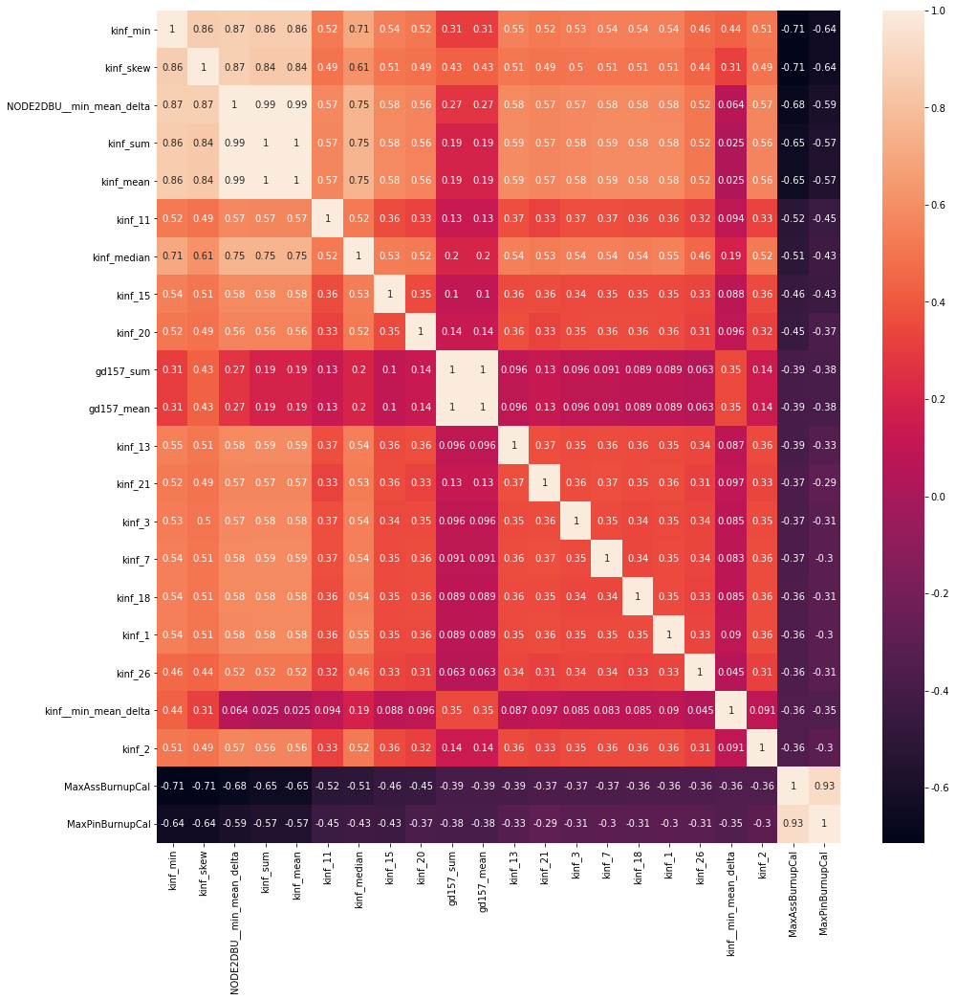

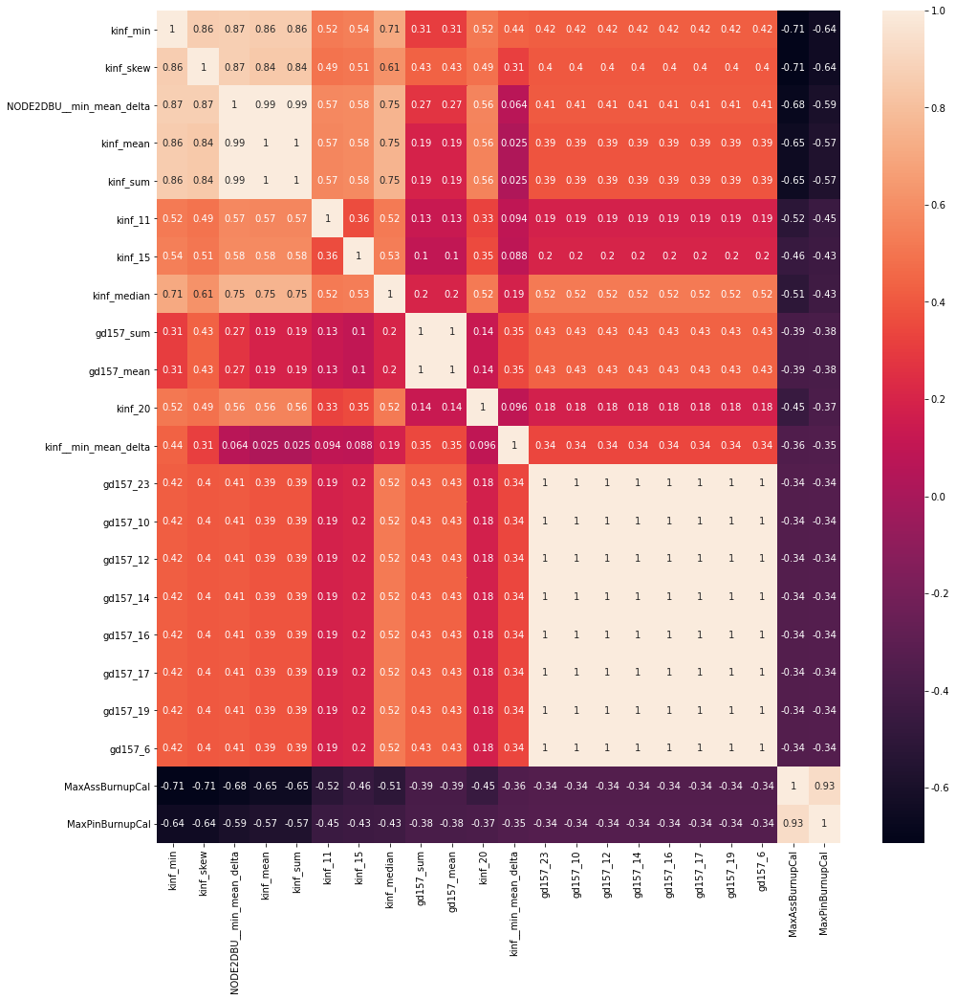

In [37]:
import matplotlib
matplotlib.rcParams['axes.unicode_minus']=False

for y_col in ['MaxAssBurnupCal', 'MaxPinBurnupCal']:
    
    imp_num = 20
    df_corr = df_corrmat.sort_values(by=y_col)
    cols = df_corr.head(imp_num).index.to_list() + ['MaxAssBurnupCal', 'MaxPinBurnupCal']
    plt.figure(figsize=(16,16))
    sns.heatmap(df_corr.loc[cols,cols], annot=True)
    plt.show()



In [38]:
def plt_error(y_pred, y_test, column):
        plt.figure(figsize=(16,9))
        plt.errorbar(np.arange(len(y_pred)), y_pred, yerr = 10)
        plt.errorbar(np.arange(len(y_test)), y_test, yerr = 10)
        plt.xlabel('Serial No.')
        plt.ylabel(column)
        plt.legend(['Predict', 'True'])
        plt.show()
        plt.figure(figsize=(16,9))
        plt.scatter(np.arange(len(y_test)), (y_pred-np.array(y_test)))
        plt.xlabel('Serial No.')
        plt.ylabel(column+' error')
        plt.show()

In [114]:
feat_dic = {
    
#     'MaxAssBurnupCal': list(set(df_corrmat_ass.head(30).index.tolist()).difference(new_ass_cols)),
#     'MaxAssBurnupCal_label': df_corrmat_ass.head(30).index.tolist() + combination_data_pca.columns.to_list(),
    'MaxAssBurnupCal_label': df_corrmat_ass.head(70).index.tolist(),
    'MaxPinBurnupCal_label': df_corrmat_pin.head(70).index.tolist()

#     'MaxAssBurnupCal_label': [c for c in effect_col_all_data if c not in ['MaxAssBurnupCal', 'MaxAssBurnupCal_range', 
#                                                            'MaxAssBurnupCal_label', 'MaxPinBurnupCal',
#                                                            'MaxPinBurnupCal_range',  'MaxPinBurnupCal_label']],
#     'MaxPinBurnupCal_label': [c for c in effect_col_all_data if c not in ['MaxAssBurnupCal', 'MaxAssBurnupCal_range', 
#                                                            'MaxAssBurnupCal_label', 'MaxPinBurnupCal',
#                                                            'MaxPinBurnupCal_range',  'MaxPinBurnupCal_label']]
    
#     'MaxPinBurnupCal_label': [c for c in effect_col_tmp if c not in ['MaxAssBurnupCal', 'MaxAssBurnupCal_range', 
#                                                            'MaxAssBurnupCal_label', 'MaxPinBurnupCal',
#                                                            'MaxPinBurnupCal_range',  'MaxPinBurnupCal_label']] \
#                                                             + kinf_extract_data.columns.to_list() \
#                                                             + gd157_extract_data.columns.to_list() \
#                                                             + node_extract_data.columns.to_list()
    
}
print(len(feat_dic['MaxAssBurnupCal_label']))
print(len(feat_dic['MaxPinBurnupCal_label']))
feat_dic['MaxAssBurnupCal_label']

70
70


['kinf_min',
 'kinf_skew',
 'NODE2DBU__min_mean_delta',
 'kinf_sum',
 'kinf_mean',
 'kinf_11',
 'kinf_median',
 'kinf_15',
 'kinf_20',
 'gd157_sum',
 'gd157_mean',
 'kinf_13',
 'kinf_21',
 'kinf_3',
 'kinf_7',
 'kinf_18',
 'kinf_1',
 'kinf_26',
 'kinf__min_mean_delta',
 'kinf_2',
 'kinf_4',
 'kinf_25',
 'gd157_24',
 'gd157_17',
 'gd157_12',
 'gd157_10',
 'gd157_9',
 'gd157_19',
 'gd157_6',
 'gd157_16',
 'gd157_23',
 'gd157_14',
 'gd157_median',
 'kinf_22',
 'gd157_11',
 '43',
 'gd157_20',
 'gd157_26',
 '42',
 'gd157_21',
 'gd157_25',
 '145',
 '19',
 'gd157_2',
 'gd157_15',
 '29',
 'gd157_22',
 'gd157_18',
 '37',
 '44',
 '25',
 '40',
 '154',
 '152',
 '62',
 '41',
 '3',
 '54',
 '161',
 '50',
 '31',
 'gd157_13',
 '13',
 '71',
 '149',
 '32',
 '66',
 '16',
 '5',
 '51']

In [84]:
feat_dic['MaxPinBurnupCal_label']

['kinf_1',
 'kinf_2',
 'kinf_3',
 'kinf_4',
 'kinf_5',
 'kinf_6',
 'kinf_7',
 'kinf_8',
 'kinf_9',
 'kinf_10',
 'kinf_11',
 'kinf_12',
 'kinf_13',
 'kinf_14',
 'kinf_15',
 'kinf_16',
 'kinf_17',
 'kinf_18',
 'kinf_19',
 'kinf_20',
 'kinf_21',
 'kinf_22',
 'kinf_23',
 'kinf_24',
 'kinf_25',
 'kinf_26',
 'gd157_1',
 'gd157_2',
 'gd157_3',
 'gd157_4',
 'gd157_6',
 'gd157_7',
 'gd157_9',
 'gd157_10',
 'gd157_11',
 'gd157_12',
 'gd157_13',
 'gd157_14',
 'gd157_15',
 'gd157_16',
 'gd157_17',
 'gd157_18',
 'gd157_19',
 'gd157_20',
 'gd157_21',
 'gd157_22',
 'gd157_23',
 'gd157_24',
 'gd157_25',
 'gd157_26',
 'NODE2DBU_1',
 'NODE2DBU_2',
 'NODE2DBU_3',
 'NODE2DBU_4',
 'NODE2DBU_5',
 'NODE2DBU_6',
 'NODE2DBU_7',
 'NODE2DBU_8',
 'NODE2DBU_9',
 'NODE2DBU_10',
 'NODE2DBU_11',
 'NODE2DBU_12',
 'NODE2DBU_13',
 'NODE2DBU_14',
 'NODE2DBU_15',
 'NODE2DBU_16',
 'NODE2DBU_25',
 'NODE2DBU_26',
 'NODE2DBU_27',
 'NODE2DBU_28',
 'NODE2DBU_41',
 'NODE2DBU_42',
 'NODE2DBU_43',
 'NODE2DBU_44',
 'NODE2DBU_49',
 

In [139]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import KFold, cross_val_score, train_test_split
import lightgbm as lgb

input_col = [c for c in all_data.columns if c not in ['MaxAssBurnupCal', 'MaxAssBurnupCal_range', 
                                                           'MaxAssBurnupCal_label', 'MaxPinBurnupCal',
                                                           'MaxPinBurnupCal_range',  'MaxPinBurnupCal_label']]
# # input_col = df_corrmat_pin.head(30).index.tolist()
output_col = ['MaxAssBurnupCal_label', 'MaxPinBurnupCal_label']

K = 5
seed = 2020

X_pre_train, X_test, y_pre_train, y_test = train_test_split(all_data[input_col], all_data[output_col], 
                                                           random_state=seed, train_size=0.9, 
                                                           test_size=0.1)

skf = KFold(n_splits=K, shuffle=True, random_state=seed)
lgb_params = {
                'boosting_type': 'gbdt',
                'objective': 'regression',
                'num_leaves': 2**11-1,
#                 'min_data_in_leaf': 15,
                'subsample': 0.9,
                'learning_rate': 0.1,
                'seed': 2020,
                'metric': 'mae',
#                 'lambda_l1': 2.8,
                'nthread': -1
             }

In [140]:


def model_predict(X_train, y_train, X_test, burnup, df_feat_imp, train_pred, test_pred):
    
    predictions = np.zeros(len(X_test))
    loss_temp = np.zeros(K)
    print('训练数据的shape为：', X_train.shape)
    
    for i, (train_index, val_index) in enumerate(skf.split(X_train,y_train)):
        print("fold {}".format(i+1))
        X_tr, X_val = X_train.iloc[train_index], X_train.iloc[val_index]
        y_tr, y_val = y_train.iloc[train_index], y_train.iloc[val_index]
        lgb_train = lgb.Dataset(X_tr,y_tr)
        lgb_val = lgb.Dataset(X_val,y_val)
        num_round = 8000
        clf = lgb.train(lgb_params, lgb_train, num_round, valid_sets = [lgb_train, lgb_val],verbose_eval=50, 
                        early_stopping_rounds = 50)
        print('best iteration = ',clf.best_iteration)
        print("*"*100)
        predictions += clf.predict(X_test, num_iteration=clf.best_iteration) / skf.n_splits
        
        y_val_pred = clf.predict(X_val, num_iteration=clf.best_iteration)
        
        # 预测所有训练集的结果
        train_pred[burnup] += clf.predict(X_pre_train[feat_dic[burnup]], num_iteration=clf.best_iteration) / skf.n_splits
        test_pred[burnup] = predictions
        
        lgb_score = mean_absolute_error(y_val, y_val_pred)
        plt_error(y_val_pred, y_val, burnup)
        print('LGB均差得分为：', lgb_score)
        
        plt.figure(figsize=(16,9))
        ax = lgb.plot_importance(clf, max_num_features=20, importance_type='gain')#max_features表示最多展示出前10个重要性特征，可以自行设置
        plt.show()
        
#         booster = clf.booster
        importance = clf.feature_importance(importance_type='gain')
        feature_name = clf.feature_name()
        feature_importance = pd.DataFrame({'feature_name_'+burnup:feature_name,'importance_'+burnup:importance} )
                
    return predictions, feature_importance, train_pred, test_pred



训练数据的shape为： (108000, 60)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008708 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7647
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 60
[LightGBM] [Info] Start training from score 58120.146412
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 65.0708	valid_1's l1: 99.093
[100]	training's l1: 52.6871	valid_1's l1: 84.5309
[150]	training's l1: 51.3929	valid_1's l1: 82.7671
[200]	training's l1: 50.9671	valid_1's l1: 82.106
[250]	training's l1: 50.7791	valid_1's l1: 81.767
[300]	training's l1: 50.6791	valid_1's l1: 81.5863
[350]	training's l1: 50.6225	valid_1's l1: 81.4873
[400]	training's l1: 50.5858	valid_1's l1: 81.4224
[450]	training's l1: 50.5607	valid_1's l1: 81.3875
[500]	training's l1: 50.5426	valid_1's l1: 81.3608
[550]	training's l1: 50.5297	valid_1's l1: 81.3483


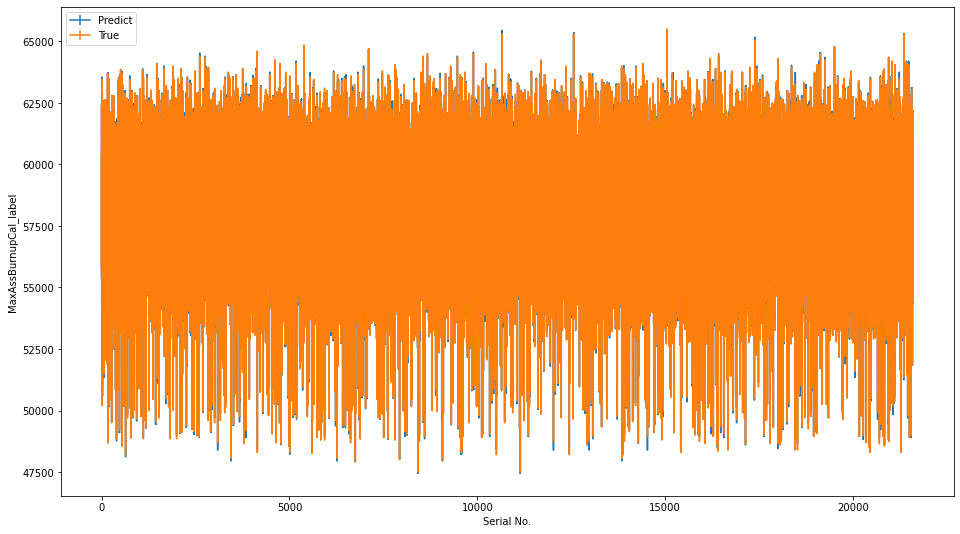

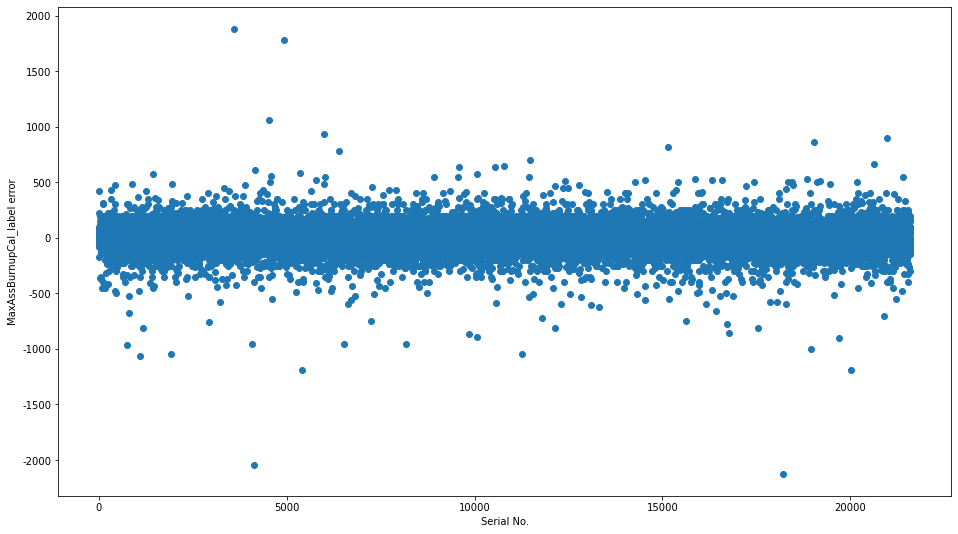

LGB均差得分为： 81.32894359826525


<Figure size 1152x648 with 0 Axes>

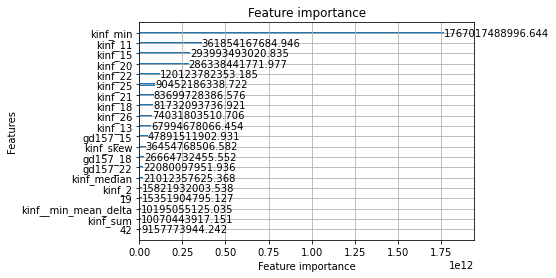

fold 2
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007799 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7646
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 60
[LightGBM] [Info] Start training from score 58129.224537
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 64.2646	valid_1's l1: 98.7862
[100]	training's l1: 52.3526	valid_1's l1: 85.3946
[150]	training's l1: 51.1579	valid_1's l1: 83.9914
[200]	training's l1: 50.7682	valid_1's l1: 83.5033
[250]	training's l1: 50.5834	valid_1's l1: 83.2839
[300]	training's l1: 50.4834	valid_1's l1: 83.1829
[350]	training's l1: 50.4254	valid_1's l1: 83.1309
[400]	training's l1: 50.3898	valid_1's l1: 83.1004
[450]	training's l1: 50.3657	valid_1's l1: 83.0822
[500]	training's l1: 50.3497	valid_1's l1: 83.0758
[550]	training's l1: 50.3384	valid_1's l1: 83.0746
[600]	training's l1: 50

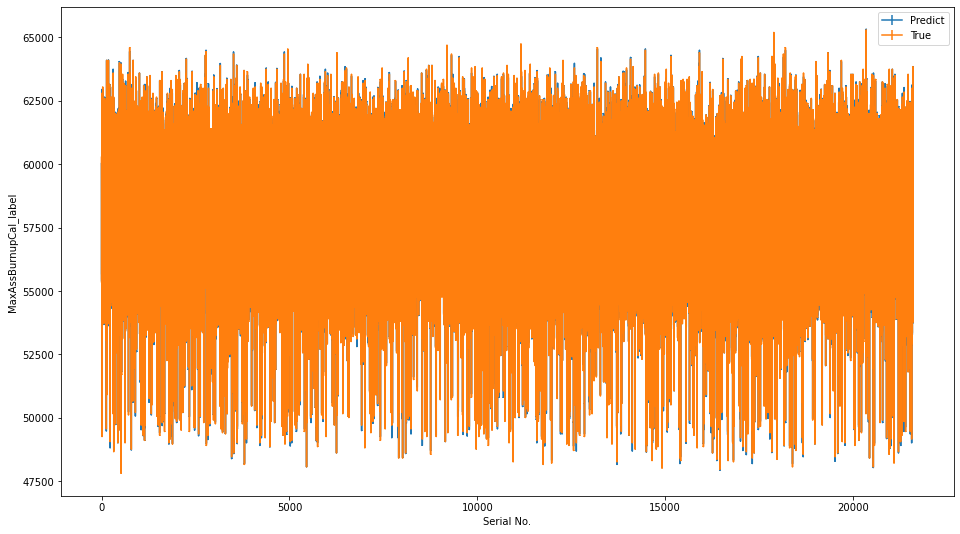

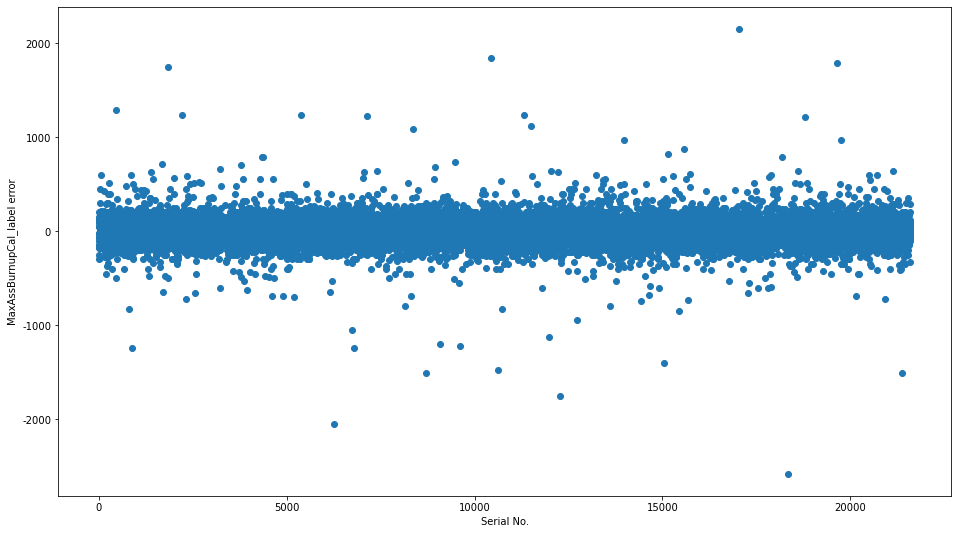

LGB均差得分为： 83.07342211320095


<Figure size 1152x648 with 0 Axes>

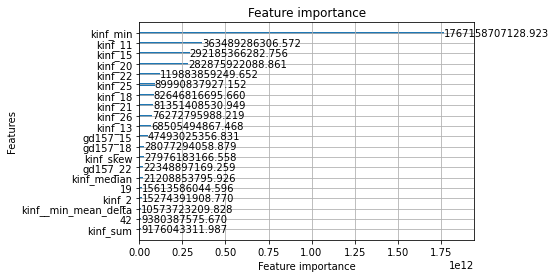

fold 3
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007714 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7649
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 60
[LightGBM] [Info] Start training from score 58119.564815
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 65.2034	valid_1's l1: 99.5508
[100]	training's l1: 52.6884	valid_1's l1: 85.0468
[150]	training's l1: 51.4018	valid_1's l1: 83.4299
[200]	training's l1: 50.9816	valid_1's l1: 82.8951
[250]	training's l1: 50.7985	valid_1's l1: 82.6556
[300]	training's l1: 50.6989	valid_1's l1: 82.5379
[350]	training's l1: 50.6415	valid_1's l1: 82.472
[400]	training's l1: 50.6062	valid_1's l1: 82.4368
[450]	training's l1: 50.5829	valid_1's l1: 82.418
[500]	training's l1: 50.5668	valid_1's l1: 82.4029
[550]	training's l1: 50.5553	valid_1's l1: 82.3909
[600]	training's l1: 50.5

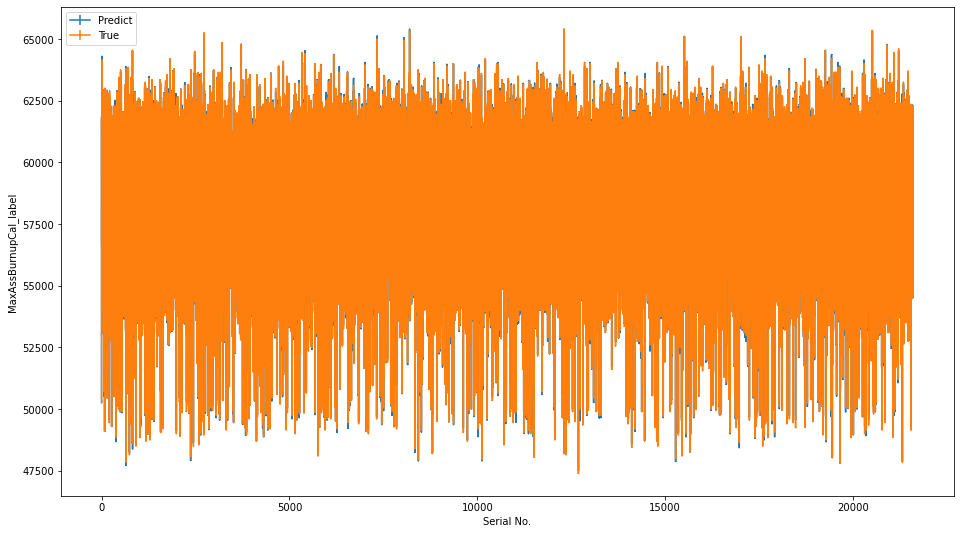

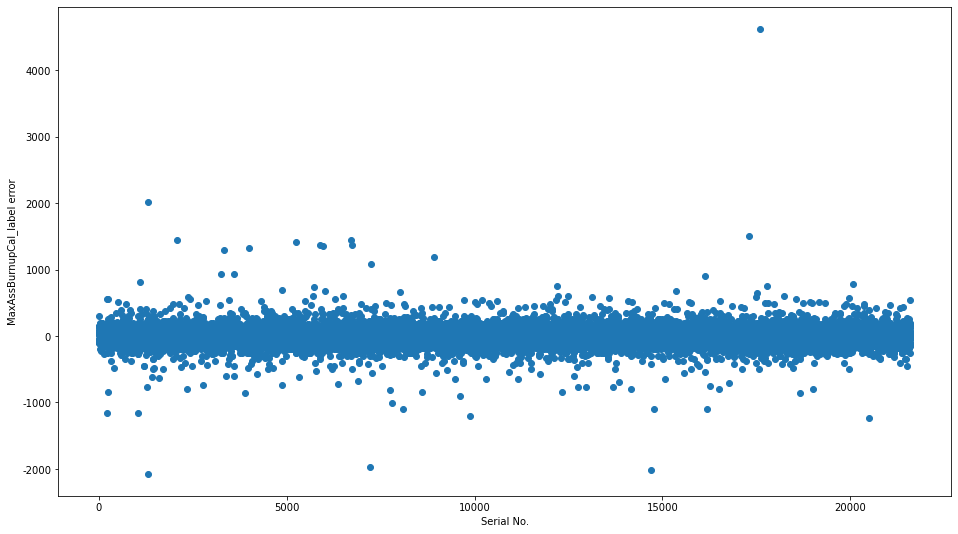

LGB均差得分为： 82.36388761504728


<Figure size 1152x648 with 0 Axes>

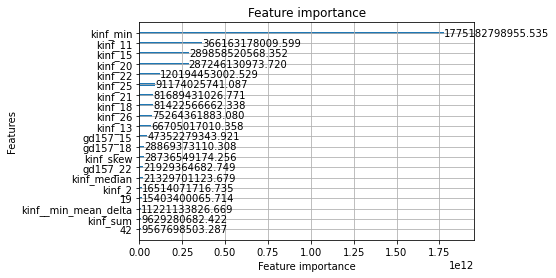

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007743 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7642
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 60
[LightGBM] [Info] Start training from score 58121.648148
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 65.0222	valid_1's l1: 101.023
[100]	training's l1: 52.7372	valid_1's l1: 85.8088
[150]	training's l1: 51.4979	valid_1's l1: 84.1186
[200]	training's l1: 51.0857	valid_1's l1: 83.5228
[250]	training's l1: 50.8985	valid_1's l1: 83.2403
[300]	training's l1: 50.7969	valid_1's l1: 83.1104
[350]	training's l1: 50.7387	valid_1's l1: 83.0385
[400]	training's l1: 50.7002	valid_1's l1: 83.0057
[450]	training's l1: 50.6753	valid_1's l1: 82.9821
[500]	training's l1: 50.6579	valid_1's l1: 82.9695
[550]	training's l1: 50.6458	valid_1's l1: 82.9578
[600]	training's l1: 50

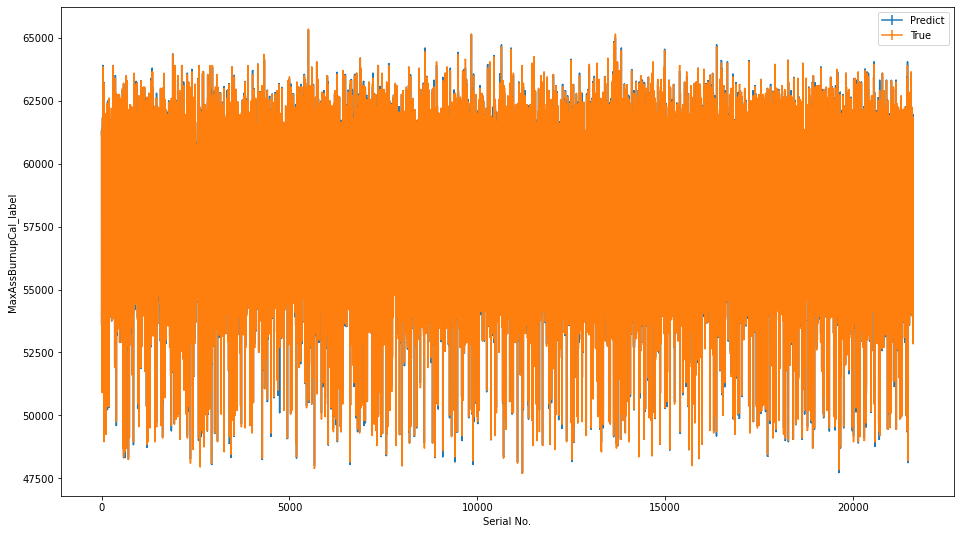

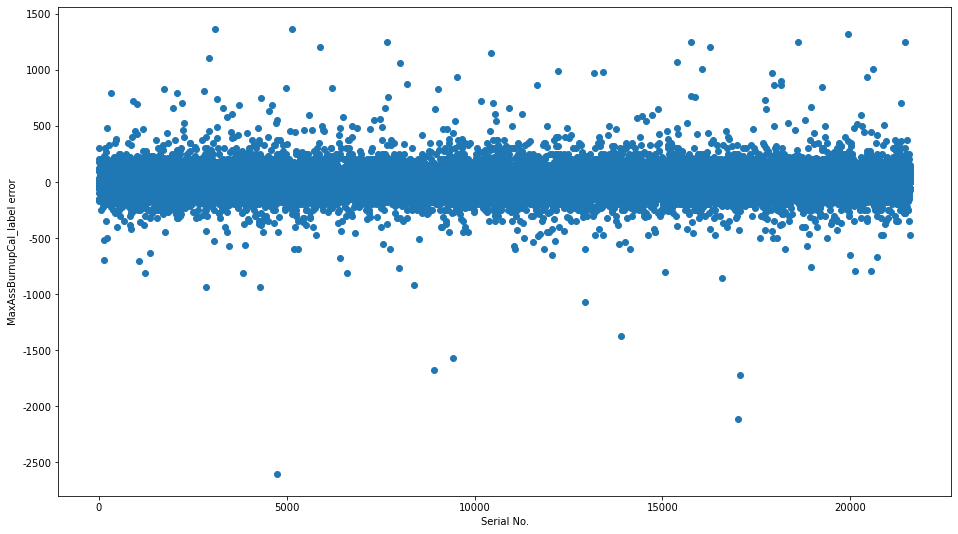

LGB均差得分为： 82.92019742790538


<Figure size 1152x648 with 0 Axes>

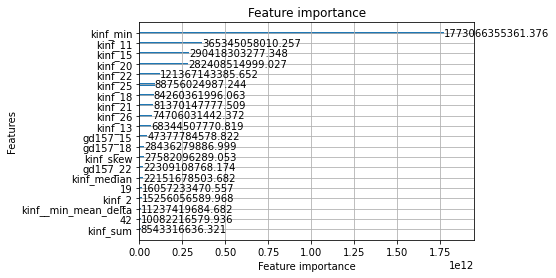

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008146 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7646
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 60
[LightGBM] [Info] Start training from score 58123.082755
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 64.8803	valid_1's l1: 98.5289
[100]	training's l1: 52.6572	valid_1's l1: 84.4855
[150]	training's l1: 51.4241	valid_1's l1: 82.873
[200]	training's l1: 51.0442	valid_1's l1: 82.2931
[250]	training's l1: 50.8678	valid_1's l1: 82.0229
[300]	training's l1: 50.7741	valid_1's l1: 81.9028
[350]	training's l1: 50.7169	valid_1's l1: 81.8367
[400]	training's l1: 50.6797	valid_1's l1: 81.8074
[450]	training's l1: 50.6536	valid_1's l1: 81.7915
[500]	training's l1: 50.6362	valid_1's l1: 81.7832
[550]	training's l1: 50.6228	valid_1's l1: 81.7797
[600]	training's l1: 50.

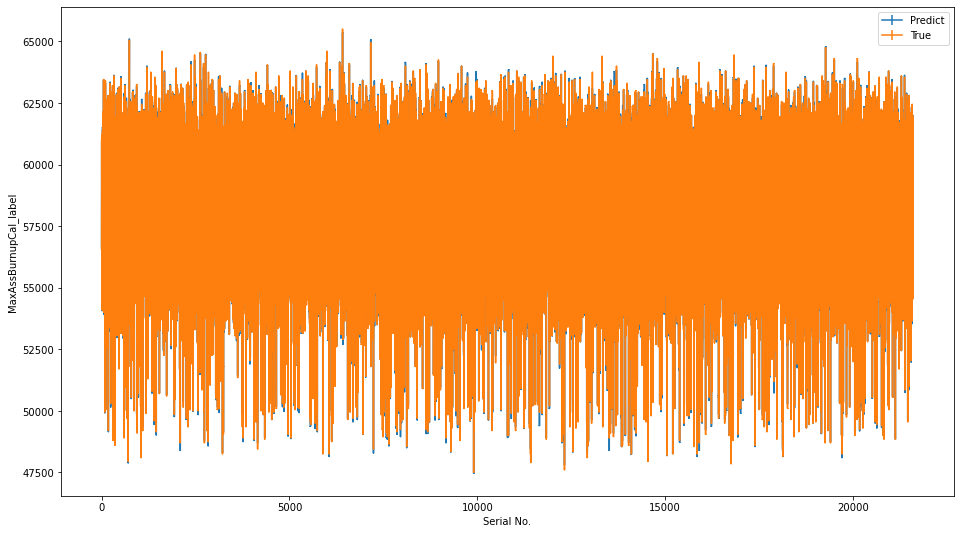

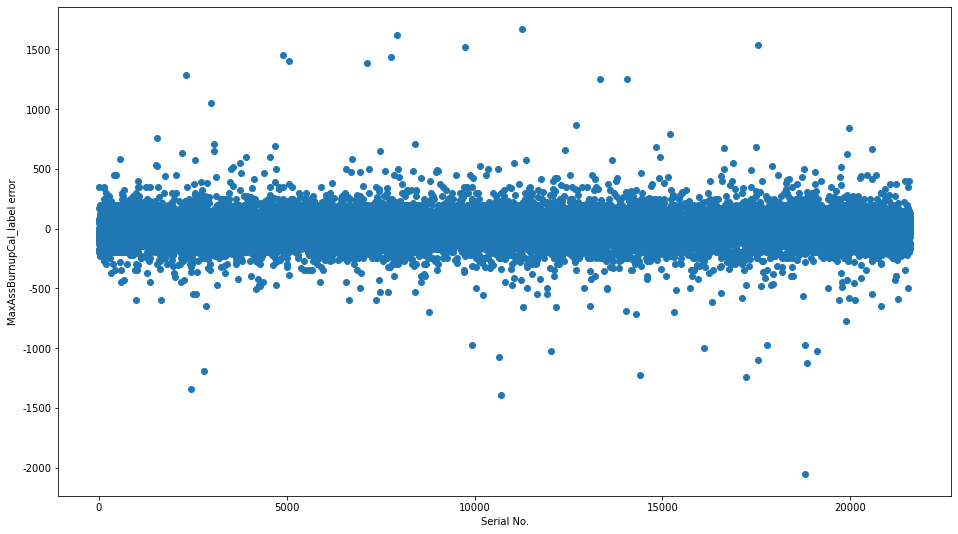

LGB均差得分为： 81.77944609120544


<Figure size 1152x648 with 0 Axes>

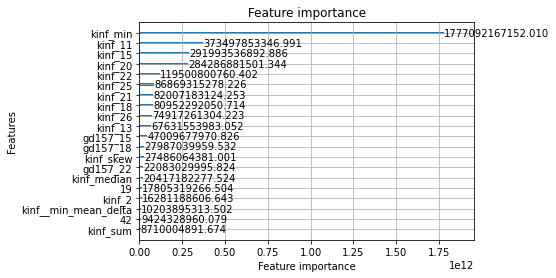

训练数据的shape为： (108000, 60)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008148 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7396
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 60
[LightGBM] [Info] Start training from score 63196.354167
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 320.421	valid_1's l1: 452.655
Early stopping, best iteration is:
[37]	training's l1: 331.737	valid_1's l1: 448.567
best iteration =  37
****************************************************************************************************


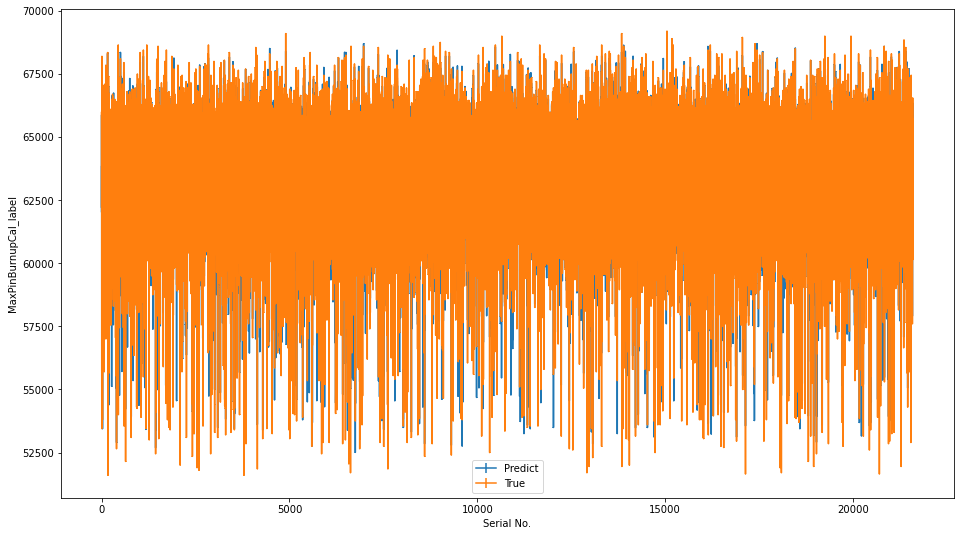

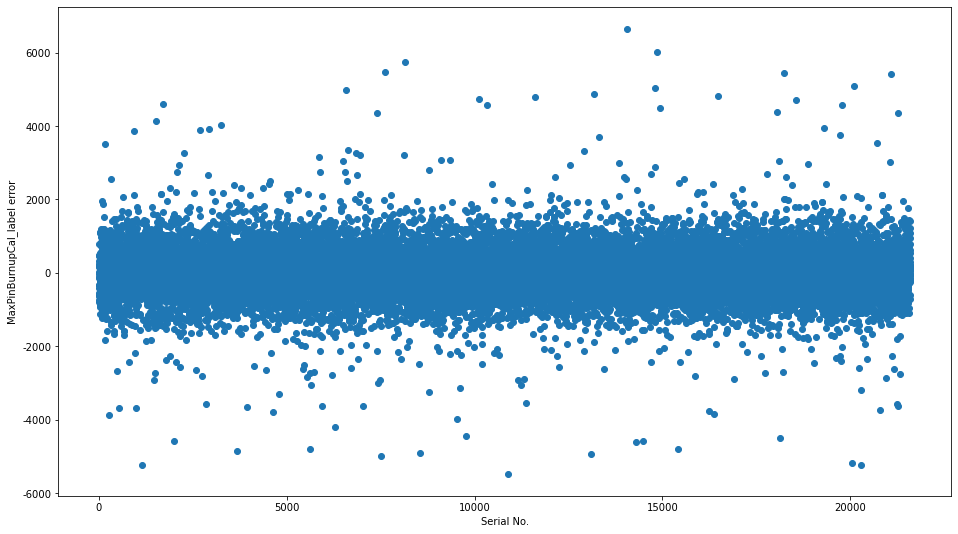

LGB均差得分为： 448.5672019846277


<Figure size 1152x648 with 0 Axes>

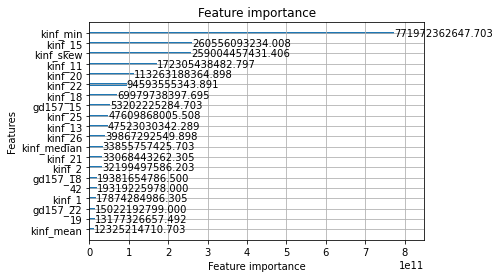

fold 2
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008198 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 60
[LightGBM] [Info] Start training from score 63204.089699
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 321.248	valid_1's l1: 450.594
Early stopping, best iteration is:
[38]	training's l1: 330.94	valid_1's l1: 446.91
best iteration =  38
****************************************************************************************************


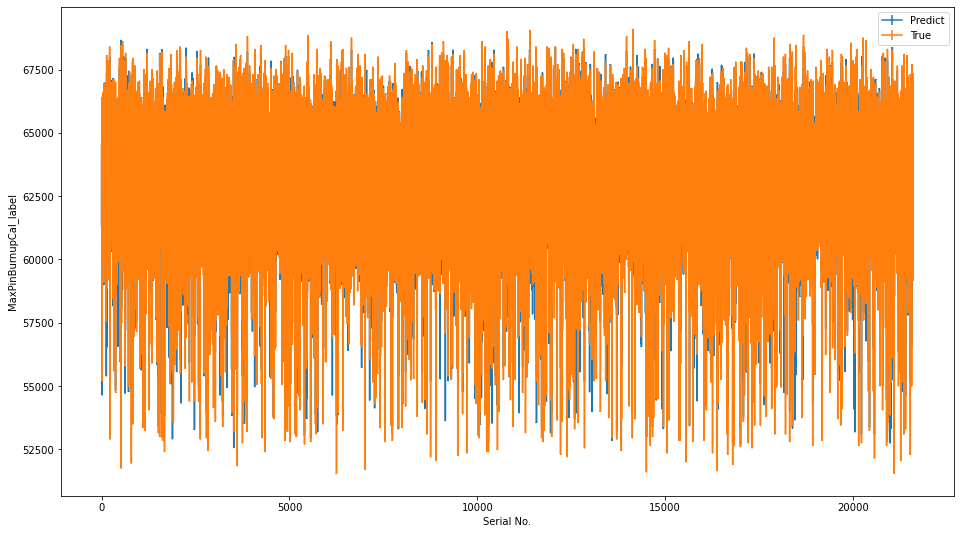

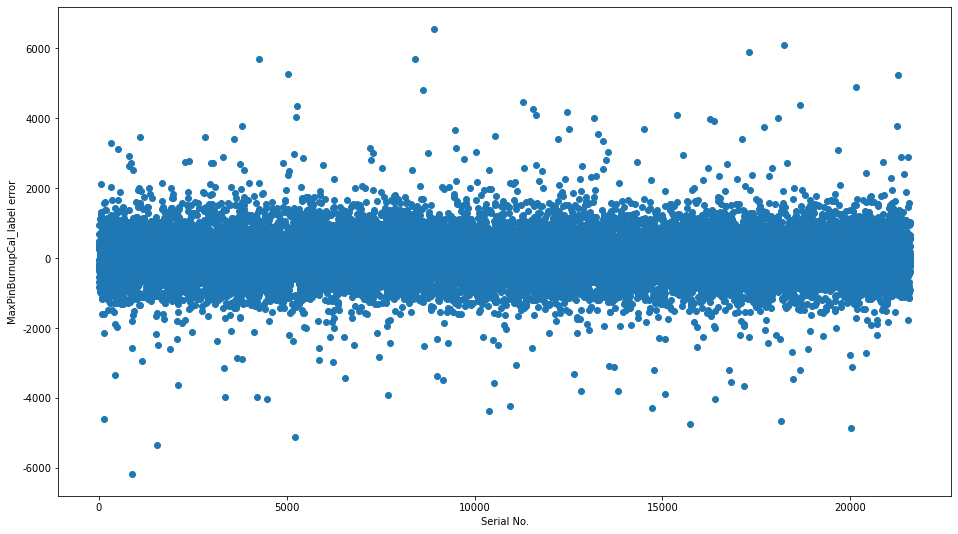

LGB均差得分为： 446.9104166130079


<Figure size 1152x648 with 0 Axes>

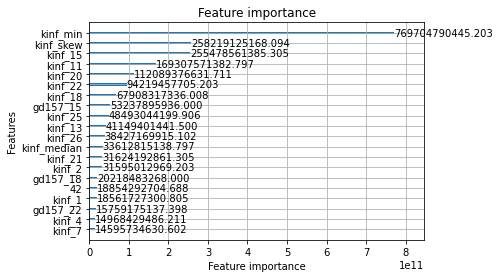

fold 3
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008462 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7398
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 60
[LightGBM] [Info] Start training from score 63196.660301
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 319.745	valid_1's l1: 456.028
Early stopping, best iteration is:
[38]	training's l1: 329.588	valid_1's l1: 451.98
best iteration =  38
****************************************************************************************************


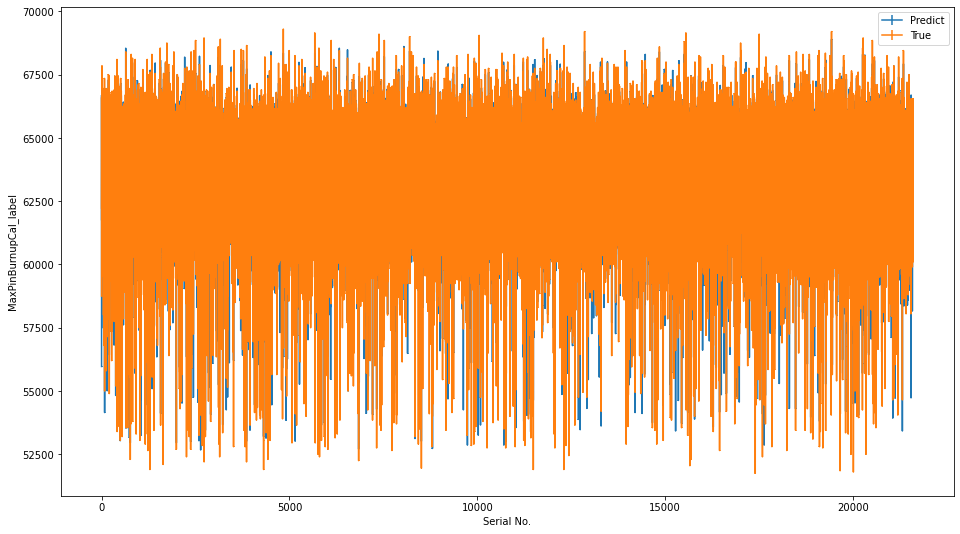

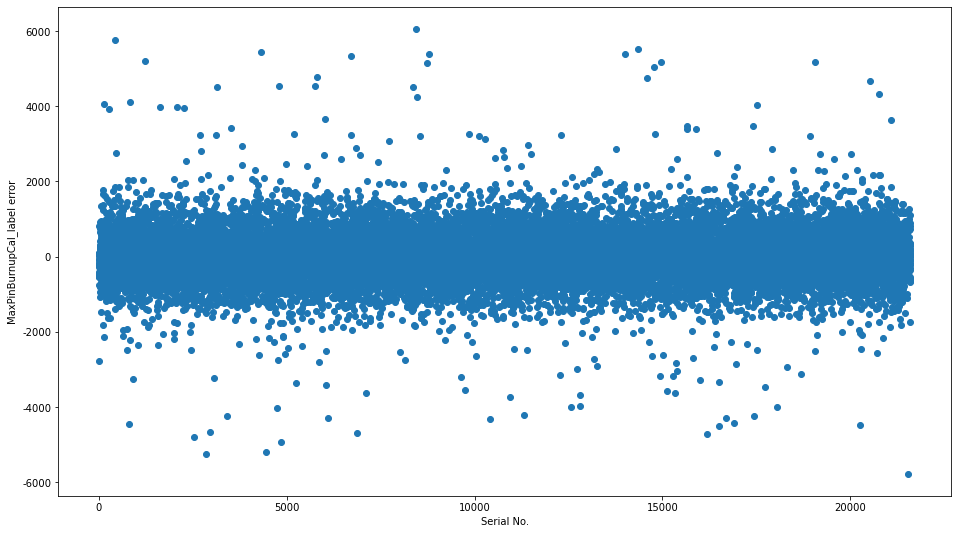

LGB均差得分为： 451.97990012114496


<Figure size 1152x648 with 0 Axes>

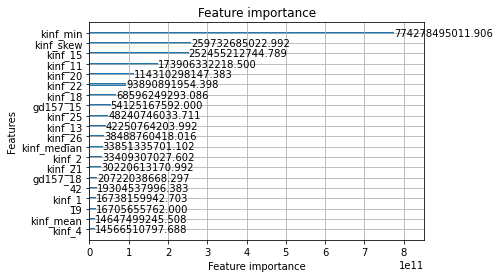

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007867 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7391
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 60
[LightGBM] [Info] Start training from score 63201.919560
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 321.383	valid_1's l1: 451.612
Early stopping, best iteration is:
[38]	training's l1: 331.042	valid_1's l1: 448.031
best iteration =  38
****************************************************************************************************


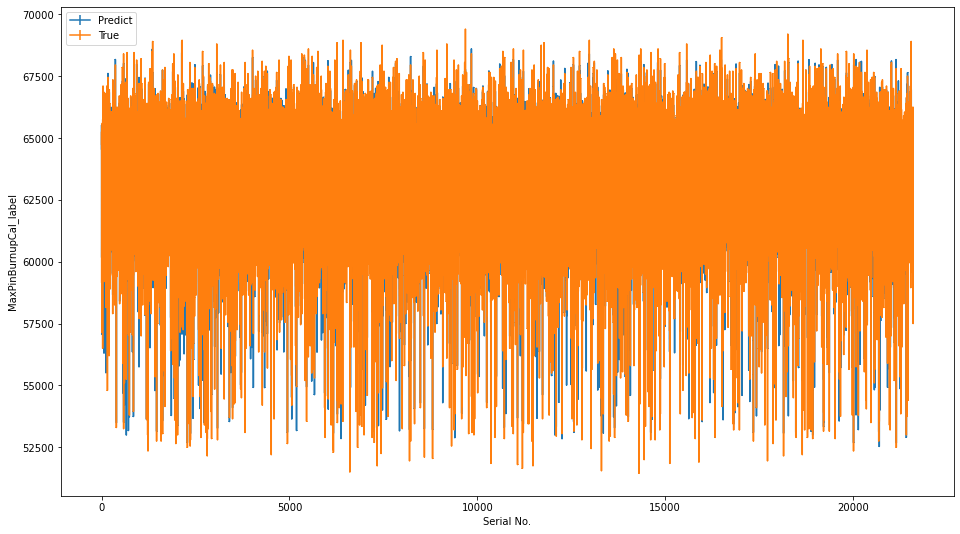

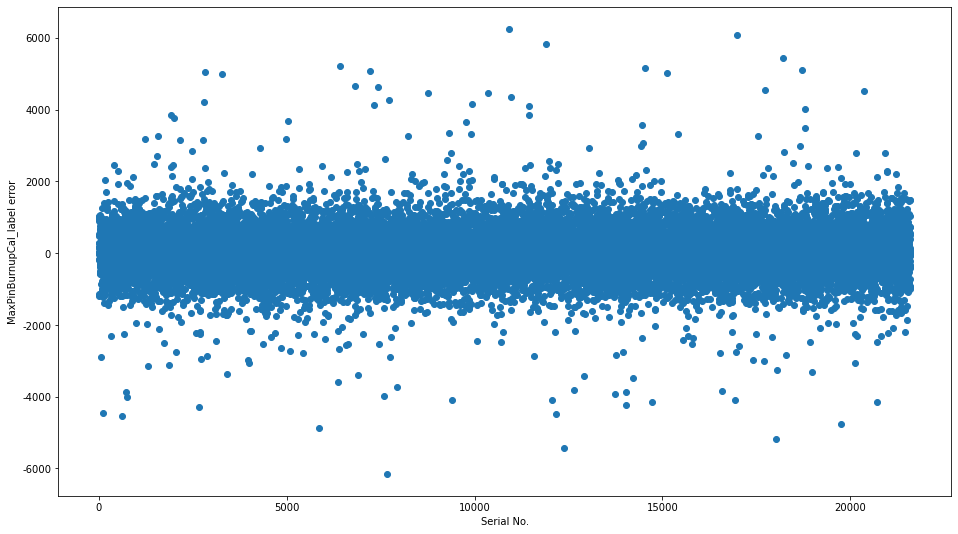

LGB均差得分为： 448.03135239218847


<Figure size 1152x648 with 0 Axes>

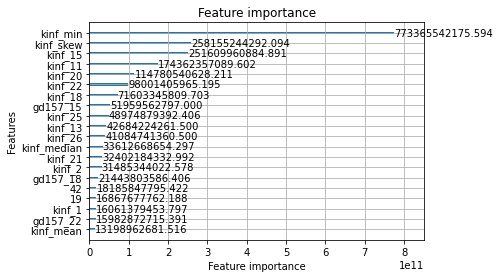

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007903 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7395
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 60
[LightGBM] [Info] Start training from score 63198.455440
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 320.557	valid_1's l1: 452.318
Early stopping, best iteration is:
[37]	training's l1: 331.865	valid_1's l1: 448.561
best iteration =  37
****************************************************************************************************


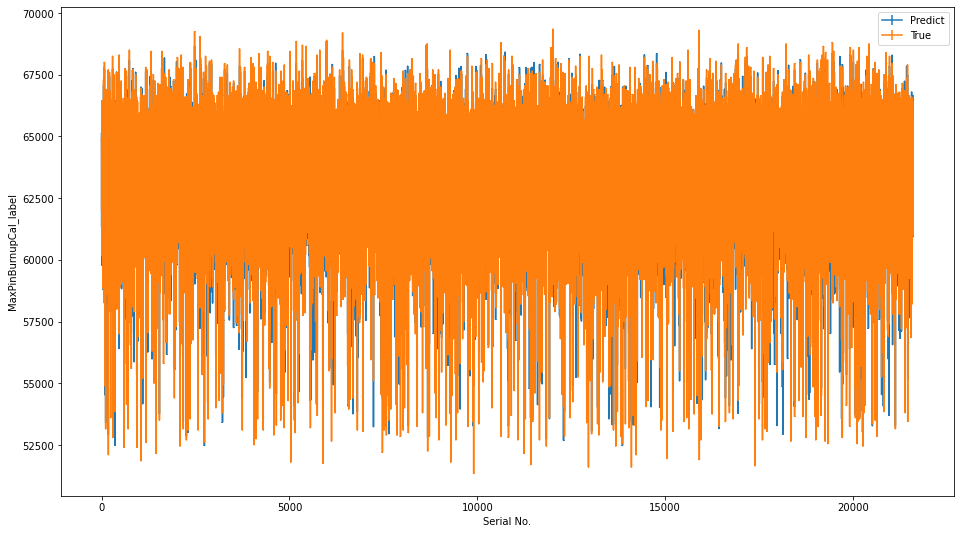

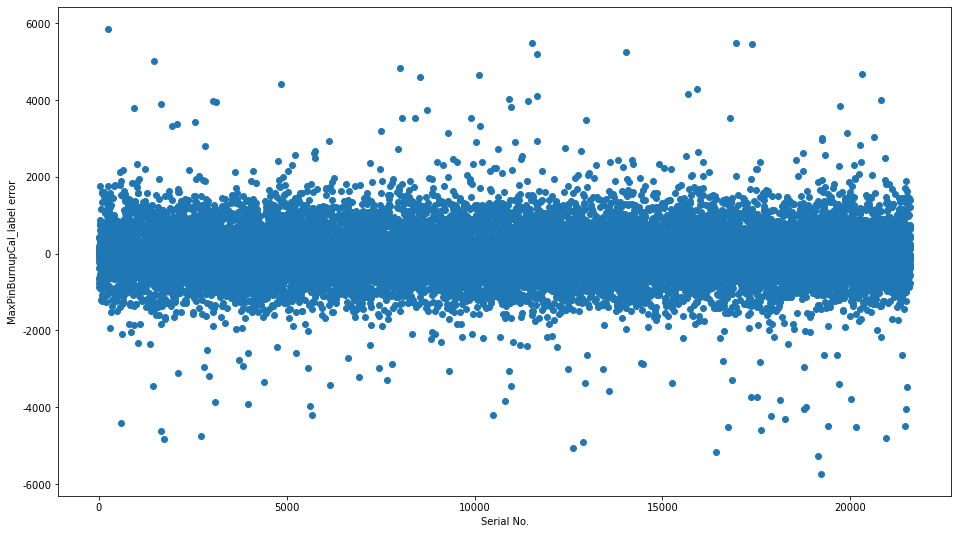

LGB均差得分为： 448.5608505085041


<Figure size 1152x648 with 0 Axes>

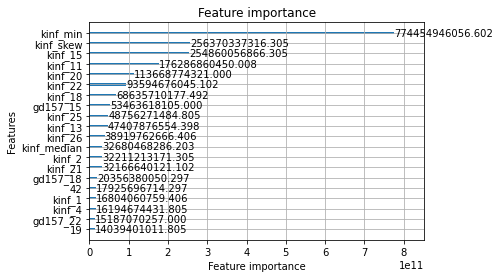

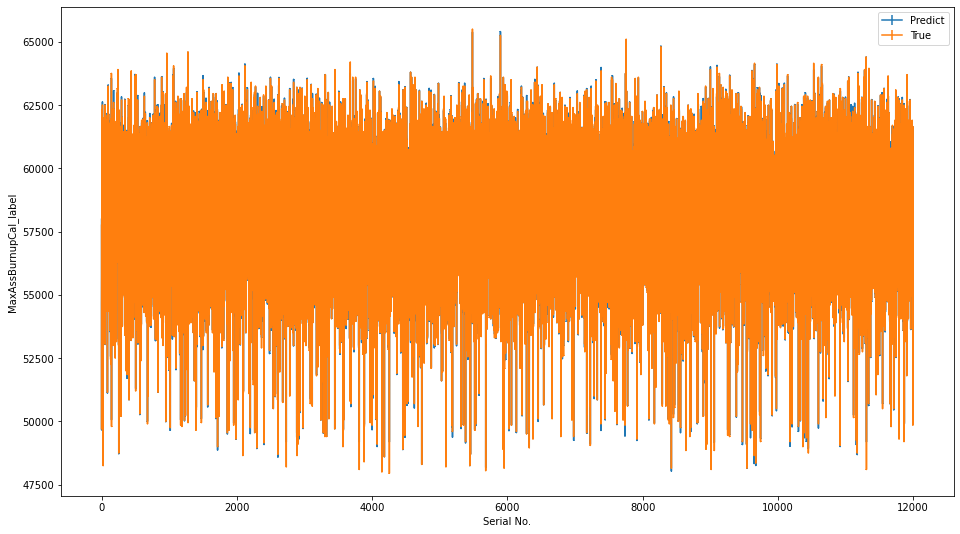

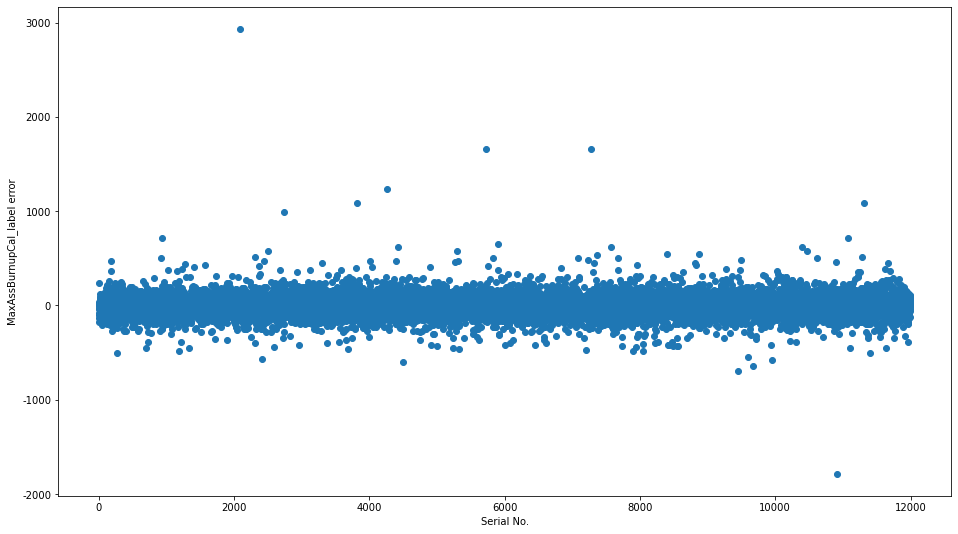

特征数量为60, 目标MaxAssBurnupCal_label的LGB均差得分为：77.76506168274862


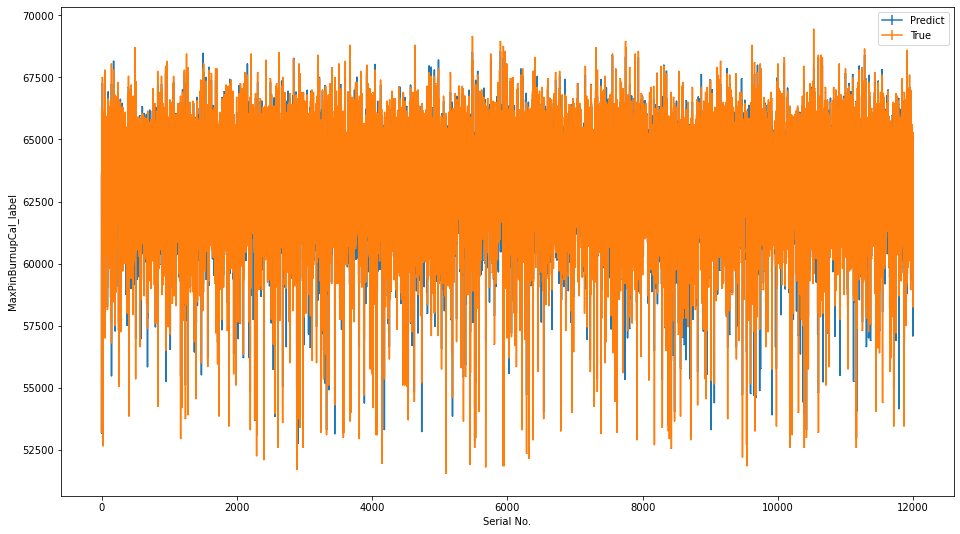

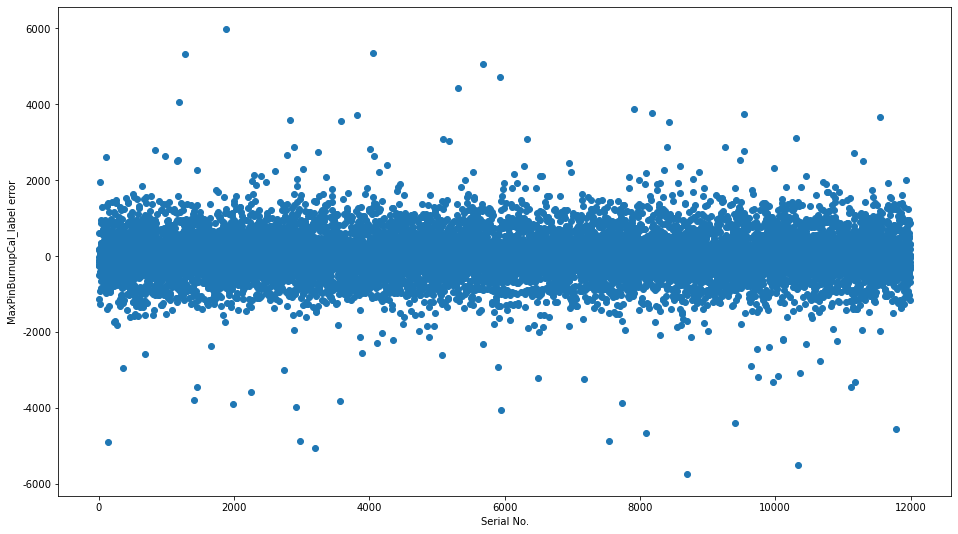

特征数量为60, 目标MaxPinBurnupCal_label的LGB均差得分为：441.67342584823905
训练数据的shape为： (108000, 100)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16843
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 100
[LightGBM] [Info] Start training from score 58120.146412
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 62.3007	valid_1's l1: 95.9754
[100]	training's l1: 52.3181	valid_1's l1: 84.4388
[150]	training's l1: 51.2322	valid_1's l1: 83.0442
[200]	training's l1: 50.8872	valid_1's l1: 82.4879
[250]	training's l1: 50.7338	valid_1's l1: 82.2067
[300]	training's l1: 50.6505	valid_1's l1: 82.0406
[350]	training's l1: 50.602	valid_1's l1: 81.9478
[400]	training's l1: 50.5709	valid_1's l1: 81.8814
[450]	training's l1: 50.5487	valid_1's l1: 81.8382
[500]	training's l1: 50.5331	valid_1

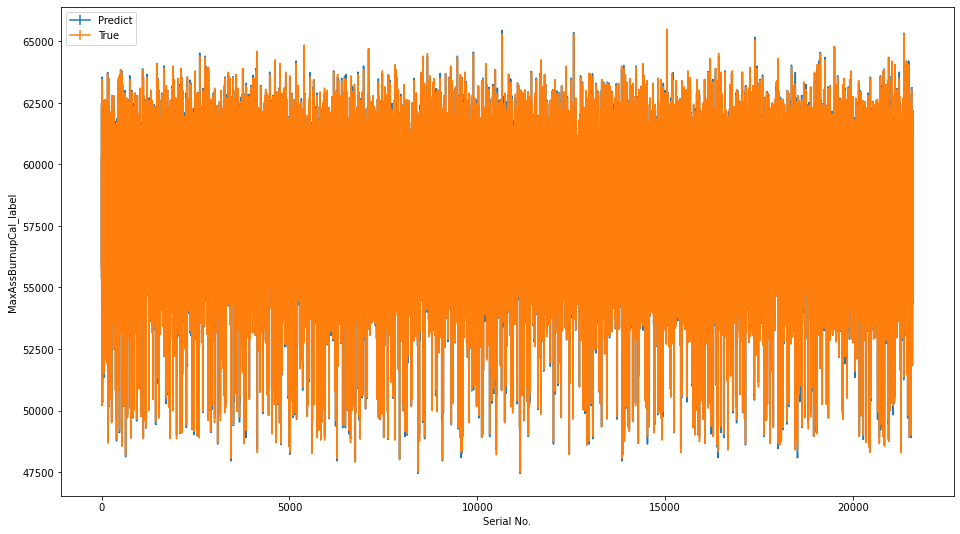

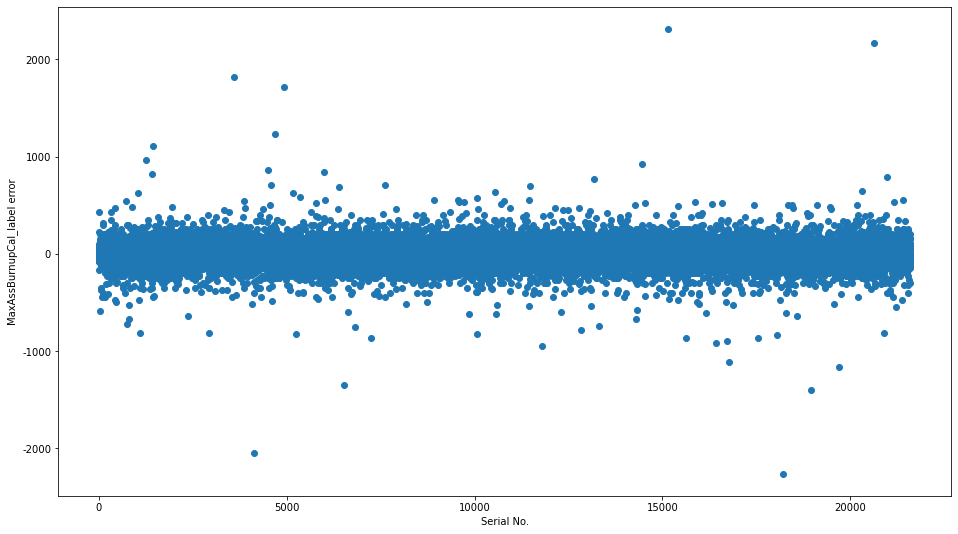

LGB均差得分为： 81.7428609550764


<Figure size 1152x648 with 0 Axes>

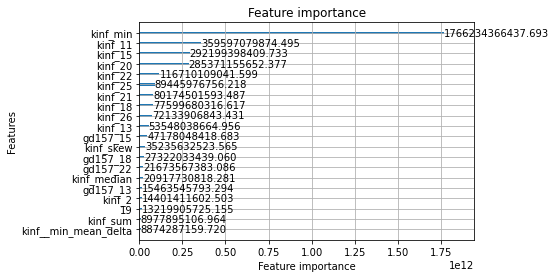

fold 2
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015163 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16842
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 100
[LightGBM] [Info] Start training from score 58129.224537
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 61.7984	valid_1's l1: 95.8102
[100]	training's l1: 52.0251	valid_1's l1: 84.8592
[150]	training's l1: 51.0268	valid_1's l1: 83.6006
[200]	training's l1: 50.6933	valid_1's l1: 83.2187
[250]	training's l1: 50.5356	valid_1's l1: 83.0486
[300]	training's l1: 50.4519	valid_1's l1: 82.9659
[350]	training's l1: 50.4019	valid_1's l1: 82.9261
[400]	training's l1: 50.3714	valid_1's l1: 82.9031
[450]	training's l1: 50.3519	valid_1's l1: 82.8908
[500]	training's l1: 50.339	valid_1's l1: 82.8808
[550]	training's l1: 50.3295	valid_1's l1: 82.8753
[600]	training's l1: 5

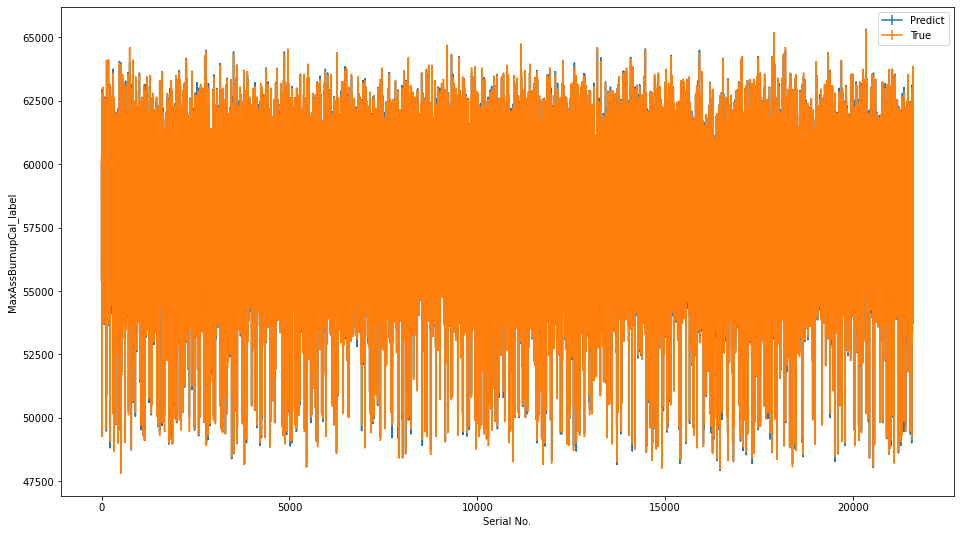

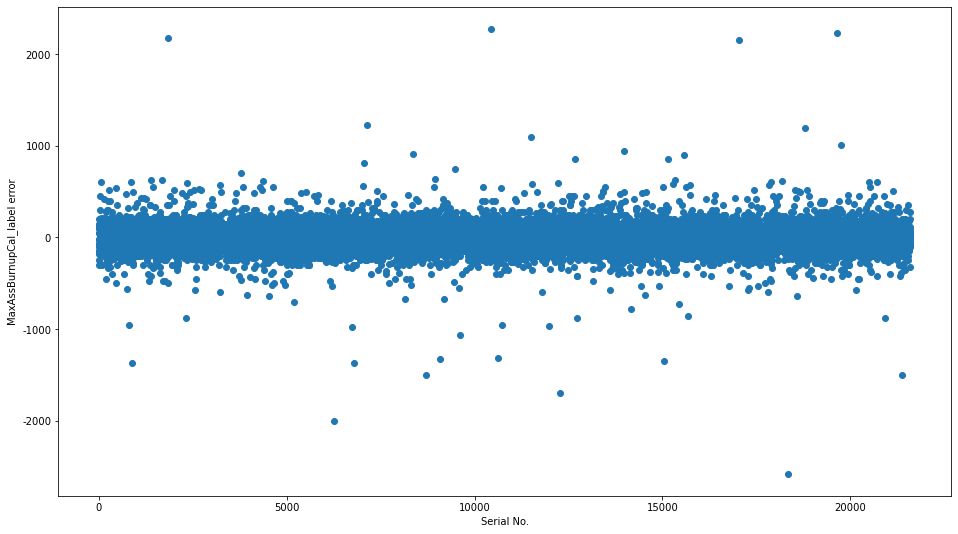

LGB均差得分为： 82.86920891877595


<Figure size 1152x648 with 0 Axes>

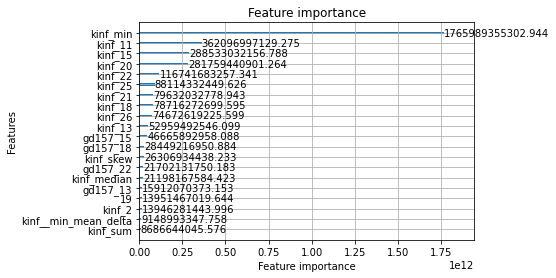

fold 3
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013933 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16845
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 100
[LightGBM] [Info] Start training from score 58119.564815
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 62.3748	valid_1's l1: 97.1391
[100]	training's l1: 52.3754	valid_1's l1: 85.4341
[150]	training's l1: 51.2865	valid_1's l1: 83.9742
[200]	training's l1: 50.9203	valid_1's l1: 83.4303
[250]	training's l1: 50.7562	valid_1's l1: 83.1966
[300]	training's l1: 50.6698	valid_1's l1: 83.0708
[350]	training's l1: 50.6188	valid_1's l1: 82.9997
[400]	training's l1: 50.5877	valid_1's l1: 82.9604
[450]	training's l1: 50.5674	valid_1's l1: 82.9302
[500]	training's l1: 50.5525	valid_1's l1: 82.9079
[550]	training's l1: 50.5421	valid_1's l1: 82.8907
[600]	training's l1: 

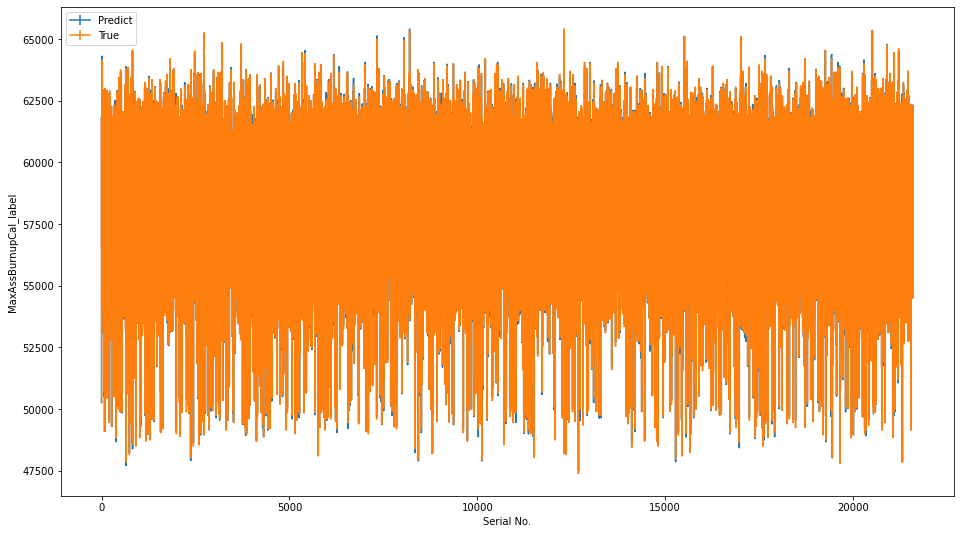

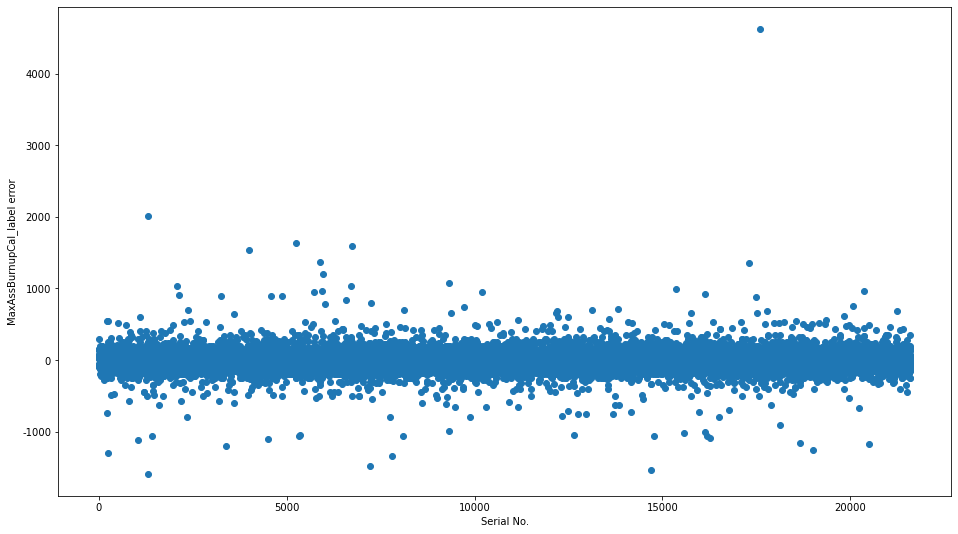

LGB均差得分为： 82.84546260129171


<Figure size 1152x648 with 0 Axes>

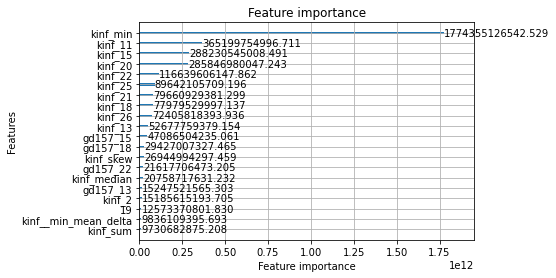

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16838
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 100
[LightGBM] [Info] Start training from score 58121.648148
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 62.1673	valid_1's l1: 97.9012
[100]	training's l1: 52.3678	valid_1's l1: 86.2829
[150]	training's l1: 51.362	valid_1's l1: 84.7895
[200]	training's l1: 51.0237	valid_1's l1: 84.2196
[250]	training's l1: 50.8648	valid_1's l1: 83.9454
[300]	training's l1: 50.7747	valid_1's l1: 83.7963
[350]	training's l1: 50.7187	valid_1's l1: 83.706
[400]	training's l1: 50.6839	valid_1's l1: 83.6515
[450]	training's l1: 50.6604	valid_1's l1: 83.6161
[500]	training's l1: 50.6439	valid_1's l1: 83.5894
[550]	training's l1: 50.632	valid_1's l1: 83.5721
[600]	training's l1: 50.

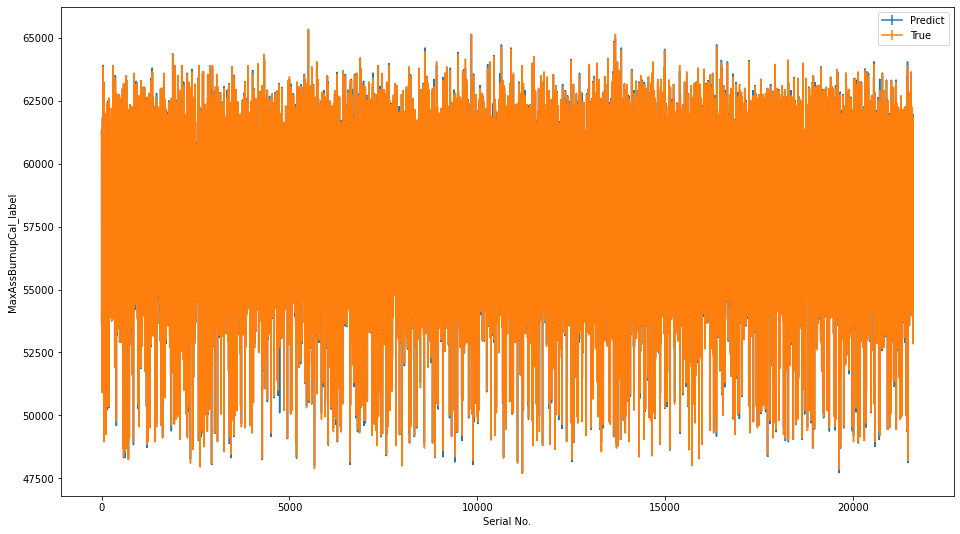

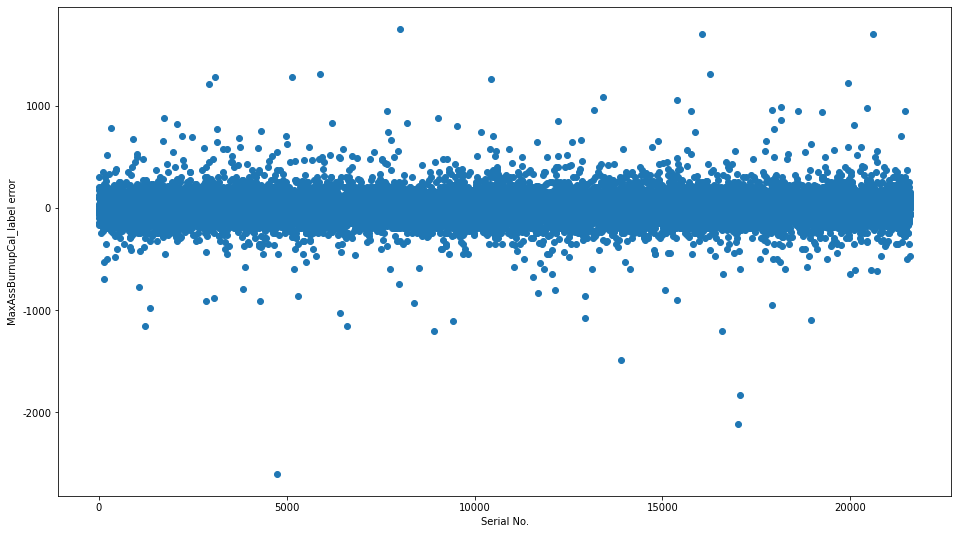

LGB均差得分为： 83.50724808418965


<Figure size 1152x648 with 0 Axes>

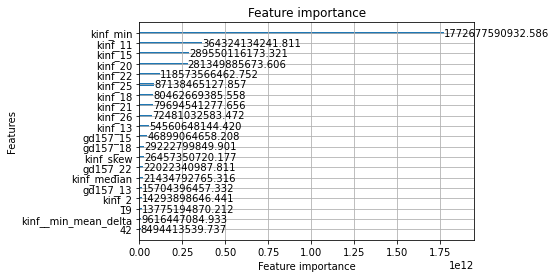

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013928 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16842
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 100
[LightGBM] [Info] Start training from score 58123.082755
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 62.3009	valid_1's l1: 96.6659
[100]	training's l1: 52.3416	valid_1's l1: 84.824
[150]	training's l1: 51.3036	valid_1's l1: 83.3616
[200]	training's l1: 50.9666	valid_1's l1: 82.8166
[250]	training's l1: 50.8168	valid_1's l1: 82.5786
[300]	training's l1: 50.7358	valid_1's l1: 82.4717
[350]	training's l1: 50.6867	valid_1's l1: 82.4261
[400]	training's l1: 50.6545	valid_1's l1: 82.4019
[450]	training's l1: 50.6323	valid_1's l1: 82.3877
[500]	training's l1: 50.6169	valid_1's l1: 82.388
[550]	training's l1: 50.6061	valid_1's l1: 82.3869
Early stopping, best it

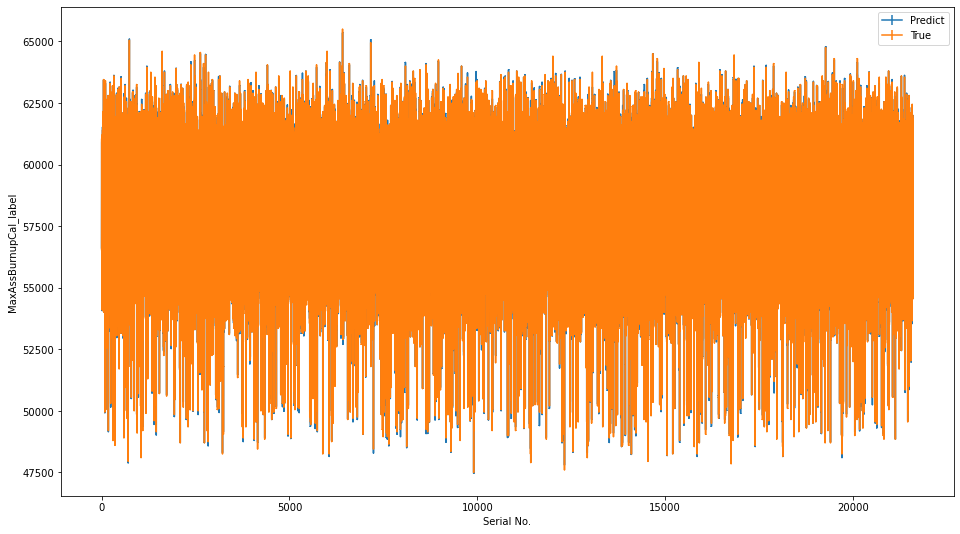

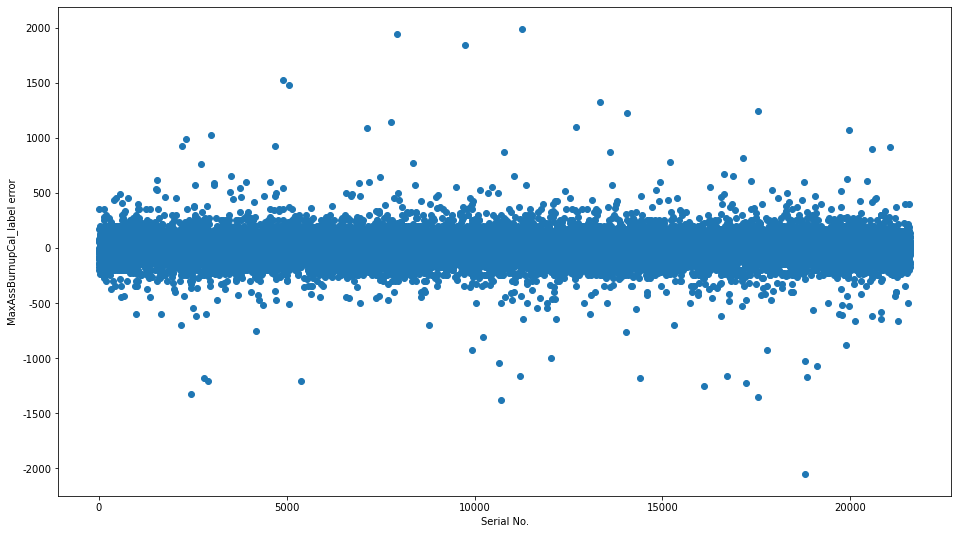

LGB均差得分为： 82.38589174580046


<Figure size 1152x648 with 0 Axes>

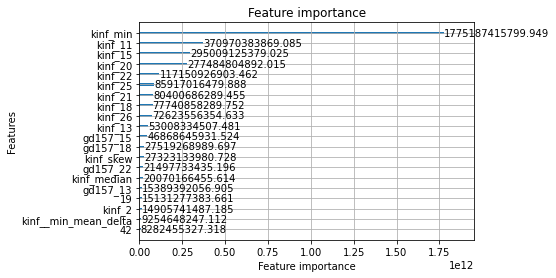

训练数据的shape为： (108000, 100)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013358 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 13818
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 100
[LightGBM] [Info] Start training from score 63196.354167
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 319.014	valid_1's l1: 455.964
Early stopping, best iteration is:
[37]	training's l1: 329.415	valid_1's l1: 451.295
best iteration =  37
****************************************************************************************************


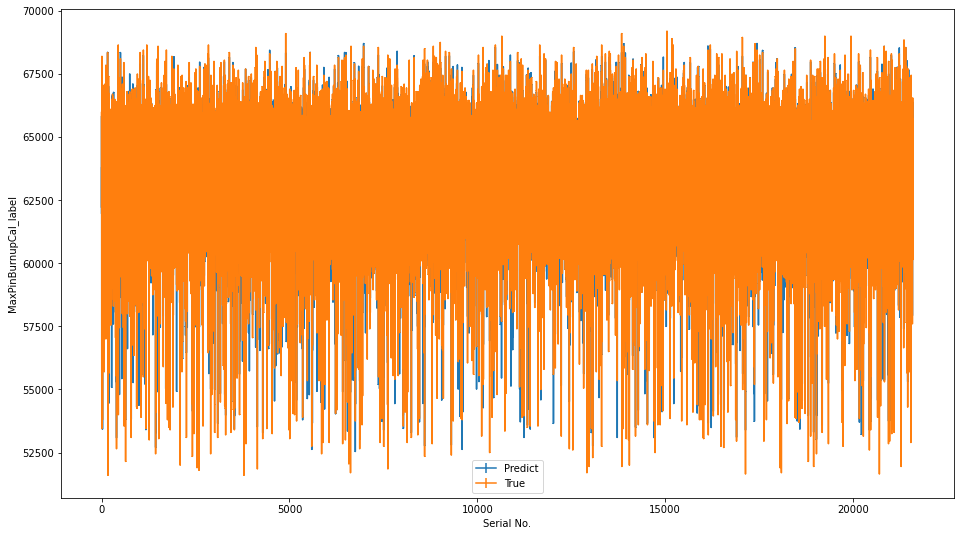

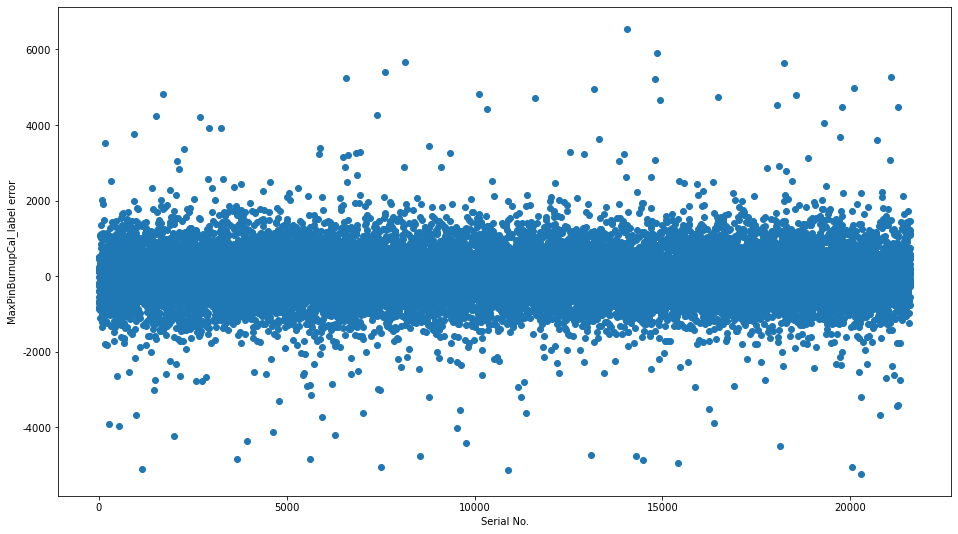

LGB均差得分为： 451.29538901142206


<Figure size 1152x648 with 0 Axes>

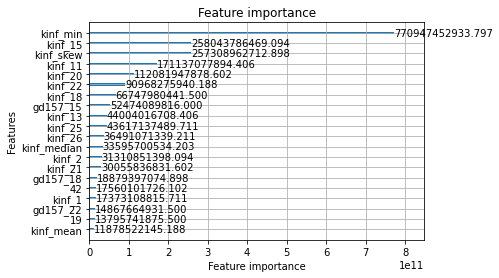

fold 2
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.013396 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 13817
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 100
[LightGBM] [Info] Start training from score 63204.089699
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 319.88	valid_1's l1: 453.667
Early stopping, best iteration is:
[37]	training's l1: 330.254	valid_1's l1: 449.629
best iteration =  37
****************************************************************************************************


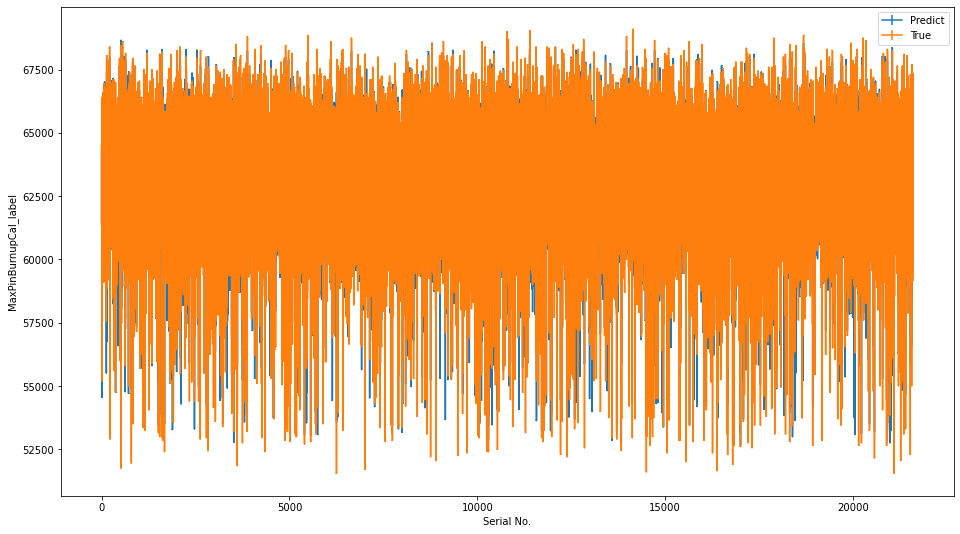

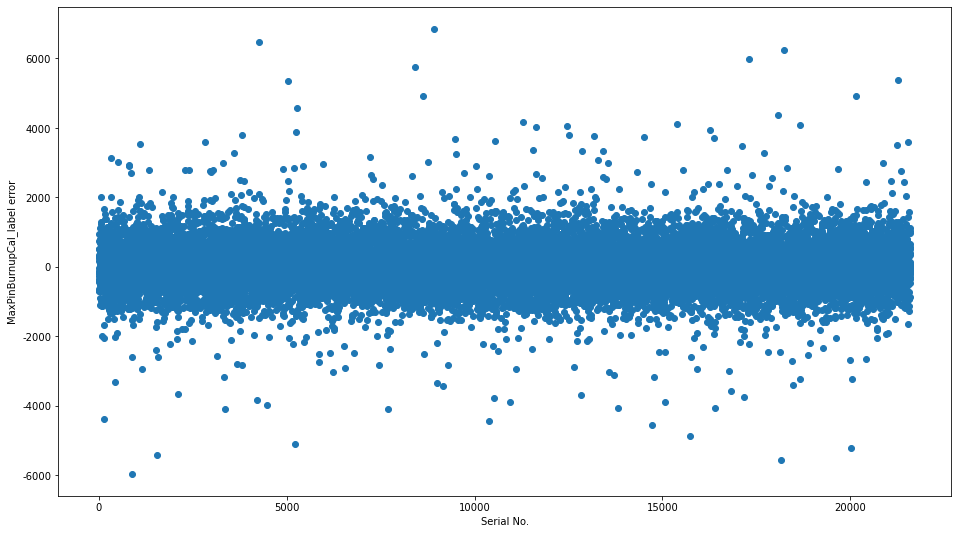

LGB均差得分为： 449.6290707172731


<Figure size 1152x648 with 0 Axes>

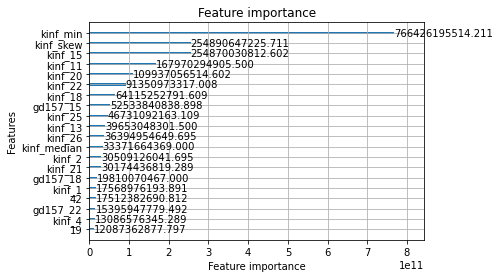

fold 3
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014409 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 13820
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 100
[LightGBM] [Info] Start training from score 63196.660301
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 318.423	valid_1's l1: 459.787
Early stopping, best iteration is:
[38]	training's l1: 327.392	valid_1's l1: 455.798
best iteration =  38
****************************************************************************************************


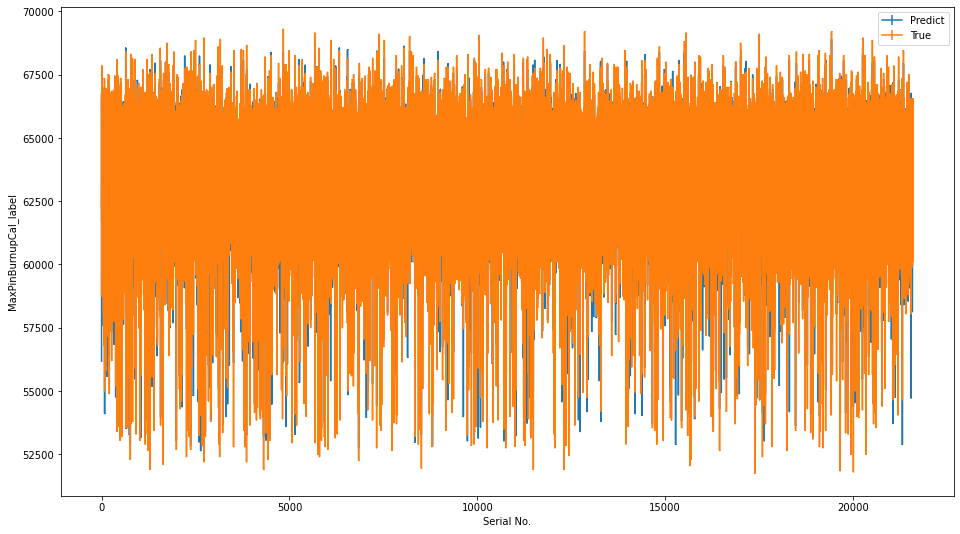

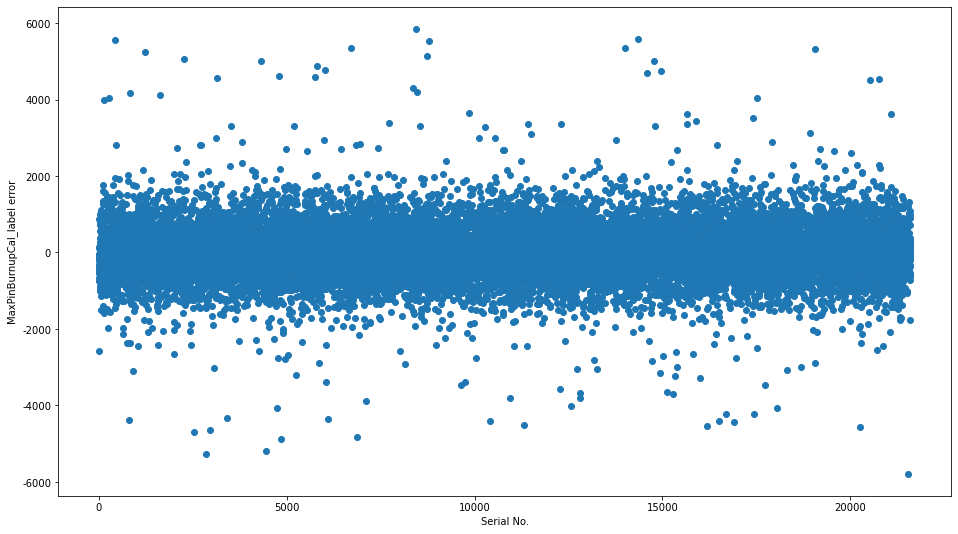

LGB均差得分为： 455.79846739268885


<Figure size 1152x648 with 0 Axes>

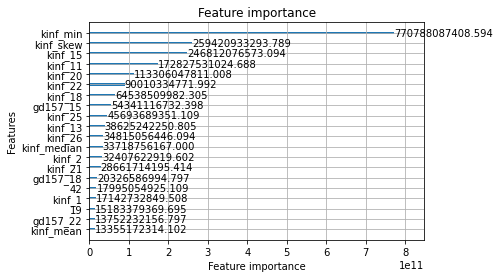

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014206 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 13813
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 100
[LightGBM] [Info] Start training from score 63201.919560
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 319.958	valid_1's l1: 455.38
Early stopping, best iteration is:
[37]	training's l1: 330.159	valid_1's l1: 451.581
best iteration =  37
****************************************************************************************************


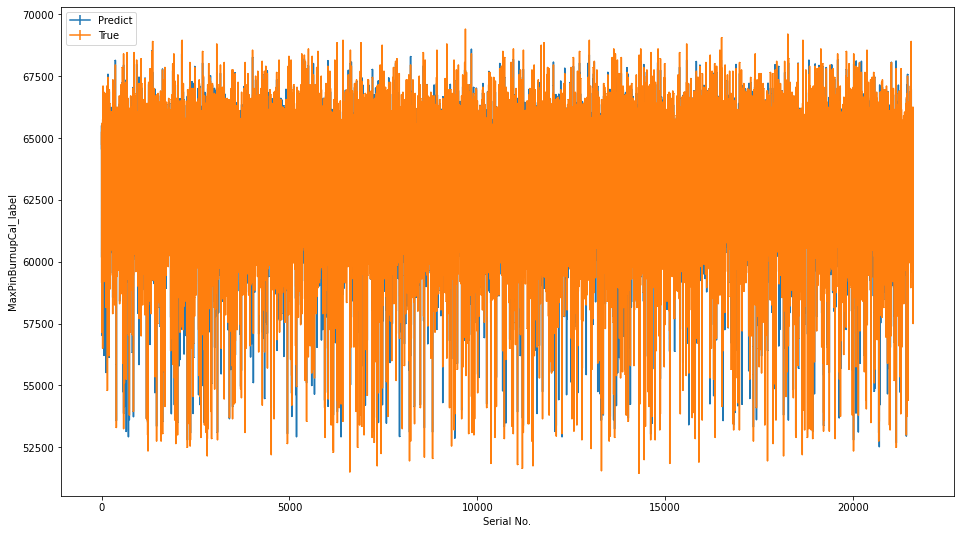

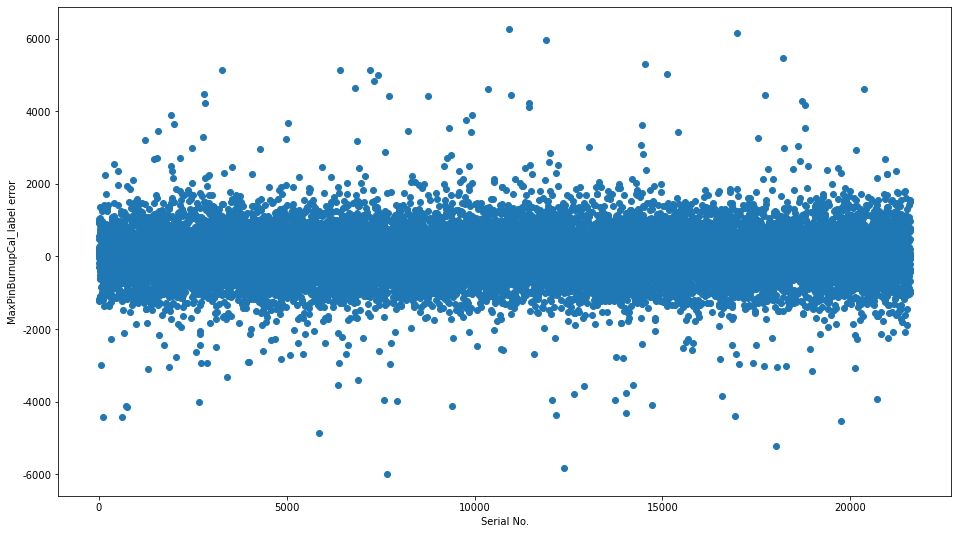

LGB均差得分为： 451.5812428114101


<Figure size 1152x648 with 0 Axes>

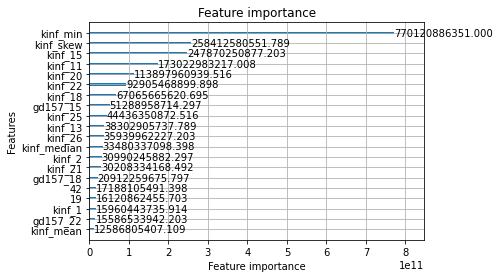

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014057 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 13817
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 100
[LightGBM] [Info] Start training from score 63198.455440
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 319.111	valid_1's l1: 455.003
Early stopping, best iteration is:
[36]	training's l1: 331.053	valid_1's l1: 450.685
best iteration =  36
****************************************************************************************************


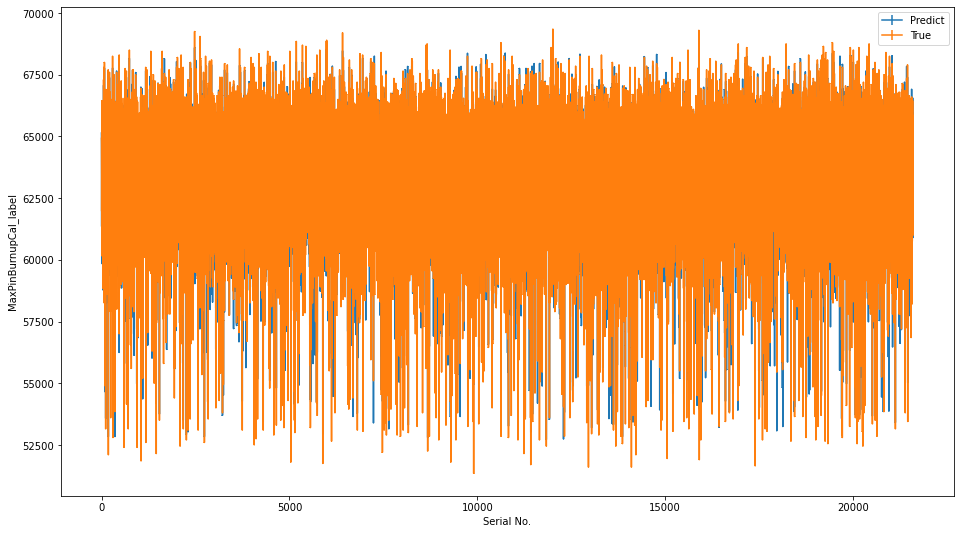

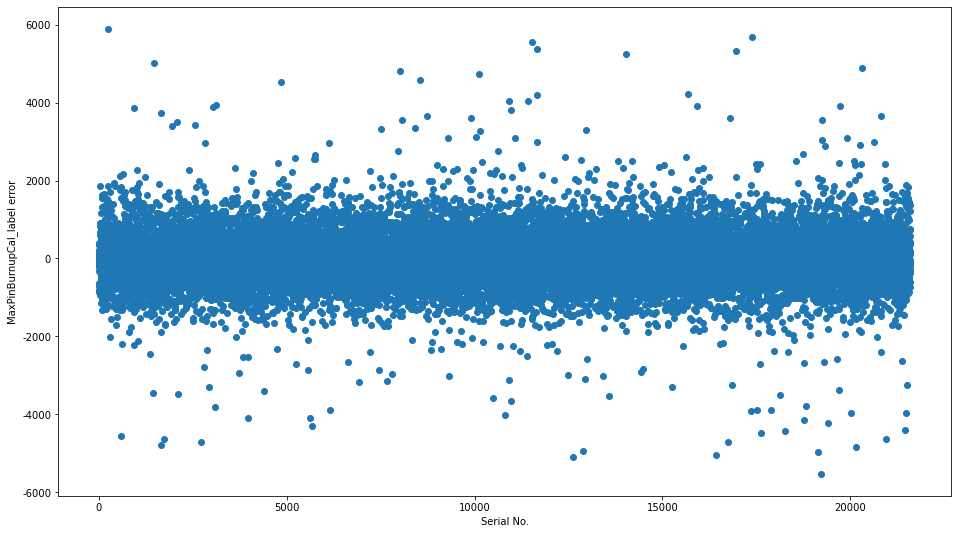

LGB均差得分为： 450.6852964853466


<Figure size 1152x648 with 0 Axes>

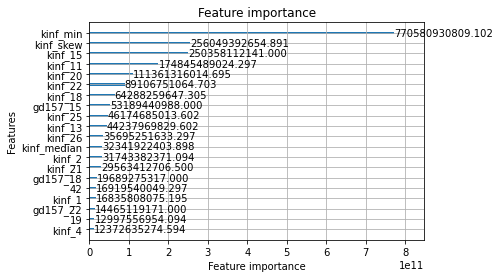

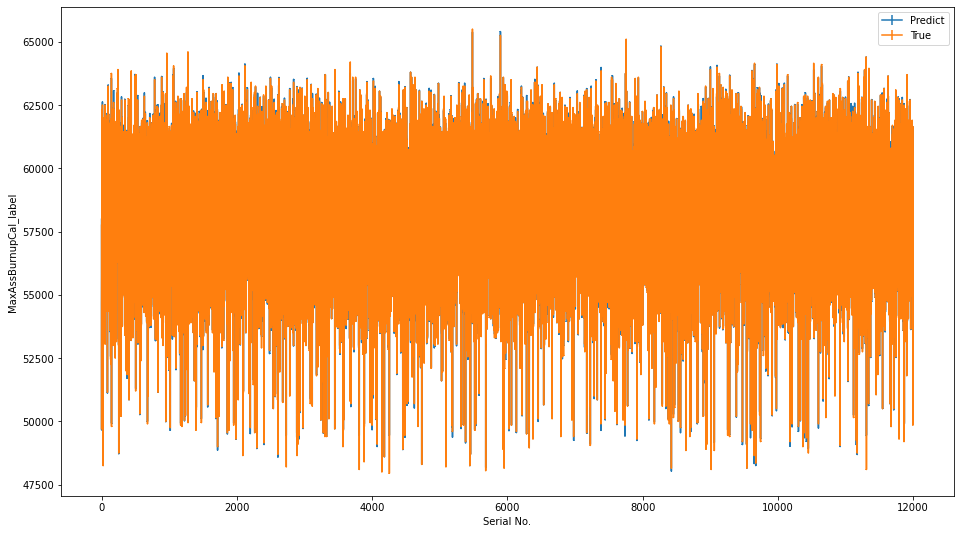

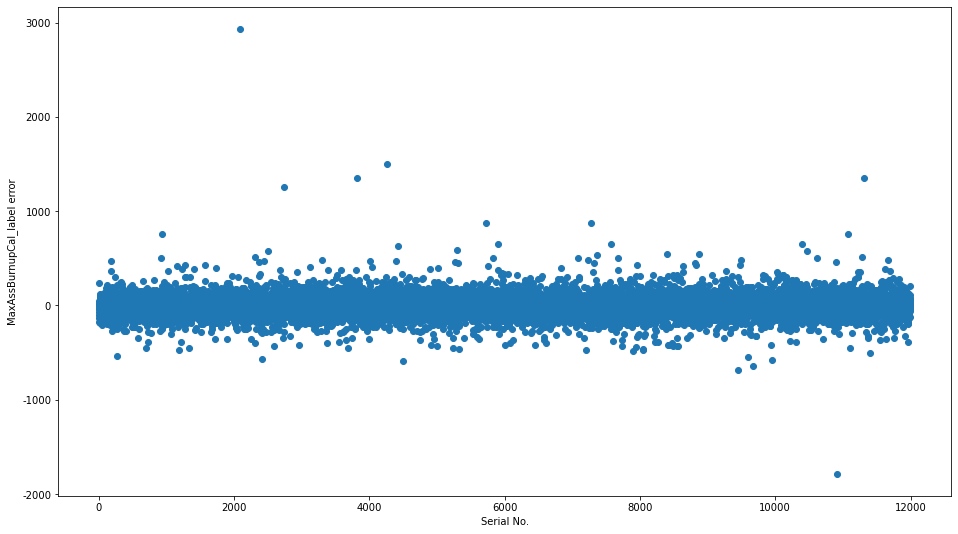

特征数量为100, 目标MaxAssBurnupCal_label的LGB均差得分为：78.04876241651124


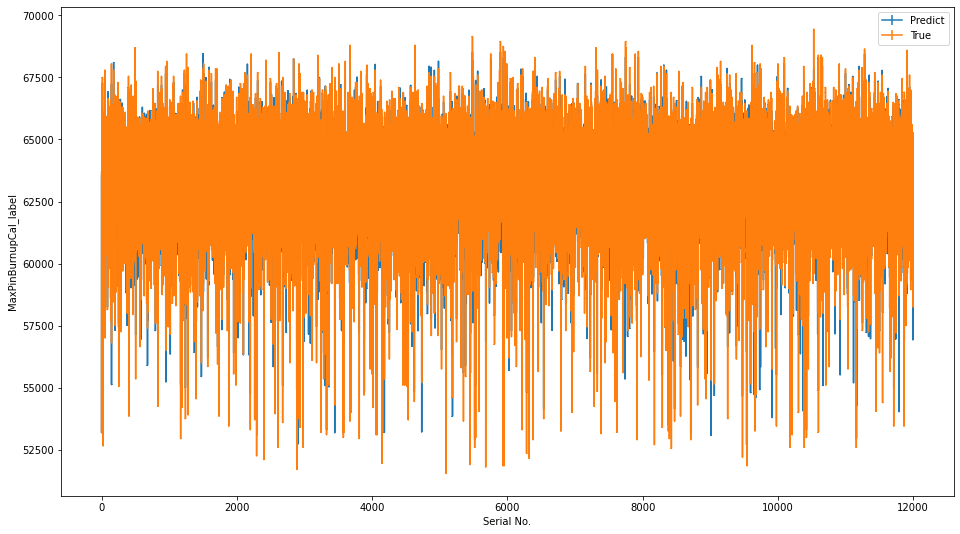

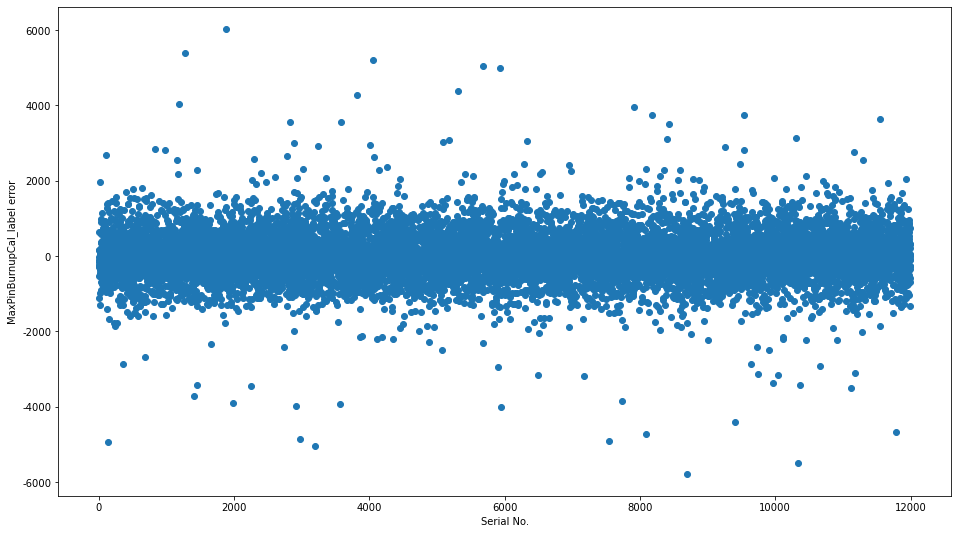

特征数量为100, 目标MaxPinBurnupCal_label的LGB均差得分为：444.0949393007361
训练数据的shape为： (108000, 140)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019637 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 26540
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 140
[LightGBM] [Info] Start training from score 58120.146412
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 61.1212	valid_1's l1: 94.8739
[100]	training's l1: 52.046	valid_1's l1: 84.4623
[150]	training's l1: 51.0416	valid_1's l1: 83.0776
[200]	training's l1: 50.7018	valid_1's l1: 82.5348
[250]	training's l1: 50.5383	valid_1's l1: 82.2858
[300]	training's l1: 50.4487	valid_1's l1: 82.156
[350]	training's l1: 50.3964	valid_1's l1: 82.0808
[400]	training's l1: 50.3636	valid_1's l1: 82.0315
[450]	training's l1: 50.3413	valid_1's l1: 81.9956
[500]	training's l1: 50.3253	valid_1'

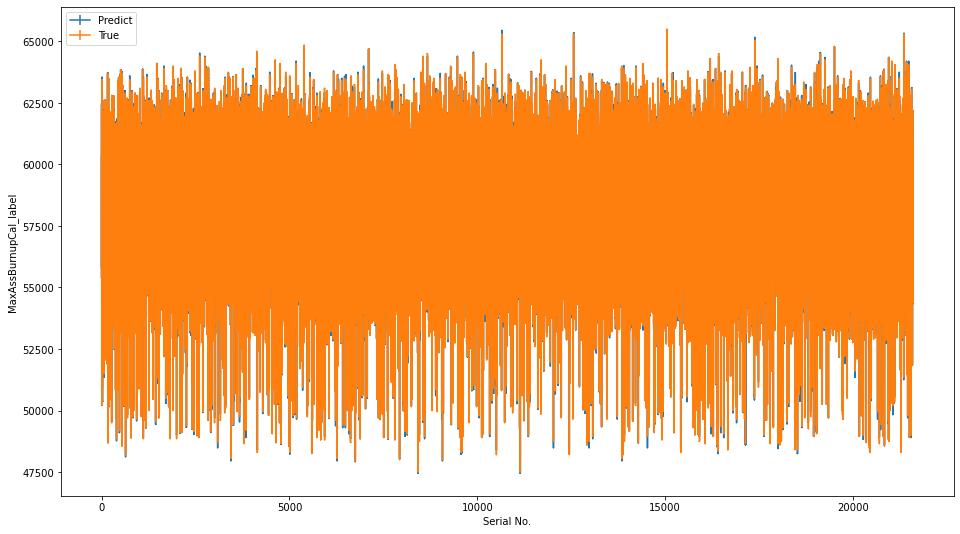

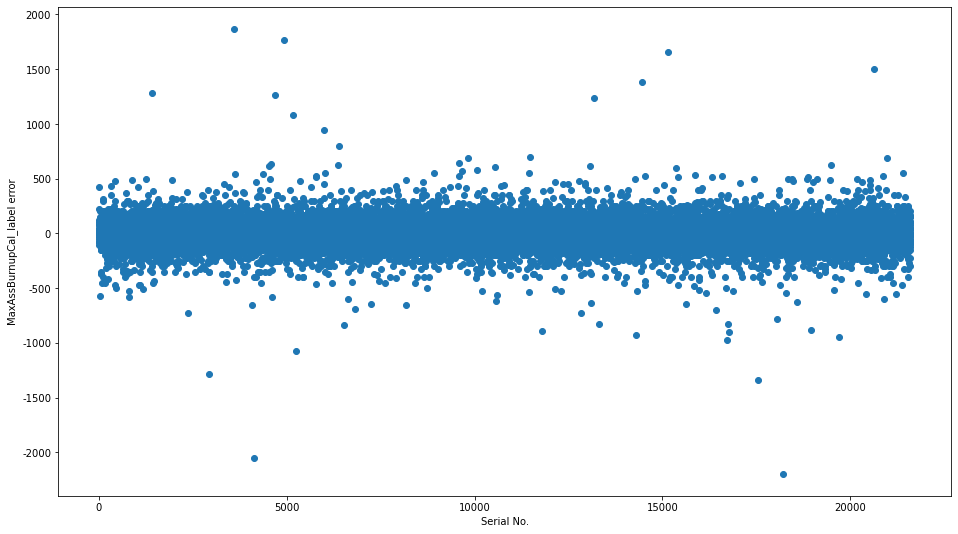

LGB均差得分为： 81.92445846327158


<Figure size 1152x648 with 0 Axes>

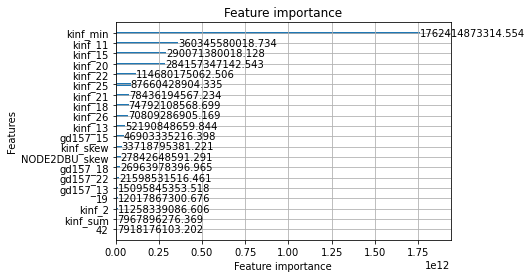

fold 2
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019480 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 26539
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 140
[LightGBM] [Info] Start training from score 58129.224537
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 60.6748	valid_1's l1: 94.8543
[100]	training's l1: 51.8272	valid_1's l1: 84.8495
[150]	training's l1: 50.8868	valid_1's l1: 83.6879
[200]	training's l1: 50.5579	valid_1's l1: 83.3439
[250]	training's l1: 50.3983	valid_1's l1: 83.1971
[300]	training's l1: 50.3126	valid_1's l1: 83.1374
[350]	training's l1: 50.2604	valid_1's l1: 83.1003
[400]	training's l1: 50.2266	valid_1's l1: 83.0877
[450]	training's l1: 50.2038	valid_1's l1: 83.0768
[500]	training's l1: 50.1889	valid_1's l1: 83.0732
[550]	training's l1: 50.1789	valid_1's l1: 83.0718
Early stopping, best 

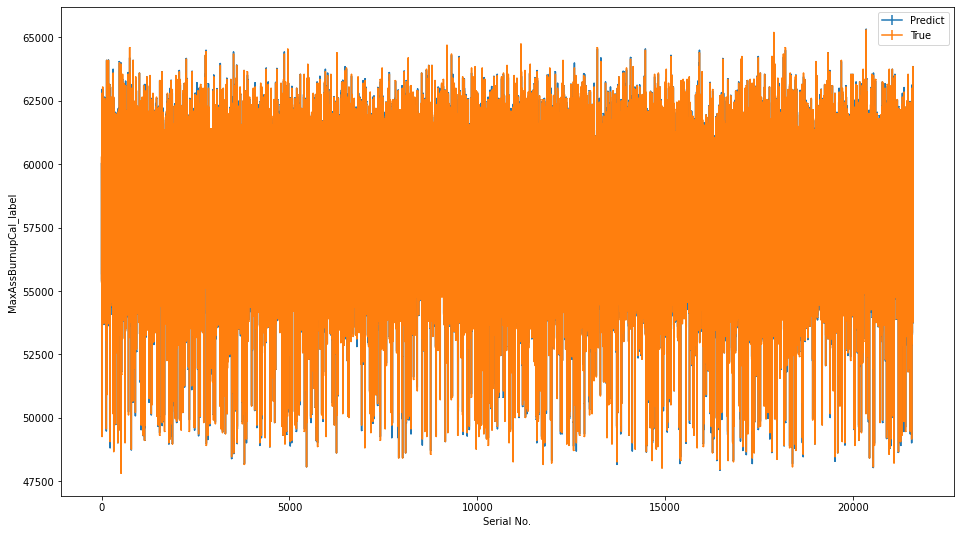

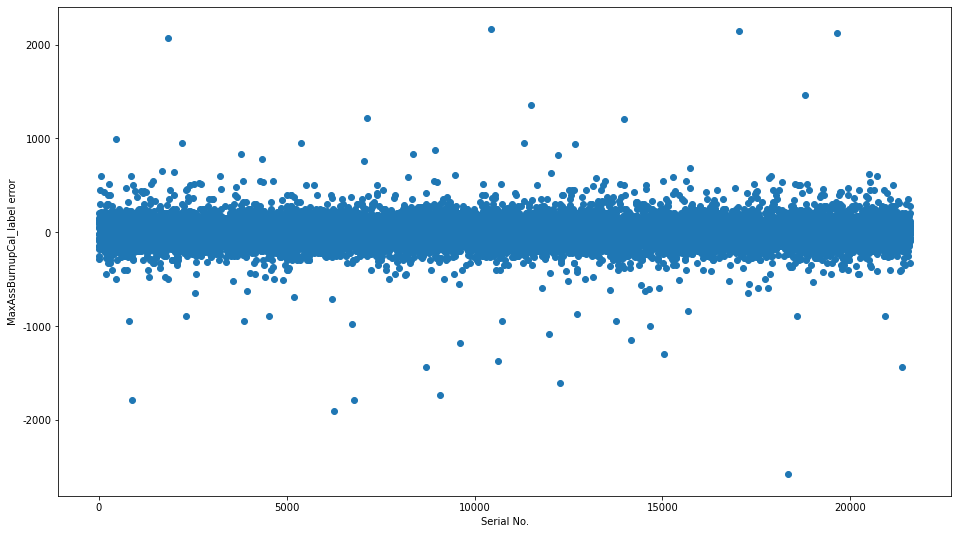

LGB均差得分为： 83.07082664004652


<Figure size 1152x648 with 0 Axes>

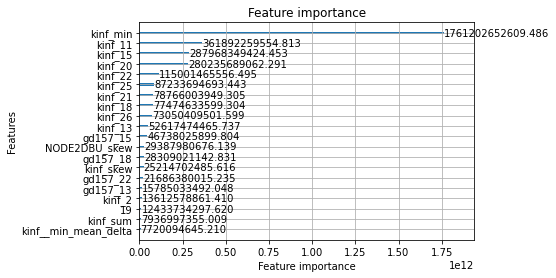

fold 3
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019738 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 26542
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 140
[LightGBM] [Info] Start training from score 58119.564815
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 61.0773	valid_1's l1: 96.0623
[100]	training's l1: 52.0698	valid_1's l1: 85.4414
[150]	training's l1: 51.0627	valid_1's l1: 84.0539
[200]	training's l1: 50.7236	valid_1's l1: 83.5538
[250]	training's l1: 50.558	valid_1's l1: 83.3445
[300]	training's l1: 50.4696	valid_1's l1: 83.2463
[350]	training's l1: 50.4167	valid_1's l1: 83.1984
[400]	training's l1: 50.3831	valid_1's l1: 83.1673
[450]	training's l1: 50.3606	valid_1's l1: 83.1426
[500]	training's l1: 50.3453	valid_1's l1: 83.1283
[550]	training's l1: 50.3342	valid_1's l1: 83.1202
[600]	training's l1: 5

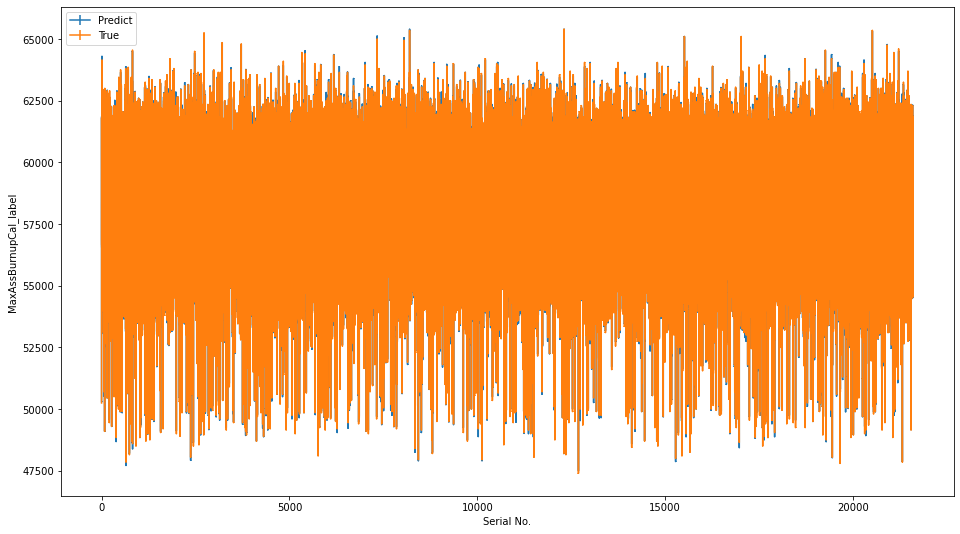

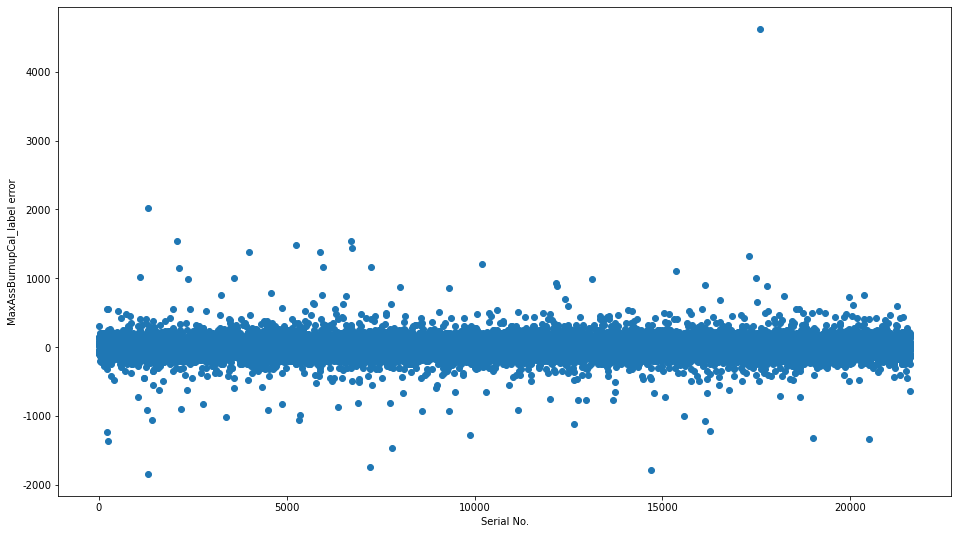

LGB均差得分为： 83.1073101497939


<Figure size 1152x648 with 0 Axes>

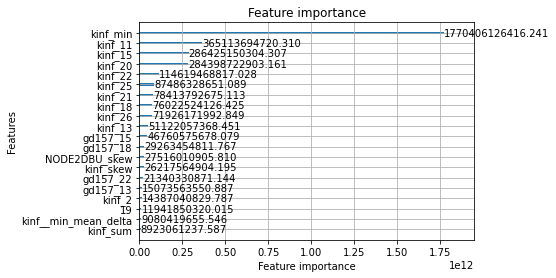

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020645 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 26535
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 140
[LightGBM] [Info] Start training from score 58121.648148
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 61.0207	valid_1's l1: 97.0595
[100]	training's l1: 52.1467	valid_1's l1: 86.1661
[150]	training's l1: 51.1907	valid_1's l1: 84.6709
[200]	training's l1: 50.8657	valid_1's l1: 84.1005
[250]	training's l1: 50.7006	valid_1's l1: 83.8119
[300]	training's l1: 50.6056	valid_1's l1: 83.649
[350]	training's l1: 50.5464	valid_1's l1: 83.5537
[400]	training's l1: 50.5082	valid_1's l1: 83.5011
[450]	training's l1: 50.4833	valid_1's l1: 83.4685
[500]	training's l1: 50.4656	valid_1's l1: 83.4574
[550]	training's l1: 50.4526	valid_1's l1: 83.4468
[600]	training's l1: 5

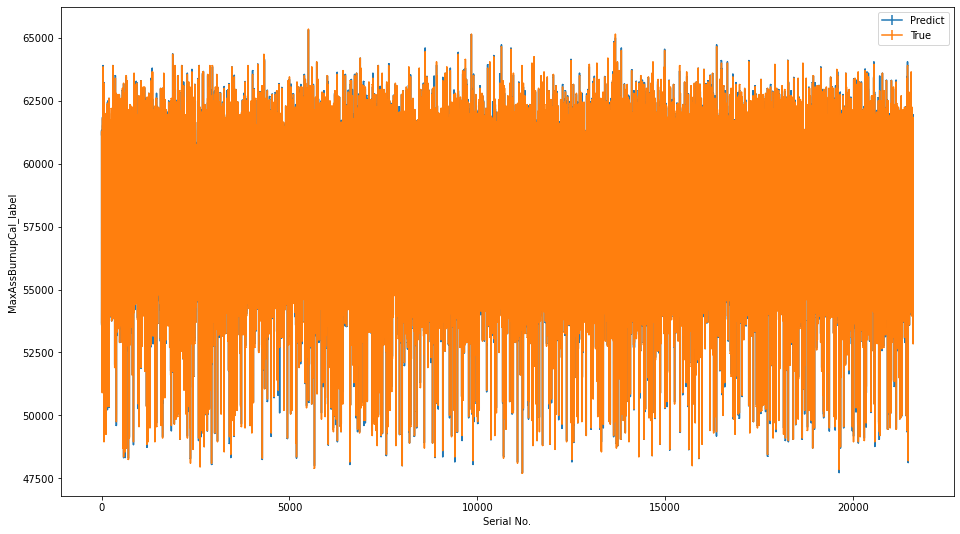

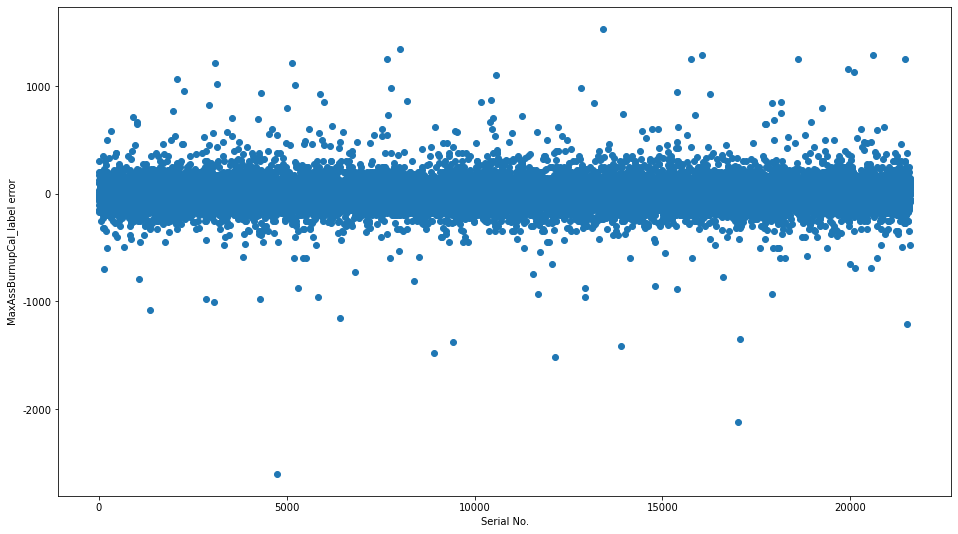

LGB均差得分为： 83.42200446933528


<Figure size 1152x648 with 0 Axes>

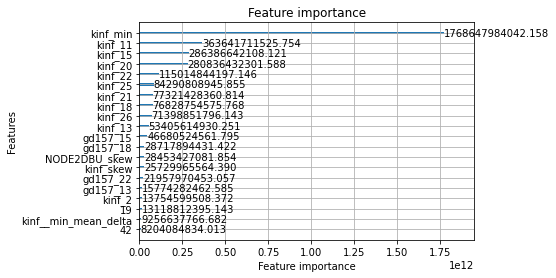

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020442 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 26539
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 140
[LightGBM] [Info] Start training from score 58123.082755
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 61.1235	valid_1's l1: 95.4274
[100]	training's l1: 52.113	valid_1's l1: 84.9989
[150]	training's l1: 51.1237	valid_1's l1: 83.5463
[200]	training's l1: 50.8043	valid_1's l1: 83.0349
[250]	training's l1: 50.6541	valid_1's l1: 82.845
[300]	training's l1: 50.571	valid_1's l1: 82.7582
[350]	training's l1: 50.5197	valid_1's l1: 82.717
[400]	training's l1: 50.4866	valid_1's l1: 82.6998
[450]	training's l1: 50.4629	valid_1's l1: 82.6946
Early stopping, best iteration is:
[449]	training's l1: 50.4634	valid_1's l1: 82.6943
best iteration =  449
*******************

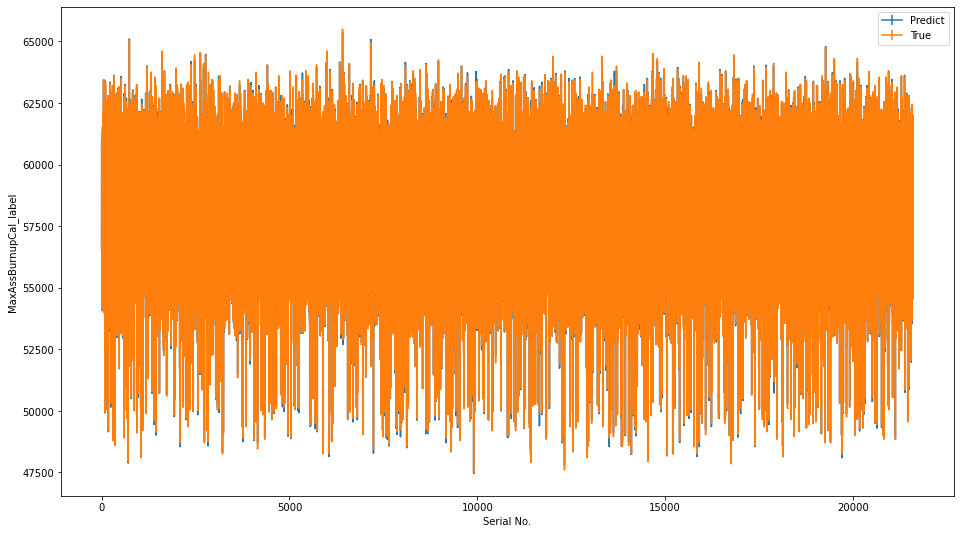

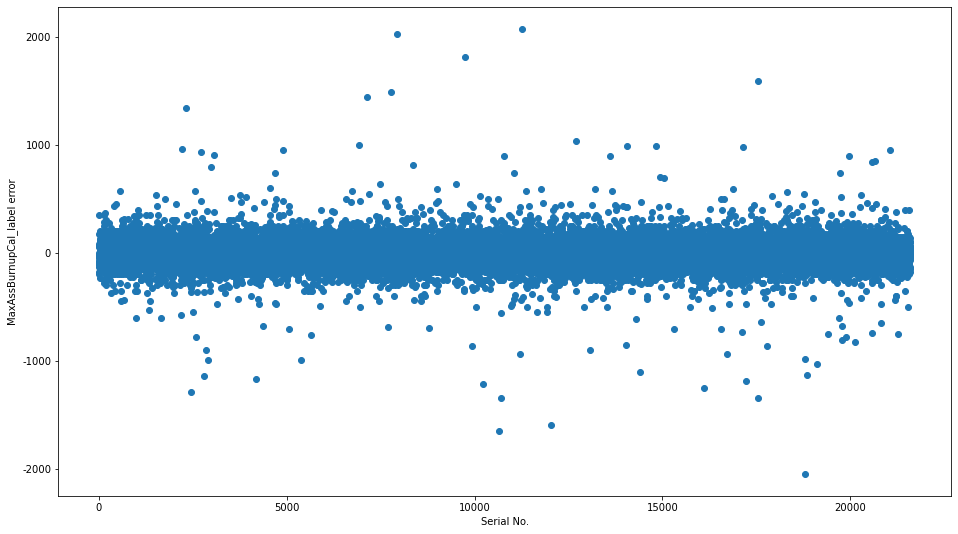

LGB均差得分为： 82.69430780049579


<Figure size 1152x648 with 0 Axes>

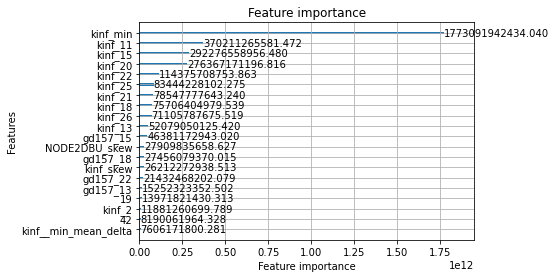

训练数据的shape为： (108000, 140)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019213 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 23264
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 140
[LightGBM] [Info] Start training from score 63196.354167
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 317.853	valid_1's l1: 458.649
Early stopping, best iteration is:
[36]	training's l1: 328.721	valid_1's l1: 454.029
best iteration =  36
****************************************************************************************************


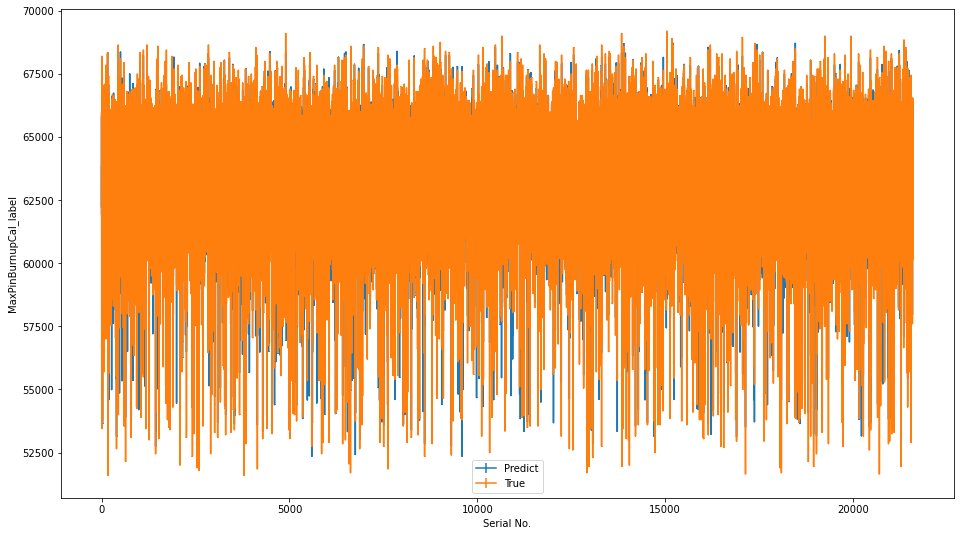

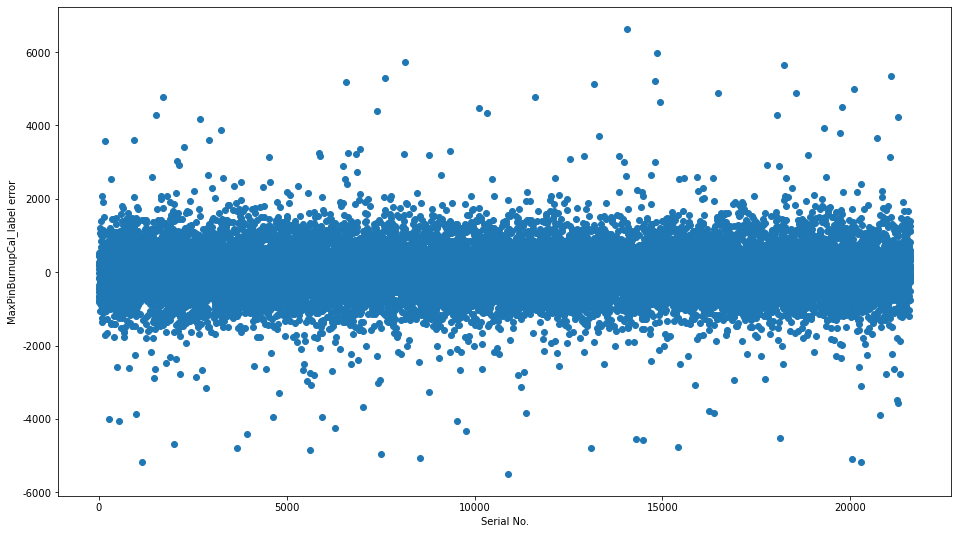

LGB均差得分为： 454.02884446510853


<Figure size 1152x648 with 0 Axes>

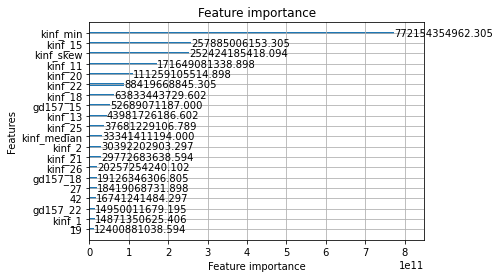

fold 2
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.019953 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 23263
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 140
[LightGBM] [Info] Start training from score 63204.089699
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 318.751	valid_1's l1: 456.142
Early stopping, best iteration is:
[36]	training's l1: 329.555	valid_1's l1: 451.736
best iteration =  36
****************************************************************************************************


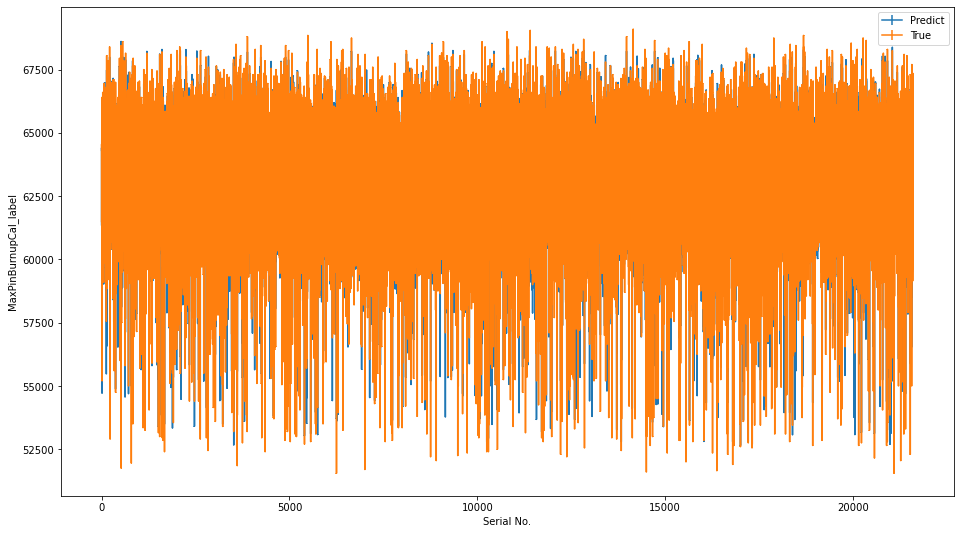

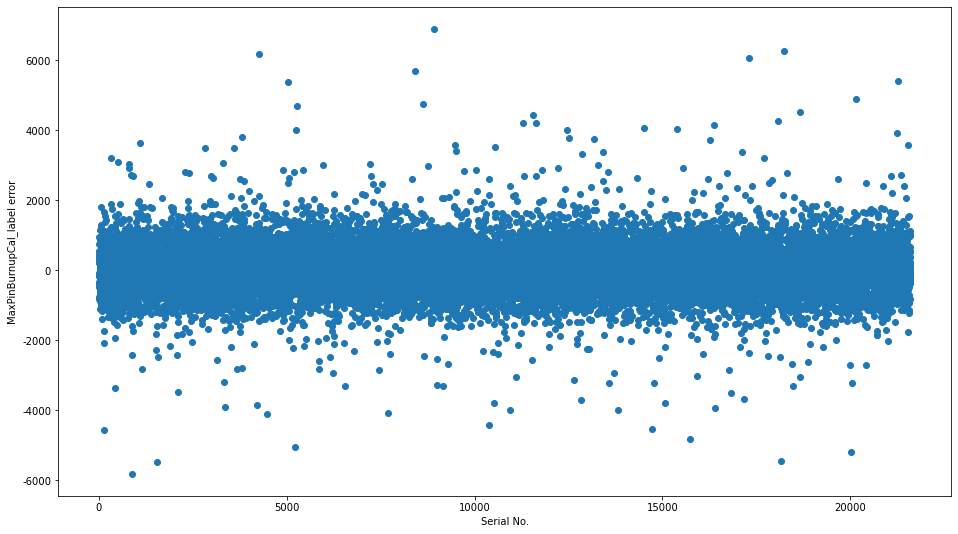

LGB均差得分为： 451.73594544013326


<Figure size 1152x648 with 0 Axes>

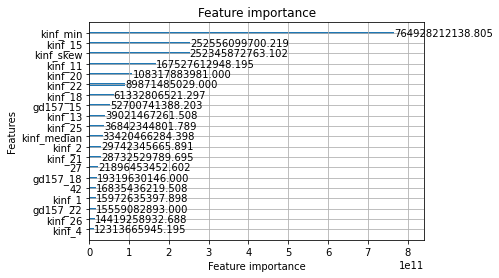

fold 3
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013670 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 23266
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 140
[LightGBM] [Info] Start training from score 63196.660301
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 317.37	valid_1's l1: 462.442
Early stopping, best iteration is:
[36]	training's l1: 328.334	valid_1's l1: 457.992
best iteration =  36
****************************************************************************************************


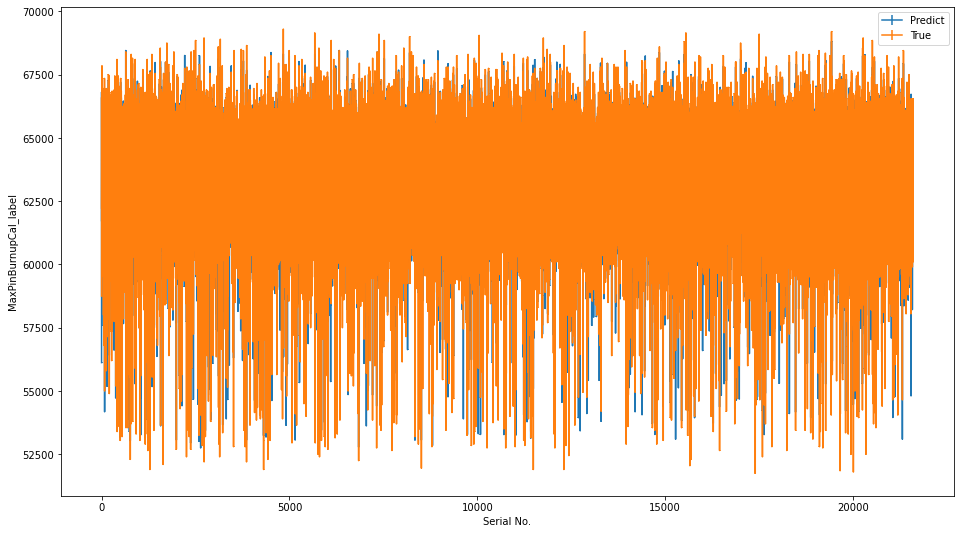

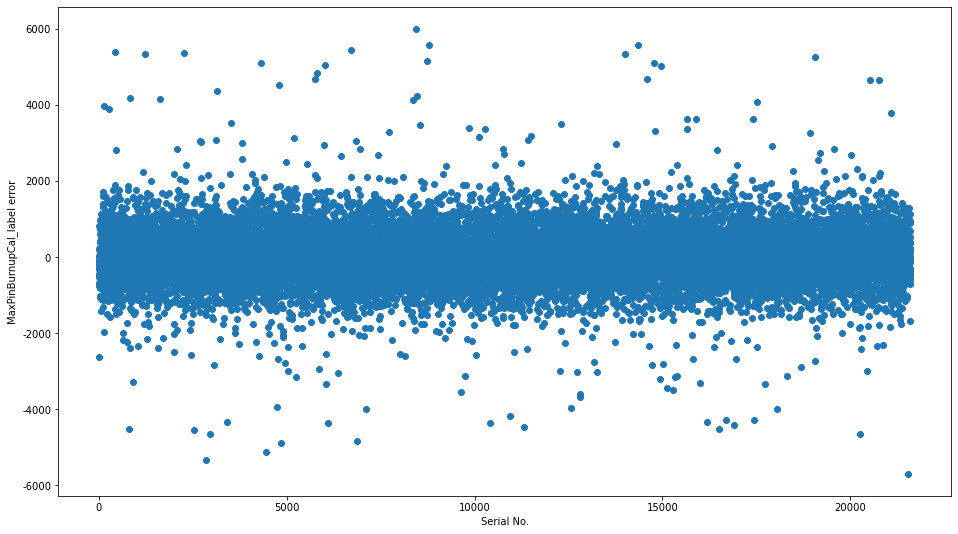

LGB均差得分为： 457.99206857520863


<Figure size 1152x648 with 0 Axes>

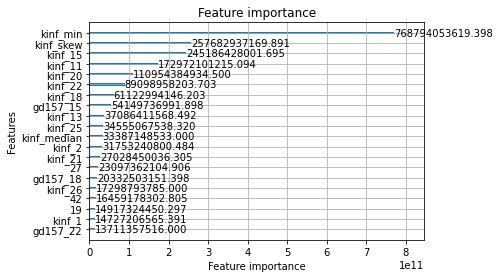

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 23259
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 140
[LightGBM] [Info] Start training from score 63201.919560
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 318.875	valid_1's l1: 457.581
Early stopping, best iteration is:
[37]	training's l1: 328.254	valid_1's l1: 453.739
best iteration =  37
****************************************************************************************************


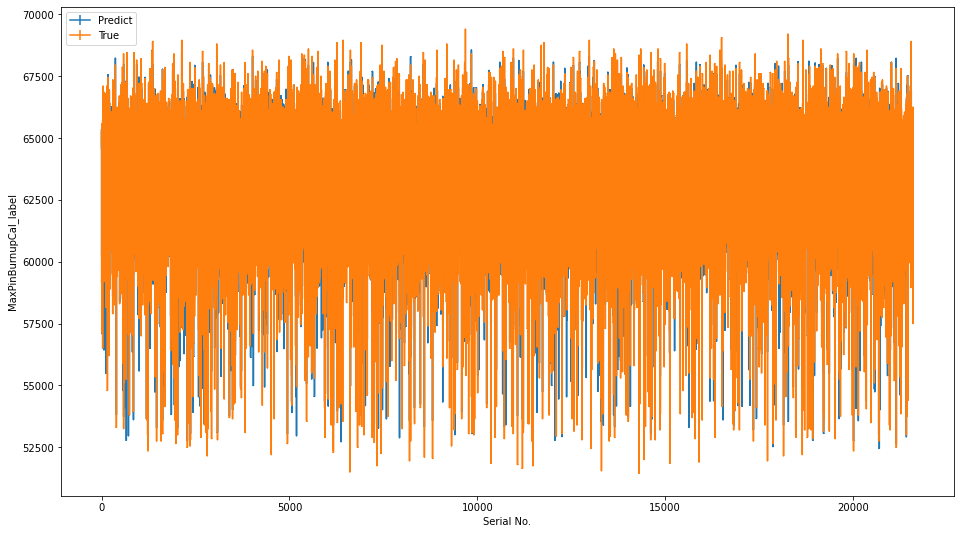

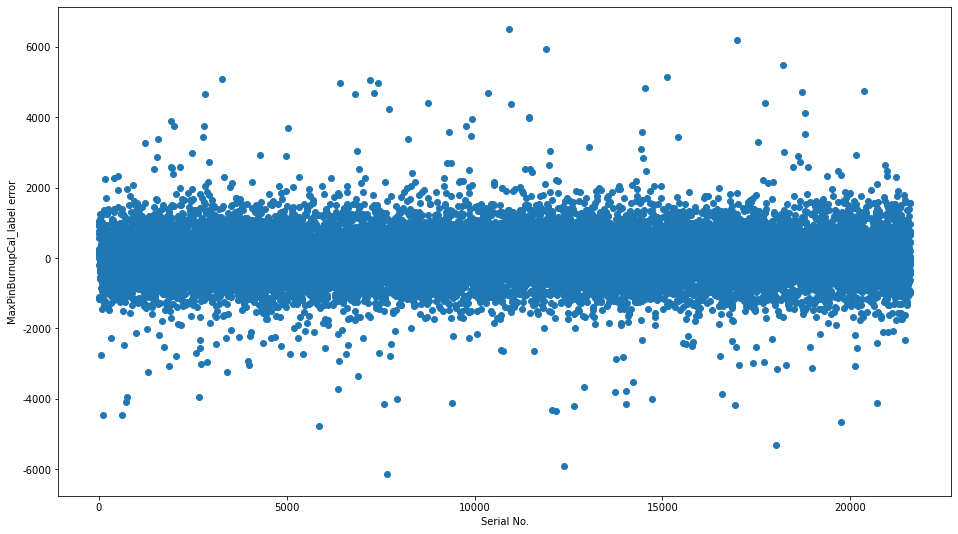

LGB均差得分为： 453.73867972822575


<Figure size 1152x648 with 0 Axes>

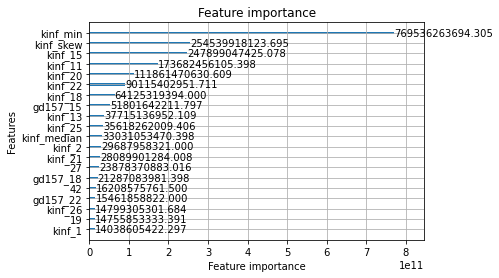

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020364 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 23263
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 140
[LightGBM] [Info] Start training from score 63198.455440
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 318.079	valid_1's l1: 457.566
Early stopping, best iteration is:
[36]	training's l1: 329.05	valid_1's l1: 452.991
best iteration =  36
****************************************************************************************************


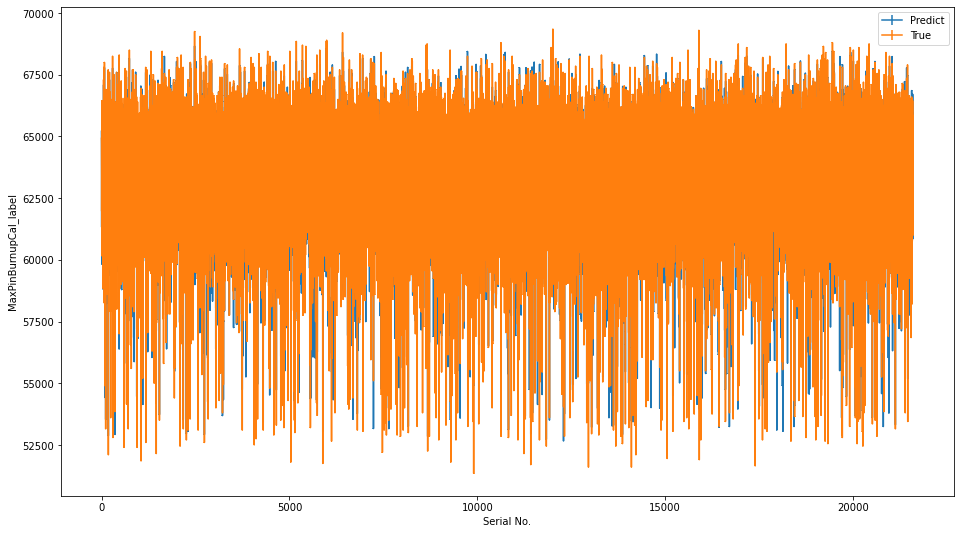

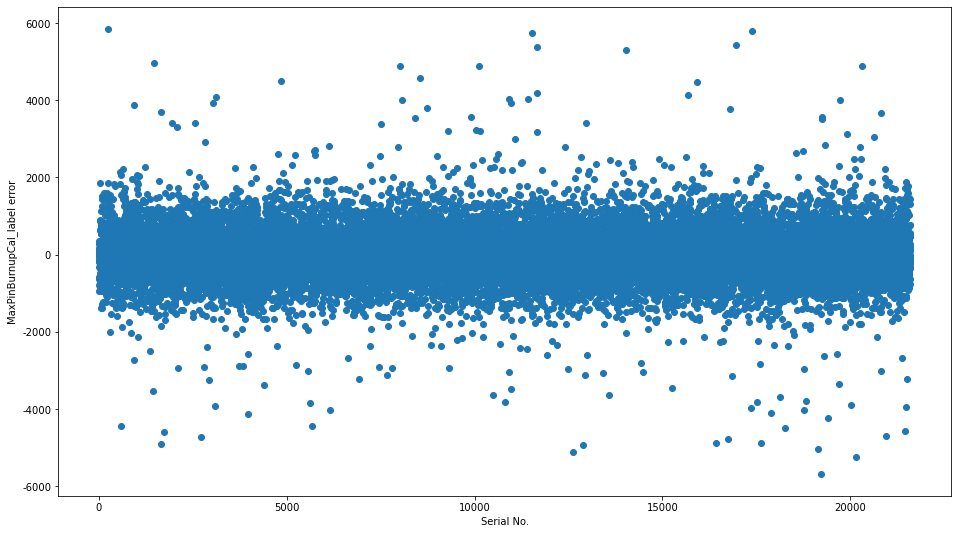

LGB均差得分为： 452.9906208702061


<Figure size 1152x648 with 0 Axes>

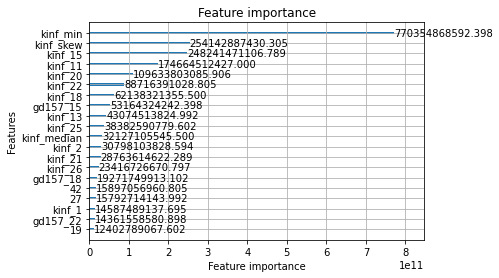

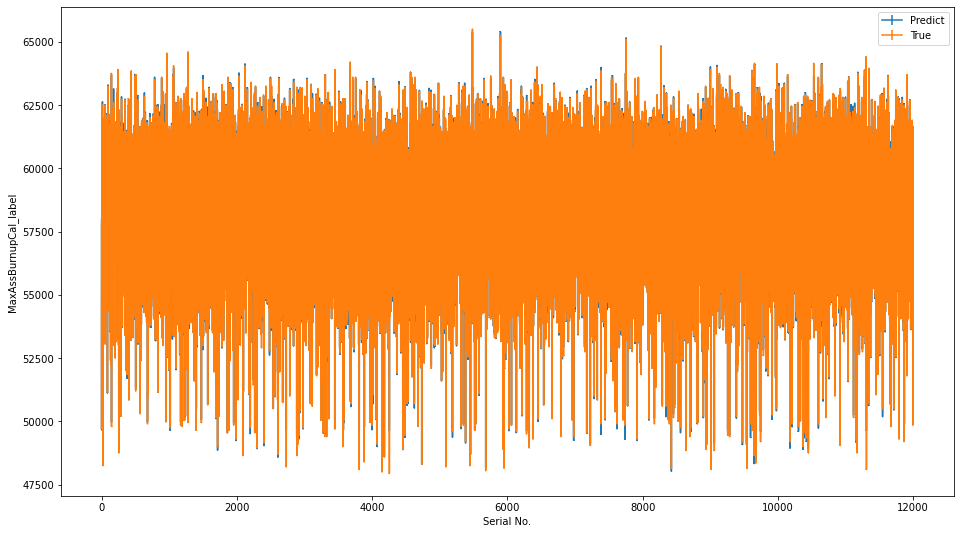

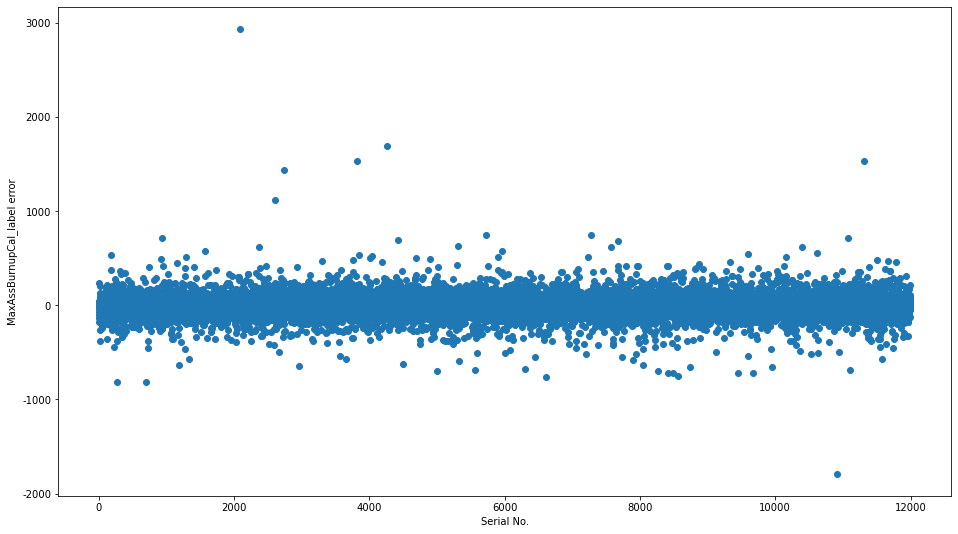

特征数量为140, 目标MaxAssBurnupCal_label的LGB均差得分为：83.67335745881589


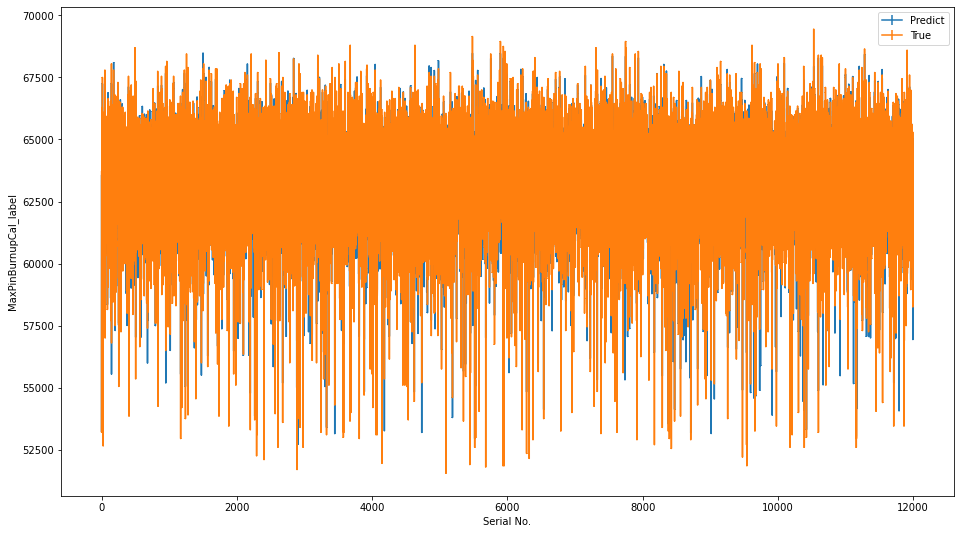

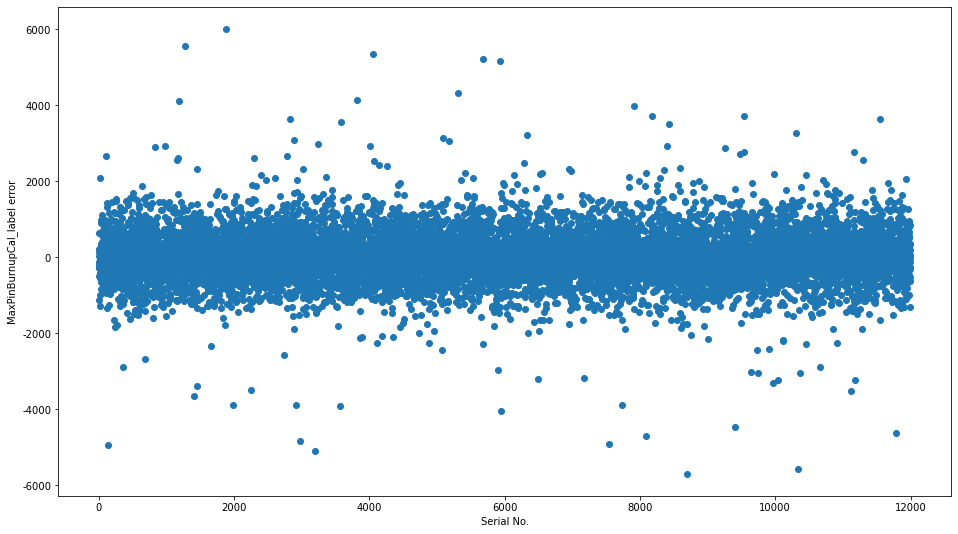

特征数量为140, 目标MaxPinBurnupCal_label的LGB均差得分为：445.45883703168806
训练数据的shape为： (108000, 180)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.027771 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36740
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 180
[LightGBM] [Info] Start training from score 58120.146412
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 60.3851	valid_1's l1: 94.0075
[100]	training's l1: 51.937	valid_1's l1: 84.1411
[150]	training's l1: 50.9771	valid_1's l1: 82.9354
[200]	training's l1: 50.6546	valid_1's l1: 82.5051
[250]	training's l1: 50.5065	valid_1's l1: 82.2885
[300]	training's l1: 50.4259	valid_1's l1: 82.1635
[350]	training's l1: 50.3796	valid_1's l1: 82.0875
[400]	training's l1: 50.349	valid_1's l1: 82.0459
[450]	training's l1: 50.3287	valid_1's l1: 82.0231
[500]	training's l1: 50.3137	valid_1

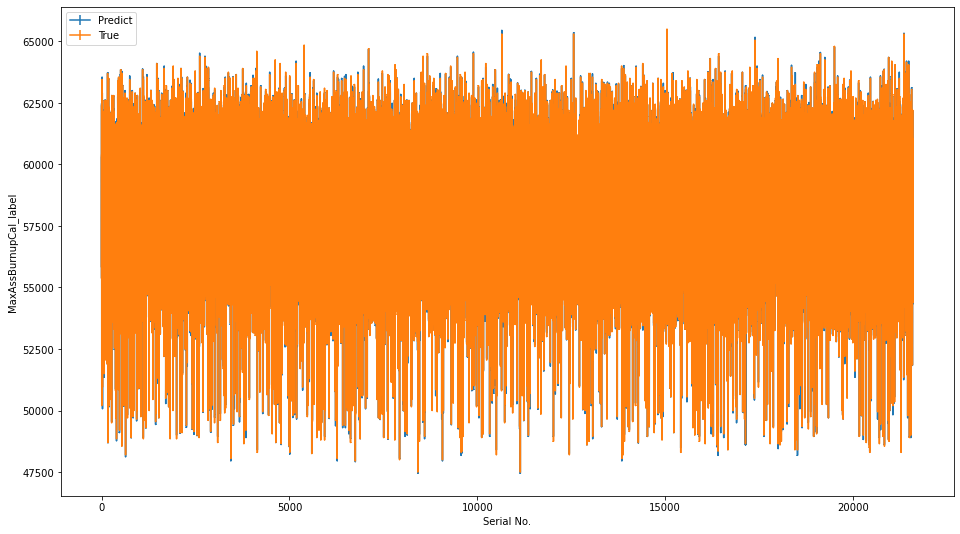

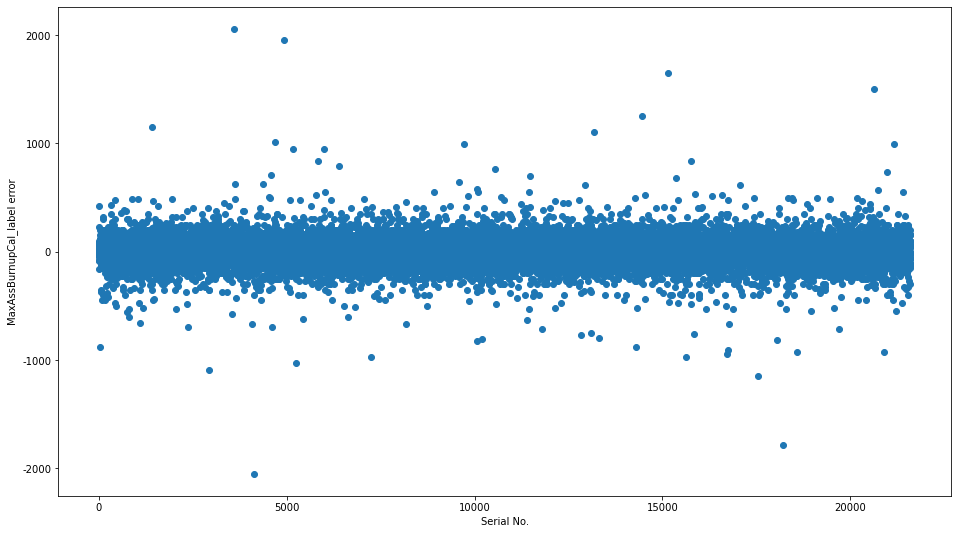

LGB均差得分为： 81.97480271321172


<Figure size 1152x648 with 0 Axes>

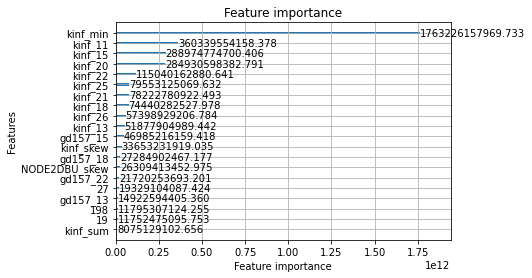

fold 2
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025447 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36739
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 180
[LightGBM] [Info] Start training from score 58129.224537
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 59.703	valid_1's l1: 94.4499
[100]	training's l1: 51.676	valid_1's l1: 85.4431
[150]	training's l1: 50.8027	valid_1's l1: 84.4063
[200]	training's l1: 50.5059	valid_1's l1: 84.0582
[250]	training's l1: 50.3662	valid_1's l1: 83.9104
[300]	training's l1: 50.2869	valid_1's l1: 83.8425
[350]	training's l1: 50.2415	valid_1's l1: 83.8098
[400]	training's l1: 50.2126	valid_1's l1: 83.7892
[450]	training's l1: 50.1938	valid_1's l1: 83.7737
[500]	training's l1: 50.1812	valid_1's l1: 83.7665
[550]	training's l1: 50.1723	valid_1's l1: 83.7628
[600]	training's l1: 50

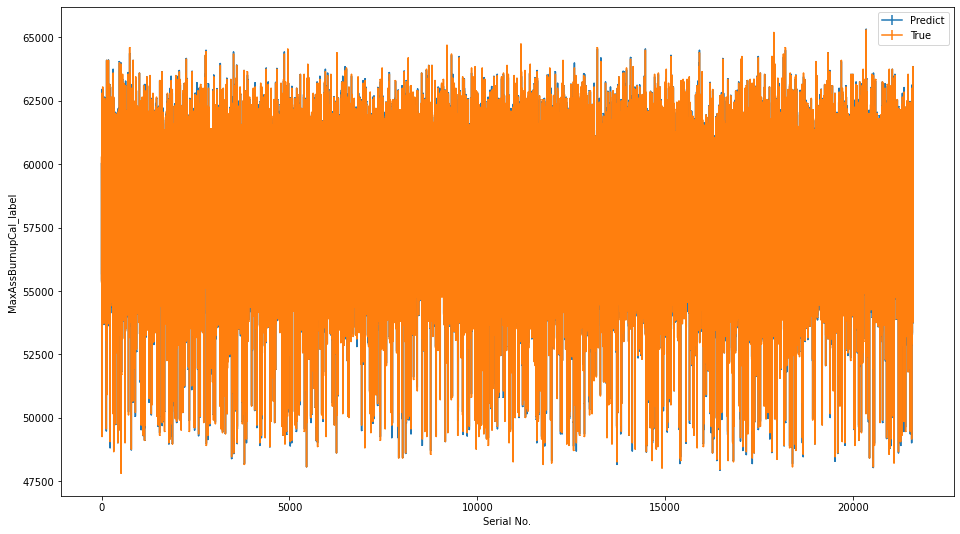

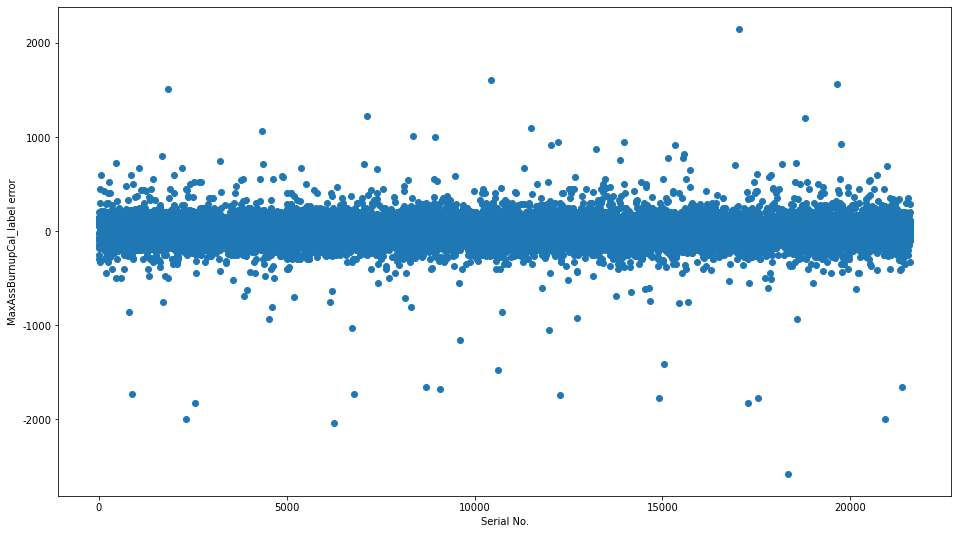

LGB均差得分为： 83.76058140601711


<Figure size 1152x648 with 0 Axes>

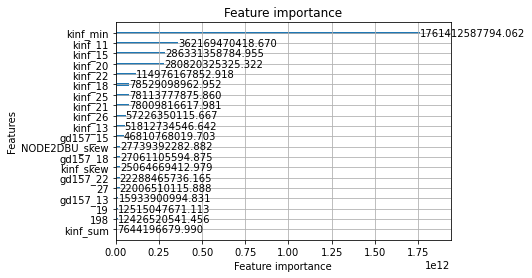

fold 3
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025216 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36742
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 180
[LightGBM] [Info] Start training from score 58119.564815
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 60.2942	valid_1's l1: 94.8439
[100]	training's l1: 51.9296	valid_1's l1: 84.8887
[150]	training's l1: 50.9787	valid_1's l1: 83.5826
[200]	training's l1: 50.6623	valid_1's l1: 83.1934
[250]	training's l1: 50.5162	valid_1's l1: 83.0078
[300]	training's l1: 50.4394	valid_1's l1: 82.9229
[350]	training's l1: 50.3951	valid_1's l1: 82.8912
[400]	training's l1: 50.366	valid_1's l1: 82.8736
[450]	training's l1: 50.3475	valid_1's l1: 82.8646
[500]	training's l1: 50.3345	valid_1's l1: 82.8582
[550]	training's l1: 50.3246	valid_1's l1: 82.8546
[600]	training's l1: 5

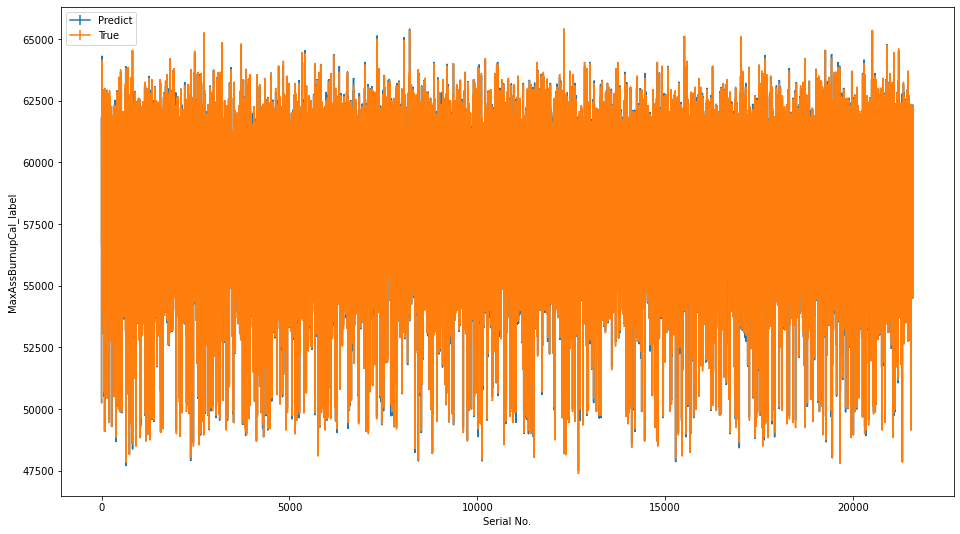

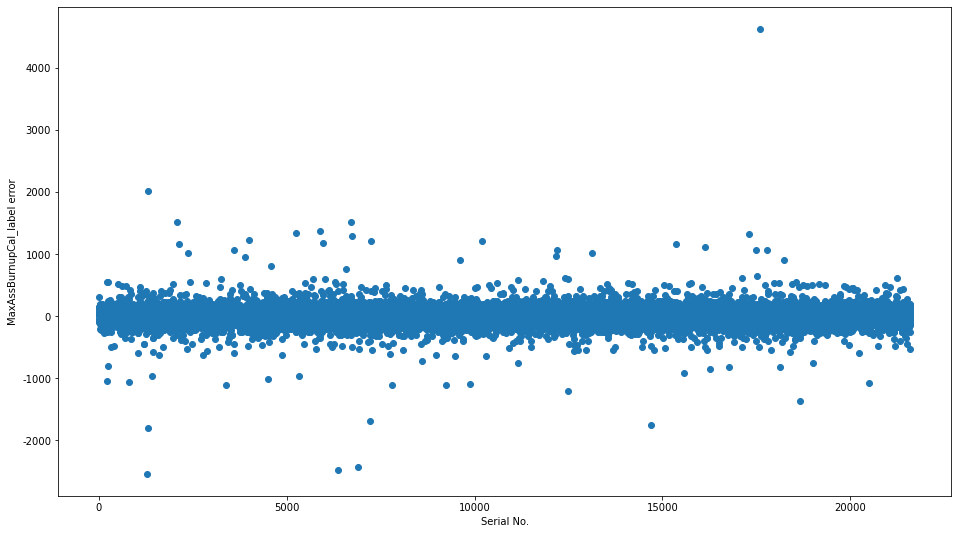

LGB均差得分为： 82.84983042331501


<Figure size 1152x648 with 0 Axes>

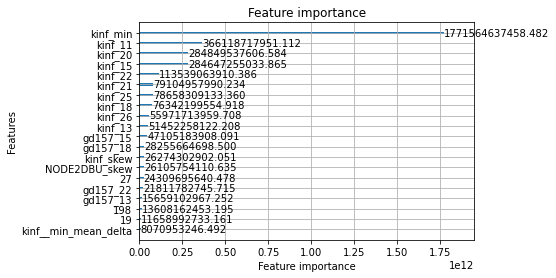

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025378 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36735
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 180
[LightGBM] [Info] Start training from score 58121.648148
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 60.2634	valid_1's l1: 95.9293
[100]	training's l1: 52.0271	valid_1's l1: 86.1732
[150]	training's l1: 51.0995	valid_1's l1: 84.823
[200]	training's l1: 50.783	valid_1's l1: 84.3423
[250]	training's l1: 50.6349	valid_1's l1: 84.138
[300]	training's l1: 50.5551	valid_1's l1: 84.0451
[350]	training's l1: 50.508	valid_1's l1: 83.9987
[400]	training's l1: 50.4798	valid_1's l1: 83.9732
[450]	training's l1: 50.4596	valid_1's l1: 83.959
[500]	training's l1: 50.4458	valid_1's l1: 83.9511
[550]	training's l1: 50.436	valid_1's l1: 83.9437
[600]	training's l1: 50.428

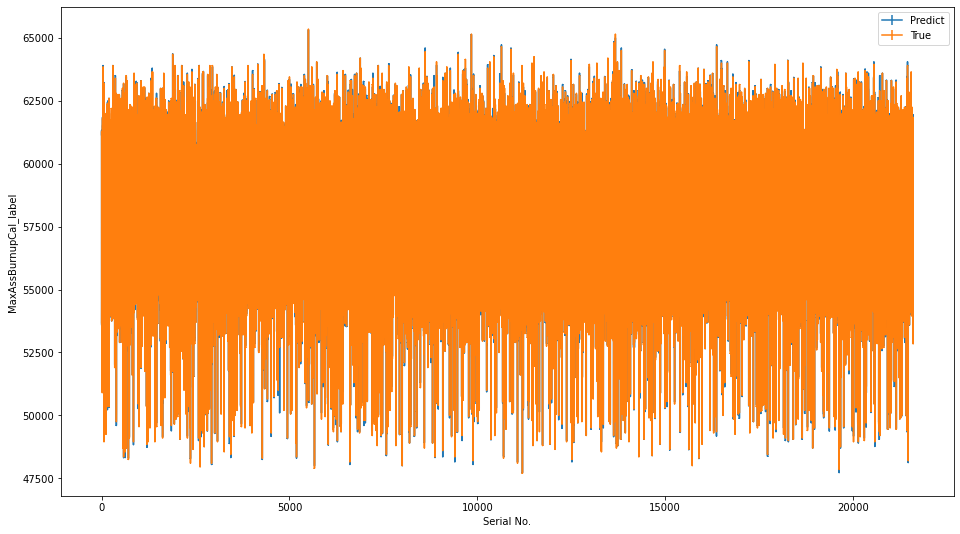

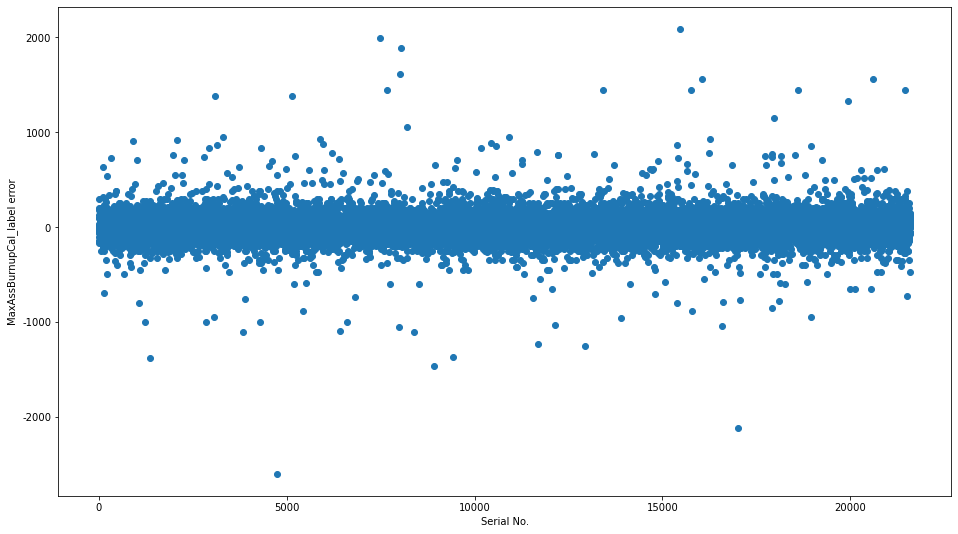

LGB均差得分为： 83.92174545543307


<Figure size 1152x648 with 0 Axes>

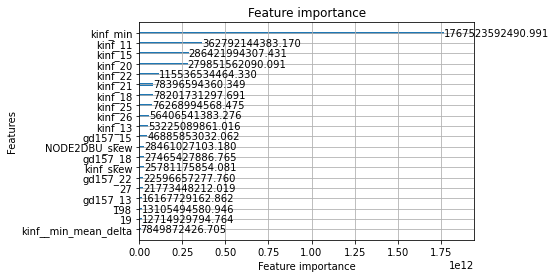

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.027693 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 36739
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 180
[LightGBM] [Info] Start training from score 58123.082755
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 60.1644	valid_1's l1: 94.7595
[100]	training's l1: 51.9542	valid_1's l1: 85.0784
[150]	training's l1: 51.0496	valid_1's l1: 83.7465
[200]	training's l1: 50.7566	valid_1's l1: 83.2714
[250]	training's l1: 50.622	valid_1's l1: 83.0956
[300]	training's l1: 50.5458	valid_1's l1: 83.0134
[350]	training's l1: 50.5007	valid_1's l1: 82.9734
[400]	training's l1: 50.4711	valid_1's l1: 82.9475
[450]	training's l1: 50.451	valid_1's l1: 82.9331
[500]	training's l1: 50.4368	valid_1's l1: 82.9274
[550]	training's l1: 50.4267	valid_1's l1: 82.9248
[600]	training's l1: 50

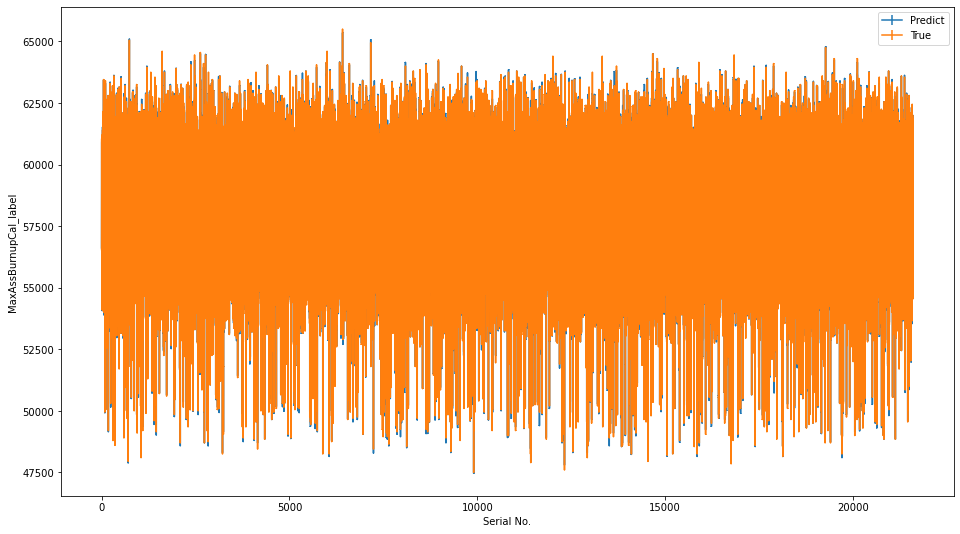

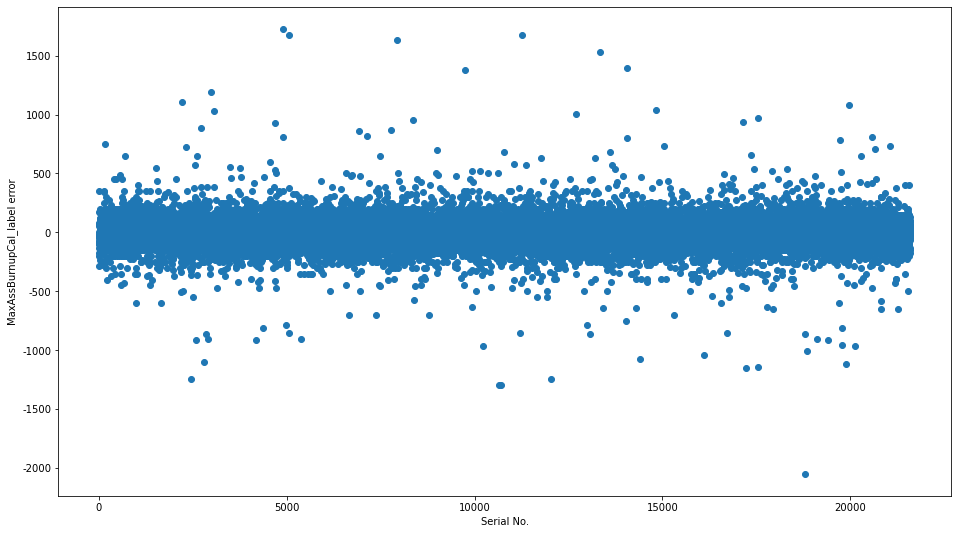

LGB均差得分为： 82.9184498420349


<Figure size 1152x648 with 0 Axes>

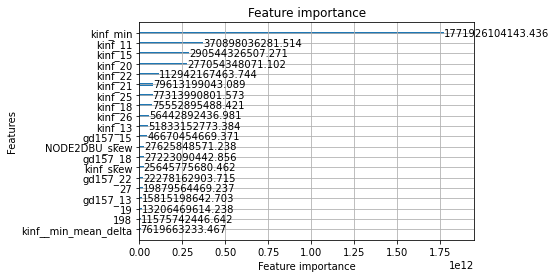

训练数据的shape为： (108000, 180)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025184 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 33464
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 180
[LightGBM] [Info] Start training from score 63196.354167
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 317.342	valid_1's l1: 459.625
Early stopping, best iteration is:
[36]	training's l1: 327.72	valid_1's l1: 455.058
best iteration =  36
****************************************************************************************************


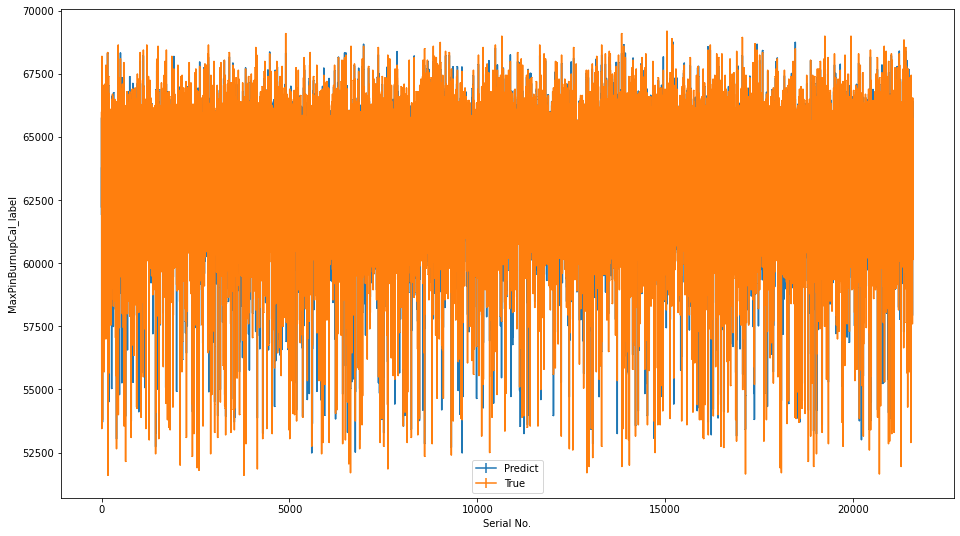

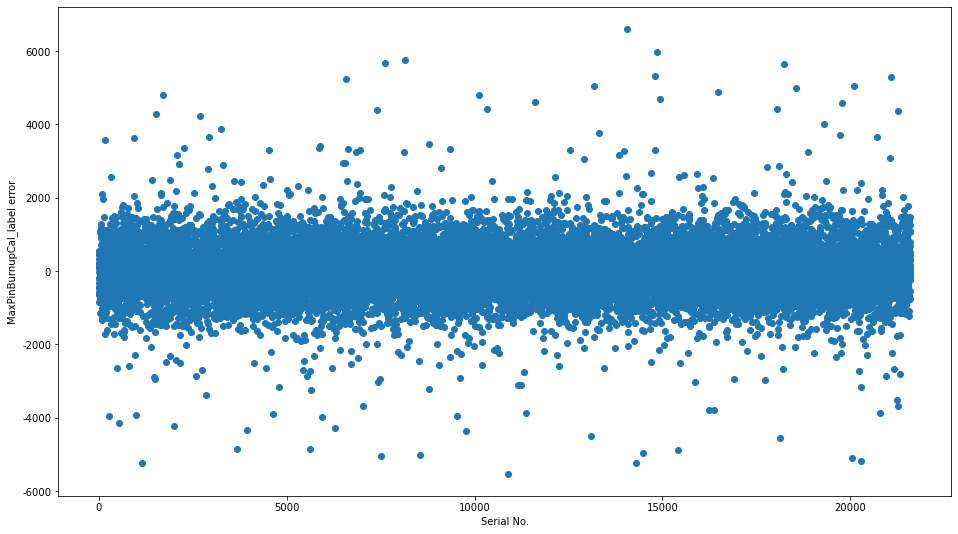

LGB均差得分为： 455.0583971888992


<Figure size 1152x648 with 0 Axes>

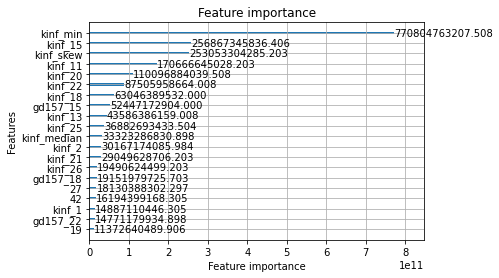

fold 2
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024927 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 33463
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 180
[LightGBM] [Info] Start training from score 63204.089699
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 318.184	valid_1's l1: 457.946
Early stopping, best iteration is:
[36]	training's l1: 328.591	valid_1's l1: 453.698
best iteration =  36
****************************************************************************************************


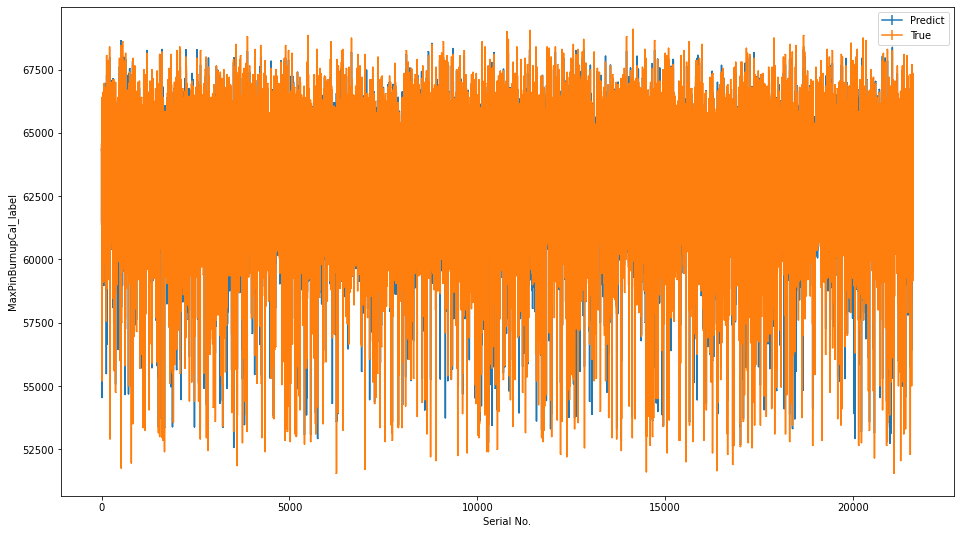

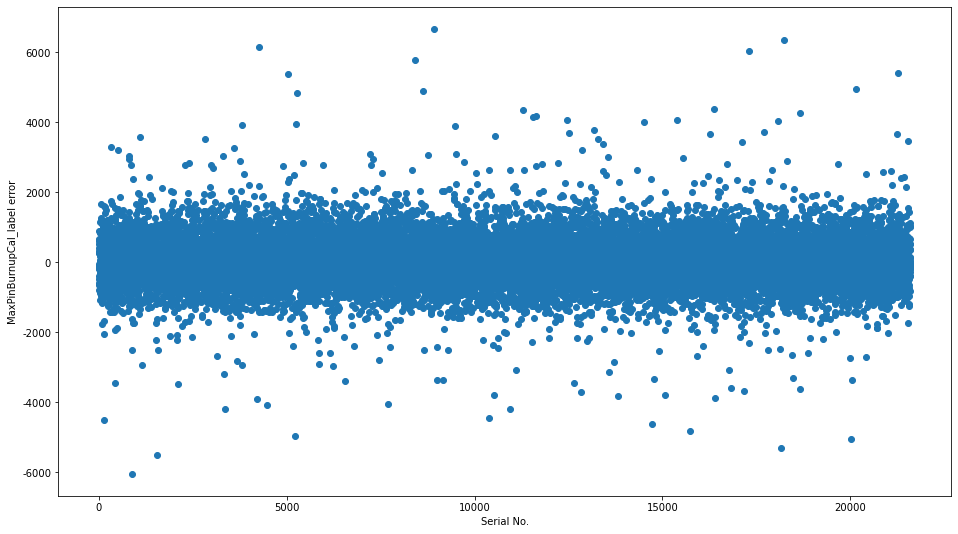

LGB均差得分为： 453.69816158105135


<Figure size 1152x648 with 0 Axes>

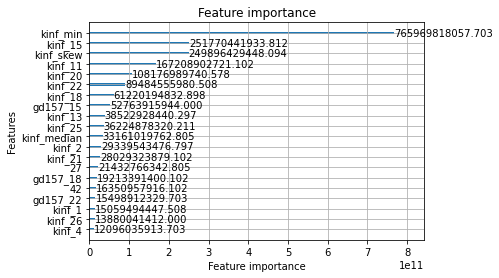

fold 3
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.025692 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 33466
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 180
[LightGBM] [Info] Start training from score 63196.660301
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 316.764	valid_1's l1: 464.507
Early stopping, best iteration is:
[37]	training's l1: 325.912	valid_1's l1: 460.407
best iteration =  37
****************************************************************************************************


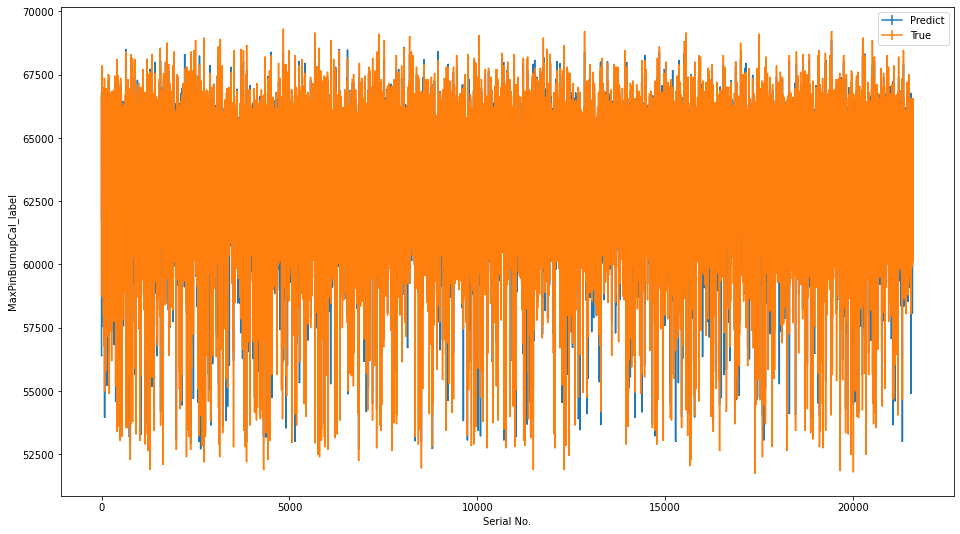

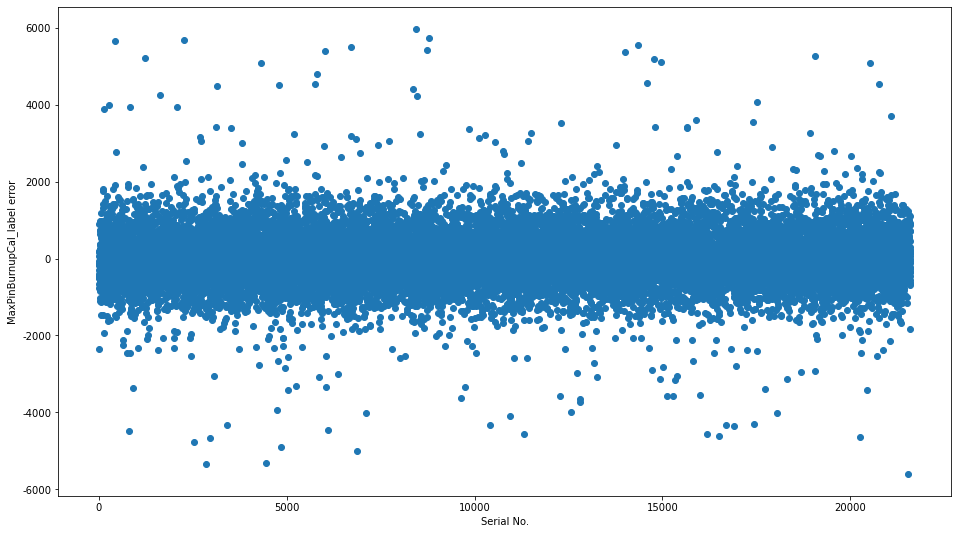

LGB均差得分为： 460.4065232989485


<Figure size 1152x648 with 0 Axes>

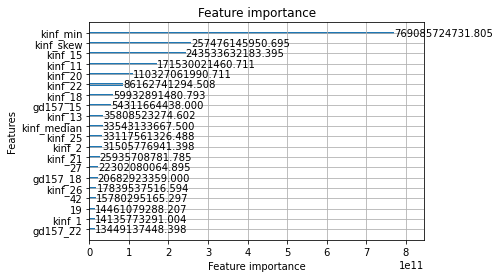

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024894 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 33459
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 180
[LightGBM] [Info] Start training from score 63201.919560
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 318.254	valid_1's l1: 459.56
Early stopping, best iteration is:
[37]	training's l1: 327.16	valid_1's l1: 456.049
best iteration =  37
****************************************************************************************************


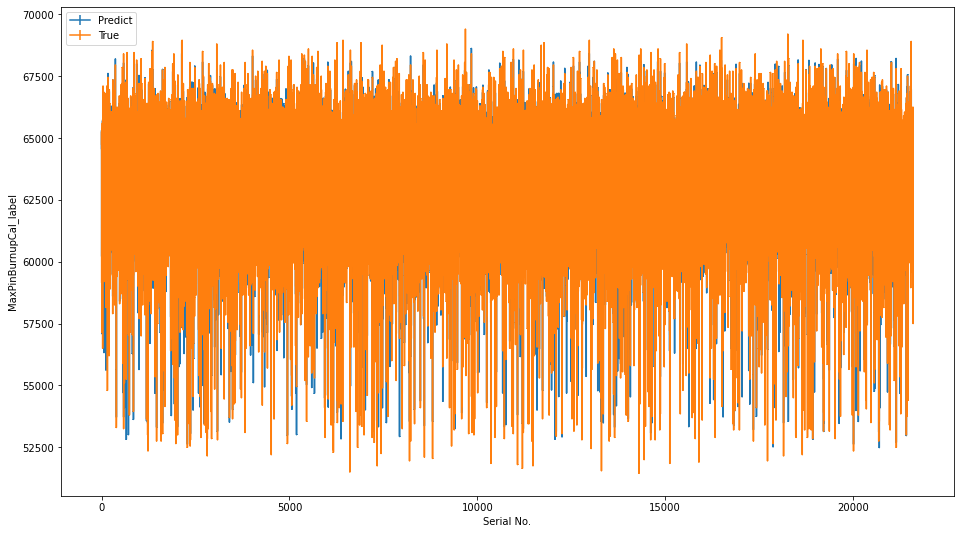

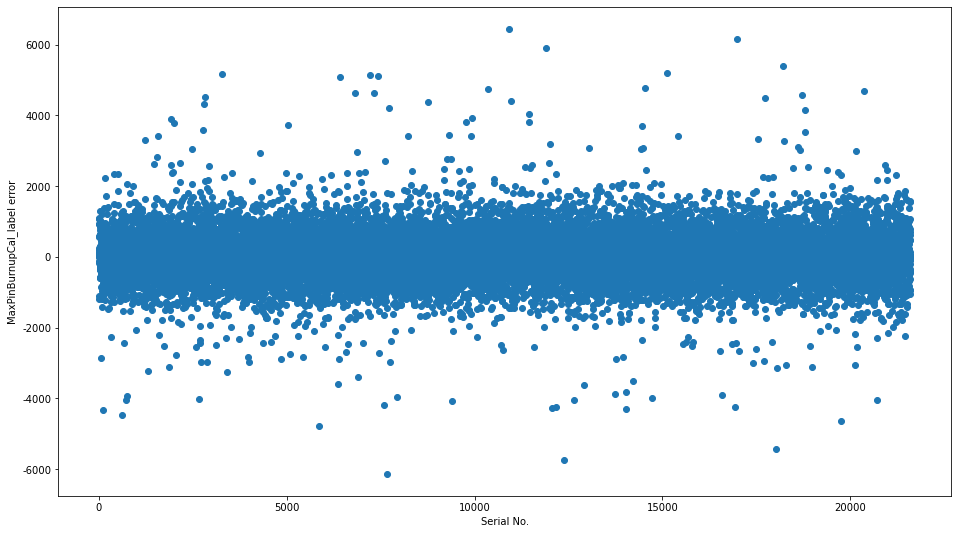

LGB均差得分为： 456.0485784917497


<Figure size 1152x648 with 0 Axes>

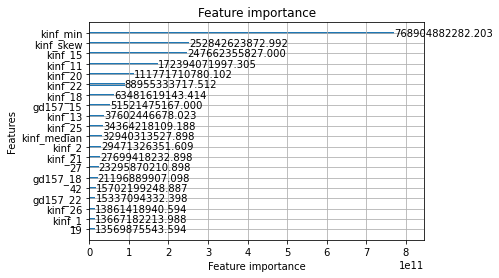

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024921 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 33463
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 180
[LightGBM] [Info] Start training from score 63198.455440
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 317.442	valid_1's l1: 459.692
Early stopping, best iteration is:
[36]	training's l1: 327.866	valid_1's l1: 455.257
best iteration =  36
****************************************************************************************************


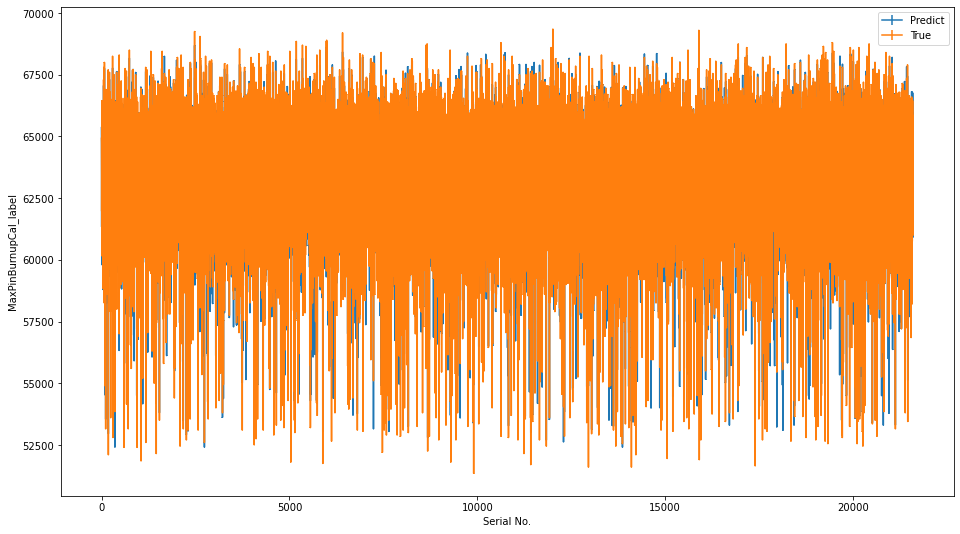

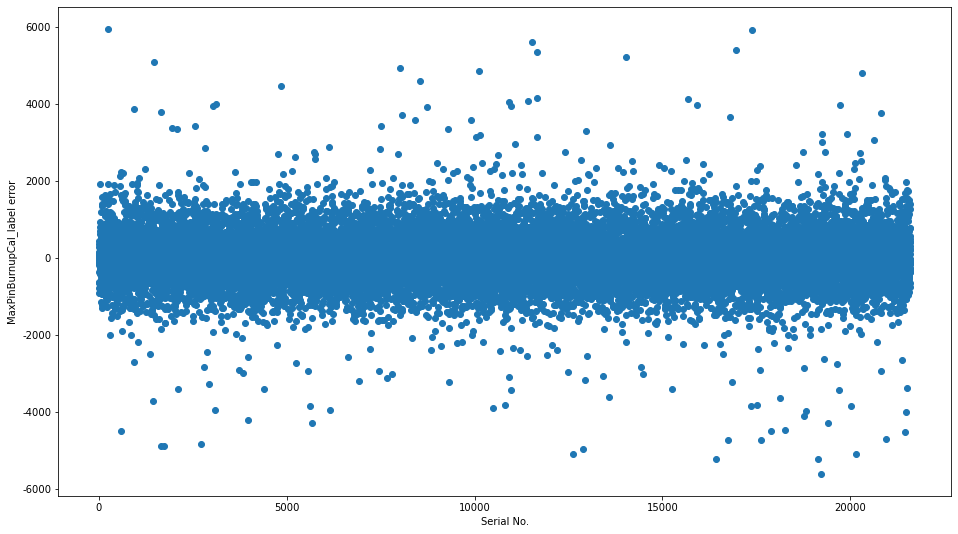

LGB均差得分为： 455.25657550569105


<Figure size 1152x648 with 0 Axes>

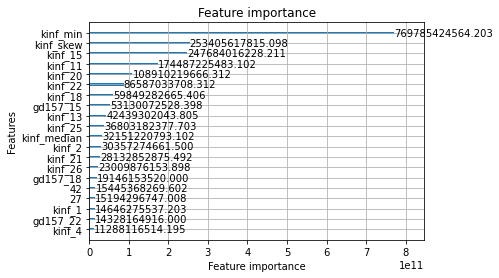

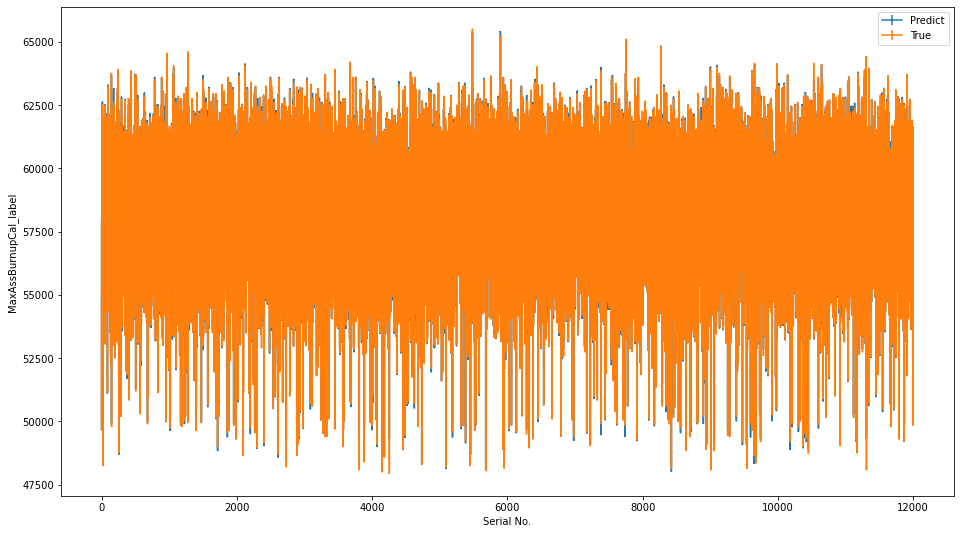

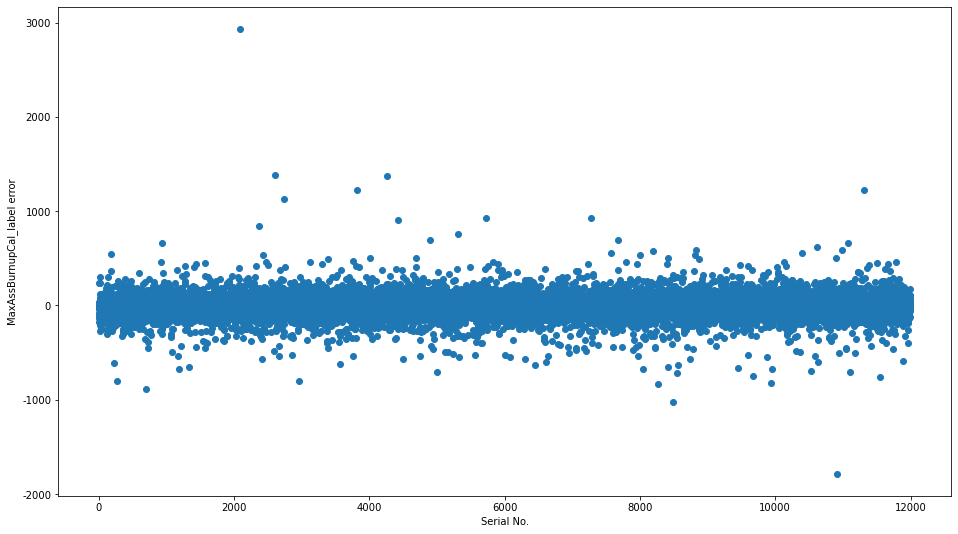

特征数量为180, 目标MaxAssBurnupCal_label的LGB均差得分为：85.65313926001825


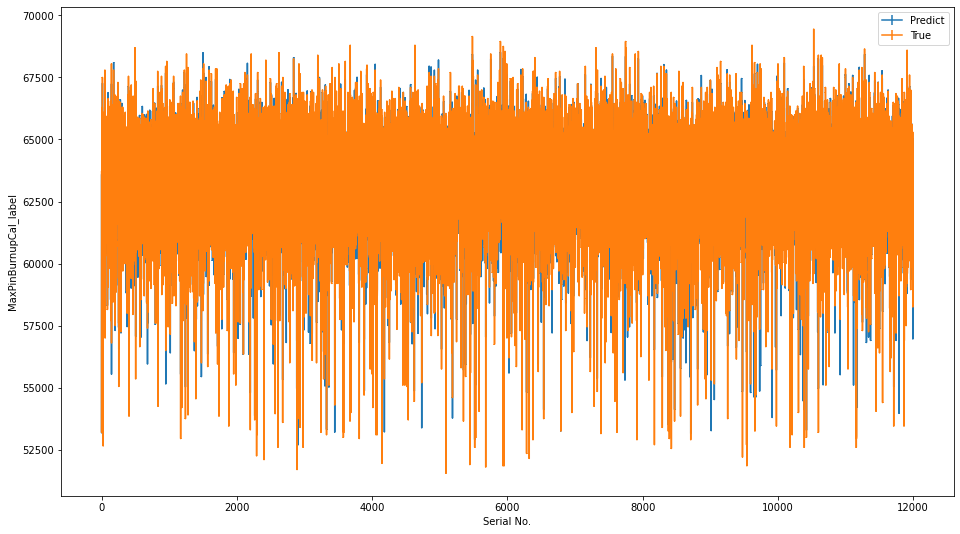

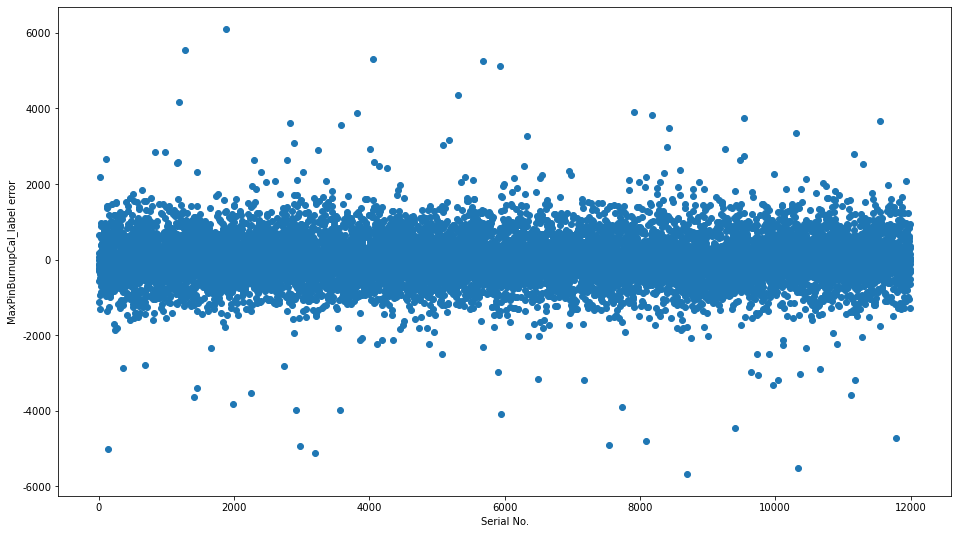

特征数量为180, 目标MaxPinBurnupCal_label的LGB均差得分为：446.9483027915565
训练数据的shape为： (108000, 220)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031395 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 46940
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 220
[LightGBM] [Info] Start training from score 58120.146412
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 59.8693	valid_1's l1: 93.5107
[100]	training's l1: 51.8781	valid_1's l1: 84.2333
[150]	training's l1: 50.9383	valid_1's l1: 82.9522
[200]	training's l1: 50.6282	valid_1's l1: 82.4999
[250]	training's l1: 50.4875	valid_1's l1: 82.2954
[300]	training's l1: 50.41	valid_1's l1: 82.183
[350]	training's l1: 50.365	valid_1's l1: 82.117
[400]	training's l1: 50.3352	valid_1's l1: 82.0731
[450]	training's l1: 50.3152	valid_1's l1: 82.0561
[500]	training's l1: 50.3009	valid_1's l

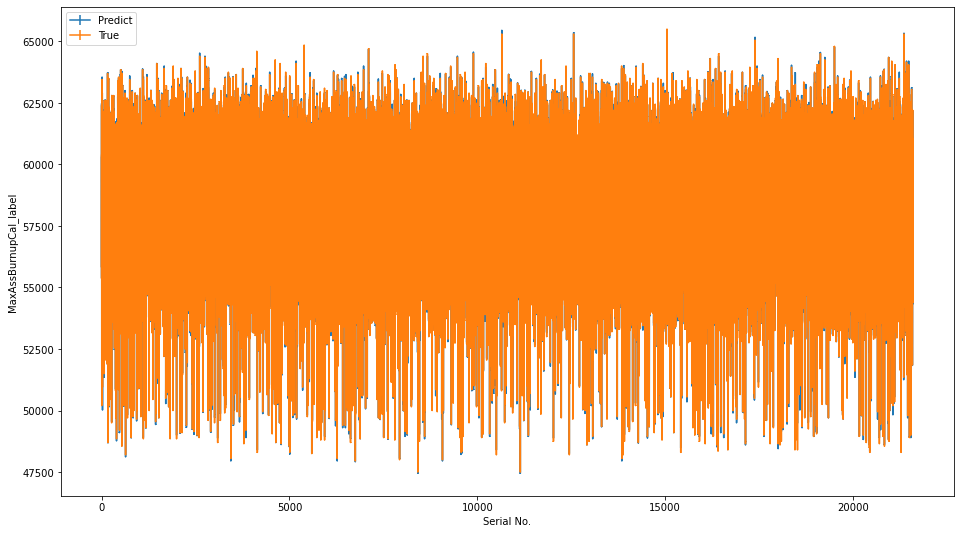

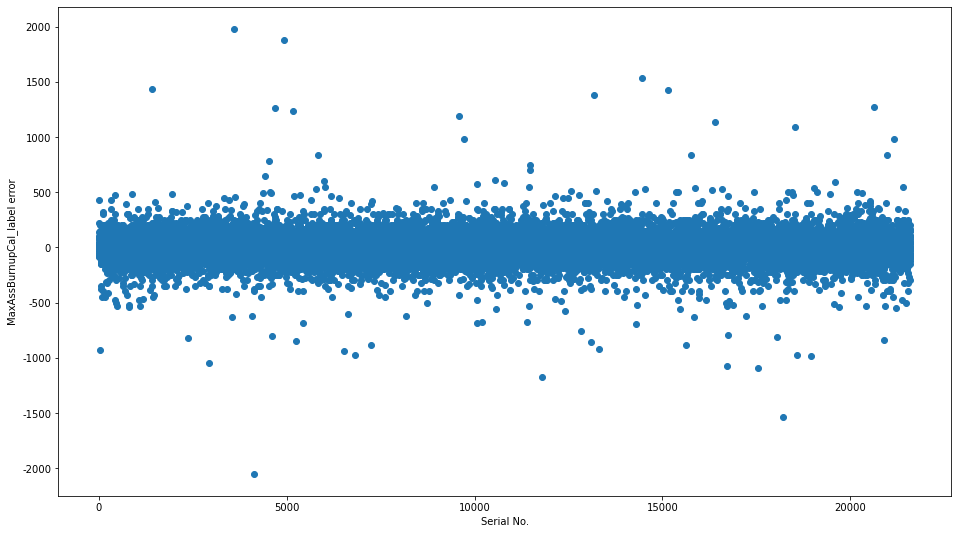

LGB均差得分为： 82.0197537755127


<Figure size 1152x648 with 0 Axes>

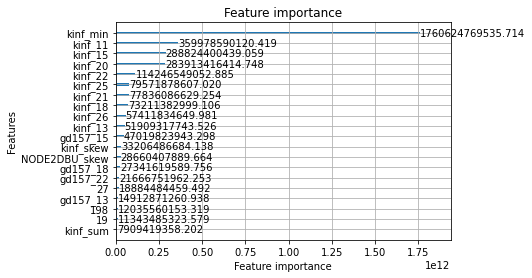

fold 2
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031534 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 46939
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 220
[LightGBM] [Info] Start training from score 58129.224537
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 59.1908	valid_1's l1: 93.6253
[100]	training's l1: 51.5457	valid_1's l1: 85.0622
[150]	training's l1: 50.7398	valid_1's l1: 84.0838
[200]	training's l1: 50.4667	valid_1's l1: 83.7445
[250]	training's l1: 50.3411	valid_1's l1: 83.6235
[300]	training's l1: 50.2703	valid_1's l1: 83.5746
[350]	training's l1: 50.2279	valid_1's l1: 83.5603
[400]	training's l1: 50.201	valid_1's l1: 83.5546
[450]	training's l1: 50.1835	valid_1's l1: 83.552
[500]	training's l1: 50.1708	valid_1's l1: 83.5483
[550]	training's l1: 50.1623	valid_1's l1: 83.5477
Early stopping, best it

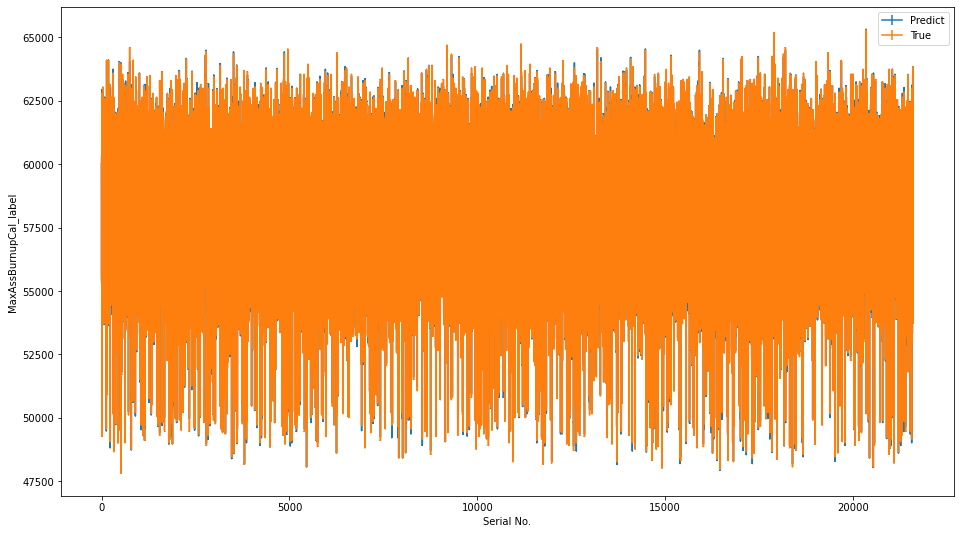

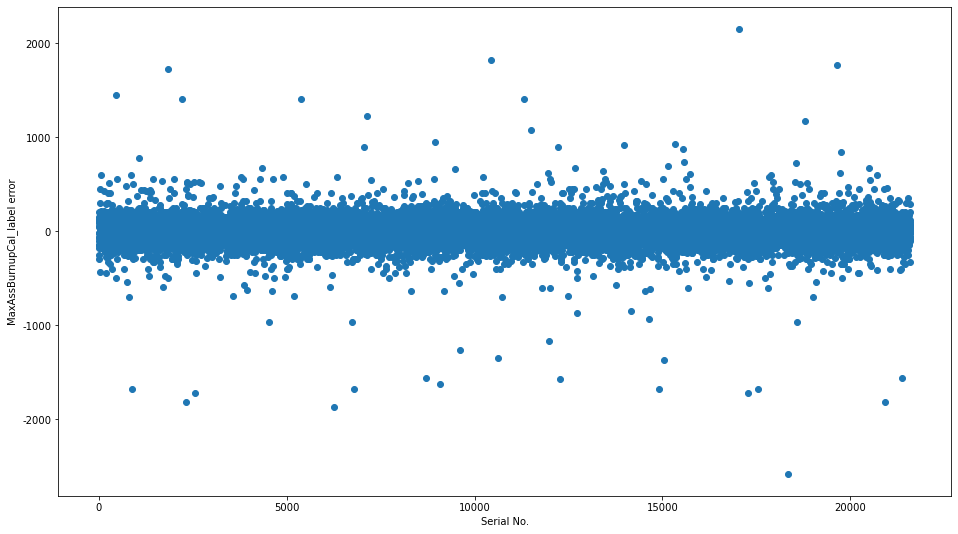

LGB均差得分为： 83.54722230152252


<Figure size 1152x648 with 0 Axes>

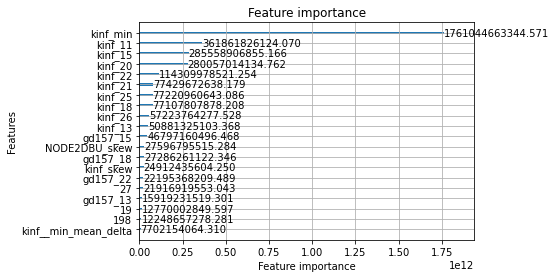

fold 3
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031881 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 46942
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 220
[LightGBM] [Info] Start training from score 58119.564815
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 59.9409	valid_1's l1: 94.5534
[100]	training's l1: 51.8896	valid_1's l1: 85.0421
[150]	training's l1: 50.9667	valid_1's l1: 83.6677
[200]	training's l1: 50.6532	valid_1's l1: 83.2452
[250]	training's l1: 50.51	valid_1's l1: 83.1051
[300]	training's l1: 50.4323	valid_1's l1: 83.0505
[350]	training's l1: 50.3862	valid_1's l1: 83.0239
[400]	training's l1: 50.3561	valid_1's l1: 83.0144
[450]	training's l1: 50.3362	valid_1's l1: 83.0054
[500]	training's l1: 50.3221	valid_1's l1: 82.9973
[550]	training's l1: 50.3122	valid_1's l1: 82.9923
[600]	training's l1: 50

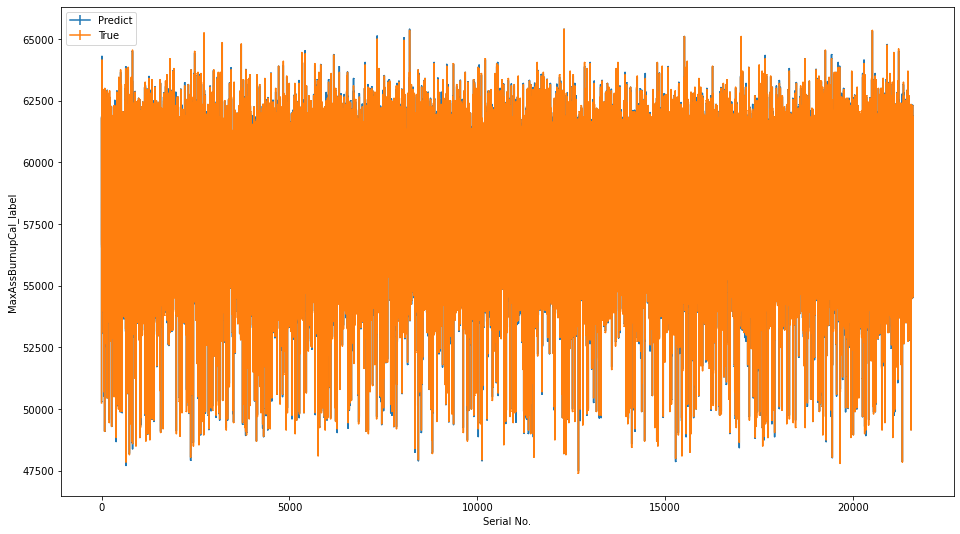

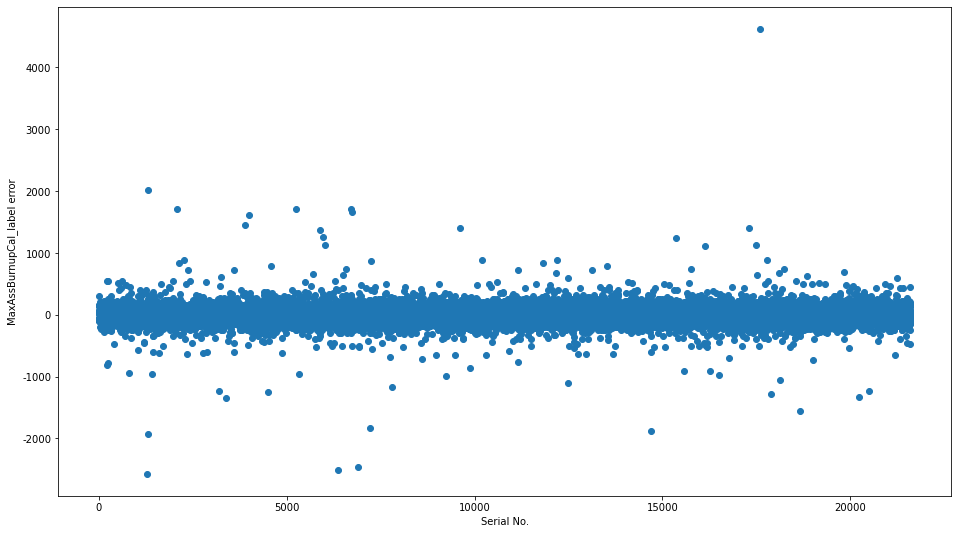

LGB均差得分为： 82.9832823855716


<Figure size 1152x648 with 0 Axes>

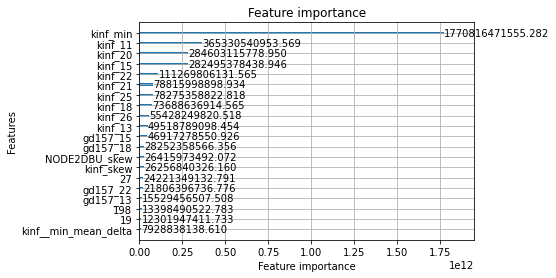

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031045 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 46935
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 220
[LightGBM] [Info] Start training from score 58121.648148
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 59.747	valid_1's l1: 95.7334
[100]	training's l1: 51.9545	valid_1's l1: 86.2683
[150]	training's l1: 51.0583	valid_1's l1: 84.9808
[200]	training's l1: 50.7615	valid_1's l1: 84.5439
[250]	training's l1: 50.6222	valid_1's l1: 84.336
[300]	training's l1: 50.547	valid_1's l1: 84.2269
[350]	training's l1: 50.5009	valid_1's l1: 84.1719
[400]	training's l1: 50.4715	valid_1's l1: 84.1398
[450]	training's l1: 50.452	valid_1's l1: 84.1177
[500]	training's l1: 50.4383	valid_1's l1: 84.1004
[550]	training's l1: 50.4288	valid_1's l1: 84.0895
[600]	training's l1: 50.4

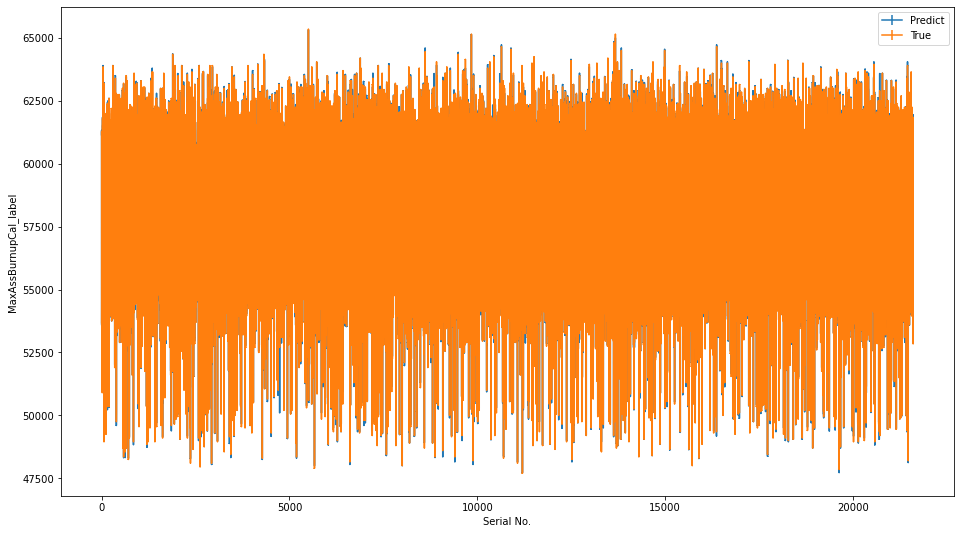

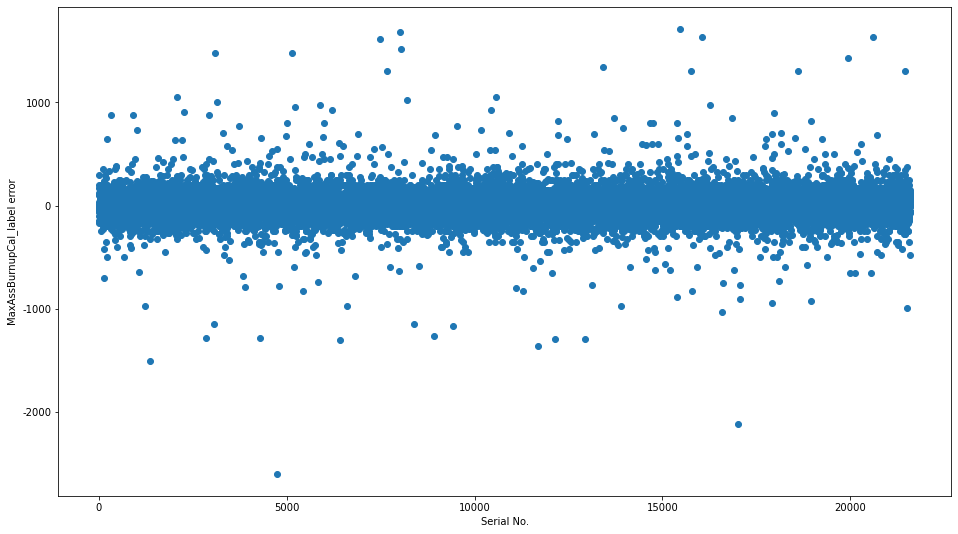

LGB均差得分为： 84.06037681755804


<Figure size 1152x648 with 0 Axes>

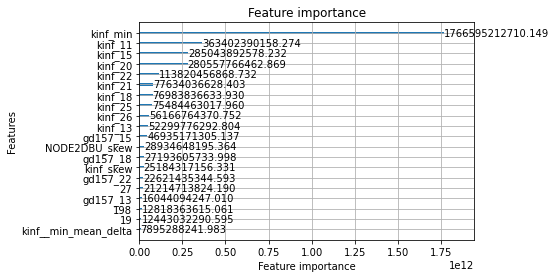

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031364 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 46939
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 220
[LightGBM] [Info] Start training from score 58123.082755
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 59.7359	valid_1's l1: 94.1274
[100]	training's l1: 51.9056	valid_1's l1: 85.1991
[150]	training's l1: 51.0433	valid_1's l1: 83.9158
[200]	training's l1: 50.7551	valid_1's l1: 83.4384
[250]	training's l1: 50.6208	valid_1's l1: 83.2282
[300]	training's l1: 50.5442	valid_1's l1: 83.1233
[350]	training's l1: 50.4979	valid_1's l1: 83.0744
[400]	training's l1: 50.4676	valid_1's l1: 83.049
[450]	training's l1: 50.4474	valid_1's l1: 83.037
[500]	training's l1: 50.4335	valid_1's l1: 83.0268
[550]	training's l1: 50.4236	valid_1's l1: 83.0189
[600]	training's l1: 50

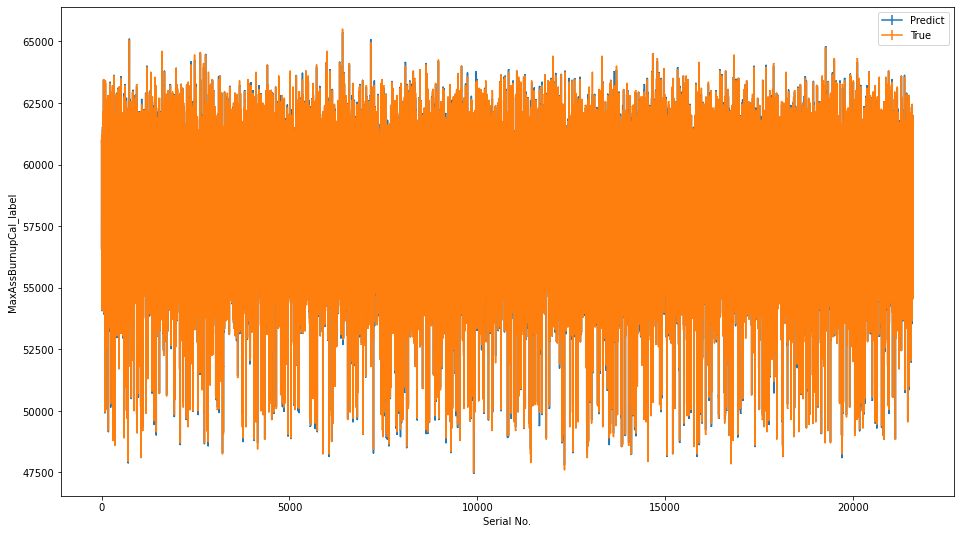

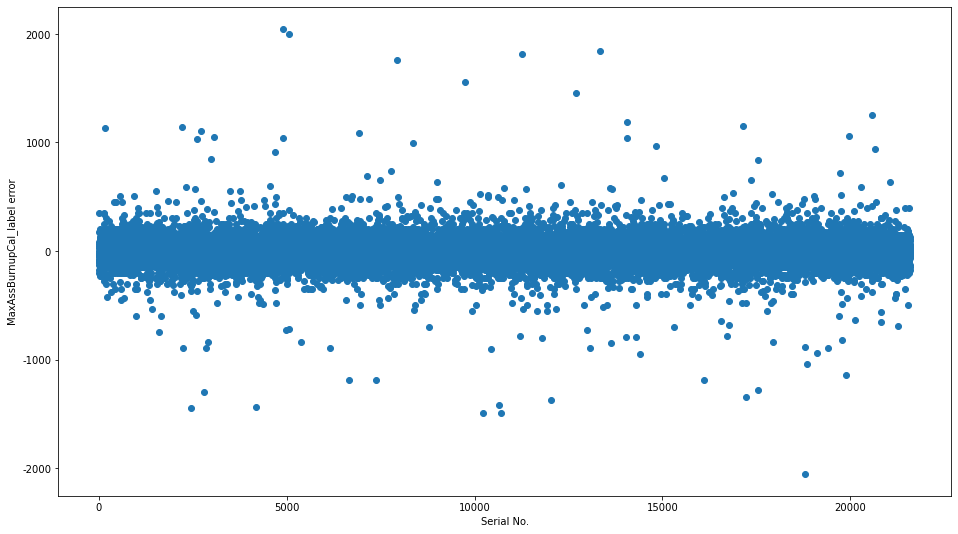

LGB均差得分为： 83.00883019587586


<Figure size 1152x648 with 0 Axes>

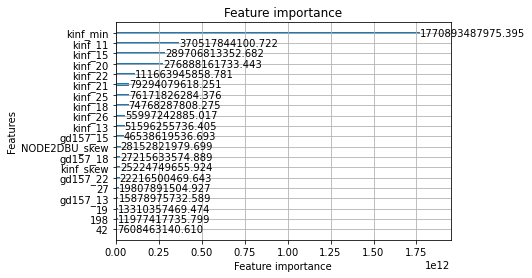

训练数据的shape为： (108000, 220)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032004 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 43664
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 220
[LightGBM] [Info] Start training from score 63196.354167
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 317.015	valid_1's l1: 461.34
Early stopping, best iteration is:
[36]	training's l1: 326.857	valid_1's l1: 456.85
best iteration =  36
****************************************************************************************************


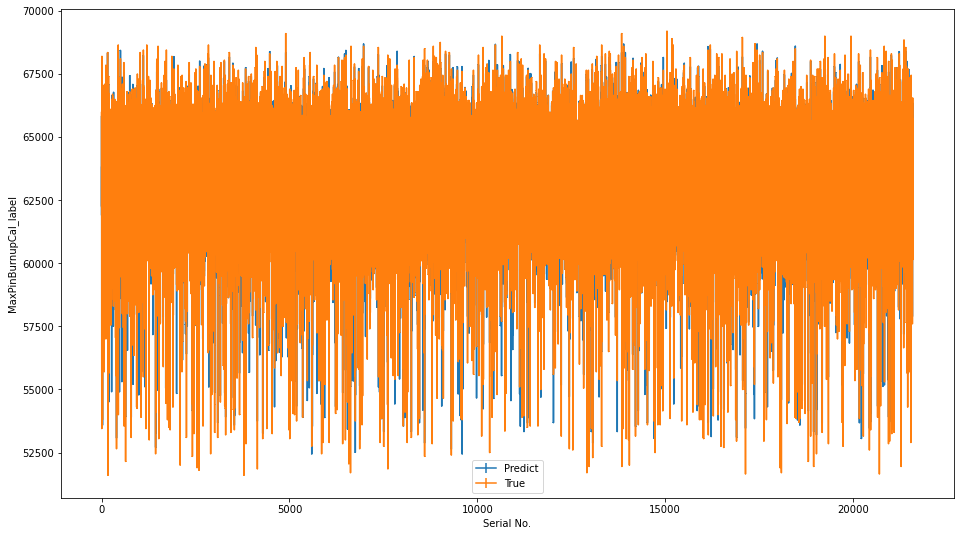

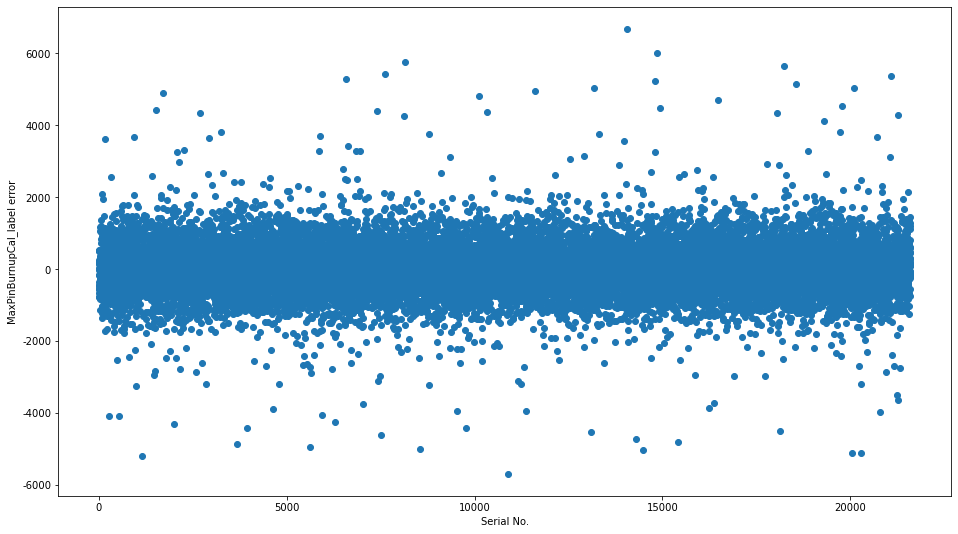

LGB均差得分为： 456.8498020103598


<Figure size 1152x648 with 0 Axes>

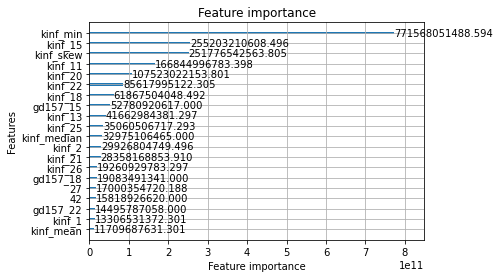

fold 2
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031183 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 43663
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 220
[LightGBM] [Info] Start training from score 63204.089699
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 317.844	valid_1's l1: 458.781
Early stopping, best iteration is:
[37]	training's l1: 326.5	valid_1's l1: 454.604
best iteration =  37
****************************************************************************************************


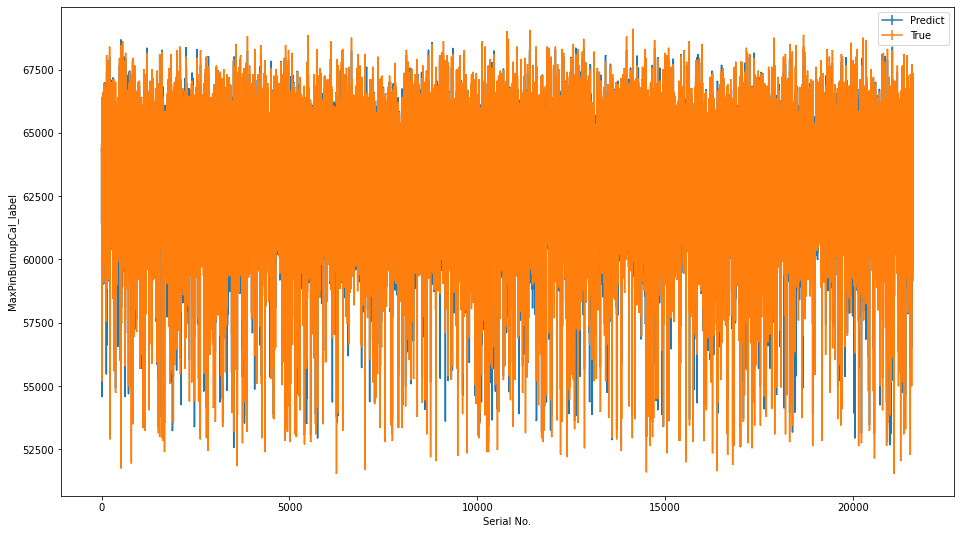

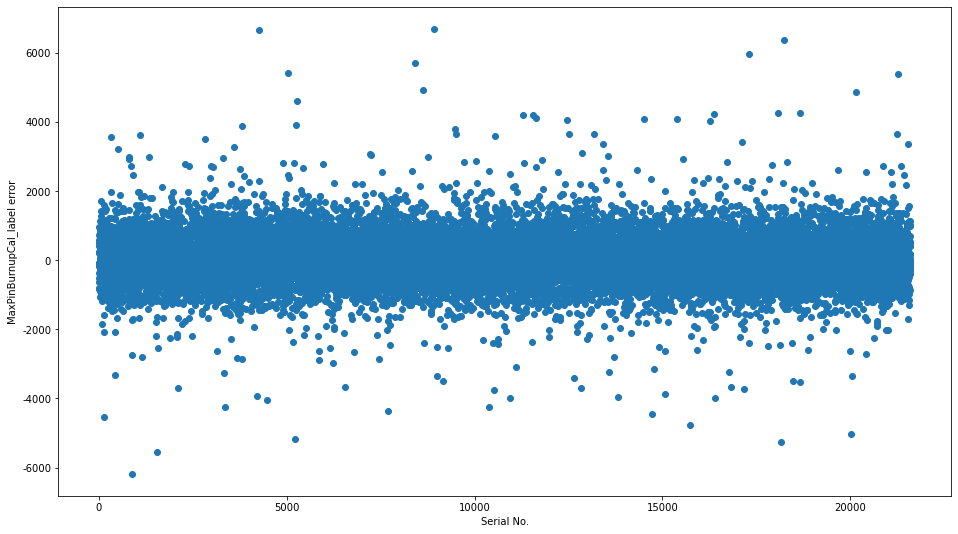

LGB均差得分为： 454.6040427521851


<Figure size 1152x648 with 0 Axes>

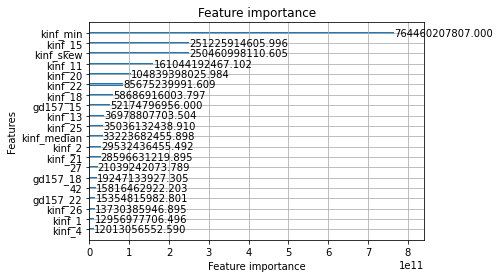

fold 3
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.033464 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 43666
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 220
[LightGBM] [Info] Start training from score 63196.660301
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 316.384	valid_1's l1: 465.35
Early stopping, best iteration is:
[36]	training's l1: 326.524	valid_1's l1: 461.048
best iteration =  36
****************************************************************************************************


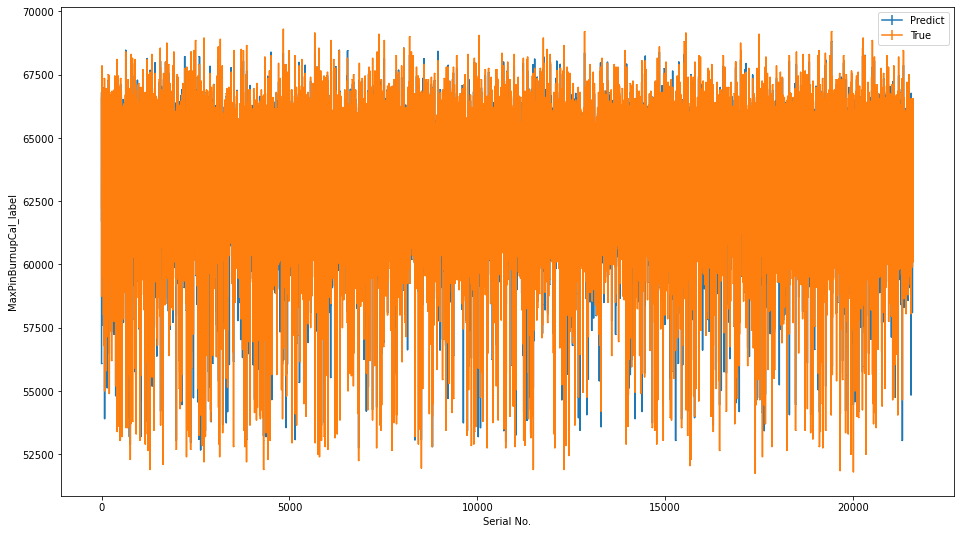

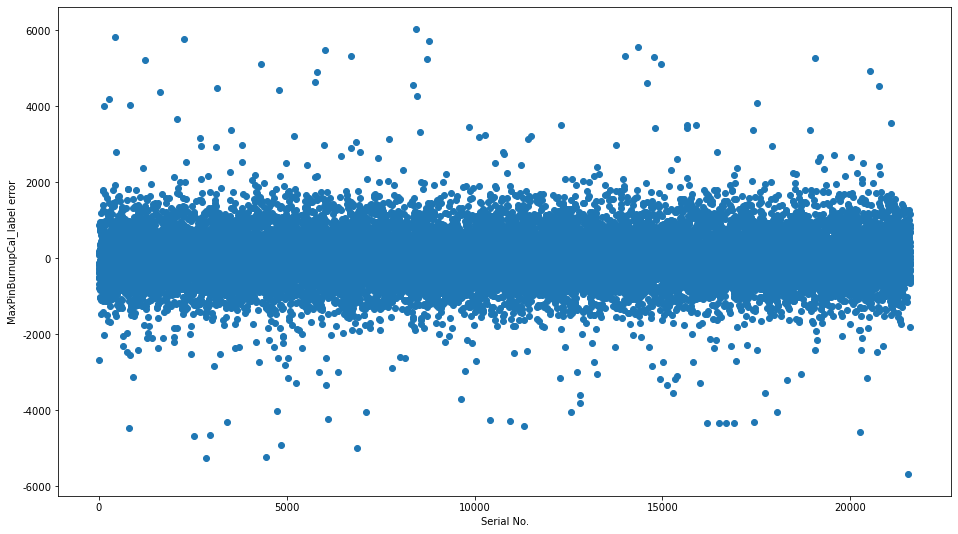

LGB均差得分为： 461.04793866995635


<Figure size 1152x648 with 0 Axes>

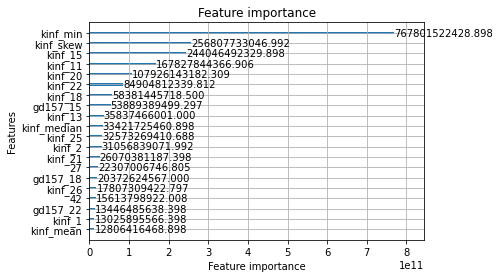

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.031136 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 43659
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 220
[LightGBM] [Info] Start training from score 63201.919560
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 317.836	valid_1's l1: 460.632
Early stopping, best iteration is:
[36]	training's l1: 327.757	valid_1's l1: 456.88
best iteration =  36
****************************************************************************************************


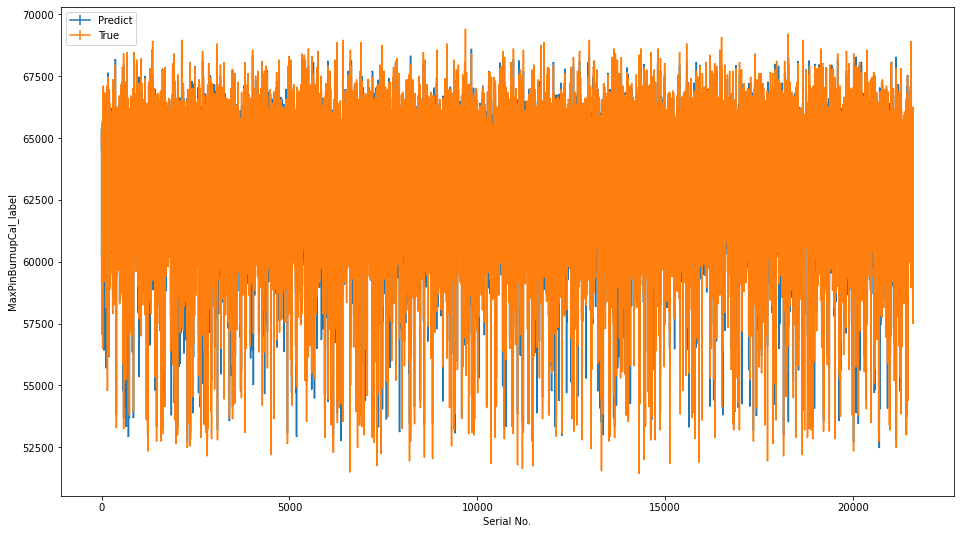

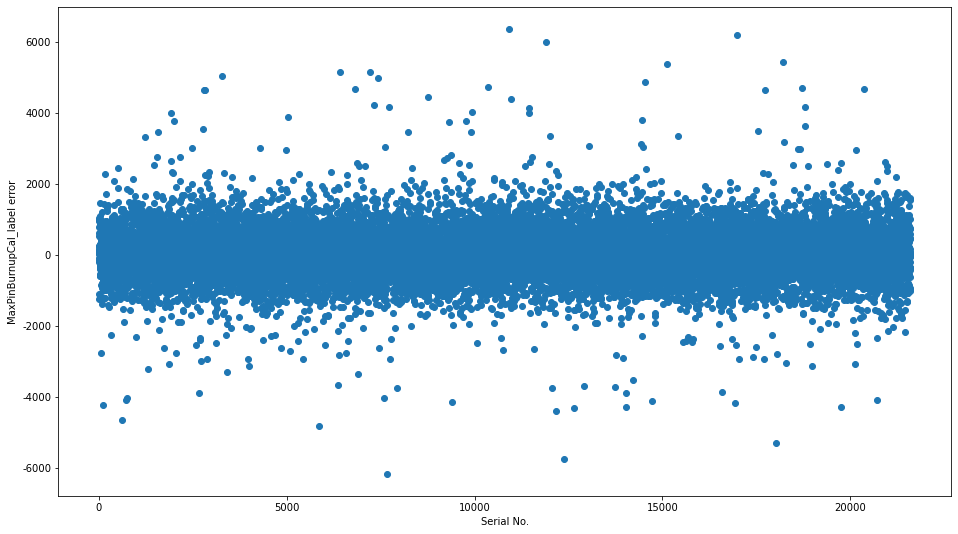

LGB均差得分为： 456.8798261613781


<Figure size 1152x648 with 0 Axes>

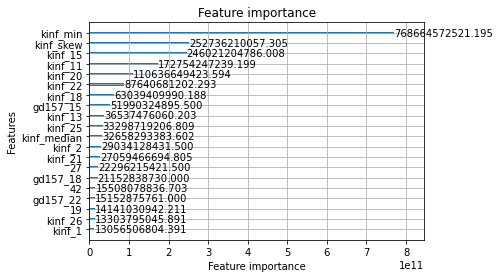

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.032234 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 43663
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 220
[LightGBM] [Info] Start training from score 63198.455440
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 317.189	valid_1's l1: 460.436
Early stopping, best iteration is:
[36]	training's l1: 327.265	valid_1's l1: 456.231
best iteration =  36
****************************************************************************************************


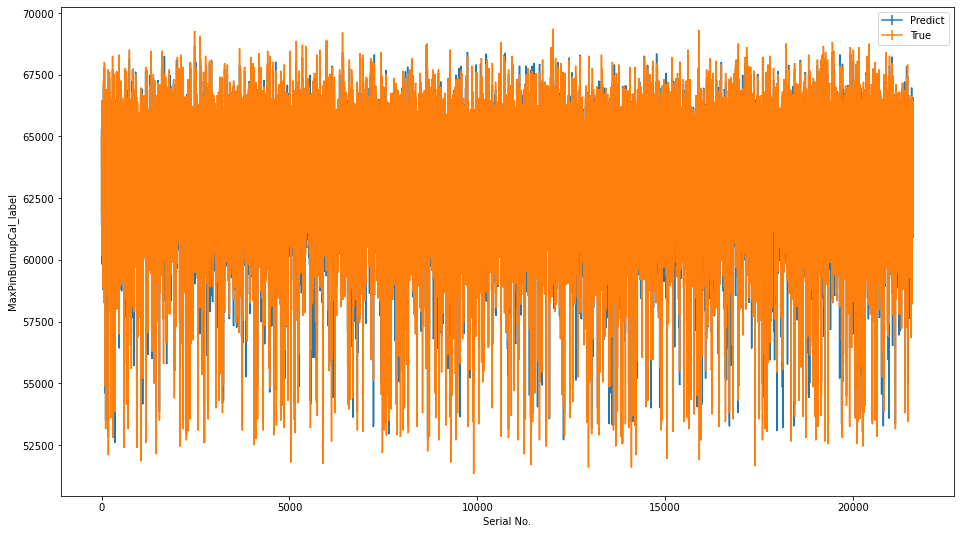

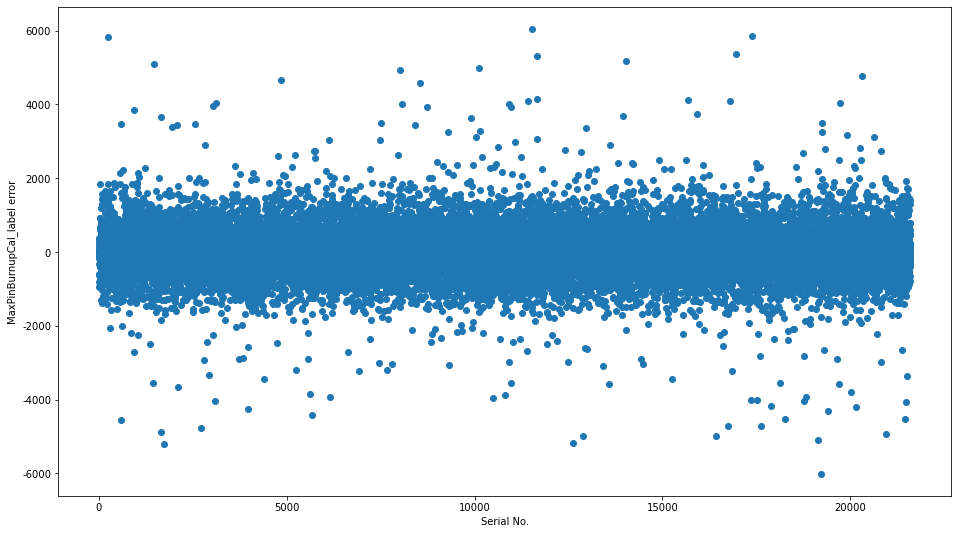

LGB均差得分为： 456.2311484288327


<Figure size 1152x648 with 0 Axes>

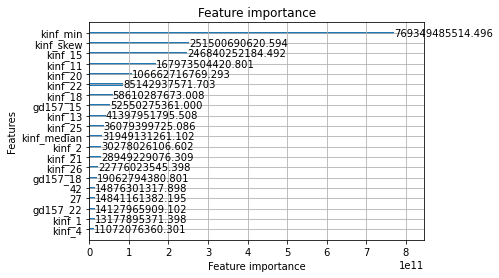

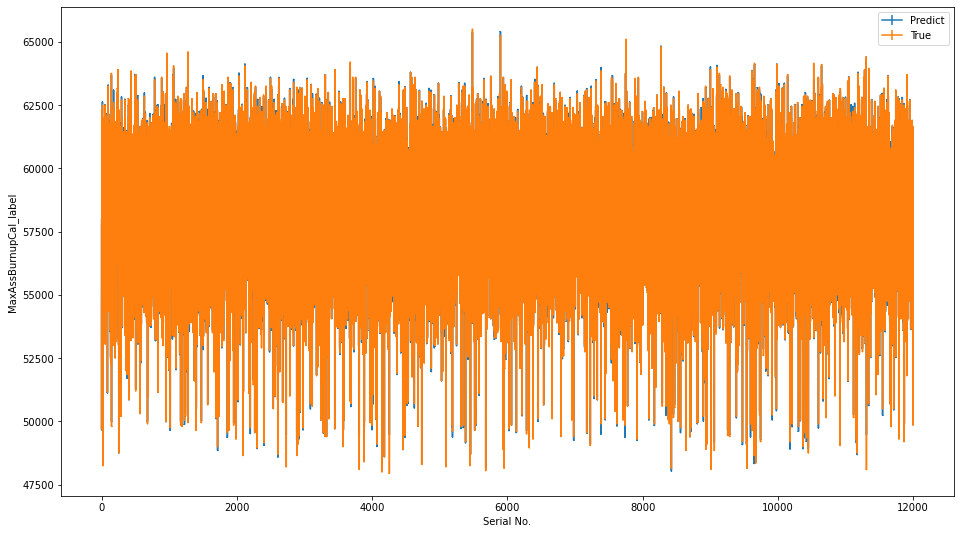

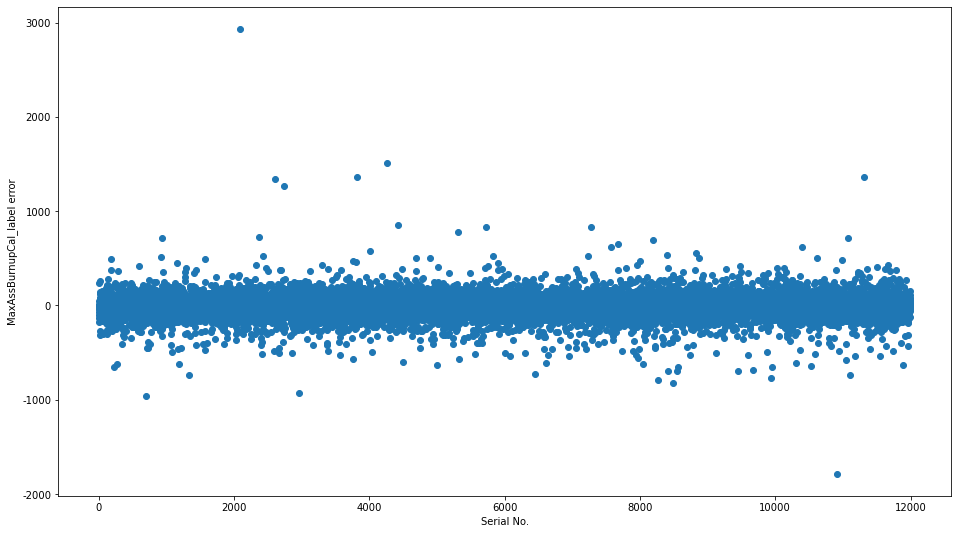

特征数量为220, 目标MaxAssBurnupCal_label的LGB均差得分为：85.11434967116777


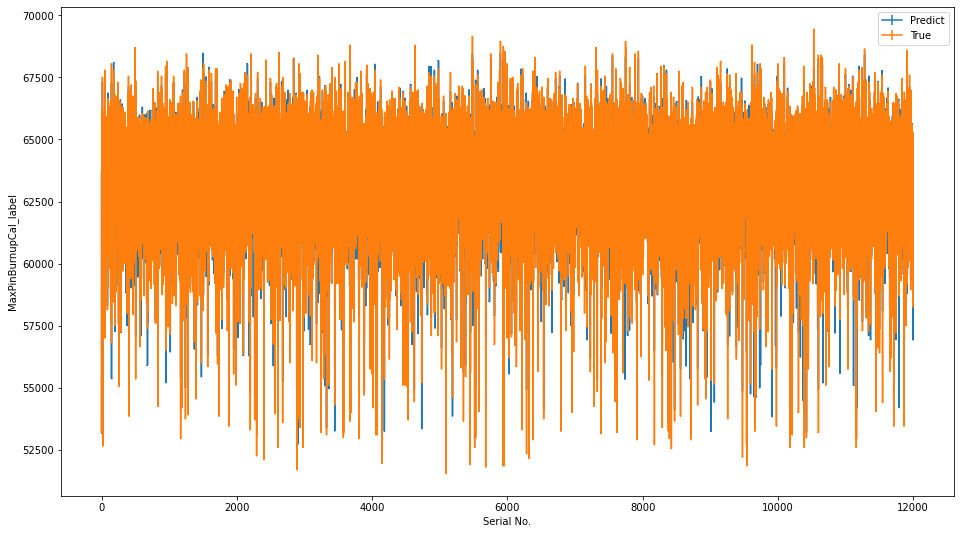

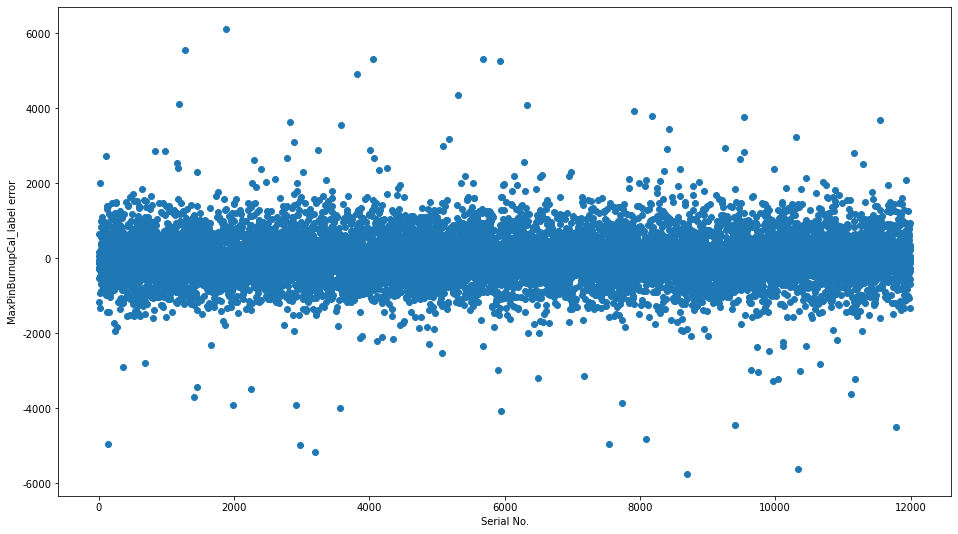

特征数量为220, 目标MaxPinBurnupCal_label的LGB均差得分为：447.4685434506714


,num,MaxAssBurnupCal_label,MaxPinBurnupCal_label
0,60.0,77.765062,441.673426
1,100.0,78.048762,444.094939
2,140.0,83.673357,445.458837
3,180.0,85.653139,446.948303
4,220.0,85.114350,447.468543


In [141]:
num_list = np.arange(60,260,40).tolist()
res_data = pd.DataFrame(np.zeros((len(num_list),3)),columns=['num', 'MaxAssBurnupCal_label', 'MaxPinBurnupCal_label'])

for i, num in enumerate(num_list):

    feat_dic = {
        'MaxAssBurnupCal_label': df_corrmat_ass.head(num).index.tolist(),
        'MaxPinBurnupCal_label': df_corrmat_pin.head(num).index.tolist() 
    }
    
    res_data.loc[i, 'num'] = num
    
    tmp_pred = y_pre_train.copy()
    tmp_test = y_test.copy()
    for col in tmp_pred:
        tmp_pred[col] = 0
        tmp_test[col] = 0

    pred_test = pd.DataFrame(np.zeros((len(X_test),2)), columns=output_col)
    df_feat_imp = pd.DataFrame()

    for burnup in ['MaxAssBurnupCal_label', 'MaxPinBurnupCal_label']:

        pred_arr, feature_importance, y_train_pred, y_test_pred = model_predict(X_pre_train[feat_dic[burnup]], y_pre_train[burnup], 
                                                                  X_test[feat_dic[burnup]], burnup, df_feat_imp, tmp_pred, tmp_test)

        pred_test[burnup] = pred_arr
        df_feat_imp = pd.concat([df_feat_imp, feature_importance], axis=1)


    for col in pred_test.columns:
        plt_error(pred_test[col], y_test[col], col)
        score = mean_absolute_error(pred_test[col], y_test[col])
        res_data.loc[i, col] = score
        print('特征数量为{}, 目标{}的LGB均差得分为：{}'.format(num, col, score))

res_data

In [142]:
res_data

,num,MaxAssBurnupCal_label,MaxPinBurnupCal_label
0,60.0,77.765062,441.673426
1,100.0,78.048762,444.094939
2,140.0,83.673357,445.458837
3,180.0,85.653139,446.948303
4,220.0,85.114350,447.468543


训练数据的shape为： (108000, 50)
fold 1
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006486 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5097
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 50
[LightGBM] [Info] Start training from score 58120.146412
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 99.3802	valid_1's l1: 145.452
[100]	training's l1: 60.8743	valid_1's l1: 99.9364
[150]	training's l1: 53.5234	valid_1's l1: 88.8927
[200]	training's l1: 51.754	valid_1's l1: 85.8084
[250]	training's l1: 51.1309	valid_1's l1: 84.895
[300]	training's l1: 50.8204	valid_1's l1: 84.5779
[350]	training's l1: 50.6667	valid_1's l1: 84.4475
[400]	training's l1: 50.5844	valid_1's l1: 84.3741
[450]	training's l1: 50.542	valid_1's l1: 84.3395
[500]	training's l1: 50.519	valid_1's l1: 84.3229
[550]	training's l1: 50.5068	valid_1's l1: 84.3123
[

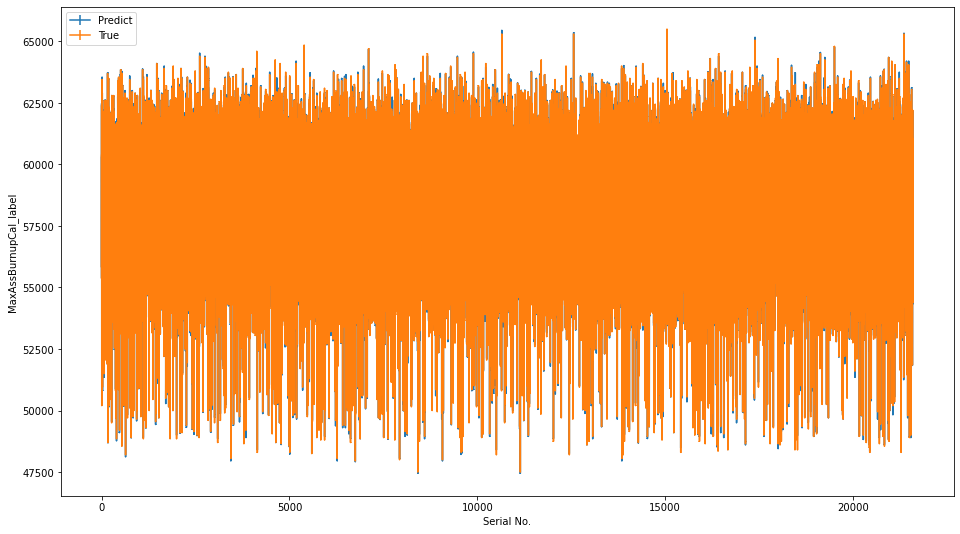

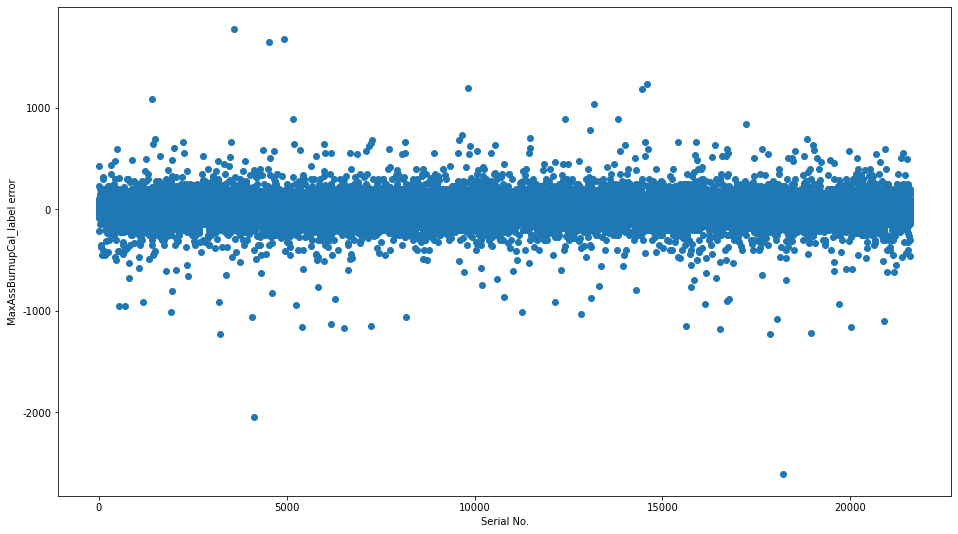

LGB1均差得分为： 84.30081848115567


<Figure size 1152x648 with 0 Axes>

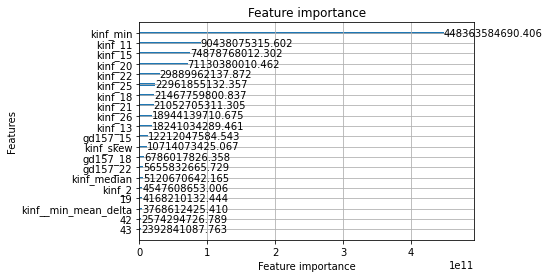

fold 2
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002643 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5096
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 50
[LightGBM] [Info] Start training from score 58129.224537
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 101.738	valid_1's l1: 145.734
[100]	training's l1: 61.0826	valid_1's l1: 99.5592
[150]	training's l1: 53.3507	valid_1's l1: 88.7809
[200]	training's l1: 51.6676	valid_1's l1: 86.2138
[250]	training's l1: 50.9762	valid_1's l1: 85.3754
[300]	training's l1: 50.6559	valid_1's l1: 85.084
[350]	training's l1: 50.491	valid_1's l1: 84.9661
[400]	training's l1: 50.4055	valid_1's l1: 84.9186
[450]	training's l1: 50.3634	valid_1's l1: 84.8934
[500]	training's l1: 50.338	valid_1's l1: 84.8786
[550]	trainin

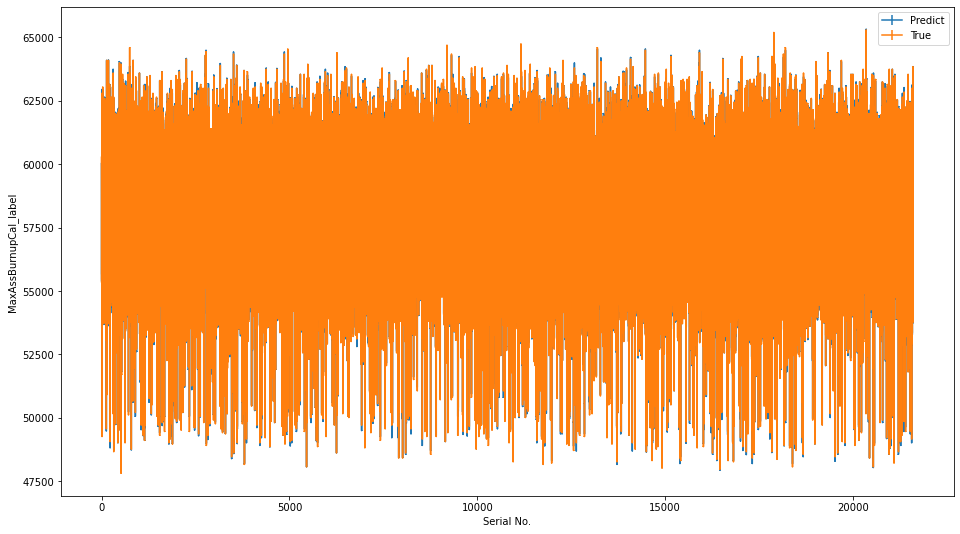

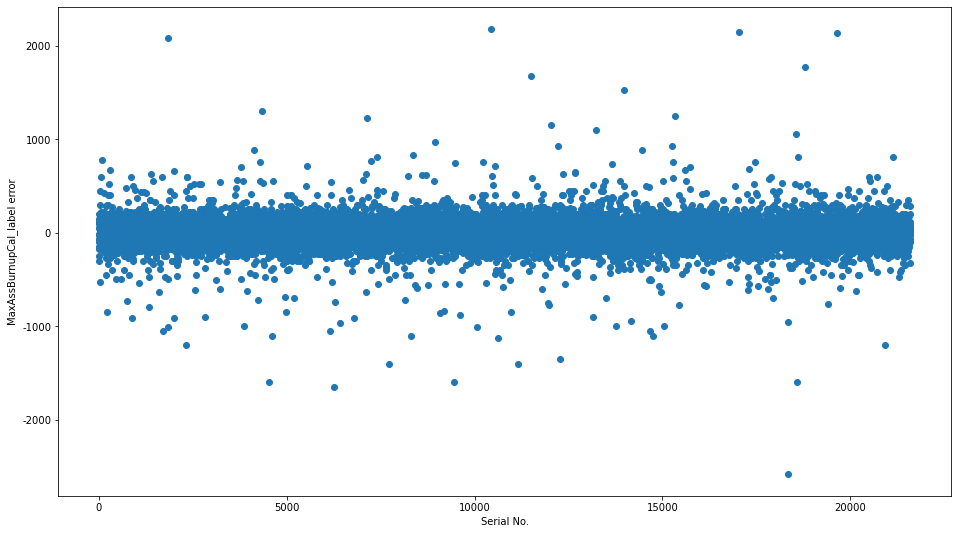

LGB1均差得分为： 84.86518762035587


<Figure size 1152x648 with 0 Axes>

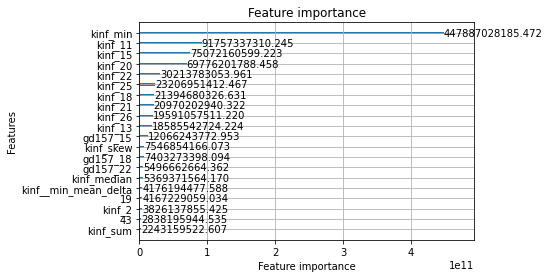

fold 3
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002490 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5099
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 50
[LightGBM] [Info] Start training from score 58119.564815
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 99.7962	valid_1's l1: 145.401
[100]	training's l1: 61.0862	valid_1's l1: 99.1156
[150]	training's l1: 53.6038	valid_1's l1: 88.307
[200]	training's l1: 51.8555	valid_1's l1: 85.4686
[250]	training's l1: 51.1929	valid_1's l1: 84.5506
[300]	training's l1: 50.8726	valid_1's l1: 84.1895
[350]	training's l1: 50.7098	valid_1's l1: 84.0472
[400]	training's l1: 50.623	valid_1's l1: 83.9869
[450]	training's l1: 50.5761	valid_1's l1: 83.9593
[500]	training's l1: 50.5509	valid_1's l1: 83.9427
[550]	traini

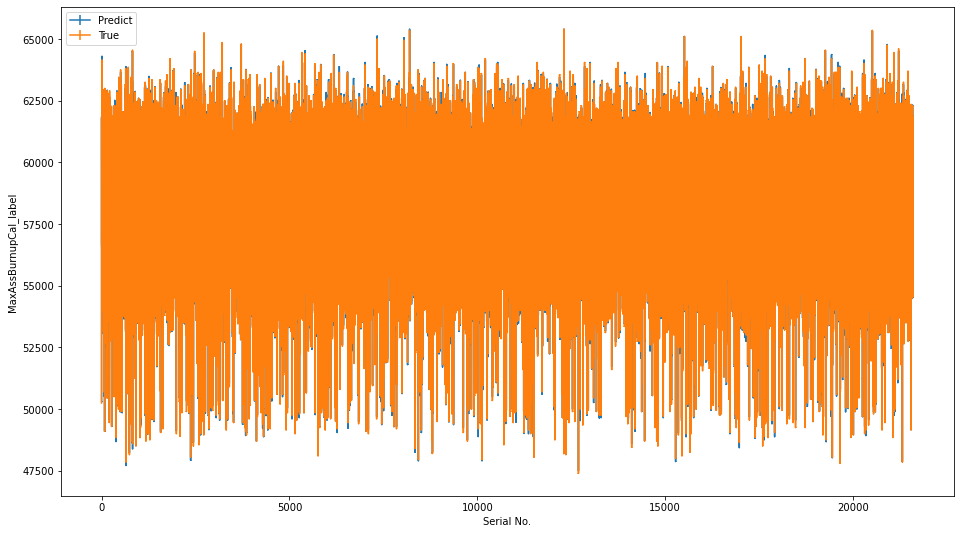

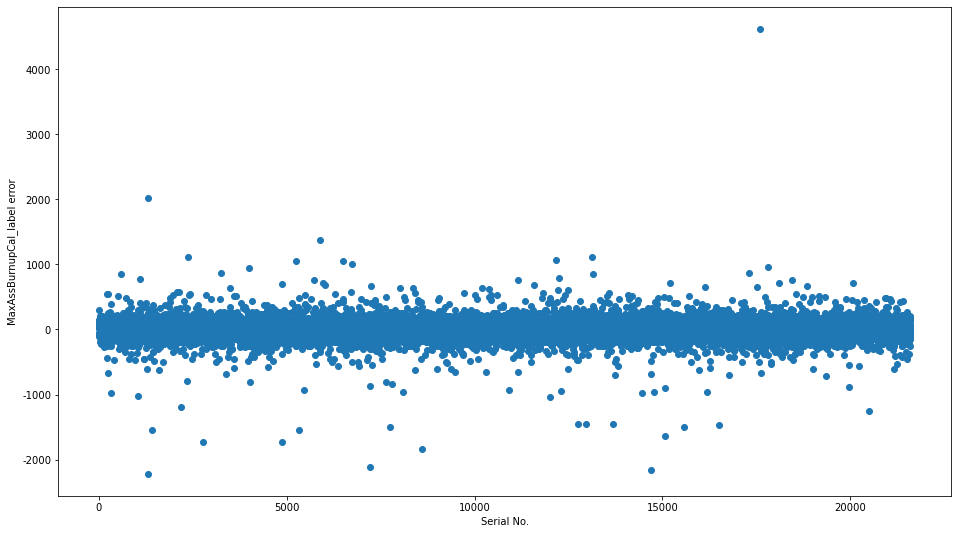

LGB1均差得分为： 83.92093537229262


<Figure size 1152x648 with 0 Axes>

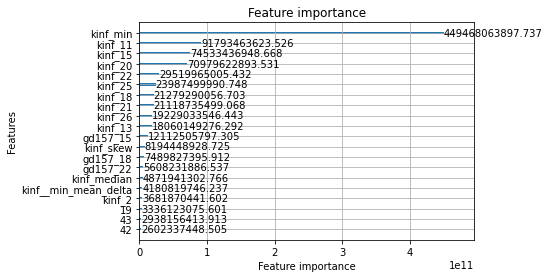

fold 4
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006720 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5092
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 50
[LightGBM] [Info] Start training from score 58121.648148
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 99.3801	valid_1's l1: 142.714
[100]	training's l1: 60.7064	valid_1's l1: 98.0529
[150]	training's l1: 53.529	valid_1's l1: 87.8659
[200]	training's l1: 51.862	valid_1's l1: 85.3272
[250]	training's l1: 51.2292	valid_1's l1: 84.6113
[300]	training's l1: 50.939	valid_1's l1: 84.3671
[350]	training's l1: 50.7875	valid_1's l1: 84.2699
[400]	training's l1: 50.7049	valid_1's l1: 84.233
[450]	training's l1: 50.661	valid_1's l1: 84.2084
[500]	training's l1: 50.638	valid_1's l1: 84.198
[550]	training's l1: 50.6253	valid_1's l1: 84.1914
[600]	training's l1: 50.6185	v

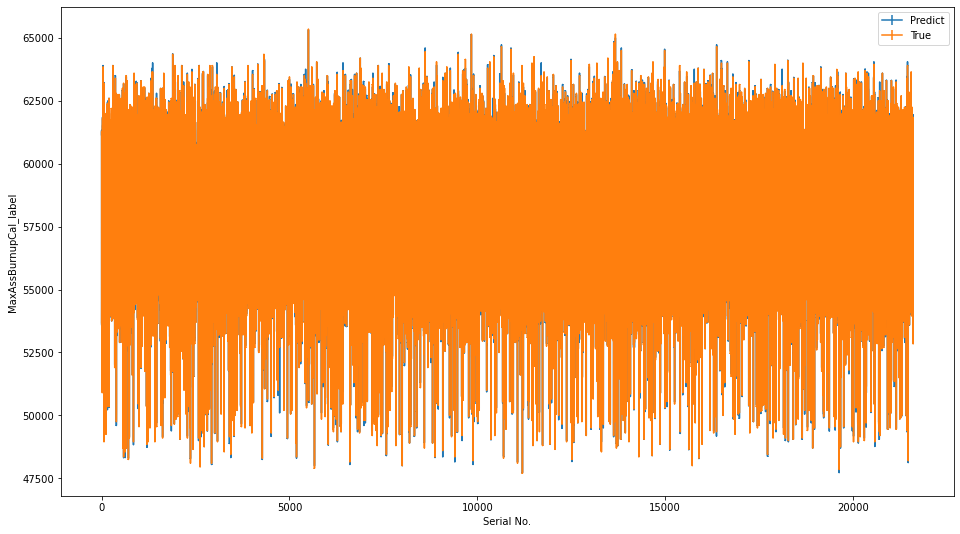

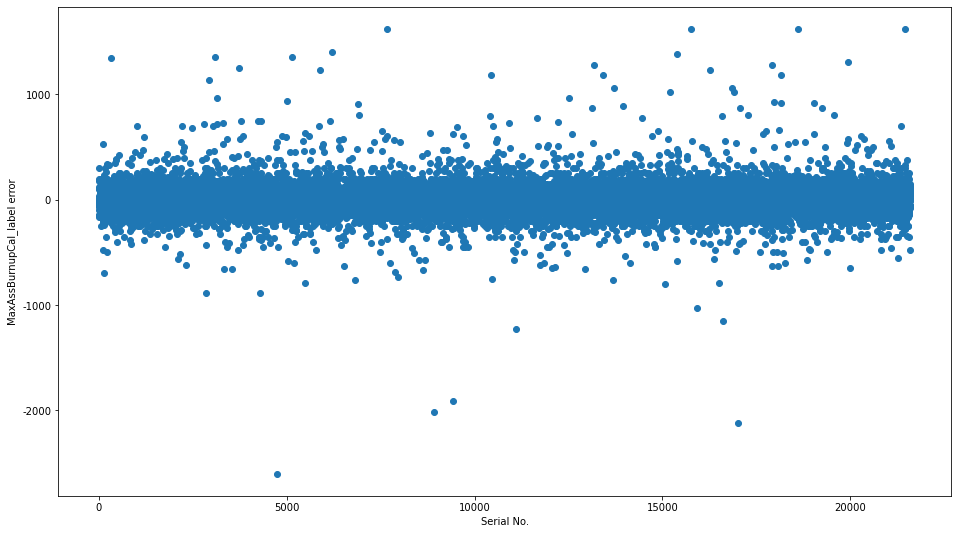

LGB1均差得分为： 84.18276949366592


<Figure size 1152x648 with 0 Axes>

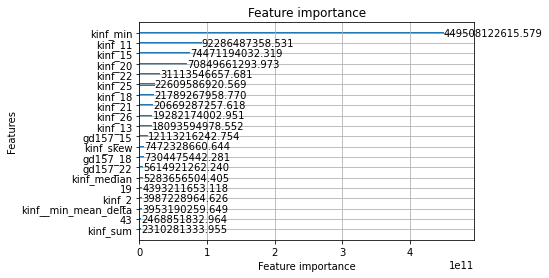

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006505 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5096
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 50
[LightGBM] [Info] Start training from score 58123.082755
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 98.7464	valid_1's l1: 140.422
[100]	training's l1: 60.6759	valid_1's l1: 96.711
[150]	training's l1: 53.5217	valid_1's l1: 86.5471
[200]	training's l1: 51.8358	valid_1's l1: 83.8198
[250]	training's l1: 51.2157	valid_1's l1: 82.9651
[300]	training's l1: 50.9065	valid_1's l1: 82.647
[350]	training's l1: 50.7539	valid_1's l1: 82.5381
[400]	training's l1: 50.6744	valid_1's l1: 82.4848
[450]	training's l1: 50.6304	valid_1's l1: 82.4548
[500]	training's l1: 50.6072	valid_1's l1: 82.4413
[550]	training's l1: 50.595	valid_1's l1: 82.4353
[600]	training's l1: 50.58

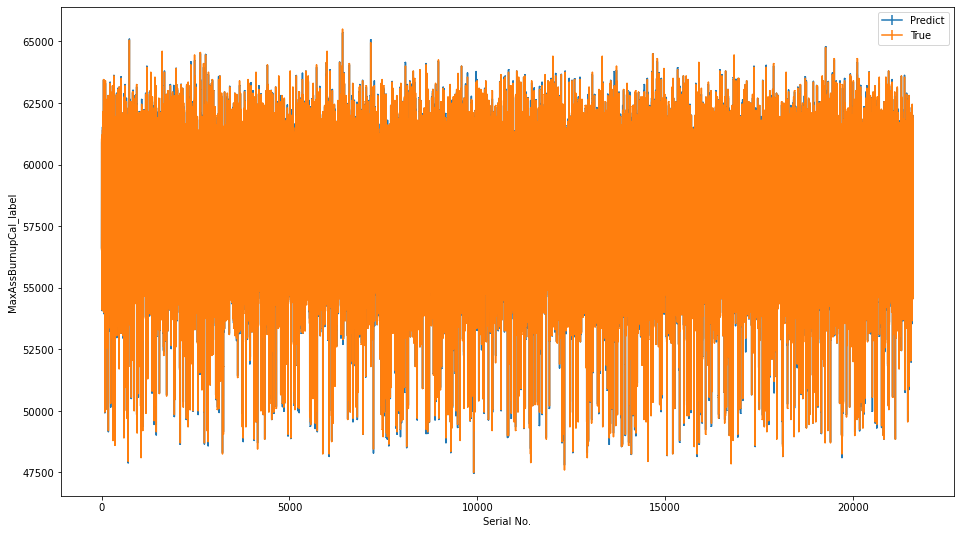

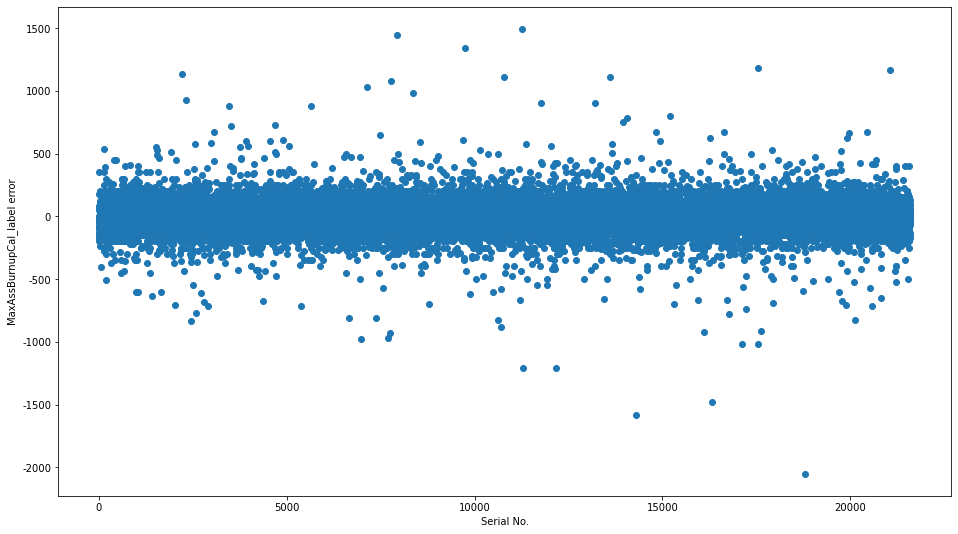

LGB1均差得分为： 82.42502890237382


<Figure size 1152x648 with 0 Axes>

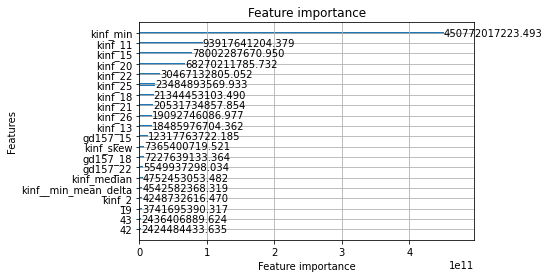

训练数据的shape为： (108000, 50)
fold 1
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002712 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5097
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 50
[LightGBM] [Info] Start training from score 63196.354167
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 336.279	valid_1's l1: 457.793
Early stopping, best iteration is:
[46]	training's l1: 340.23	valid_1's l1: 456.938
best iteration =  46
****************************************************************************************************


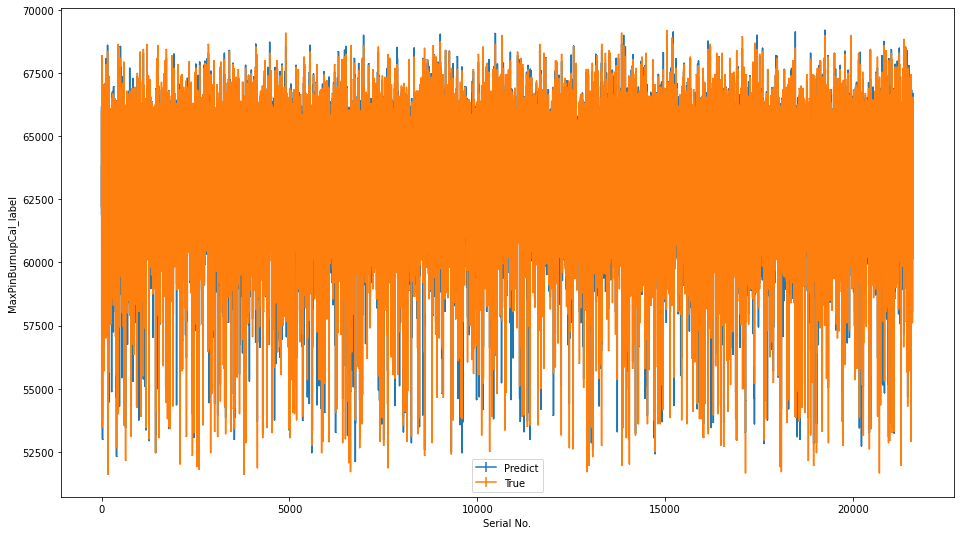

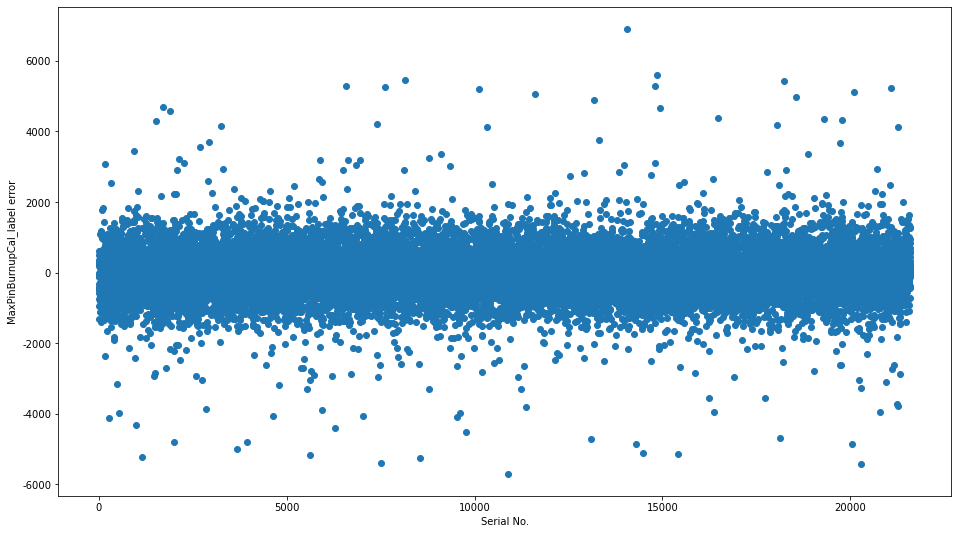

LGB1均差得分为： 456.9381631032492


<Figure size 1152x648 with 0 Axes>

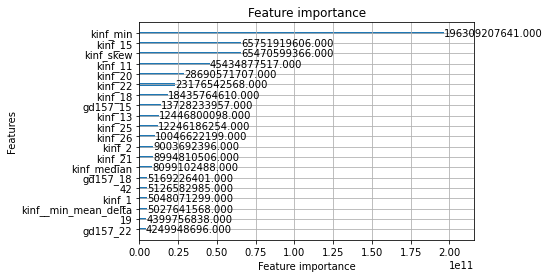

fold 2
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002668 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5096
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 50
[LightGBM] [Info] Start training from score 63204.089699
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 338.142	valid_1's l1: 455.402
Early stopping, best iteration is:
[43]	training's l1: 344.454	valid_1's l1: 454.379
best iteration =  43
****************************************************************************************************


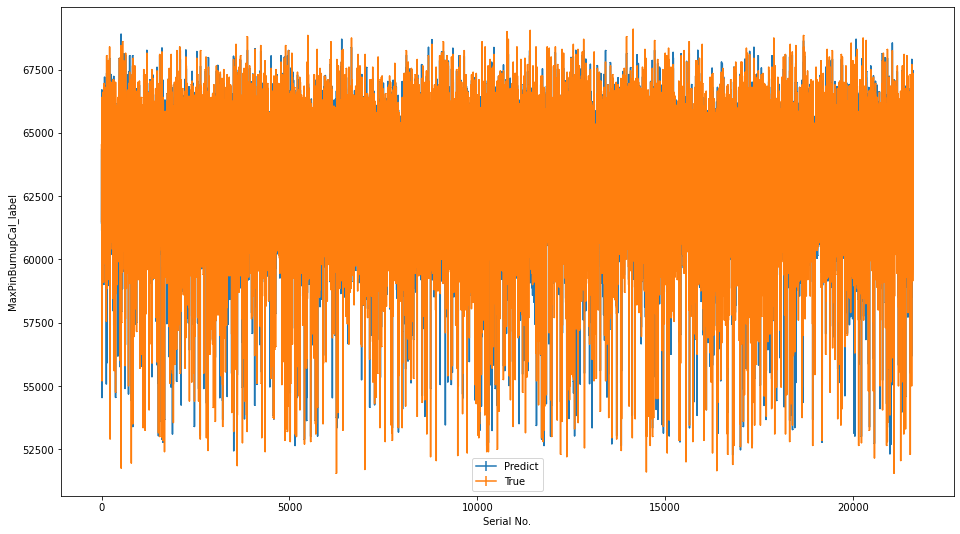

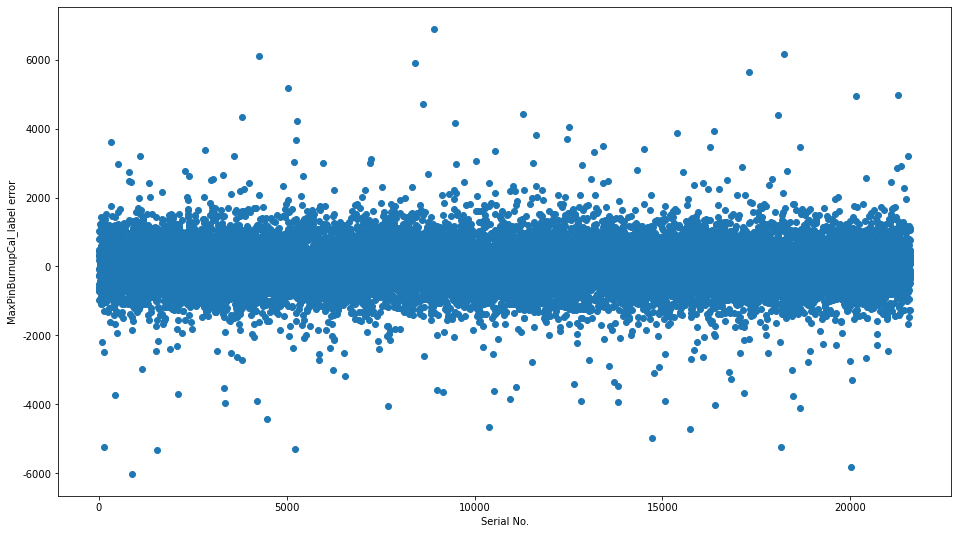

LGB1均差得分为： 454.3794476936685


<Figure size 1152x648 with 0 Axes>

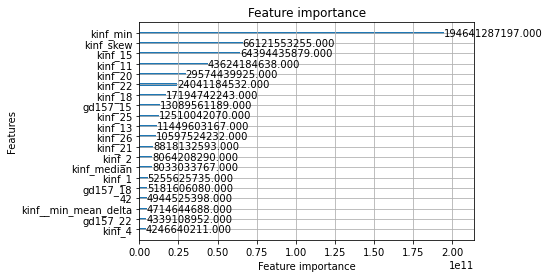

fold 3
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002652 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5099
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 50
[LightGBM] [Info] Start training from score 63196.660301
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 336.973	valid_1's l1: 463.094
Early stopping, best iteration is:
[40]	training's l1: 347.242	valid_1's l1: 461.204
best iteration =  40
****************************************************************************************************


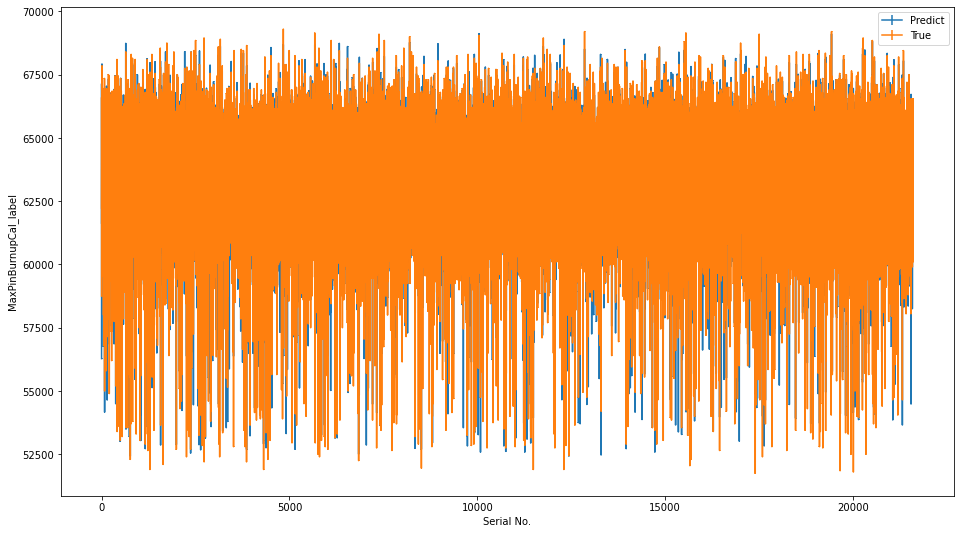

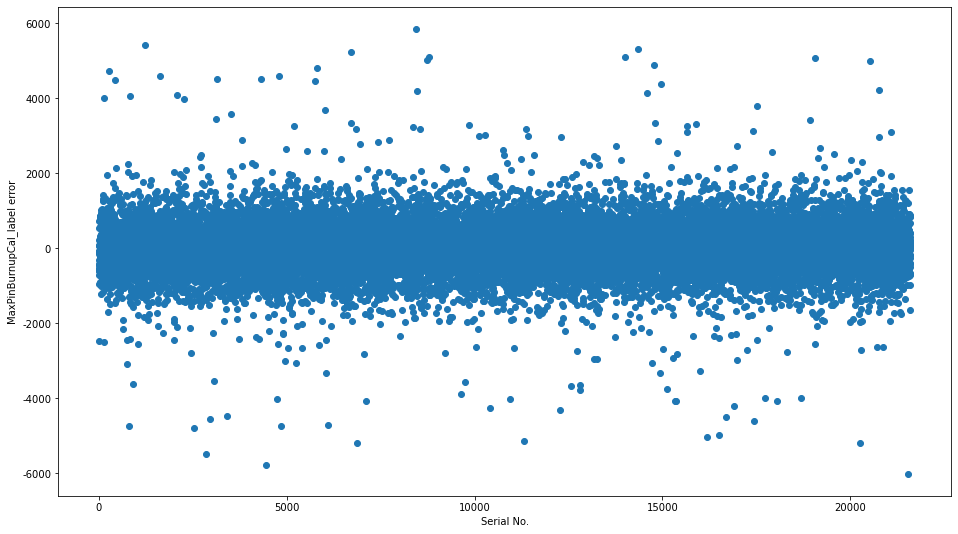

LGB1均差得分为： 461.20363446052374


<Figure size 1152x648 with 0 Axes>

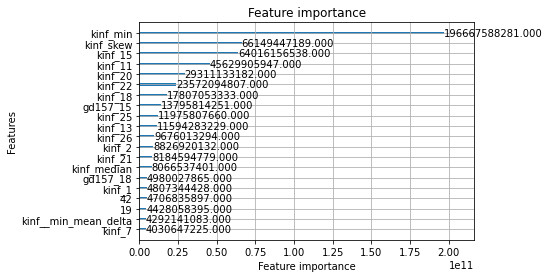

fold 4
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002660 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 5092
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 50
[LightGBM] [Info] Start training from score 63201.919560
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 337.837	valid_1's l1: 459.562
[100]	training's l1: 317.963	valid_1's l1: 465.219
Early stopping, best iteration is:
[53]	training's l1: 335.157	valid_1's l1: 458.904
best iteration =  53
****************************************************************************************************


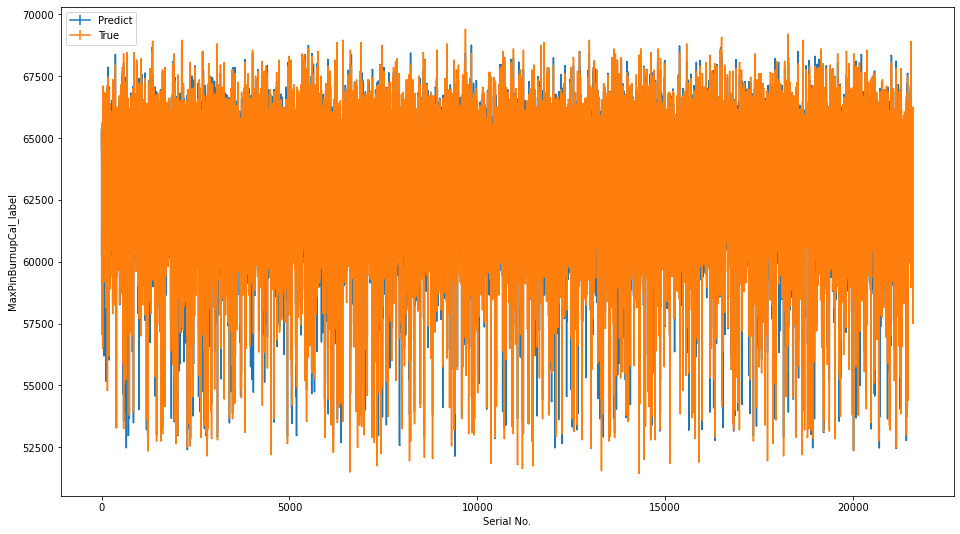

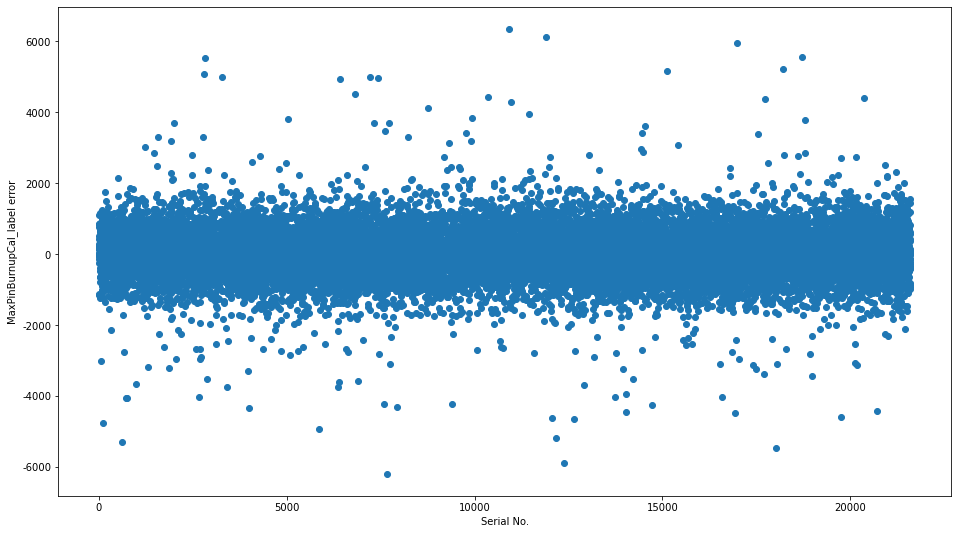

LGB1均差得分为： 458.90352843985494


<Figure size 1152x648 with 0 Axes>

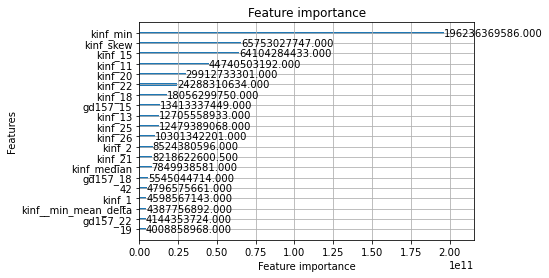

fold 5
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.006532 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 5096
[LightGBM] [Info] Number of data points in the train set: 86400, number of used features: 50
[LightGBM] [Info] Start training from score 63198.455440
Training until validation scores don't improve for 50 rounds
[50]	training's l1: 335.815	valid_1's l1: 458.005
Early stopping, best iteration is:
[42]	training's l1: 342.953	valid_1's l1: 456.857
best iteration =  42
****************************************************************************************************


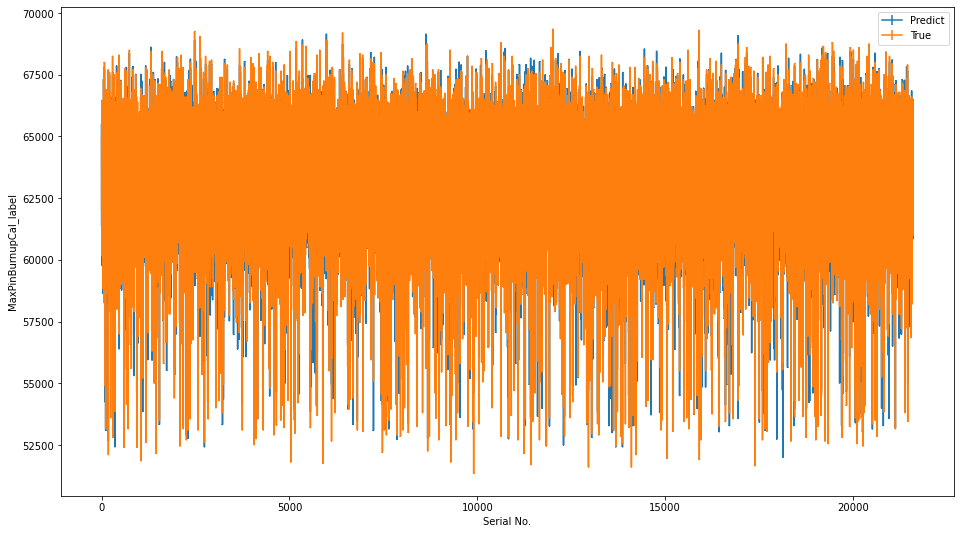

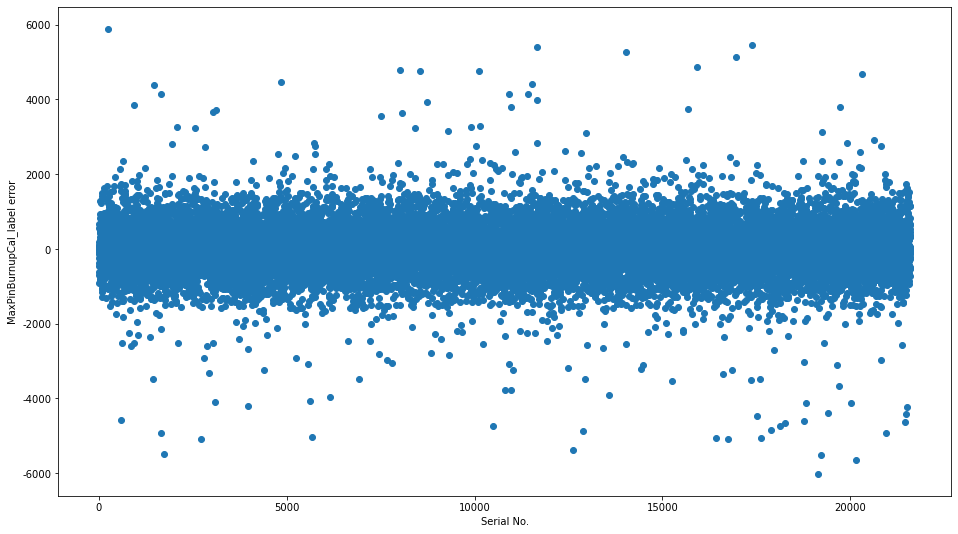

LGB1均差得分为： 456.85700246277446


<Figure size 1152x648 with 0 Axes>

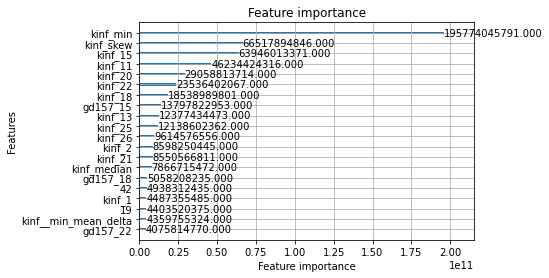

In [112]:

tmp_pred = y_pre_train.copy()
tmp_test = y_test.copy()
for col in tmp_pred:
    tmp_pred[col] = 0
    tmp_test[col] = 0

pred_test = pd.DataFrame(np.zeros((len(X_test),2)), columns=output_col)
df_feat_imp = pd.DataFrame()

for burnup in ['MaxAssBurnupCal_label', 'MaxPinBurnupCal_label']:
    
    pred_arr, feature_importance, y_train_pred, y_test_pred = model_predict(X_pre_train[feat_dic[burnup]], y_pre_train[burnup], 
                                                              X_test[feat_dic[burnup]], burnup, df_feat_imp, tmp_pred, tmp_test)

    pred_test[burnup] = pred_arr
    df_feat_imp = pd.concat([df_feat_imp, feature_importance], axis=1)


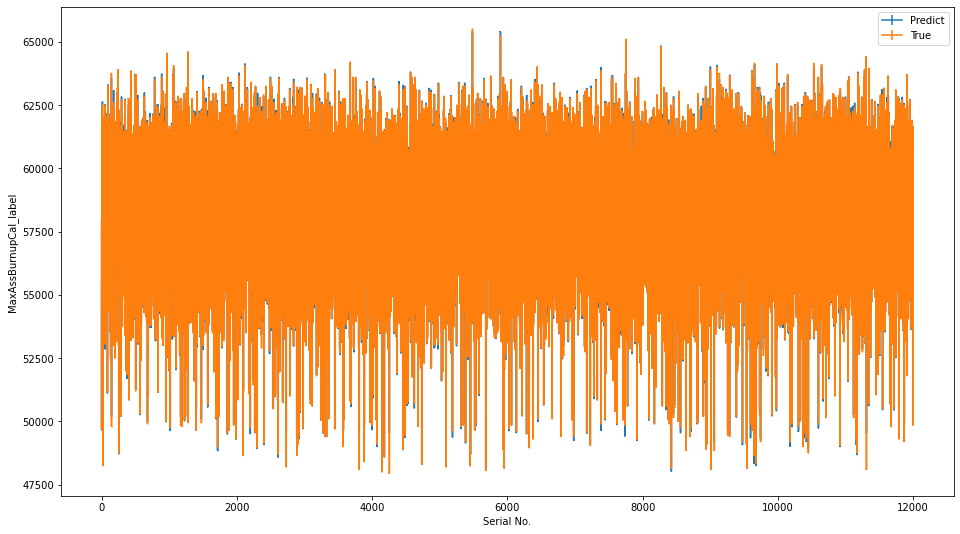

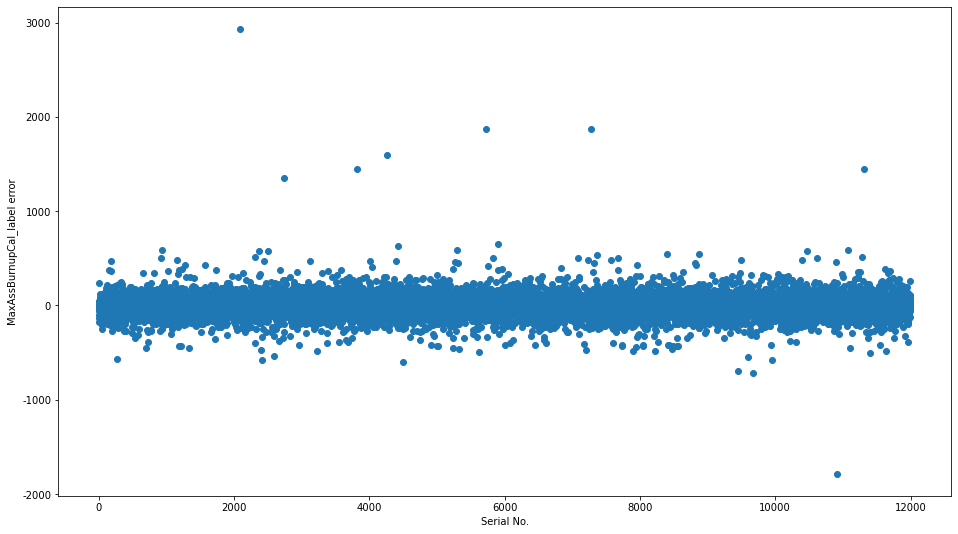

LGB1均差得分为： 78.83975826615628


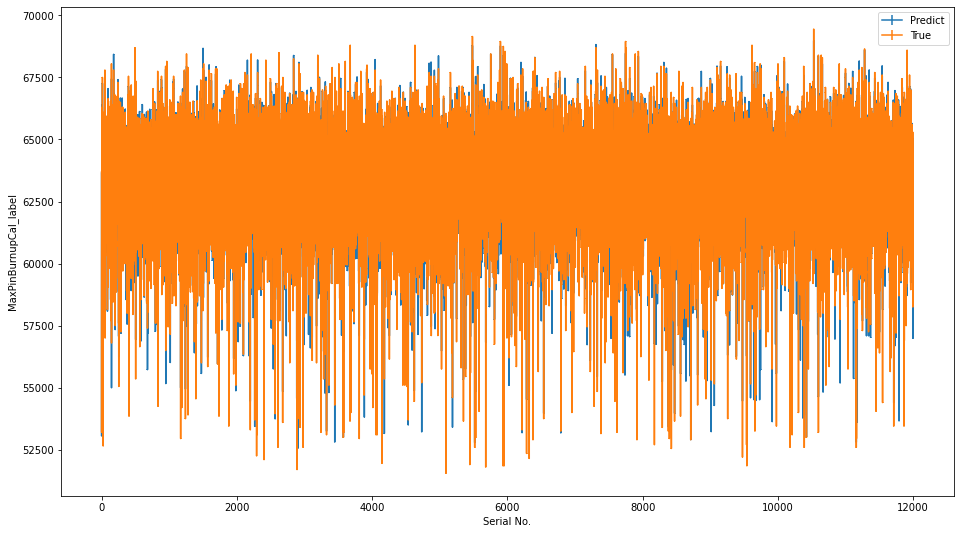

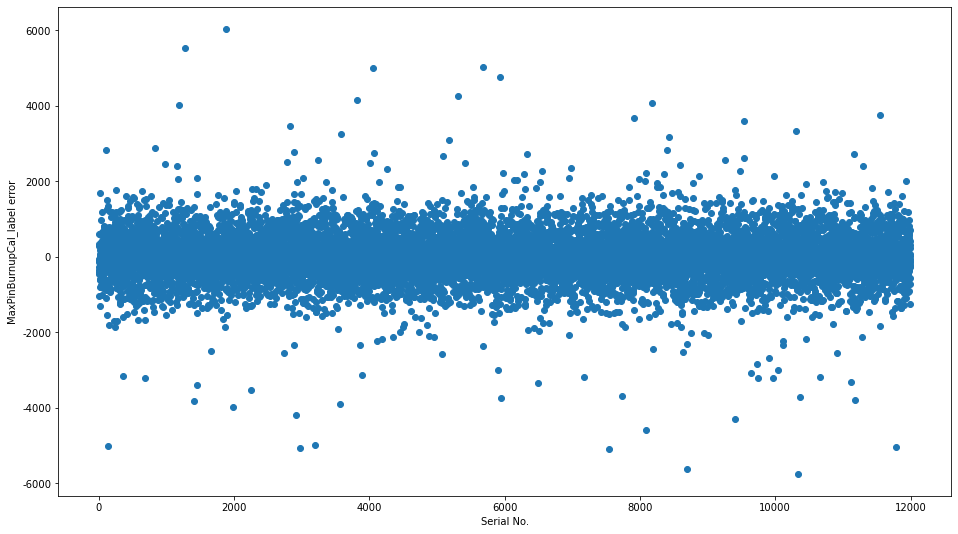

LGB1均差得分为： 438.43214859143086


In [113]:
for col in pred_test.columns:
    plt_error(pred_test[col], y_test[col], col)
    score = mean_absolute_error(pred_test[col], y_test[col])
    print('LGB1均差得分为：', score)
    

In [104]:
y_test

,MaxAssBurnupCal_label,MaxPinBurnupCal_label
47057,57750.0,63700.0
24481,49700.0,53200.0
108820,54600.0,60900.0
21146,56150.0,63850.0
116533,62300.0,66100.0
...,...,...
86734,59850.0,63250.0
9793,57750.0,64000.0
11389,58000.0,63400.0
46670,57100.0,63150.0


In [105]:
df_feat_imp

,feature_name_MaxAssBurnupCal_label,importance_MaxAssBurnupCal_label,feature_name_MaxPinBurnupCal_label,importance_MaxPinBurnupCal_label
0,kinf_min,4.555294e+11,kinf_min,2.032440e+11
1,kinf_skew,1.390942e+10,kinf_skew,6.975486e+10
2,NODE2DBU__min_mean_delta,5.672394e+09,NODE2DBU__min_mean_delta,5.618592e+09
3,kinf_sum,6.203215e+09,kinf_mean,8.265262e+09
4,kinf_mean,7.429854e+08,kinf_sum,5.208593e+08
5,kinf_11,9.217130e+10,kinf_11,4.993540e+10
6,kinf_median,5.829252e+09,kinf_15,7.908018e+10
7,kinf_15,9.000035e+10,kinf_median,1.004311e+10
8,kinf_20,6.590900e+10,gd157_sum,6.818153e+09
9,gd157_sum,5.898698e+09,gd157_mean,2.922324e+08


In [106]:
y_cols

['MaxAssBurnupCal', 'MaxPinBurnupCal']

In [107]:
y_test_real = y_test.copy()
for c in y_cols:

    y_test_real[c+'_label'] = pre_data.loc[y_test.index, c]
    
y_test_real

,MaxAssBurnupCal_label,MaxPinBurnupCal_label
47057,57732,63664.2
24481,49679,53156.4
108820,54567,60857.7
21146,56139,63804.1
116533,62291,66056.1
...,...,...
86734,59847,63212.1
9793,57746,63966.7
11389,57982,63355.0
46670,57080,63106.4


In [108]:
def CalError(pred, test):
    
    col_name = []
    for col in pred.columns:
        col_name.append(col+'_pred')
    for col in test.columns:
        col_name.append(col+'_test')  
    
    pred.index = test.index
#     test.reset_index(drop=True, inplace=True)
    pred_error = pd.concat([pred,test], axis=1)
#     print(pred_error)
    pred_error.columns = col_name
    
    error_col = []
    for col in pred.columns:
        pred_error[col + '_error'] = np.array(pred[col]) - np.array(test[col])
        error_col.append(col + '_error')
    bin_range = np.linspace(0,1000,11).tolist() + [2000, 3000, 4000, 5000, 10000]
    bin_label = np.linspace(1,15,15).tolist()
    
    range_col = []
    for col in error_col:
        pred_error[col+'_range'] = pd.cut(
                                        abs(np.array(pred_error[col])),
                                        bins=bin_range
                                        )
        range_col.append(col+'_range')
        pred_error[col+'_label'] = pd.cut(
                                        abs(np.array(pred_error[col])),
                                        bins=bin_range,
                                        labels=bin_label
                                        )
        range_col.append(col+'_label')
        
    for col in [c for c in range_col if '_range' in c]:
        print(pred_error[col].value_counts())
        
    return pred_error
        
pred_test_error = CalError(pred_test[output_col], y_test_real[output_col])
pred_test_error
        
        

(0.0, 100.0]         8417
(100.0, 200.0]       2713
(200.0, 300.0]        579
(300.0, 400.0]        148
(400.0, 500.0]         67
(500.0, 600.0]         40
(600.0, 700.0]         19
(700.0, 800.0]          5
(1000.0, 2000.0]        4
(2000.0, 3000.0]        4
(800.0, 900.0]          2
(900.0, 1000.0]         2
(3000.0, 4000.0]        0
(4000.0, 5000.0]        0
(5000.0, 10000.0]       0
Name: MaxAssBurnupCal_label_error_range, dtype: int64
(0.0, 100.0]         2217
(100.0, 200.0]       1927
(200.0, 300.0]       1564
(300.0, 400.0]       1181
(1000.0, 2000.0]     1105
(400.0, 500.0]       1003
(500.0, 600.0]        809
(600.0, 700.0]        661
(700.0, 800.0]        522
(800.0, 900.0]        467
(900.0, 1000.0]       420
(2000.0, 3000.0]       72
(3000.0, 4000.0]       29
(5000.0, 10000.0]      13
(4000.0, 5000.0]       10
Name: MaxPinBurnupCal_label_error_range, dtype: int64


,MaxAssBurnupCal_label_pred,MaxPinBurnupCal_label_pred,MaxAssBurnupCal_label_test,MaxPinBurnupCal_label_test,MaxAssBurnupCal_label_error,MaxPinBurnupCal_label_error,MaxAssBurnupCal_label_error_range,MaxAssBurnupCal_label_error_label,MaxPinBurnupCal_label_error_range,MaxPinBurnupCal_label_error_label
47057,57985.000001,63661.008105,57732,63664.2,253.000001,-3.191895,"(200.0, 300.0]",3.0,"(0.0, 100.0]",1.0
24481,49659.999999,52963.337572,49679,53156.4,-19.000001,-193.062428,"(0.0, 100.0]",1.0,"(100.0, 200.0]",2.0
108820,54640.000000,60449.673319,54567,60857.7,73.000000,-408.026681,"(0.0, 100.0]",1.0,"(400.0, 500.0]",5.0
21146,56050.000001,62636.453597,56139,63804.1,-88.999999,-1167.646403,"(0.0, 100.0]",1.0,"(1000.0, 2000.0]",11.0
116533,62275.000000,66332.595169,62291,66056.1,-16.000000,276.495169,"(0.0, 100.0]",1.0,"(200.0, 300.0]",3.0
...,...,...,...,...,...,...,...,...,...,...
86734,59850.000000,63539.734297,59847,63212.1,3.000000,327.634297,"(0.0, 100.0]",1.0,"(300.0, 400.0]",4.0
9793,57821.423690,63909.302693,57746,63966.7,75.423690,-57.397307,"(0.0, 100.0]",1.0,"(0.0, 100.0]",1.0
11389,58050.000000,62810.788486,57982,63355.0,68.000000,-544.211514,"(0.0, 100.0]",1.0,"(500.0, 600.0]",6.0
46670,57166.666666,63125.258408,57080,63106.4,86.666666,18.858408,"(0.0, 100.0]",1.0,"(0.0, 100.0]",1.0


In [109]:
pred_train_error = CalError(y_pre_train, y_train_pred)
pred_train_error

(0.0, 100.0]         91592
(100.0, 200.0]       14291
(200.0, 300.0]        1535
(300.0, 400.0]         444
(400.0, 500.0]          82
(500.0, 600.0]          26
(600.0, 700.0]          11
(700.0, 800.0]           8
(1000.0, 2000.0]         7
(800.0, 900.0]           2
(900.0, 1000.0]          1
(3000.0, 4000.0]         1
(2000.0, 3000.0]         0
(4000.0, 5000.0]         0
(5000.0, 10000.0]        0
Name: MaxAssBurnupCal_label_error_range, dtype: int64
(0.0, 100.0]         26343
(100.0, 200.0]       21074
(200.0, 300.0]       15560
(300.0, 400.0]       11274
(400.0, 500.0]        8677
(500.0, 600.0]        6637
(600.0, 700.0]        5518
(700.0, 800.0]        4066
(1000.0, 2000.0]      3452
(800.0, 900.0]        2963
(900.0, 1000.0]       1901
(2000.0, 3000.0]       341
(3000.0, 4000.0]       154
(4000.0, 5000.0]        40
(5000.0, 10000.0]        0
Name: MaxPinBurnupCal_label_error_range, dtype: int64


,MaxAssBurnupCal_label_pred,MaxPinBurnupCal_label_pred,MaxAssBurnupCal_label_test,MaxPinBurnupCal_label_test,MaxAssBurnupCal_label_error,MaxPinBurnupCal_label_error,MaxAssBurnupCal_label_error_range,MaxAssBurnupCal_label_error_label,MaxPinBurnupCal_label_error_range,MaxPinBurnupCal_label_error_label
74863,55850.0,62250.0,55861.666667,62098.880595,-1.166667e+01,151.119405,"(0.0, 100.0]",1.0,"(100.0, 200.0]",2.0
66469,61250.0,64750.0,61183.333333,64550.553235,6.666667e+01,199.446765,"(0.0, 100.0]",1.0,"(100.0, 200.0]",2.0
66508,62400.0,66000.0,62463.333333,66047.308217,-6.333333e+01,-47.308217,"(0.0, 100.0]",1.0,"(0.0, 100.0]",1.0
16637,55350.0,61500.0,55389.166667,60936.057778,-3.916667e+01,563.942222,"(0.0, 100.0]",1.0,"(500.0, 600.0]",6.0
34093,56550.0,62000.0,56600.000000,61484.222578,-5.000000e+01,515.777422,"(0.0, 100.0]",1.0,"(500.0, 600.0]",6.0
...,...,...,...,...,...,...,...,...,...,...
44739,60700.0,64500.0,60609.999999,64490.096232,9.000000e+01,9.903768,"(0.0, 100.0]",1.0,"(0.0, 100.0]",1.0
113270,59100.0,64450.0,59050.000000,64889.642070,5.000000e+01,-439.642070,"(0.0, 100.0]",1.0,"(400.0, 500.0]",5.0
40259,58250.0,62900.0,58275.000000,63268.450487,-2.500000e+01,-368.450487,"(0.0, 100.0]",1.0,"(300.0, 400.0]",4.0
61832,61850.0,65800.0,61850.000000,65809.082482,-3.087116e-07,-9.082482,"(0.0, 100.0]",1.0,"(0.0, 100.0]",1.0


In [77]:
pred_error = pd.concat([pred_test_error, pred_train_error], axis=0)
pred_error.reset_index(inplace=True)
pred_error

,index,MaxAssBurnupCal_label_pred,MaxPinBurnupCal_label_pred,MaxAssBurnupCal_label_test,MaxPinBurnupCal_label_test,MaxAssBurnupCal_label_error,MaxPinBurnupCal_label_error,MaxAssBurnupCal_label_error_range,MaxAssBurnupCal_label_error_label,MaxPinBurnupCal_label_error_range,MaxPinBurnupCal_label_error_label
0,47057,57984.965248,63634.266666,57732.000000,63664.200000,252.965248,-29.933334,"(200.0, 300.0]",3.0,"(0.0, 100.0]",1.0
1,24481,49660.345353,53029.104752,49679.000000,53156.400000,-18.654647,-127.295248,"(0.0, 100.0]",1.0,"(100.0, 200.0]",2.0
2,108820,54645.416485,60567.788431,54567.000000,60857.700000,78.416485,-289.911569,"(0.0, 100.0]",1.0,"(200.0, 300.0]",3.0
3,21146,56050.036768,62781.350528,56139.000000,63804.100000,-88.963232,-1022.749472,"(0.0, 100.0]",1.0,"(1000.0, 2000.0]",11.0
4,116533,62276.330328,66371.971428,62291.000000,66056.100000,-14.669672,315.871428,"(0.0, 100.0]",1.0,"(300.0, 400.0]",4.0
...,...,...,...,...,...,...,...,...,...,...,...
119995,44739,60700.000000,64500.000000,60607.926402,64431.984010,92.073598,68.015990,"(0.0, 100.0]",1.0,"(0.0, 100.0]",1.0
119996,113270,59100.000000,64450.000000,59050.087641,64875.755527,49.912359,-425.755527,"(0.0, 100.0]",1.0,"(400.0, 500.0]",5.0
119997,40259,58250.000000,62900.000000,58274.906463,63255.853933,-24.906463,-355.853933,"(0.0, 100.0]",1.0,"(300.0, 400.0]",4.0
119998,61832,61850.000000,65800.000000,61849.908482,65778.874468,0.091518,21.125532,"(0.0, 100.0]",1.0,"(0.0, 100.0]",1.0


In [78]:
pred_error.sort_values(by='index', inplace=True)
pred_error

,index,MaxAssBurnupCal_label_pred,MaxPinBurnupCal_label_pred,MaxAssBurnupCal_label_test,MaxPinBurnupCal_label_test,MaxAssBurnupCal_label_error,MaxPinBurnupCal_label_error,MaxAssBurnupCal_label_error_range,MaxAssBurnupCal_label_error_label,MaxPinBurnupCal_label_error_range,MaxPinBurnupCal_label_error_label
25628,0,56650.000000,62500.000000,56699.932596,62198.802235,-49.932596,301.197765,"(0.0, 100.0]",1.0,"(300.0, 400.0]",4.0
88064,1,56850.000000,62000.000000,56699.932596,62198.802235,150.067404,-198.802235,"(100.0, 200.0]",2.0,"(100.0, 200.0]",2.0
23363,2,56750.000000,62550.000000,56699.932596,62198.802235,50.067404,351.197765,"(0.0, 100.0]",1.0,"(300.0, 400.0]",4.0
21131,3,56550.000000,62200.000000,56699.932596,62198.802235,-149.932596,1.197765,"(100.0, 200.0]",2.0,"(0.0, 100.0]",1.0
102869,4,57450.000000,64050.000000,57395.220223,64158.194191,54.779777,-108.194191,"(0.0, 100.0]",1.0,"(100.0, 200.0]",2.0
...,...,...,...,...,...,...,...,...,...,...,...
105348,119995,57400.000000,63600.000000,57416.559190,63452.924481,-16.559190,147.075519,"(0.0, 100.0]",1.0,"(100.0, 200.0]",2.0
28605,119996,59600.000000,64900.000000,59598.313446,64580.021109,1.686554,319.978891,"(0.0, 100.0]",1.0,"(300.0, 400.0]",4.0
11446,119997,59598.313446,64580.021109,59631.000000,63716.200000,-32.686554,863.821109,"(0.0, 100.0]",1.0,"(800.0, 900.0]",9.0
108299,119998,61750.000000,65650.000000,61766.935968,65780.904240,-16.935968,-130.904240,"(0.0, 100.0]",1.0,"(100.0, 200.0]",2.0


In [79]:
ass_pred_outlier_list = []
pin_pred_outlier_list = []
threshold_value = 800

for index,row in pred_error.iterrows():
    if abs(pred_error.loc[index, 'MaxAssBurnupCal_label_error']) >= threshold_value:
        ass_pred_outlier_list.append(pred_error.loc[index, 'index'])
        print('MaxAss误差大于{}的行号是{}。'.format(threshold_value, pred_error.loc[index, 'index']))
        
    elif abs(pred_error.loc[index, 'MaxPinBurnupCal_label_error']) >= threshold_value:
        pin_pred_outlier_list.append(pred_error.loc[index, 'index'])
        print('MaxPin误差大于{}的行号是{}。'.format(threshold_value, pred_error.loc[index, 'index']))
            
ass_pred_outlier = pre_data.loc[ass_pred_outlier_list, :]
pin_pred_outlier = pre_data.loc[pin_pred_outlier_list, :]
ass_pred_outlier

MaxPin误差大于800的行号是25。
MaxPin误差大于800的行号是39。
MaxPin误差大于800的行号是41。
MaxPin误差大于800的行号是43。
MaxPin误差大于800的行号是45。
MaxPin误差大于800的行号是46。
MaxPin误差大于800的行号是49。
MaxPin误差大于800的行号是60。
MaxPin误差大于800的行号是63。
MaxPin误差大于800的行号是71。
MaxPin误差大于800的行号是95。
MaxPin误差大于800的行号是105。
MaxPin误差大于800的行号是109。
MaxPin误差大于800的行号是114。
MaxPin误差大于800的行号是115。
MaxPin误差大于800的行号是136。
MaxPin误差大于800的行号是154。
MaxPin误差大于800的行号是156。
MaxPin误差大于800的行号是160。
MaxPin误差大于800的行号是169。
MaxPin误差大于800的行号是170。
MaxPin误差大于800的行号是178。
MaxPin误差大于800的行号是185。
MaxPin误差大于800的行号是212。
MaxPin误差大于800的行号是216。
MaxPin误差大于800的行号是222。
MaxPin误差大于800的行号是223。
MaxPin误差大于800的行号是224。
MaxPin误差大于800的行号是225。
MaxPin误差大于800的行号是226。
MaxPin误差大于800的行号是230。
MaxPin误差大于800的行号是231。
MaxPin误差大于800的行号是235。
MaxPin误差大于800的行号是239。
MaxPin误差大于800的行号是249。
MaxPin误差大于800的行号是255。
MaxPin误差大于800的行号是256。
MaxPin误差大于800的行号是259。
MaxPin误差大于800的行号是273。
MaxPin误差大于800的行号是286。
MaxPin误差大于800的行号是287。
MaxPin误差大于800的行号是293。
MaxPin误差大于800的行号是318。
MaxPin误差大于800的行号是336。
MaxPin误差大于800的行号是362。
MaxPin误差大于800的行号是364。

MaxPin误差大于800的行号是5443。
MaxPin误差大于800的行号是5462。
MaxPin误差大于800的行号是5463。
MaxPin误差大于800的行号是5472。
MaxPin误差大于800的行号是5476。
MaxPin误差大于800的行号是5492。
MaxPin误差大于800的行号是5494。
MaxPin误差大于800的行号是5495。
MaxPin误差大于800的行号是5496。
MaxPin误差大于800的行号是5498。
MaxPin误差大于800的行号是5499。
MaxPin误差大于800的行号是5512。
MaxPin误差大于800的行号是5517。
MaxPin误差大于800的行号是5519。
MaxPin误差大于800的行号是5522。
MaxPin误差大于800的行号是5529。
MaxPin误差大于800的行号是5535。
MaxPin误差大于800的行号是5561。
MaxPin误差大于800的行号是5562。
MaxPin误差大于800的行号是5573。
MaxPin误差大于800的行号是5577。
MaxPin误差大于800的行号是5578。
MaxPin误差大于800的行号是5595。
MaxPin误差大于800的行号是5596。
MaxPin误差大于800的行号是5597。
MaxPin误差大于800的行号是5620。
MaxPin误差大于800的行号是5621。
MaxPin误差大于800的行号是5630。
MaxPin误差大于800的行号是5650。
MaxPin误差大于800的行号是5656。
MaxPin误差大于800的行号是5657。
MaxPin误差大于800的行号是5663。
MaxPin误差大于800的行号是5665。
MaxPin误差大于800的行号是5671。
MaxPin误差大于800的行号是5706。
MaxPin误差大于800的行号是5712。
MaxPin误差大于800的行号是5723。
MaxPin误差大于800的行号是5735。
MaxPin误差大于800的行号是5745。
MaxPin误差大于800的行号是5746。
MaxPin误差大于800的行号是5785。
MaxPin误差大于800的行号是5806。
MaxPin误差大于800的行号是5816。
MaxPin误差大于8

MaxPin误差大于800的行号是10634。
MaxPin误差大于800的行号是10656。
MaxPin误差大于800的行号是10659。
MaxPin误差大于800的行号是10665。
MaxPin误差大于800的行号是10671。
MaxPin误差大于800的行号是10683。
MaxPin误差大于800的行号是10688。
MaxPin误差大于800的行号是10691。
MaxPin误差大于800的行号是10696。
MaxPin误差大于800的行号是10697。
MaxPin误差大于800的行号是10707。
MaxPin误差大于800的行号是10722。
MaxPin误差大于800的行号是10727。
MaxPin误差大于800的行号是10736。
MaxPin误差大于800的行号是10737。
MaxPin误差大于800的行号是10764。
MaxPin误差大于800的行号是10768。
MaxPin误差大于800的行号是10779。
MaxPin误差大于800的行号是10800。
MaxPin误差大于800的行号是10801。
MaxPin误差大于800的行号是10803。
MaxPin误差大于800的行号是10819。
MaxPin误差大于800的行号是10820。
MaxPin误差大于800的行号是10829。
MaxPin误差大于800的行号是10846。
MaxPin误差大于800的行号是10850。
MaxPin误差大于800的行号是10851。
MaxPin误差大于800的行号是10852。
MaxPin误差大于800的行号是10879。
MaxPin误差大于800的行号是10881。
MaxPin误差大于800的行号是10890。
MaxPin误差大于800的行号是10893。
MaxPin误差大于800的行号是10895。
MaxPin误差大于800的行号是10905。
MaxPin误差大于800的行号是10915。
MaxPin误差大于800的行号是10922。
MaxPin误差大于800的行号是10940。
MaxPin误差大于800的行号是10943。
MaxPin误差大于800的行号是10957。
MaxPin误差大于800的行号是10993。
MaxPin误差大于800的行号是10994。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是15812。
MaxPin误差大于800的行号是15814。
MaxPin误差大于800的行号是15825。
MaxPin误差大于800的行号是15844。
MaxPin误差大于800的行号是15858。
MaxPin误差大于800的行号是15861。
MaxPin误差大于800的行号是15862。
MaxPin误差大于800的行号是15884。
MaxPin误差大于800的行号是15885。
MaxPin误差大于800的行号是15886。
MaxPin误差大于800的行号是15897。
MaxPin误差大于800的行号是15903。
MaxPin误差大于800的行号是15917。
MaxPin误差大于800的行号是15923。
MaxPin误差大于800的行号是15924。
MaxPin误差大于800的行号是15932。
MaxPin误差大于800的行号是15935。
MaxPin误差大于800的行号是15941。
MaxPin误差大于800的行号是15943。
MaxPin误差大于800的行号是15952。
MaxPin误差大于800的行号是15960。
MaxPin误差大于800的行号是15973。
MaxPin误差大于800的行号是16005。
MaxPin误差大于800的行号是16011。
MaxPin误差大于800的行号是16025。
MaxPin误差大于800的行号是16027。
MaxPin误差大于800的行号是16028。
MaxPin误差大于800的行号是16029。
MaxPin误差大于800的行号是16045。
MaxPin误差大于800的行号是16057。
MaxPin误差大于800的行号是16061。
MaxPin误差大于800的行号是16062。
MaxPin误差大于800的行号是16073。
MaxPin误差大于800的行号是16075。
MaxPin误差大于800的行号是16086。
MaxPin误差大于800的行号是16090。
MaxPin误差大于800的行号是16095。
MaxPin误差大于800的行号是16104。
MaxPin误差大于800的行号是16107。
MaxPin误差大于800的行号是16117。
MaxPin误差大于800的行号是16133。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是20976。
MaxPin误差大于800的行号是20978。
MaxPin误差大于800的行号是20979。
MaxPin误差大于800的行号是20982。
MaxPin误差大于800的行号是20988。
MaxPin误差大于800的行号是20992。
MaxPin误差大于800的行号是20995。
MaxPin误差大于800的行号是20996。
MaxPin误差大于800的行号是21001。
MaxPin误差大于800的行号是21009。
MaxPin误差大于800的行号是21010。
MaxPin误差大于800的行号是21012。
MaxPin误差大于800的行号是21014。
MaxPin误差大于800的行号是21019。
MaxPin误差大于800的行号是21083。
MaxPin误差大于800的行号是21087。
MaxPin误差大于800的行号是21103。
MaxPin误差大于800的行号是21110。
MaxPin误差大于800的行号是21121。
MaxPin误差大于800的行号是21122。
MaxPin误差大于800的行号是21123。
MaxPin误差大于800的行号是21125。
MaxPin误差大于800的行号是21126。
MaxPin误差大于800的行号是21142。
MaxPin误差大于800的行号是21146。
MaxPin误差大于800的行号是21147。
MaxPin误差大于800的行号是21152。
MaxPin误差大于800的行号是21153。
MaxPin误差大于800的行号是21155。
MaxPin误差大于800的行号是21168。
MaxPin误差大于800的行号是21181。
MaxPin误差大于800的行号是21186。
MaxPin误差大于800的行号是21197。
MaxPin误差大于800的行号是21199。
MaxPin误差大于800的行号是21201。
MaxPin误差大于800的行号是21203。
MaxPin误差大于800的行号是21224。
MaxPin误差大于800的行号是21225。
MaxPin误差大于800的行号是21230。
MaxPin误差大于800的行号是21235。
MaxPin误差大于800的行号是21236。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是23446。
MaxPin误差大于800的行号是23479。
MaxPin误差大于800的行号是23518。
MaxPin误差大于800的行号是23519。
MaxPin误差大于800的行号是23520。
MaxPin误差大于800的行号是23523。
MaxPin误差大于800的行号是23543。
MaxPin误差大于800的行号是23548。
MaxPin误差大于800的行号是23549。
MaxPin误差大于800的行号是23550。
MaxPin误差大于800的行号是23551。
MaxPin误差大于800的行号是23560。
MaxPin误差大于800的行号是23561。
MaxPin误差大于800的行号是23564。
MaxPin误差大于800的行号是23565。
MaxPin误差大于800的行号是23567。
MaxPin误差大于800的行号是23572。
MaxPin误差大于800的行号是23577。
MaxPin误差大于800的行号是23590。
MaxPin误差大于800的行号是23610。
MaxPin误差大于800的行号是23624。
MaxPin误差大于800的行号是23631。
MaxPin误差大于800的行号是23644。
MaxPin误差大于800的行号是23656。
MaxPin误差大于800的行号是23657。
MaxPin误差大于800的行号是23689。
MaxPin误差大于800的行号是23690。
MaxPin误差大于800的行号是23701。
MaxPin误差大于800的行号是23704。
MaxPin误差大于800的行号是23706。
MaxPin误差大于800的行号是23742。
MaxPin误差大于800的行号是23744。
MaxPin误差大于800的行号是23745。
MaxPin误差大于800的行号是23747。
MaxPin误差大于800的行号是23759。
MaxPin误差大于800的行号是23772。
MaxPin误差大于800的行号是23800。
MaxPin误差大于800的行号是23802。
MaxPin误差大于800的行号是23808。
MaxPin误差大于800的行号是23829。
MaxPin误差大于800的行号是23832。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是28609。
MaxPin误差大于800的行号是28618。
MaxPin误差大于800的行号是28630。
MaxPin误差大于800的行号是28633。
MaxPin误差大于800的行号是28659。
MaxPin误差大于800的行号是28662。
MaxPin误差大于800的行号是28673。
MaxPin误差大于800的行号是28686。
MaxPin误差大于800的行号是28687。
MaxPin误差大于800的行号是28704。
MaxPin误差大于800的行号是28708。
MaxPin误差大于800的行号是28710。
MaxPin误差大于800的行号是28713。
MaxPin误差大于800的行号是28726。
MaxPin误差大于800的行号是28728。
MaxPin误差大于800的行号是28729。
MaxPin误差大于800的行号是28733。
MaxPin误差大于800的行号是28734。
MaxPin误差大于800的行号是28735。
MaxPin误差大于800的行号是28741。
MaxPin误差大于800的行号是28758。
MaxPin误差大于800的行号是28759。
MaxPin误差大于800的行号是28802。
MaxPin误差大于800的行号是28804。
MaxPin误差大于800的行号是28837。
MaxPin误差大于800的行号是28856。
MaxPin误差大于800的行号是28899。
MaxPin误差大于800的行号是28930。
MaxPin误差大于800的行号是28932。
MaxPin误差大于800的行号是28934。
MaxPin误差大于800的行号是28939。
MaxPin误差大于800的行号是28951。
MaxPin误差大于800的行号是28952。
MaxPin误差大于800的行号是28955。
MaxPin误差大于800的行号是28958。
MaxPin误差大于800的行号是28964。
MaxPin误差大于800的行号是28984。
MaxPin误差大于800的行号是28985。
MaxPin误差大于800的行号是28989。
MaxPin误差大于800的行号是29021。
MaxPin误差大于800的行号是29023。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是33697。
MaxPin误差大于800的行号是33702。
MaxPin误差大于800的行号是33727。
MaxPin误差大于800的行号是33728。
MaxPin误差大于800的行号是33731。
MaxPin误差大于800的行号是33741。
MaxPin误差大于800的行号是33747。
MaxPin误差大于800的行号是33748。
MaxPin误差大于800的行号是33775。
MaxPin误差大于800的行号是33791。
MaxPin误差大于800的行号是33794。
MaxPin误差大于800的行号是33802。
MaxPin误差大于800的行号是33805。
MaxPin误差大于800的行号是33826。
MaxPin误差大于800的行号是33833。
MaxPin误差大于800的行号是33841。
MaxPin误差大于800的行号是33850。
MaxPin误差大于800的行号是33862。
MaxPin误差大于800的行号是33880。
MaxPin误差大于800的行号是33881。
MaxPin误差大于800的行号是33882。
MaxPin误差大于800的行号是33885。
MaxPin误差大于800的行号是33887。
MaxPin误差大于800的行号是33901。
MaxPin误差大于800的行号是33903。
MaxPin误差大于800的行号是33912。
MaxPin误差大于800的行号是33995。
MaxPin误差大于800的行号是33996。
MaxPin误差大于800的行号是33997。
MaxPin误差大于800的行号是33998。
MaxPin误差大于800的行号是34047。
MaxPin误差大于800的行号是34048。
MaxPin误差大于800的行号是34102。
MaxPin误差大于800的行号是34104。
MaxPin误差大于800的行号是34124。
MaxPin误差大于800的行号是34125。
MaxPin误差大于800的行号是34150。
MaxPin误差大于800的行号是34155。
MaxPin误差大于800的行号是34164。
MaxPin误差大于800的行号是34207。
MaxPin误差大于800的行号是34208。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是39179。
MaxPin误差大于800的行号是39183。
MaxPin误差大于800的行号是39184。
MaxPin误差大于800的行号是39187。
MaxPin误差大于800的行号是39195。
MaxPin误差大于800的行号是39196。
MaxPin误差大于800的行号是39197。
MaxPin误差大于800的行号是39202。
MaxPin误差大于800的行号是39208。
MaxPin误差大于800的行号是39210。
MaxPin误差大于800的行号是39217。
MaxPin误差大于800的行号是39248。
MaxPin误差大于800的行号是39250。
MaxPin误差大于800的行号是39262。
MaxPin误差大于800的行号是39274。
MaxPin误差大于800的行号是39275。
MaxPin误差大于800的行号是39311。
MaxPin误差大于800的行号是39324。
MaxPin误差大于800的行号是39335。
MaxPin误差大于800的行号是39355。
MaxPin误差大于800的行号是39356。
MaxPin误差大于800的行号是39358。
MaxPin误差大于800的行号是39361。
MaxPin误差大于800的行号是39370。
MaxPin误差大于800的行号是39388。
MaxPin误差大于800的行号是39390。
MaxPin误差大于800的行号是39401。
MaxPin误差大于800的行号是39406。
MaxPin误差大于800的行号是39408。
MaxPin误差大于800的行号是39424。
MaxPin误差大于800的行号是39426。
MaxPin误差大于800的行号是39428。
MaxPin误差大于800的行号是39431。
MaxPin误差大于800的行号是39451。
MaxPin误差大于800的行号是39464。
MaxPin误差大于800的行号是39466。
MaxPin误差大于800的行号是39479。
MaxPin误差大于800的行号是39480。
MaxPin误差大于800的行号是39490。
MaxPin误差大于800的行号是39510。
MaxPin误差大于800的行号是39511。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是44342。
MaxPin误差大于800的行号是44348。
MaxPin误差大于800的行号是44357。
MaxPin误差大于800的行号是44360。
MaxPin误差大于800的行号是44371。
MaxPin误差大于800的行号是44380。
MaxPin误差大于800的行号是44387。
MaxPin误差大于800的行号是44401。
MaxPin误差大于800的行号是44420。
MaxPin误差大于800的行号是44438。
MaxPin误差大于800的行号是44447。
MaxPin误差大于800的行号是44459。
MaxPin误差大于800的行号是44462。
MaxPin误差大于800的行号是44463。
MaxPin误差大于800的行号是44465。
MaxPin误差大于800的行号是44469。
MaxPin误差大于800的行号是44473。
MaxPin误差大于800的行号是44474。
MaxPin误差大于800的行号是44477。
MaxPin误差大于800的行号是44483。
MaxPin误差大于800的行号是44488。
MaxPin误差大于800的行号是44491。
MaxPin误差大于800的行号是44504。
MaxPin误差大于800的行号是44505。
MaxPin误差大于800的行号是44540。
MaxPin误差大于800的行号是44566。
MaxPin误差大于800的行号是44570。
MaxPin误差大于800的行号是44592。
MaxPin误差大于800的行号是44600。
MaxPin误差大于800的行号是44603。
MaxPin误差大于800的行号是44605。
MaxPin误差大于800的行号是44628。
MaxPin误差大于800的行号是44644。
MaxPin误差大于800的行号是44645。
MaxPin误差大于800的行号是44646。
MaxPin误差大于800的行号是44655。
MaxPin误差大于800的行号是44658。
MaxPin误差大于800的行号是44660。
MaxPin误差大于800的行号是44668。
MaxPin误差大于800的行号是44669。
MaxPin误差大于800的行号是44671。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是49387。
MaxPin误差大于800的行号是49392。
MaxPin误差大于800的行号是49400。
MaxPin误差大于800的行号是49401。
MaxPin误差大于800的行号是49402。
MaxPin误差大于800的行号是49414。
MaxPin误差大于800的行号是49429。
MaxPin误差大于800的行号是49431。
MaxPin误差大于800的行号是49434。
MaxPin误差大于800的行号是49445。
MaxPin误差大于800的行号是49460。
MaxPin误差大于800的行号是49461。
MaxPin误差大于800的行号是49509。
MaxPin误差大于800的行号是49604。
MaxPin误差大于800的行号是49616。
MaxPin误差大于800的行号是49645。
MaxPin误差大于800的行号是49657。
MaxPin误差大于800的行号是49661。
MaxPin误差大于800的行号是49667。
MaxPin误差大于800的行号是49673。
MaxPin误差大于800的行号是49674。
MaxPin误差大于800的行号是49681。
MaxPin误差大于800的行号是49686。
MaxPin误差大于800的行号是49687。
MaxPin误差大于800的行号是49692。
MaxPin误差大于800的行号是49694。
MaxPin误差大于800的行号是49695。
MaxPin误差大于800的行号是49696。
MaxPin误差大于800的行号是49698。
MaxPin误差大于800的行号是49706。
MaxPin误差大于800的行号是49707。
MaxPin误差大于800的行号是49717。
MaxPin误差大于800的行号是49719。
MaxPin误差大于800的行号是49733。
MaxPin误差大于800的行号是49742。
MaxPin误差大于800的行号是49745。
MaxPin误差大于800的行号是49749。
MaxPin误差大于800的行号是49750。
MaxPin误差大于800的行号是49751。
MaxPin误差大于800的行号是49766。
MaxPin误差大于800的行号是49800。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是54577。
MaxPin误差大于800的行号是54580。
MaxPin误差大于800的行号是54582。
MaxPin误差大于800的行号是54583。
MaxPin误差大于800的行号是54591。
MaxPin误差大于800的行号是54606。
MaxPin误差大于800的行号是54643。
MaxPin误差大于800的行号是54644。
MaxPin误差大于800的行号是54668。
MaxPin误差大于800的行号是54671。
MaxPin误差大于800的行号是54673。
MaxPin误差大于800的行号是54689。
MaxPin误差大于800的行号是54691。
MaxPin误差大于800的行号是54694。
MaxPin误差大于800的行号是54701。
MaxPin误差大于800的行号是54702。
MaxPin误差大于800的行号是54704。
MaxPin误差大于800的行号是54706。
MaxPin误差大于800的行号是54707。
MaxPin误差大于800的行号是54719。
MaxPin误差大于800的行号是54760。
MaxPin误差大于800的行号是54761。
MaxPin误差大于800的行号是54762。
MaxPin误差大于800的行号是54767。
MaxPin误差大于800的行号是54776。
MaxPin误差大于800的行号是54778。
MaxPin误差大于800的行号是54817。
MaxPin误差大于800的行号是54819。
MaxPin误差大于800的行号是54821。
MaxPin误差大于800的行号是54824。
MaxPin误差大于800的行号是54825。
MaxPin误差大于800的行号是54844。
MaxPin误差大于800的行号是54845。
MaxPin误差大于800的行号是54851。
MaxPin误差大于800的行号是54853。
MaxPin误差大于800的行号是54855。
MaxPin误差大于800的行号是54879。
MaxPin误差大于800的行号是54887。
MaxPin误差大于800的行号是54889。
MaxPin误差大于800的行号是54891。
MaxPin误差大于800的行号是54933。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是59737。
MaxPin误差大于800的行号是59738。
MaxPin误差大于800的行号是59739。
MaxPin误差大于800的行号是59744。
MaxPin误差大于800的行号是59746。
MaxPin误差大于800的行号是59749。
MaxPin误差大于800的行号是59751。
MaxPin误差大于800的行号是59758。
MaxPin误差大于800的行号是59760。
MaxPin误差大于800的行号是59763。
MaxPin误差大于800的行号是59765。
MaxPin误差大于800的行号是59771。
MaxPin误差大于800的行号是59786。
MaxPin误差大于800的行号是59790。
MaxPin误差大于800的行号是59794。
MaxPin误差大于800的行号是59796。
MaxPin误差大于800的行号是59800。
MaxPin误差大于800的行号是59828。
MaxPin误差大于800的行号是59833。
MaxPin误差大于800的行号是59838。
MaxPin误差大于800的行号是59845。
MaxPin误差大于800的行号是59846。
MaxPin误差大于800的行号是59853。
MaxPin误差大于800的行号是59893。
MaxPin误差大于800的行号是59894。
MaxPin误差大于800的行号是59900。
MaxPin误差大于800的行号是59905。
MaxPin误差大于800的行号是59906。
MaxPin误差大于800的行号是59926。
MaxPin误差大于800的行号是59928。
MaxPin误差大于800的行号是59941。
MaxPin误差大于800的行号是59942。
MaxPin误差大于800的行号是59948。
MaxPin误差大于800的行号是59952。
MaxPin误差大于800的行号是59954。
MaxPin误差大于800的行号是59956。
MaxPin误差大于800的行号是59959。
MaxPin误差大于800的行号是59969。
MaxPin误差大于800的行号是59970。
MaxPin误差大于800的行号是59976。
MaxPin误差大于800的行号是59979。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是72239。
MaxPin误差大于800的行号是72260。
MaxPin误差大于800的行号是72273。
MaxPin误差大于800的行号是72275。
MaxPin误差大于800的行号是72281。
MaxPin误差大于800的行号是72283。
MaxPin误差大于800的行号是72297。
MaxPin误差大于800的行号是72299。
MaxPin误差大于800的行号是72303。
MaxPin误差大于800的行号是72313。
MaxPin误差大于800的行号是72315。
MaxPin误差大于800的行号是72328。
MaxPin误差大于800的行号是72337。
MaxPin误差大于800的行号是72339。
MaxPin误差大于800的行号是72352。
MaxPin误差大于800的行号是72362。
MaxPin误差大于800的行号是72365。
MaxPin误差大于800的行号是72367。
MaxPin误差大于800的行号是72390。
MaxPin误差大于800的行号是72401。
MaxPin误差大于800的行号是72403。
MaxPin误差大于800的行号是72422。
MaxPin误差大于800的行号是72426。
MaxPin误差大于800的行号是72455。
MaxPin误差大于800的行号是72456。
MaxPin误差大于800的行号是72475。
MaxPin误差大于800的行号是72483。
MaxPin误差大于800的行号是72487。
MaxPin误差大于800的行号是72488。
MaxPin误差大于800的行号是72520。
MaxPin误差大于800的行号是72538。
MaxPin误差大于800的行号是72546。
MaxPin误差大于800的行号是72561。
MaxPin误差大于800的行号是72578。
MaxPin误差大于800的行号是72587。
MaxPin误差大于800的行号是72615。
MaxPin误差大于800的行号是72620。
MaxPin误差大于800的行号是72632。
MaxPin误差大于800的行号是72649。
MaxPin误差大于800的行号是72651。
MaxPin误差大于800的行号是72671。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是77351。
MaxPin误差大于800的行号是77361。
MaxPin误差大于800的行号是77363。
MaxPin误差大于800的行号是77380。
MaxPin误差大于800的行号是77382。
MaxPin误差大于800的行号是77383。
MaxPin误差大于800的行号是77401。
MaxPin误差大于800的行号是77403。
MaxPin误差大于800的行号是77413。
MaxPin误差大于800的行号是77415。
MaxPin误差大于800的行号是77429。
MaxPin误差大于800的行号是77431。
MaxPin误差大于800的行号是77465。
MaxPin误差大于800的行号是77467。
MaxPin误差大于800的行号是77486。
MaxPin误差大于800的行号是77493。
MaxPin误差大于800的行号是77495。
MaxPin误差大于800的行号是77498。
MaxPin误差大于800的行号是77531。
MaxPin误差大于800的行号是77546。
MaxPin误差大于800的行号是77549。
MaxPin误差大于800的行号是77569。
MaxPin误差大于800的行号是77571。
MaxPin误差大于800的行号是77582。
MaxPin误差大于800的行号是77608。
MaxPin误差大于800的行号是77617。
MaxPin误差大于800的行号是77619。
MaxPin误差大于800的行号是77638。
MaxPin误差大于800的行号是77642。
MaxPin误差大于800的行号是77646。
MaxPin误差大于800的行号是77657。
MaxPin误差大于800的行号是77659。
MaxPin误差大于800的行号是77668。
MaxPin误差大于800的行号是77673。
MaxPin误差大于800的行号是77693。
MaxPin误差大于800的行号是77695。
MaxPin误差大于800的行号是77717。
MaxPin误差大于800的行号是77719。
MaxPin误差大于800的行号是77725。
MaxPin误差大于800的行号是77749。
MaxPin误差大于800的行号是77758。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是82630。
MaxPin误差大于800的行号是82640。
MaxPin误差大于800的行号是82666。
MaxPin误差大于800的行号是82686。
MaxPin误差大于800的行号是82700。
MaxPin误差大于800的行号是82701。
MaxPin误差大于800的行号是82706。
MaxPin误差大于800的行号是82710。
MaxPin误差大于800的行号是82711。
MaxPin误差大于800的行号是82725。
MaxPin误差大于800的行号是82732。
MaxPin误差大于800的行号是82747。
MaxPin误差大于800的行号是82749。
MaxPin误差大于800的行号是82750。
MaxPin误差大于800的行号是82762。
MaxPin误差大于800的行号是82770。
MaxPin误差大于800的行号是82774。
MaxPin误差大于800的行号是82785。
MaxPin误差大于800的行号是82795。
MaxPin误差大于800的行号是82802。
MaxPin误差大于800的行号是82817。
MaxPin误差大于800的行号是82820。
MaxPin误差大于800的行号是82866。
MaxPin误差大于800的行号是82868。
MaxPin误差大于800的行号是82870。
MaxPin误差大于800的行号是82881。
MaxPin误差大于800的行号是82888。
MaxPin误差大于800的行号是82903。
MaxPin误差大于800的行号是82914。
MaxPin误差大于800的行号是82919。
MaxPin误差大于800的行号是82921。
MaxPin误差大于800的行号是82925。
MaxPin误差大于800的行号是82955。
MaxPin误差大于800的行号是82956。
MaxPin误差大于800的行号是82961。
MaxPin误差大于800的行号是82996。
MaxPin误差大于800的行号是83009。
MaxPin误差大于800的行号是83011。
MaxPin误差大于800的行号是83013。
MaxPin误差大于800的行号是83032。
MaxPin误差大于800的行号是83033。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是89144。
MaxPin误差大于800的行号是89154。
MaxPin误差大于800的行号是89162。
MaxPin误差大于800的行号是89236。
MaxPin误差大于800的行号是89290。
MaxPin误差大于800的行号是89381。
MaxPin误差大于800的行号是89451。
MaxPin误差大于800的行号是89483。
MaxPin误差大于800的行号是89619。
MaxPin误差大于800的行号是89624。
MaxPin误差大于800的行号是89629。
MaxPin误差大于800的行号是89649。
MaxPin误差大于800的行号是89656。
MaxPin误差大于800的行号是89747。
MaxPin误差大于800的行号是89772。
MaxPin误差大于800的行号是89853。
MaxPin误差大于800的行号是89859。
MaxPin误差大于800的行号是89931。
MaxPin误差大于800的行号是89980。
MaxPin误差大于800的行号是90011。
MaxPin误差大于800的行号是90016。
MaxPin误差大于800的行号是90348。
MaxPin误差大于800的行号是90548。
MaxPin误差大于800的行号是90657。
MaxPin误差大于800的行号是90724。
MaxPin误差大于800的行号是90730。
MaxPin误差大于800的行号是90810。
MaxPin误差大于800的行号是90850。
MaxPin误差大于800的行号是90851。
MaxPin误差大于800的行号是90896。
MaxPin误差大于800的行号是90908。
MaxPin误差大于800的行号是90922。
MaxPin误差大于800的行号是90966。
MaxPin误差大于800的行号是91009。
MaxPin误差大于800的行号是91178。
MaxPin误差大于800的行号是91179。
MaxPin误差大于800的行号是91199。
MaxPin误差大于800的行号是91214。
MaxPin误差大于800的行号是91323。
MaxPin误差大于800的行号是91443。
MaxPin误差大于800的行号是91475。
MaxPin误差大于800的行号

MaxPin误差大于800的行号是102859。
MaxPin误差大于800的行号是102862。
MaxPin误差大于800的行号是102864。
MaxPin误差大于800的行号是102897。
MaxPin误差大于800的行号是102898。
MaxPin误差大于800的行号是102902。
MaxPin误差大于800的行号是102917。
MaxPin误差大于800的行号是102921。
MaxPin误差大于800的行号是102936。
MaxPin误差大于800的行号是102947。
MaxPin误差大于800的行号是102948。
MaxPin误差大于800的行号是102951。
MaxPin误差大于800的行号是102955。
MaxPin误差大于800的行号是102957。
MaxPin误差大于800的行号是102964。
MaxPin误差大于800的行号是102968。
MaxPin误差大于800的行号是102969。
MaxPin误差大于800的行号是102981。
MaxPin误差大于800的行号是102986。
MaxPin误差大于800的行号是103006。
MaxPin误差大于800的行号是103007。
MaxPin误差大于800的行号是103044。
MaxPin误差大于800的行号是103050。
MaxPin误差大于800的行号是103061。
MaxPin误差大于800的行号是103069。
MaxPin误差大于800的行号是103071。
MaxPin误差大于800的行号是103083。
MaxPin误差大于800的行号是103113。
MaxPin误差大于800的行号是103114。
MaxPin误差大于800的行号是103115。
MaxPin误差大于800的行号是103117。
MaxPin误差大于800的行号是103130。
MaxPin误差大于800的行号是103133。
MaxPin误差大于800的行号是103189。
MaxPin误差大于800的行号是103200。
MaxPin误差大于800的行号是103205。
MaxPin误差大于800的行号是103266。
MaxPin误差大于800的行号是103288。
MaxPin误差大于800的行号是103291。
MaxPin误差大于800的行号是103298。


MaxPin误差大于800的行号是107274。
MaxPin误差大于800的行号是107288。
MaxPin误差大于800的行号是107303。
MaxPin误差大于800的行号是107312。
MaxPin误差大于800的行号是107313。
MaxPin误差大于800的行号是107318。
MaxPin误差大于800的行号是107335。
MaxPin误差大于800的行号是107365。
MaxPin误差大于800的行号是107366。
MaxAss误差大于800的行号是107372。
MaxAss误差大于800的行号是107373。
MaxAss误差大于800的行号是107374。
MaxPin误差大于800的行号是107375。
MaxAss误差大于800的行号是107380。
MaxPin误差大于800的行号是107384。
MaxPin误差大于800的行号是107385。
MaxPin误差大于800的行号是107386。
MaxPin误差大于800的行号是107387。
MaxPin误差大于800的行号是107389。
MaxPin误差大于800的行号是107391。
MaxPin误差大于800的行号是107416。
MaxPin误差大于800的行号是107444。
MaxPin误差大于800的行号是107450。
MaxPin误差大于800的行号是107451。
MaxPin误差大于800的行号是107454。
MaxPin误差大于800的行号是107456。
MaxPin误差大于800的行号是107457。
MaxPin误差大于800的行号是107482。
MaxPin误差大于800的行号是107483。
MaxPin误差大于800的行号是107485。
MaxPin误差大于800的行号是107508。
MaxPin误差大于800的行号是107539。
MaxPin误差大于800的行号是107547。
MaxPin误差大于800的行号是107561。
MaxPin误差大于800的行号是107591。
MaxPin误差大于800的行号是107620。
MaxPin误差大于800的行号是107630。
MaxPin误差大于800的行号是107674。
MaxPin误差大于800的行号是107706。
MaxPin误差大于800的行号是107724。


MaxPin误差大于800的行号是112002。
MaxPin误差大于800的行号是112004。
MaxPin误差大于800的行号是112014。
MaxPin误差大于800的行号是112034。
MaxPin误差大于800的行号是112036。
MaxPin误差大于800的行号是112055。
MaxPin误差大于800的行号是112059。
MaxPin误差大于800的行号是112060。
MaxPin误差大于800的行号是112089。
MaxPin误差大于800的行号是112096。
MaxPin误差大于800的行号是112099。
MaxPin误差大于800的行号是112110。
MaxPin误差大于800的行号是112112。
MaxPin误差大于800的行号是112114。
MaxPin误差大于800的行号是112115。
MaxPin误差大于800的行号是112127。
MaxPin误差大于800的行号是112129。
MaxPin误差大于800的行号是112159。
MaxPin误差大于800的行号是112197。
MaxPin误差大于800的行号是112239。
MaxPin误差大于800的行号是112258。
MaxPin误差大于800的行号是112263。
MaxPin误差大于800的行号是112287。
MaxPin误差大于800的行号是112289。
MaxPin误差大于800的行号是112299。
MaxPin误差大于800的行号是112316。
MaxPin误差大于800的行号是112340。
MaxPin误差大于800的行号是112352。
MaxPin误差大于800的行号是112365。
MaxPin误差大于800的行号是112366。
MaxPin误差大于800的行号是112369。
MaxPin误差大于800的行号是112384。
MaxPin误差大于800的行号是112386。
MaxPin误差大于800的行号是112416。
MaxPin误差大于800的行号是112443。
MaxPin误差大于800的行号是112445。
MaxPin误差大于800的行号是112458。
MaxPin误差大于800的行号是112462。
MaxPin误差大于800的行号是112474。
MaxPin误差大于800的行号是112481。


MaxPin误差大于800的行号是117702。
MaxPin误差大于800的行号是117751。
MaxPin误差大于800的行号是117760。
MaxPin误差大于800的行号是117791。
MaxPin误差大于800的行号是117800。
MaxPin误差大于800的行号是117803。
MaxPin误差大于800的行号是117804。
MaxPin误差大于800的行号是117818。
MaxPin误差大于800的行号是117824。
MaxPin误差大于800的行号是117831。
MaxPin误差大于800的行号是117838。
MaxPin误差大于800的行号是117843。
MaxPin误差大于800的行号是117853。
MaxPin误差大于800的行号是117854。
MaxPin误差大于800的行号是117855。
MaxPin误差大于800的行号是117870。
MaxPin误差大于800的行号是117874。
MaxPin误差大于800的行号是117876。
MaxPin误差大于800的行号是117882。
MaxPin误差大于800的行号是117891。
MaxPin误差大于800的行号是117893。
MaxPin误差大于800的行号是117926。
MaxPin误差大于800的行号是117927。
MaxPin误差大于800的行号是117931。
MaxPin误差大于800的行号是117980。
MaxPin误差大于800的行号是117982。
MaxPin误差大于800的行号是117986。
MaxPin误差大于800的行号是117988。
MaxPin误差大于800的行号是117992。
MaxPin误差大于800的行号是118013。
MaxPin误差大于800的行号是118014。
MaxPin误差大于800的行号是118040。
MaxPin误差大于800的行号是118053。
MaxPin误差大于800的行号是118055。
MaxPin误差大于800的行号是118066。
MaxPin误差大于800的行号是118067。
MaxPin误差大于800的行号是118093。
MaxPin误差大于800的行号是118096。
MaxPin误差大于800的行号是118103。
MaxPin误差大于800的行号是118112。


,kinf_1,kinf_2,kinf_3,kinf_4,kinf_5,kinf_6,kinf_7,kinf_8,kinf_9,kinf_10,...,NODE2DBU_101,NODE2DBU_102,NODE2DBU_103,NODE2DBU_104,MaxAssBurnupCal,MaxPinBurnupCal,MaxAssBurnupCal_range,MaxAssBurnupCal_label,MaxPinBurnupCal_range,MaxPinBurnupCal_label
19380,1.07771,1.07458,1.17142,1.19600,1.4279,1.1821,1.20422,1.4279,1.1821,1.1821,...,33576.0,33576.0,33576.0,33576.0,50135,59923.1,"(50100.0, 50150.0]",50150.0,"(59900.0, 59950.0]",59950.0
19384,1.07771,1.07458,1.17142,1.19600,1.4279,1.1821,1.20422,1.4279,1.1821,1.1821,...,33576.0,33576.0,33576.0,33576.0,52709,59905.7,"(52700.0, 52750.0]",52750.0,"(59900.0, 59950.0]",59950.0
19386,1.07771,1.07458,1.17142,1.19600,1.4279,1.1821,1.20422,1.4279,1.1821,1.1821,...,33576.0,33576.0,33576.0,33576.0,52659,59850.2,"(52650.0, 52700.0]",52700.0,"(59850.0, 59900.0]",59900.0
19387,1.07771,1.07458,1.17142,1.19600,1.4279,1.1821,1.20422,1.4279,1.1821,1.1821,...,33576.0,33576.0,33576.0,33576.0,50042,59853.8,"(50000.0, 50050.0]",50050.0,"(59850.0, 59900.0]",59900.0
20444,1.16216,1.22051,1.20743,1.09092,1.4279,1.1821,1.17142,1.4279,1.1821,1.1821,...,20000.0,20000.0,20000.0,20000.0,48081,52916.3,"(48050.0, 48100.0]",48100.0,"(52900.0, 52950.0]",52950.0
20445,1.16216,1.22051,1.20743,1.09092,1.4279,1.1821,1.17142,1.4279,1.1821,1.1821,...,20000.0,20000.0,20000.0,20000.0,47942,56128.3,"(47900.0, 47950.0]",47950.0,"(56100.0, 56150.0]",56150.0
20447,1.16216,1.22051,1.20743,1.09092,1.4279,1.1821,1.17142,1.4279,1.1821,1.1821,...,20000.0,20000.0,20000.0,20000.0,48083,57777.0,"(48050.0, 48100.0]",48100.0,"(57750.0, 57800.0]",57800.0
20449,1.16216,1.22051,1.20743,1.09092,1.4279,1.1821,1.17142,1.4279,1.1821,1.1821,...,20000.0,20000.0,20000.0,20000.0,48163,59636.1,"(48150.0, 48200.0]",48200.0,"(59600.0, 59650.0]",59650.0
37784,1.09178,1.19461,1.18821,1.11122,1.4279,1.1821,1.16708,1.4279,1.1821,1.1821,...,33576.0,33576.0,33576.0,33576.0,52939,60121.8,"(52900.0, 52950.0]",52950.0,"(60100.0, 60150.0]",60150.0
37785,1.09178,1.19461,1.18821,1.11122,1.4279,1.1821,1.16708,1.4279,1.1821,1.1821,...,33576.0,33576.0,33576.0,33576.0,53273,60443.3,"(53250.0, 53300.0]",53300.0,"(60400.0, 60450.0]",60450.0


In [80]:
pin_pred_outlier

,kinf_1,kinf_2,kinf_3,kinf_4,kinf_5,kinf_6,kinf_7,kinf_8,kinf_9,kinf_10,...,NODE2DBU_101,NODE2DBU_102,NODE2DBU_103,NODE2DBU_104,MaxAssBurnupCal,MaxPinBurnupCal,MaxAssBurnupCal_range,MaxAssBurnupCal_label,MaxPinBurnupCal_range,MaxPinBurnupCal_label
25,1.07439,1.19989,1.21918,1.20422,1.4279,1.1821,1.20743,1.4279,1.1821,1.1821,...,24393.0,24393.0,24393.0,24393.0,58113,62559.8,"(58100.0, 58150.0]",58150.0,"(62550.0, 62600.0]",62600.0
39,1.19485,1.21566,1.20651,1.09178,1.4279,1.1821,1.08735,1.4279,1.1821,1.1821,...,21867.0,21867.0,21867.0,21867.0,56877,61635.9,"(56850.0, 56900.0]",56900.0,"(61600.0, 61650.0]",61650.0
41,1.15185,1.16826,1.20287,1.19730,1.4279,1.1821,1.16452,1.4279,1.1821,1.1821,...,26849.0,26849.0,26849.0,26849.0,54044,58723.5,"(54000.0, 54050.0]",54050.0,"(58700.0, 58750.0]",58750.0
43,1.21918,1.18516,1.07583,1.16099,1.4279,1.1821,1.10912,1.4279,1.1821,1.1821,...,36186.0,36186.0,36186.0,36186.0,56284,63536.2,"(56250.0, 56300.0]",56300.0,"(63500.0, 63550.0]",63550.0
45,1.10912,1.18204,1.21509,1.08735,1.4279,1.1821,1.09092,1.4279,1.1821,1.1821,...,24205.0,24205.0,24205.0,24205.0,52710,57997.3,"(52700.0, 52750.0]",52750.0,"(57950.0, 58000.0]",58000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119965,1.15534,1.15563,1.15049,1.20651,1.4279,1.1821,1.17028,1.4279,1.1821,1.1821,...,26500.0,26500.0,26500.0,26500.0,60373,65924.6,"(60350.0, 60400.0]",60400.0,"(65900.0, 65950.0]",65950.0
119966,1.15534,1.15563,1.15049,1.20651,1.4279,1.1821,1.17028,1.4279,1.1821,1.1821,...,26500.0,26500.0,26500.0,26500.0,60139,64032.0,"(60100.0, 60150.0]",60150.0,"(64000.0, 64050.0]",64050.0
119969,1.21509,1.16818,1.07427,1.05614,1.4279,1.1821,1.06725,1.4279,1.1821,1.1821,...,42498.0,42498.0,42498.0,42498.0,57136,64096.5,"(57100.0, 57150.0]",57150.0,"(64050.0, 64100.0]",64100.0
119980,1.19752,1.18681,1.06622,1.09178,1.4279,1.1821,1.07771,1.4279,1.1821,1.1821,...,25843.0,25843.0,25843.0,25843.0,57070,62279.2,"(57050.0, 57100.0]",57100.0,"(62250.0, 62300.0]",62300.0


In [81]:
pre_data['error_label'] = 0

pre_data.loc[ass_pred_outlier_list, 'error_label'] = 1
pre_data.loc[pin_pred_outlier_list, 'error_label'] = 2
pre_data

,kinf_1,kinf_2,kinf_3,kinf_4,kinf_5,kinf_6,kinf_7,kinf_8,kinf_9,kinf_10,...,NODE2DBU_102,NODE2DBU_103,NODE2DBU_104,MaxAssBurnupCal,MaxPinBurnupCal,MaxAssBurnupCal_range,MaxAssBurnupCal_label,MaxPinBurnupCal_range,MaxPinBurnupCal_label,error_label
0,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,20806.0,20806.0,20806.0,56624,62467.5,"(56600.0, 56650.0]",56650.0,"(62450.0, 62500.0]",62500.0,0
1,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,20806.0,20806.0,20806.0,56812,61980.1,"(56800.0, 56850.0]",56850.0,"(61950.0, 62000.0]",62000.0,0
2,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,20806.0,20806.0,20806.0,56724,62521.4,"(56700.0, 56750.0]",56750.0,"(62500.0, 62550.0]",62550.0,0
3,1.21509,1.16662,1.07459,1.21975,1.4279,1.1821,1.15078,1.4279,1.1821,1.1821,...,20806.0,20806.0,20806.0,56537,62195.7,"(56500.0, 56550.0]",56550.0,"(62150.0, 62200.0]",62200.0,0
4,1.16708,1.08099,1.18090,1.16216,1.4279,1.1821,1.08632,1.4279,1.1821,1.1821,...,22008.0,22008.0,22008.0,57424,64025.7,"(57400.0, 57450.0]",57450.0,"(64000.0, 64050.0]",64050.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119995,1.15988,1.07458,1.09861,1.15534,1.4279,1.1821,1.07427,1.4279,1.1821,1.1821,...,36146.0,36146.0,36146.0,57359,63599.1,"(57350.0, 57400.0]",57400.0,"(63550.0, 63600.0]",63600.0,0
119996,1.09092,1.08161,1.07427,1.07583,1.4279,1.1821,1.09178,1.4279,1.1821,1.1821,...,36186.0,36186.0,36186.0,59562,64865.4,"(59550.0, 59600.0]",59600.0,"(64850.0, 64900.0]",64900.0,0
119997,1.09092,1.08161,1.07427,1.07583,1.4279,1.1821,1.09178,1.4279,1.1821,1.1821,...,36186.0,36186.0,36186.0,59631,63716.2,"(59600.0, 59650.0]",59650.0,"(63700.0, 63750.0]",63750.0,2
119998,1.19730,1.15417,1.21509,1.20422,1.4279,1.1821,1.06296,1.4279,1.1821,1.1821,...,25238.0,25238.0,25238.0,61714,65601.8,"(61700.0, 61750.0]",61750.0,"(65600.0, 65650.0]",65650.0,0


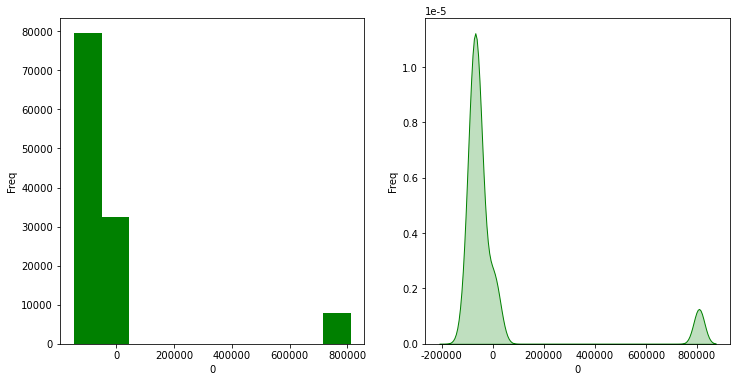

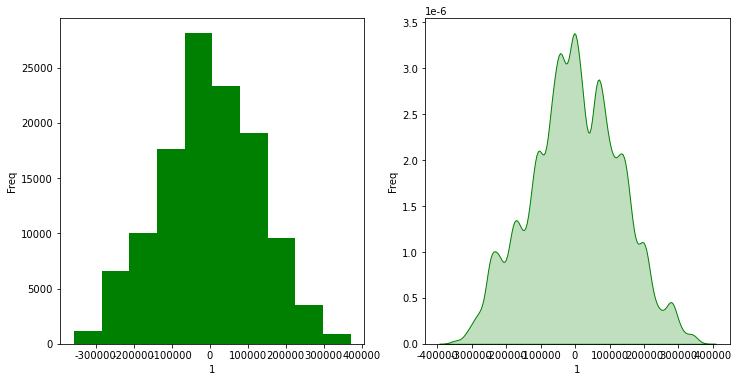

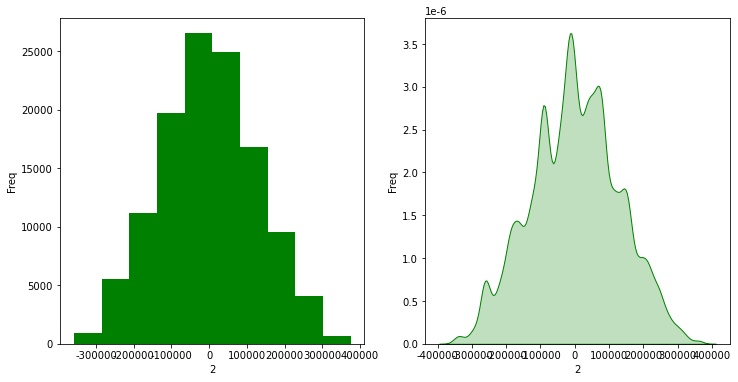

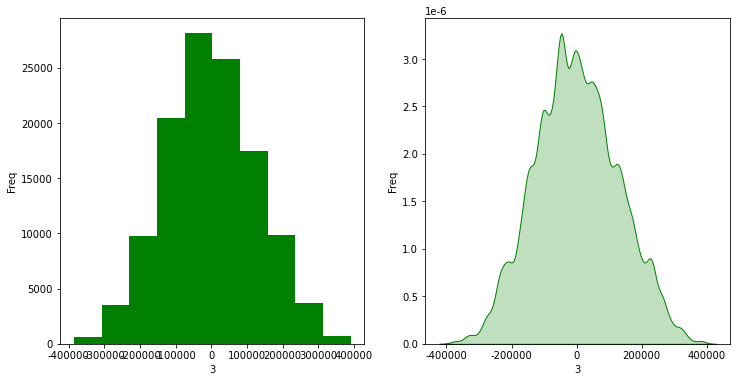

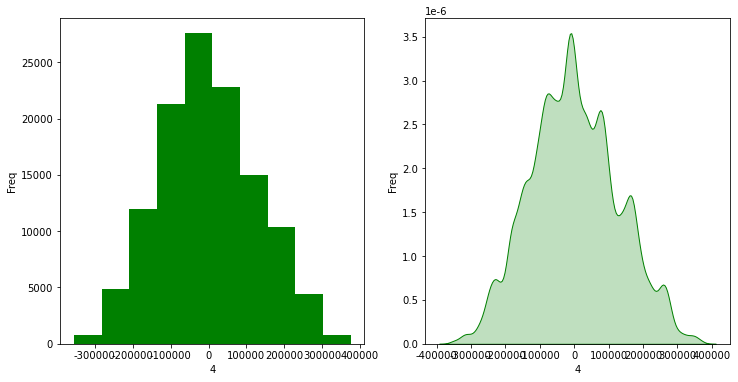

...

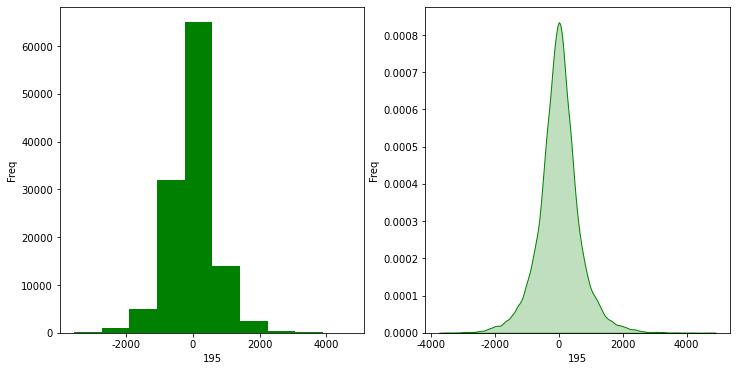

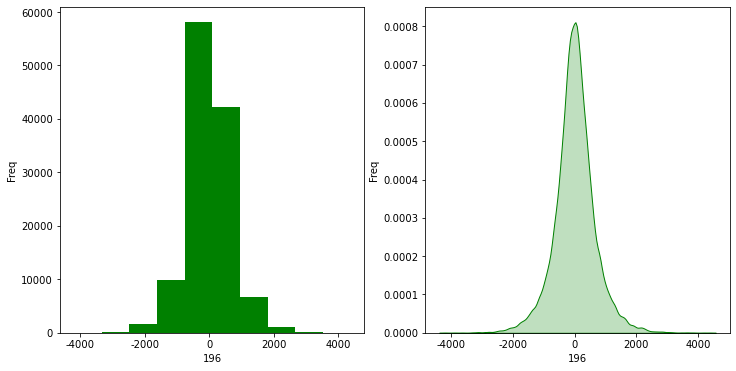

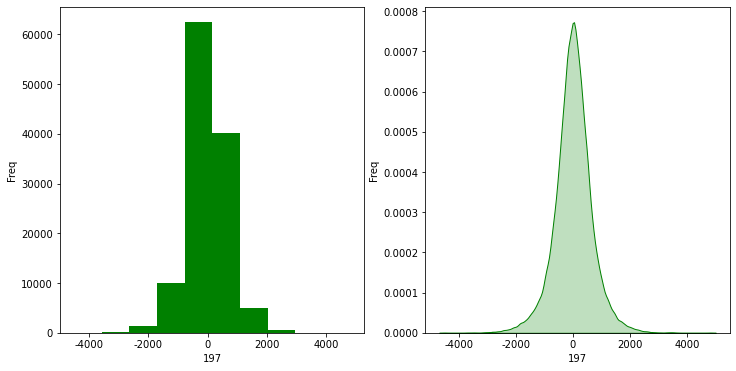

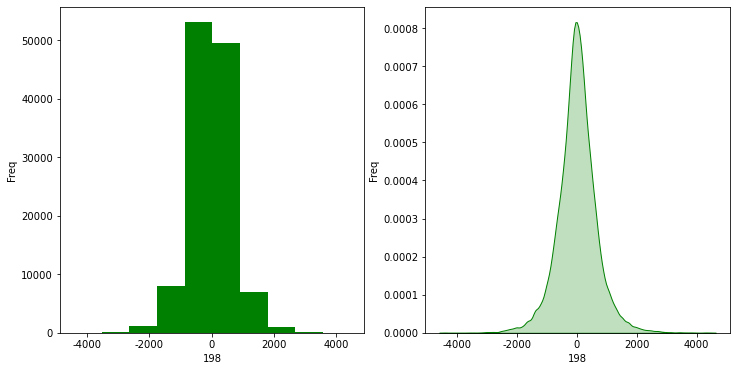

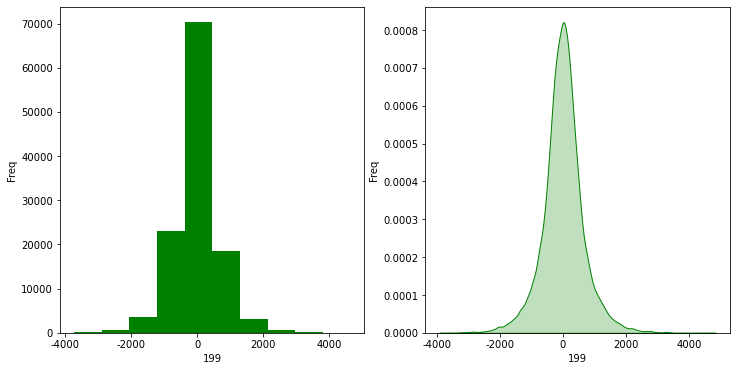

In [134]:
for column in combination_data_pca.columns:

    plt.figure(figsize=(12,6))
    plt.subplot(1,2,1)
    plt.hist(combination_data_pca[column], color='g')
#     plt.hist(pre_data[pre_data.error_label==1][column], color='y')
#     plt.hist(pre_data[pre_data.error_label==2][column], color='r')
    plt.xlabel(column)
    plt.ylabel('Freq')
#     plt.legend(['all','Ass_outlier', 'Pin_outlier'])
    
    plt.subplot(1,2,2)
    sns.kdeplot(combination_data_pca[column], shade=True, color='g')
#     sns.kdeplot(pre_data[pre_data.error_label==1][column], shade=True, color='y')
#     sns.kdeplot(pre_data[pre_data.error_label==2][column], shade=True, color='r')
    plt.xlabel(column)
    plt.ylabel('Freq')
#     plt.legend(['all','Ass_outlier', 'Pin_outlier'])
    plt.show()

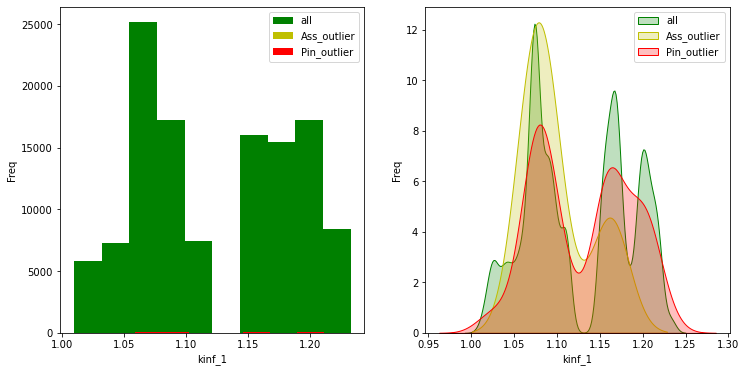

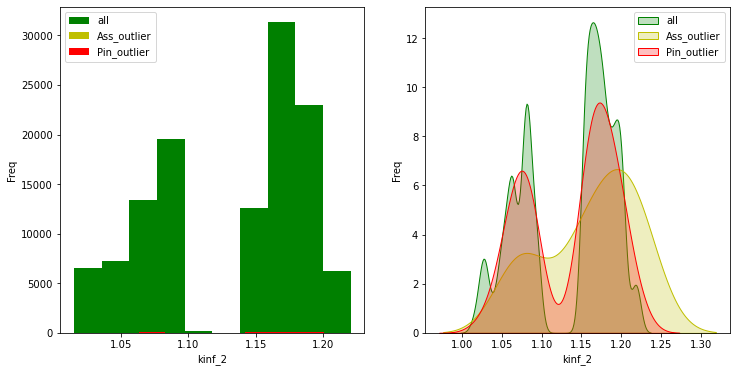

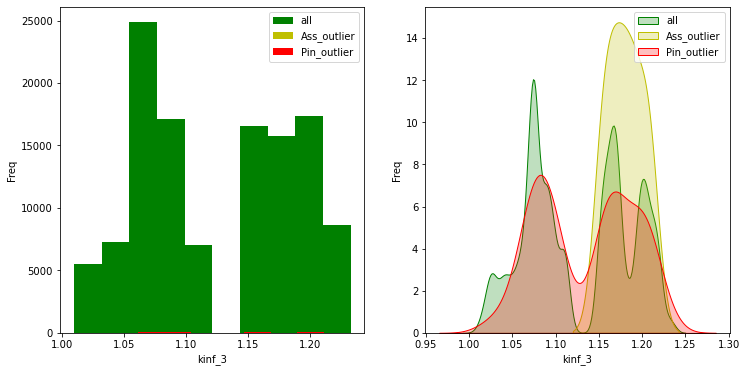

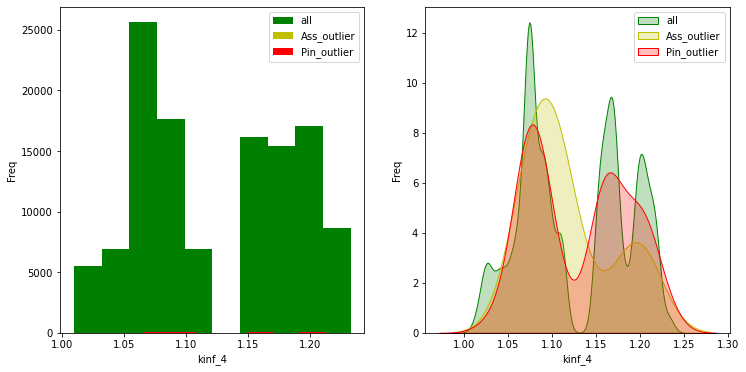

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


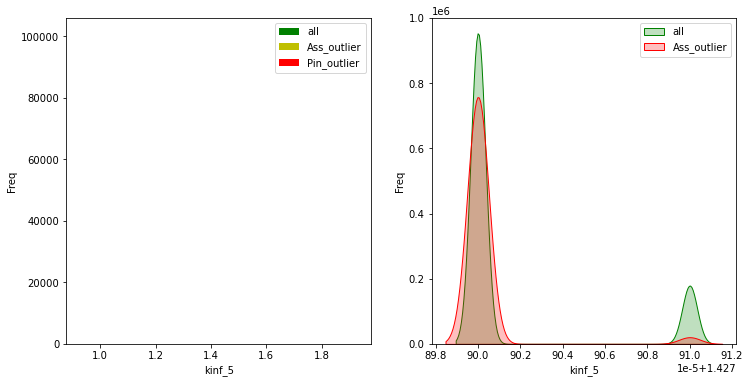

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


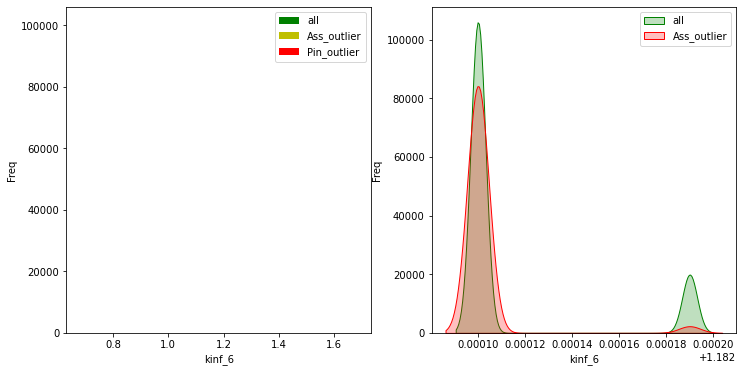

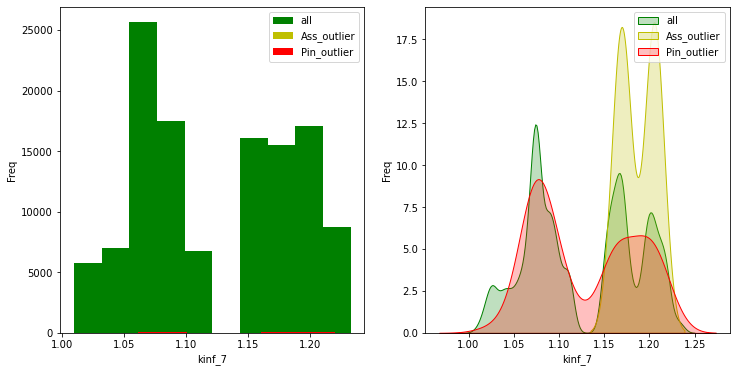

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


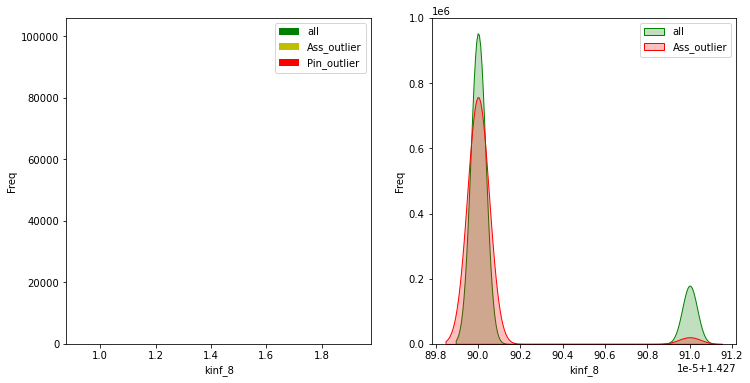

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


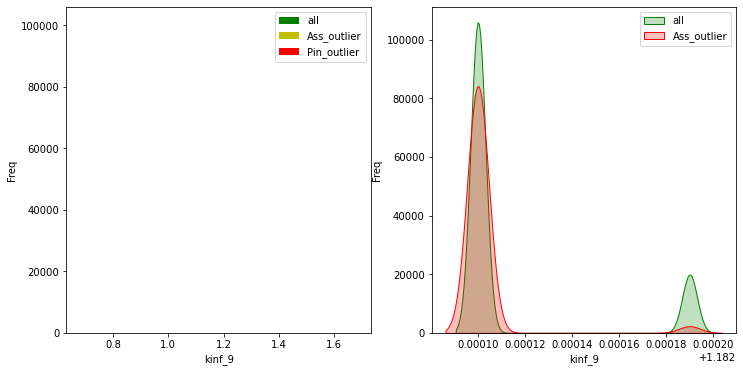

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


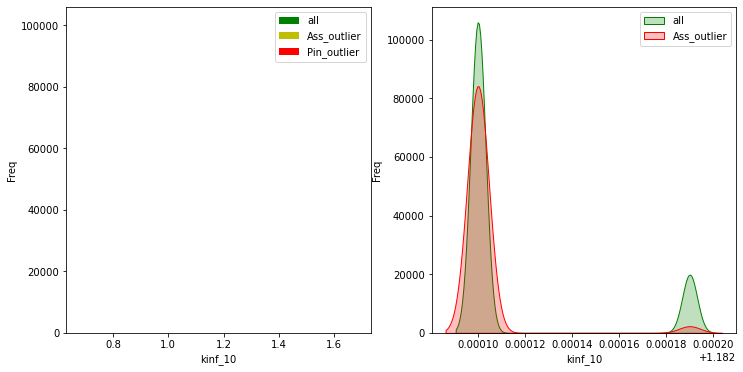

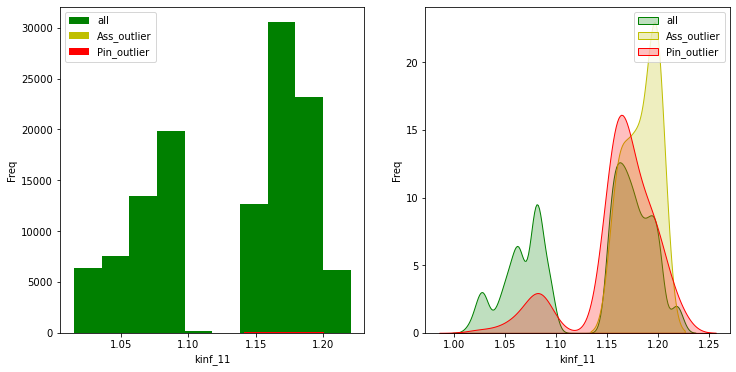

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


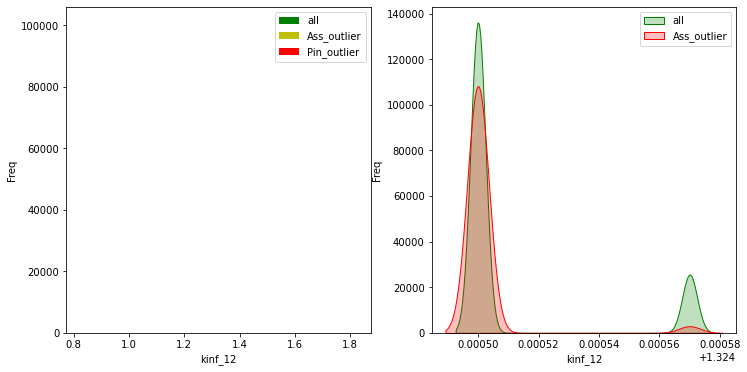

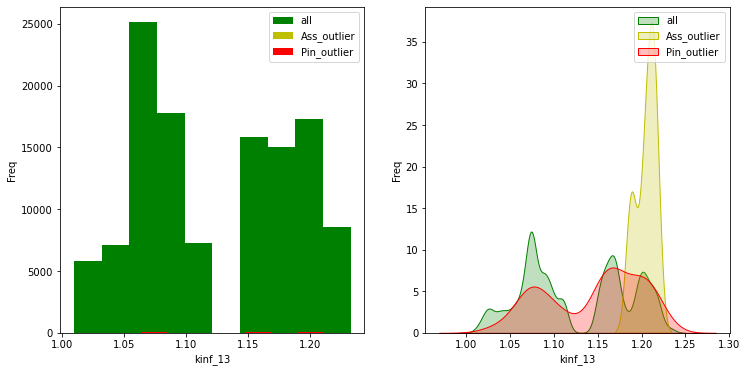

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


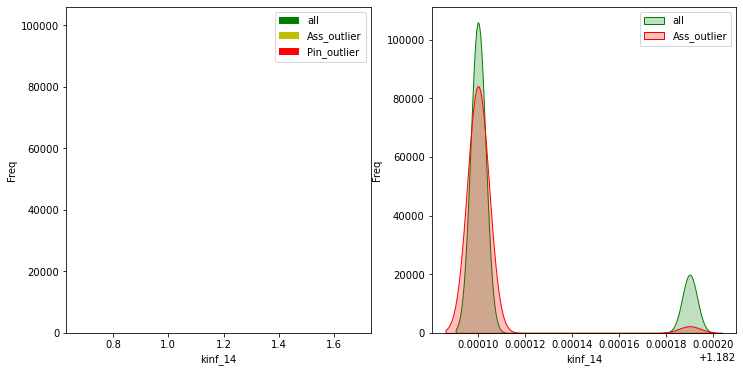

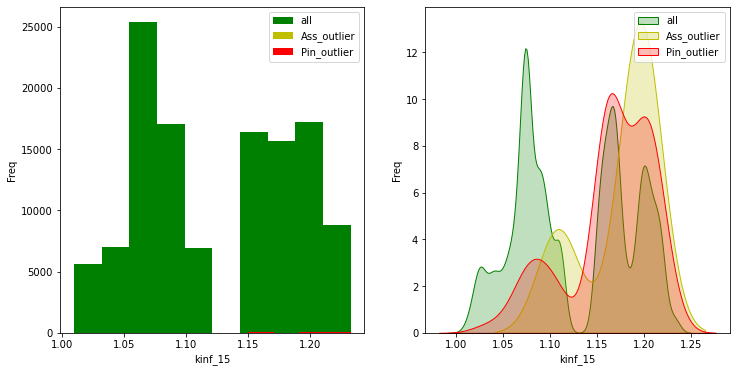

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


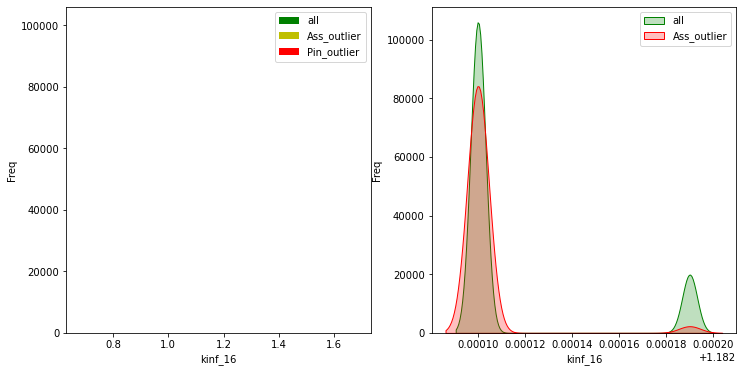

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


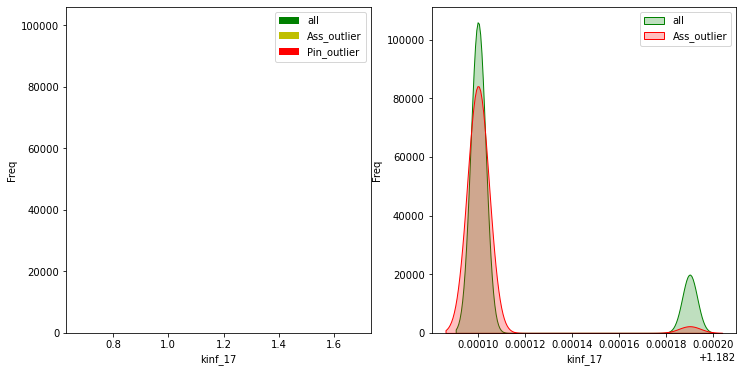

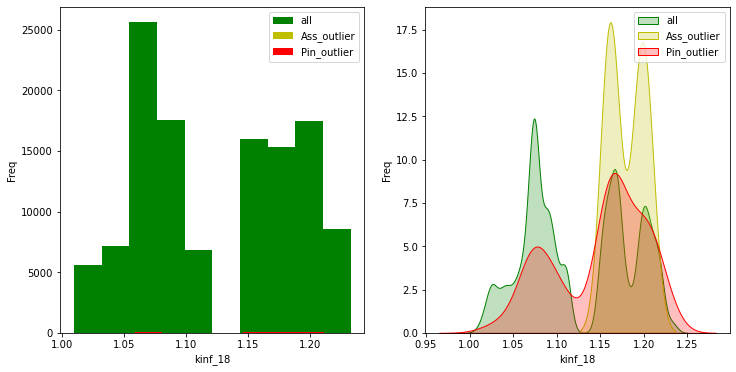

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


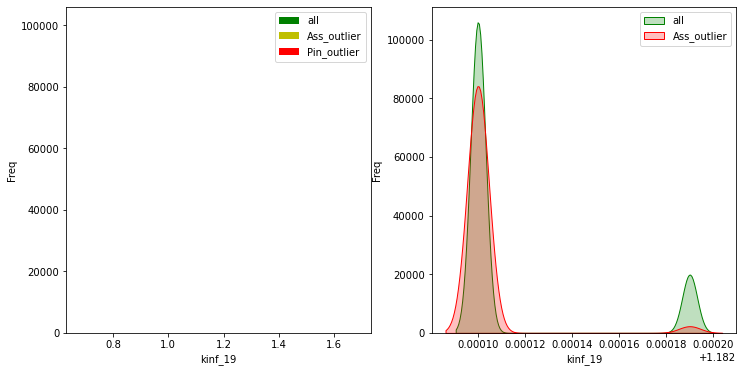

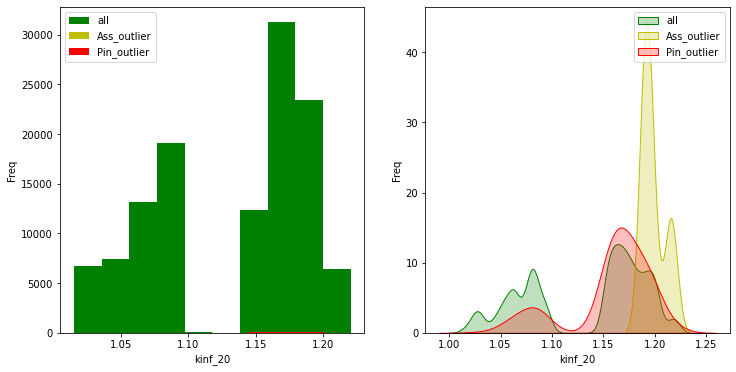

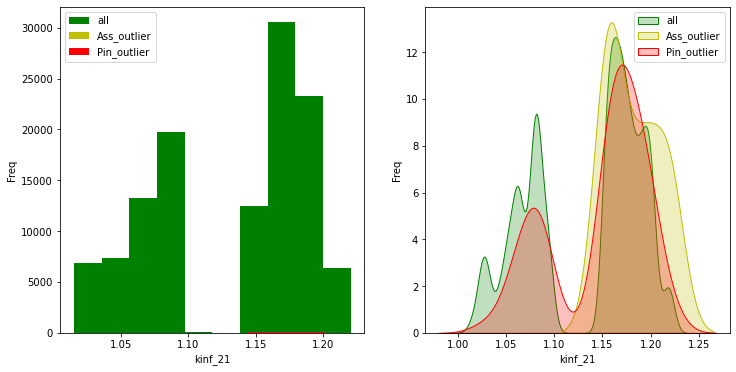

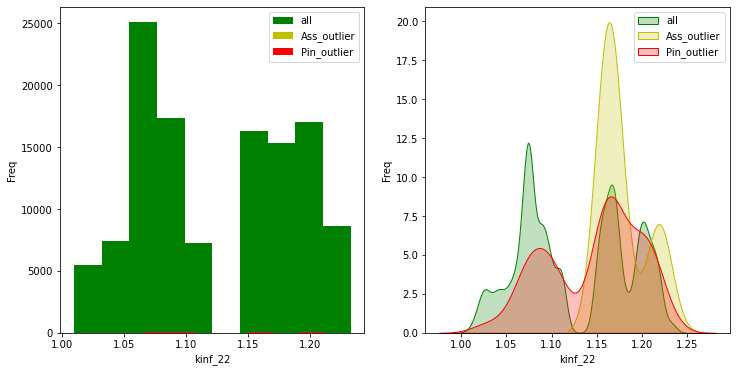

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


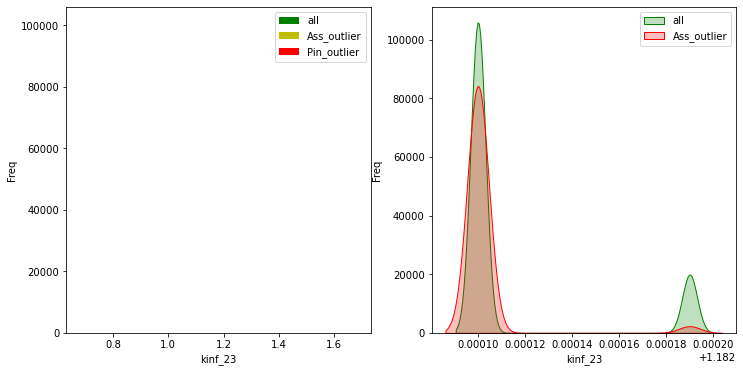

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


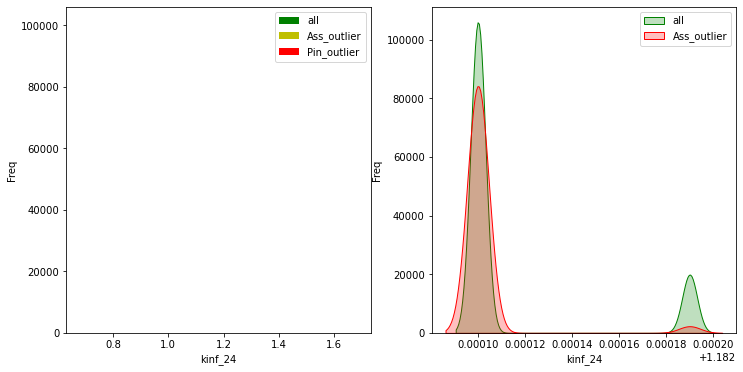

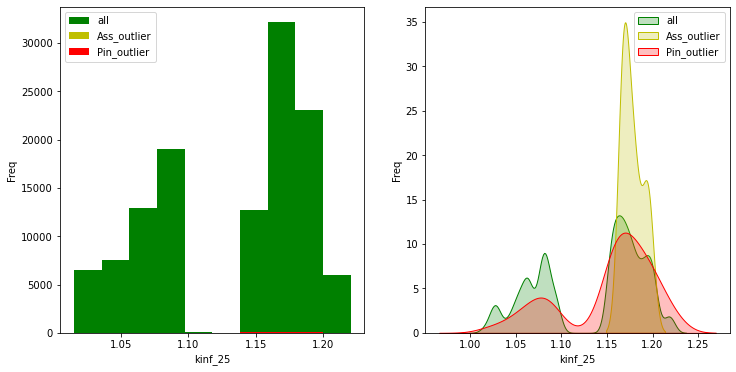

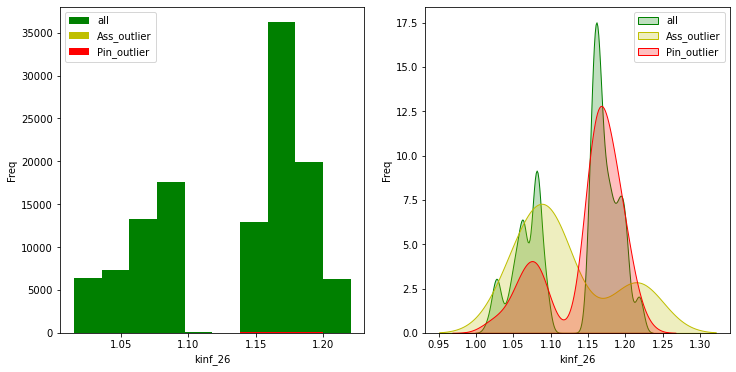

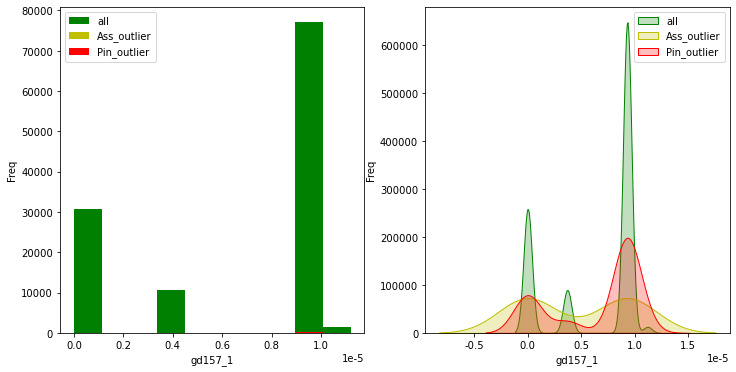

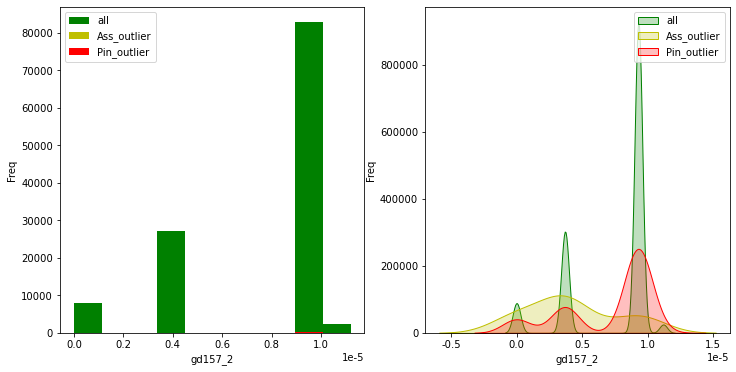

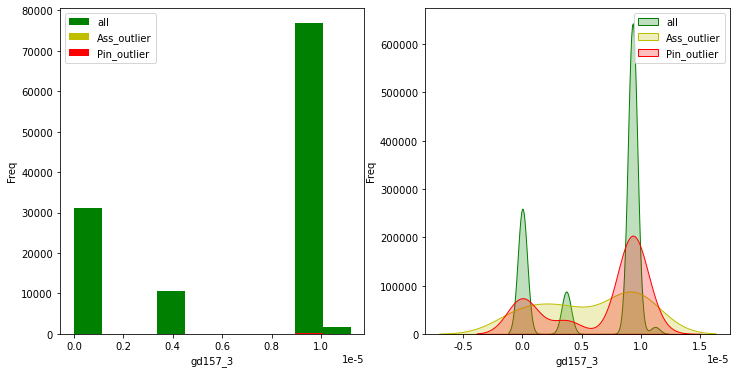

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


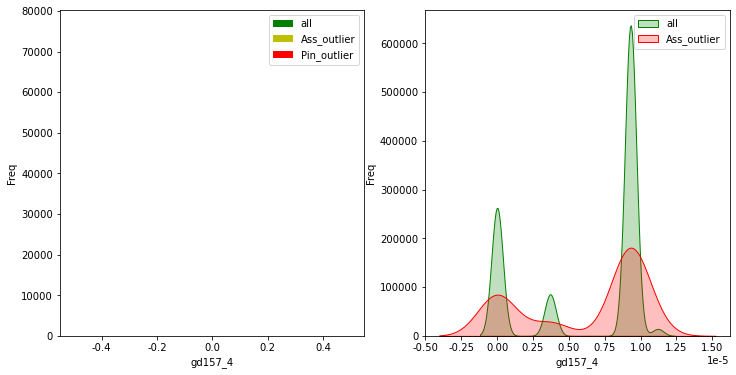

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


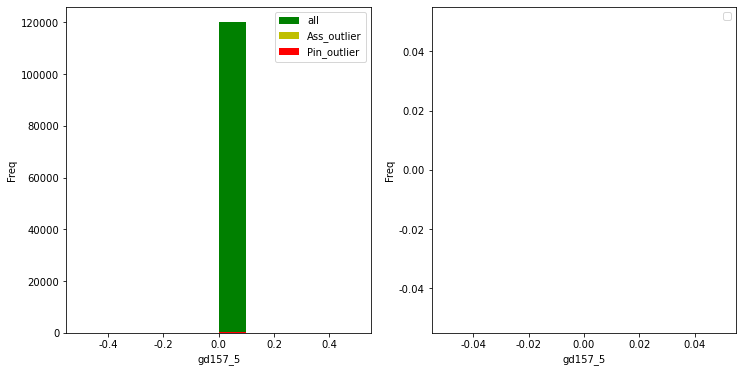

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


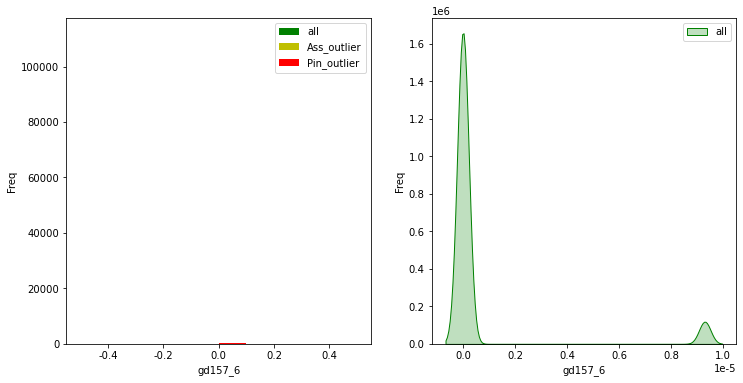

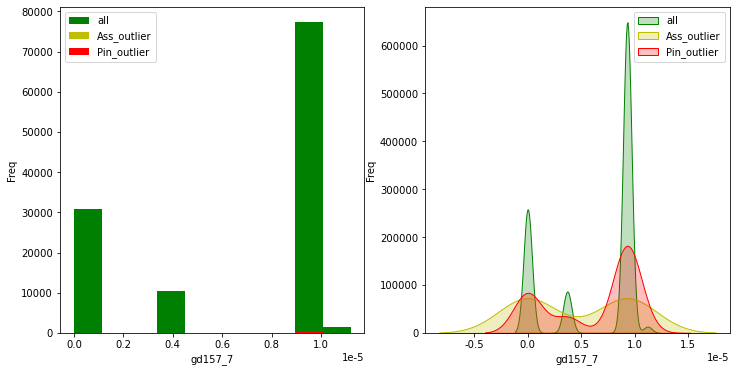

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


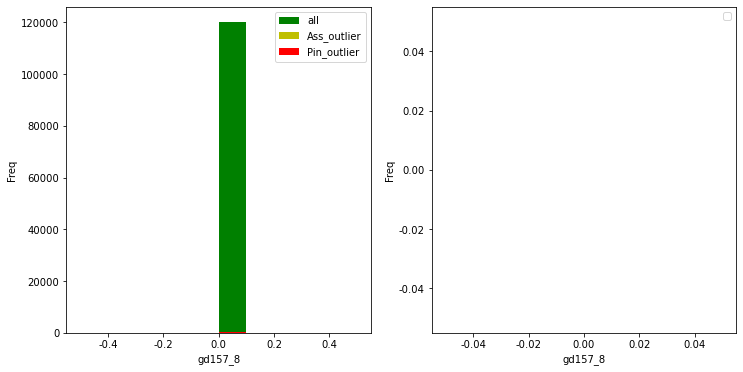

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


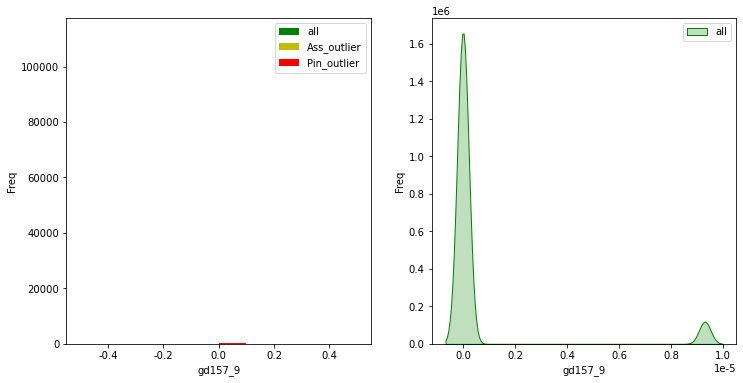

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


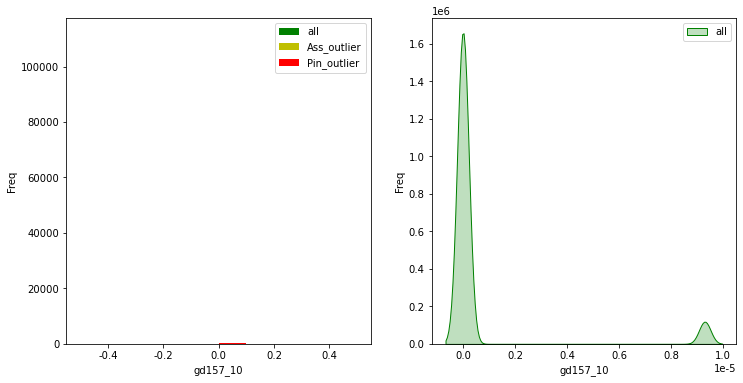

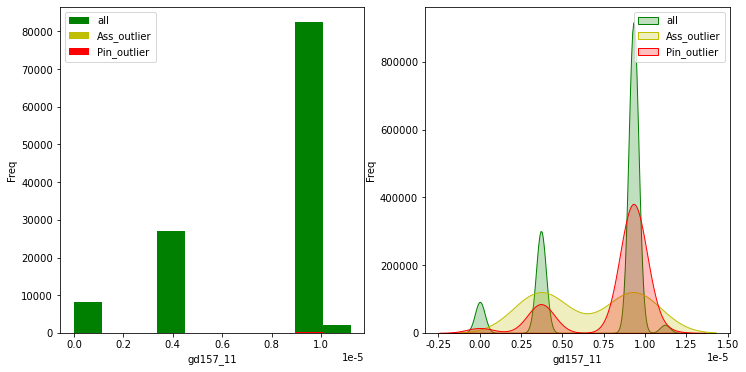

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


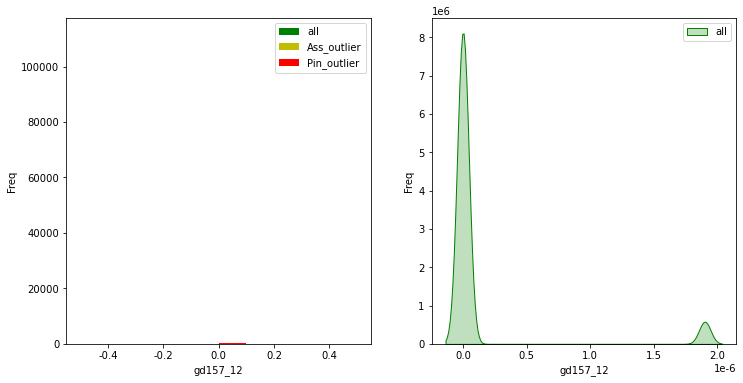

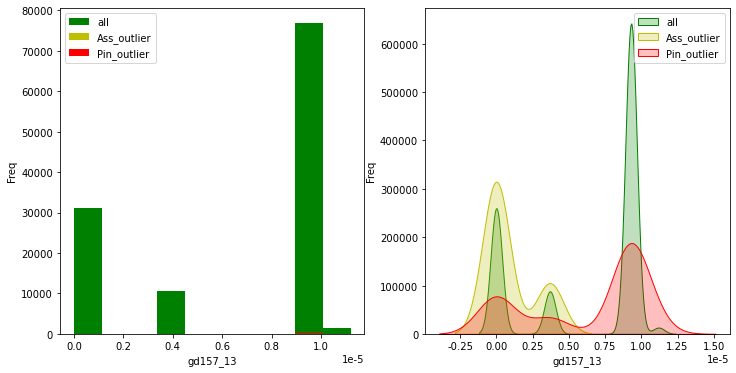

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


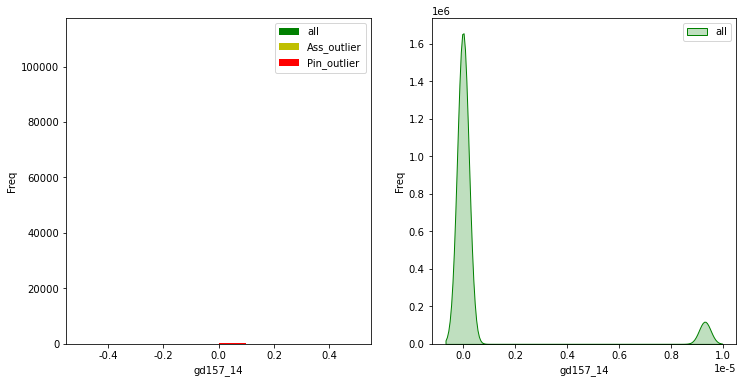

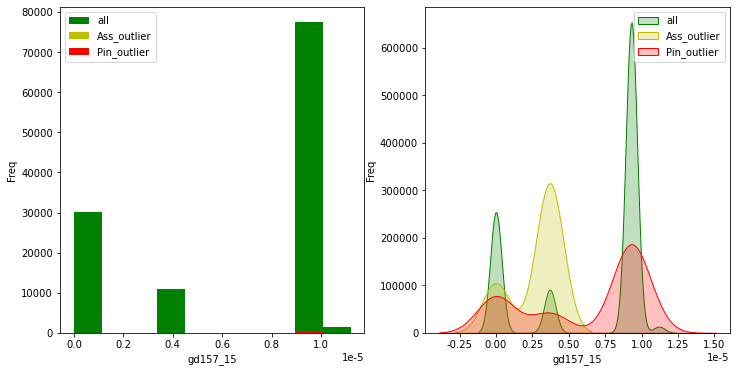

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


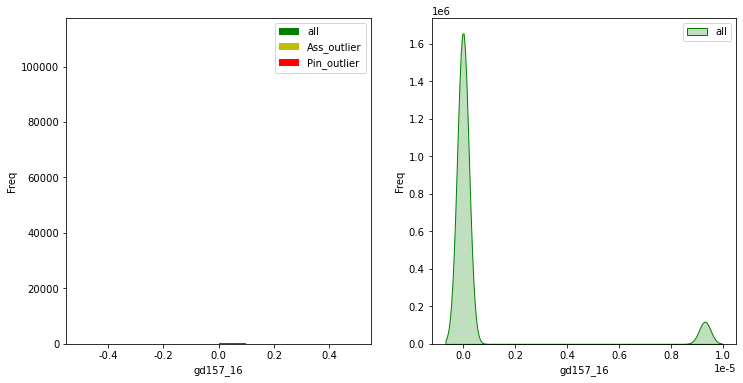

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


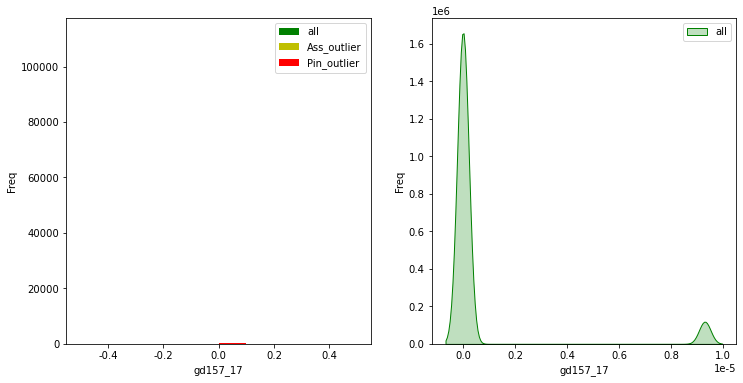

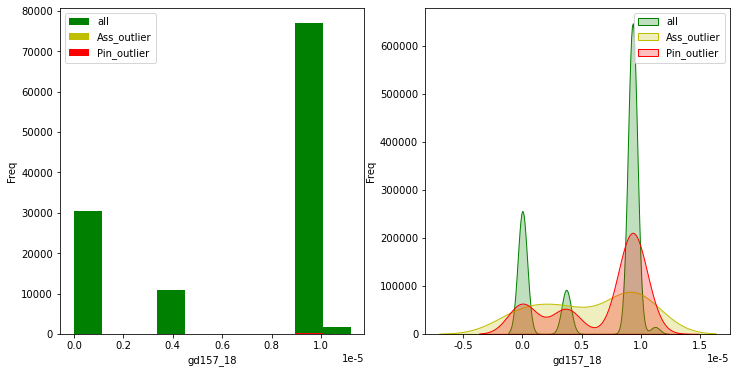

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


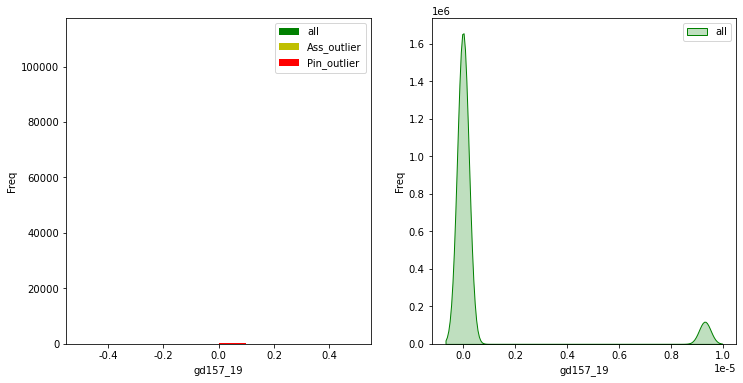

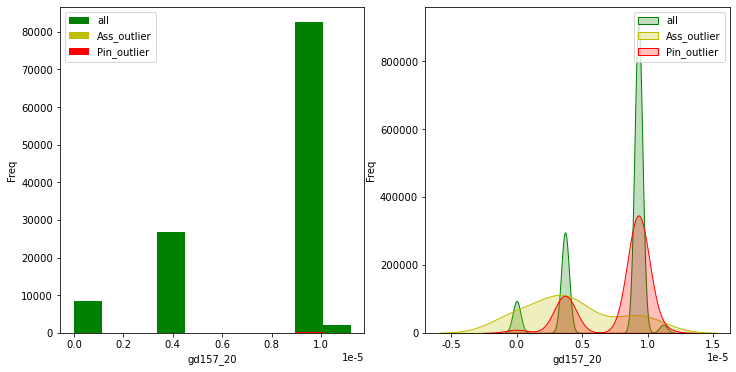

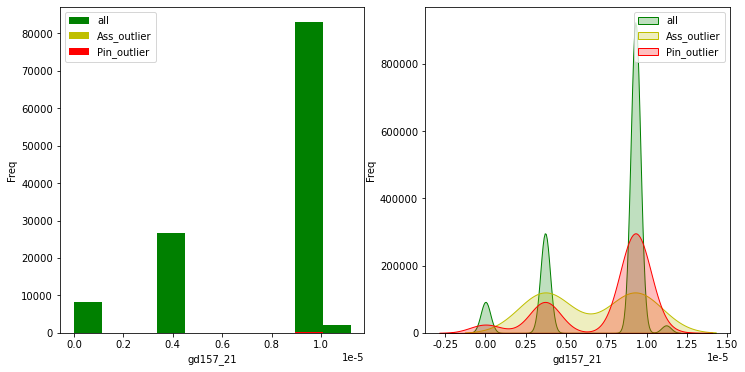

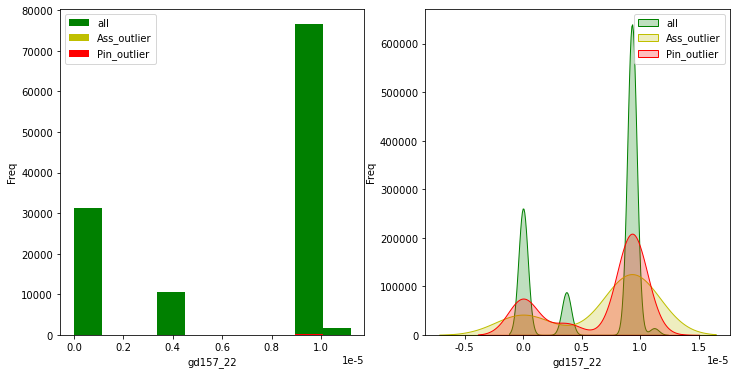

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


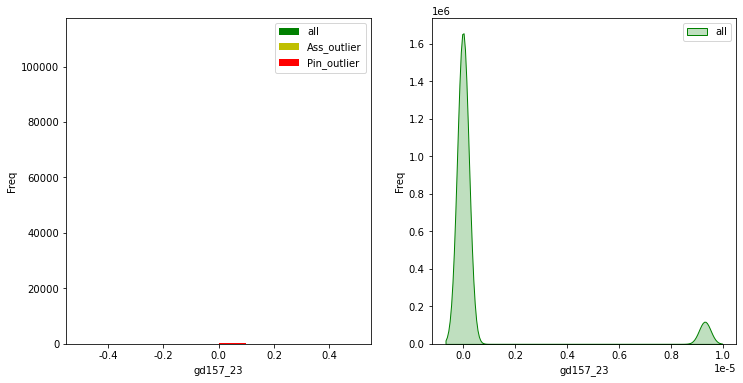

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


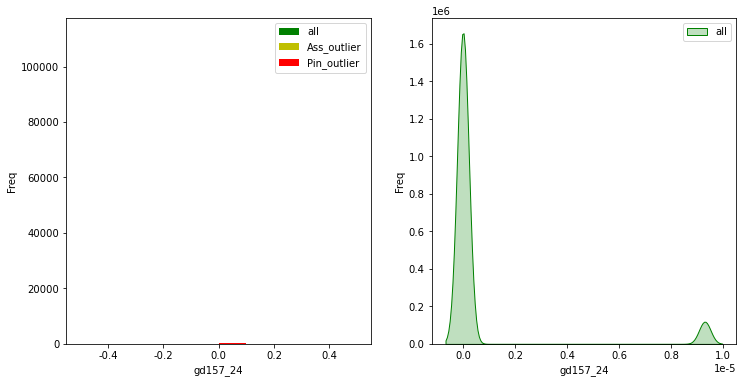

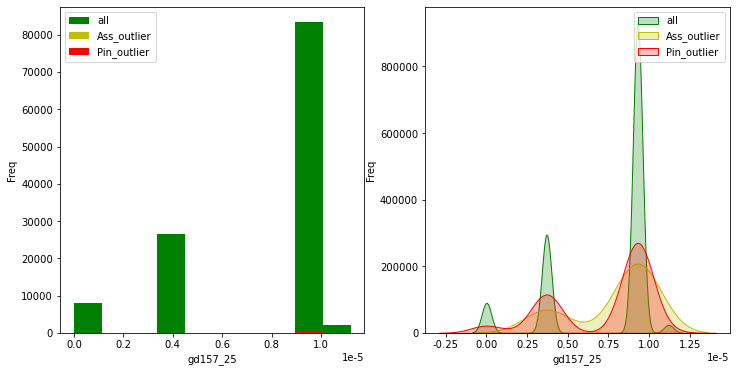

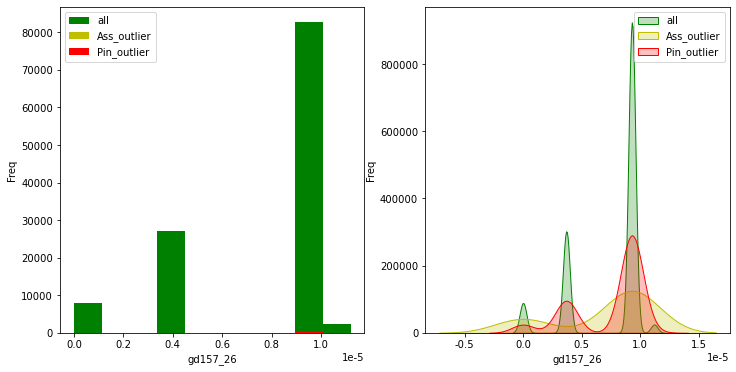

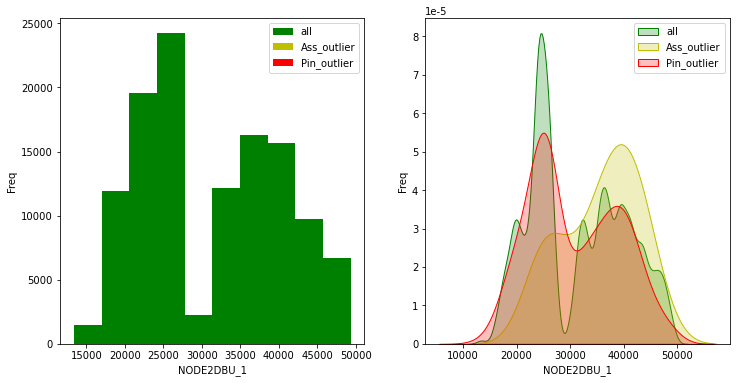

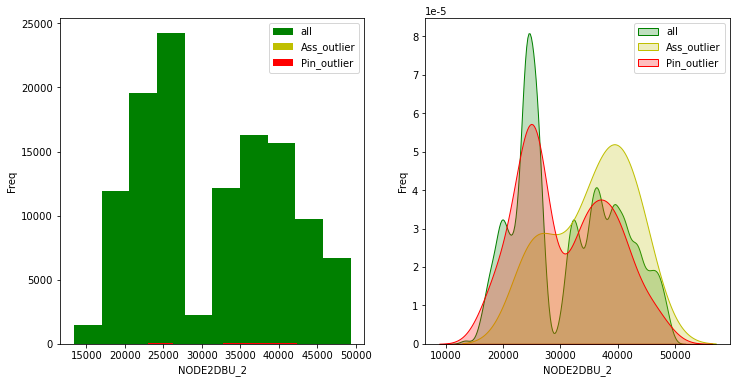

...

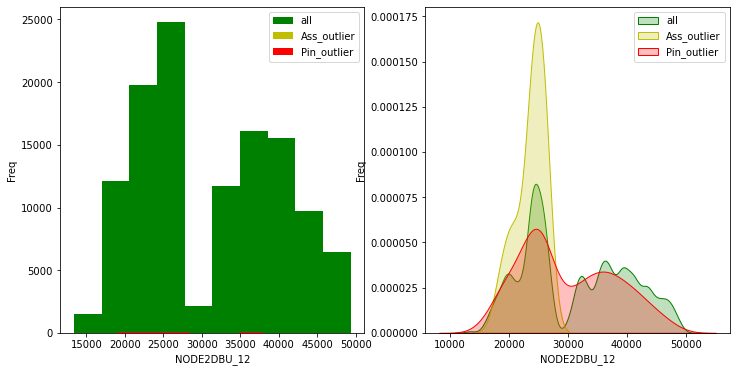

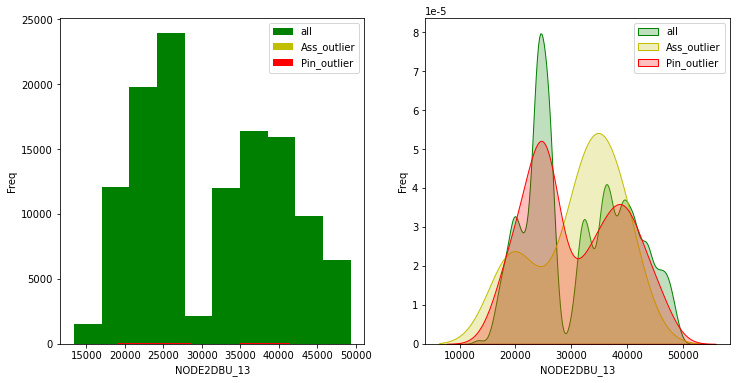

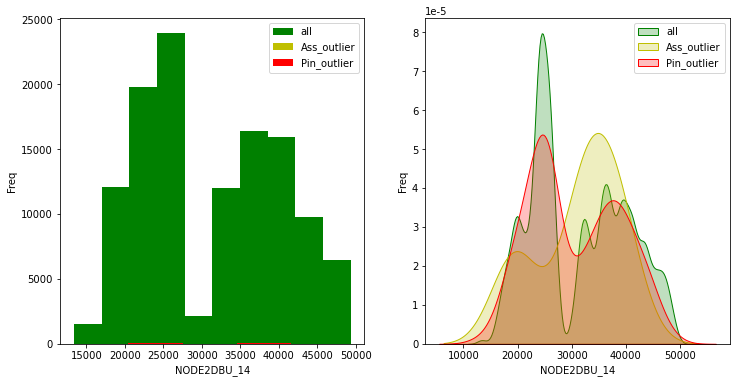

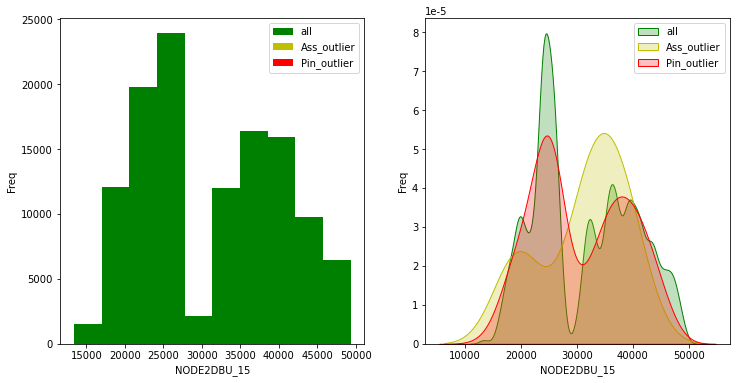

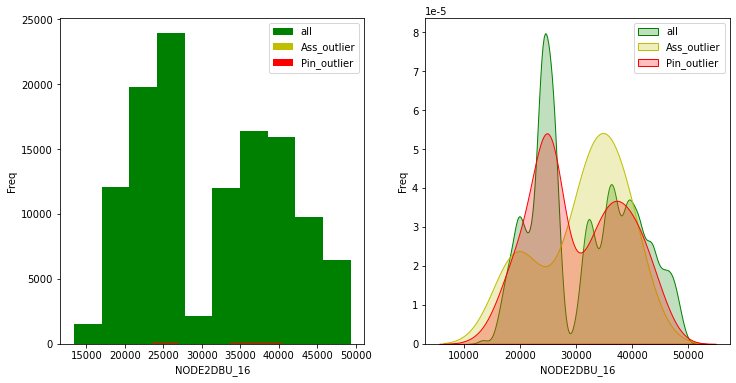

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


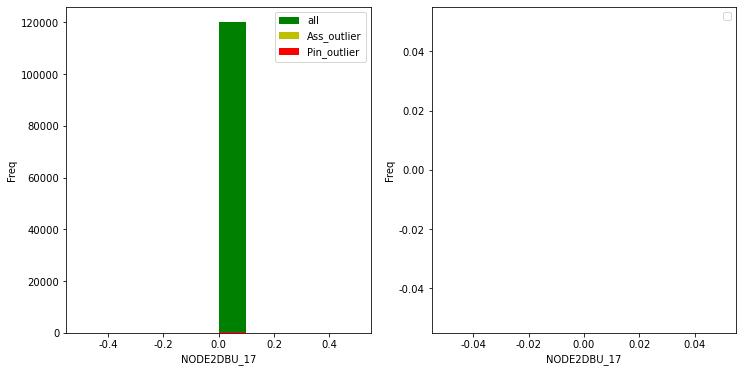

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


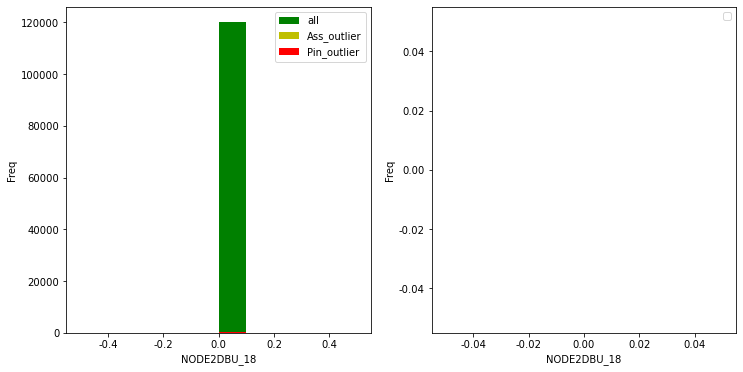

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


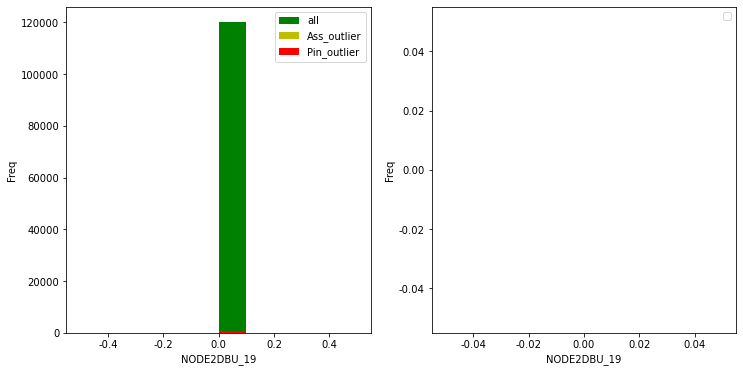

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


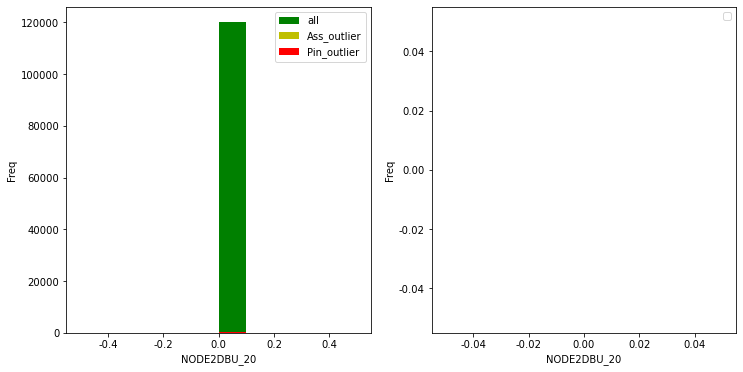

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


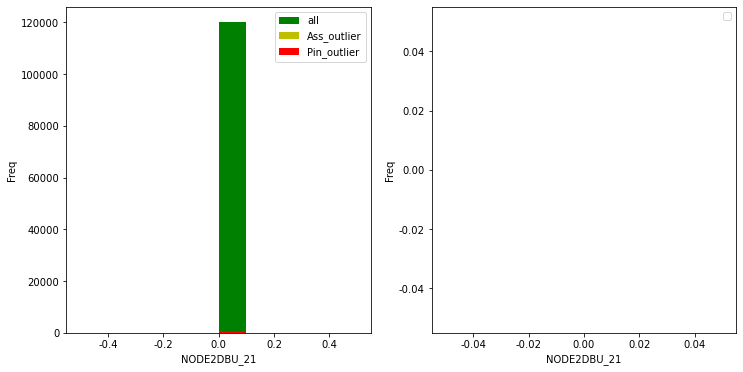

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


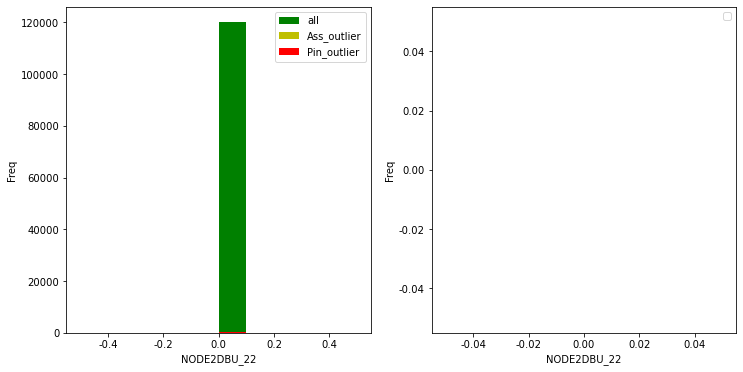

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


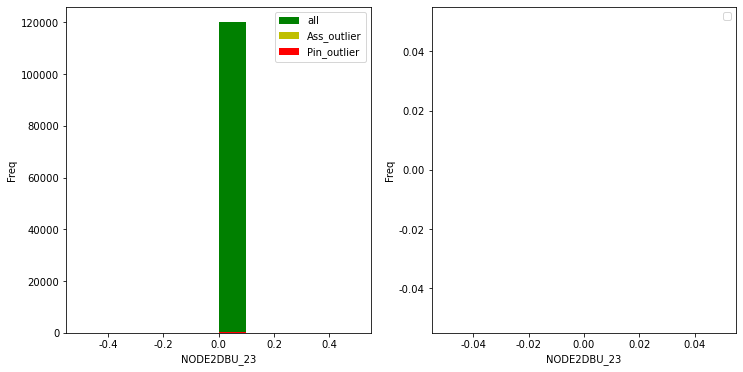

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


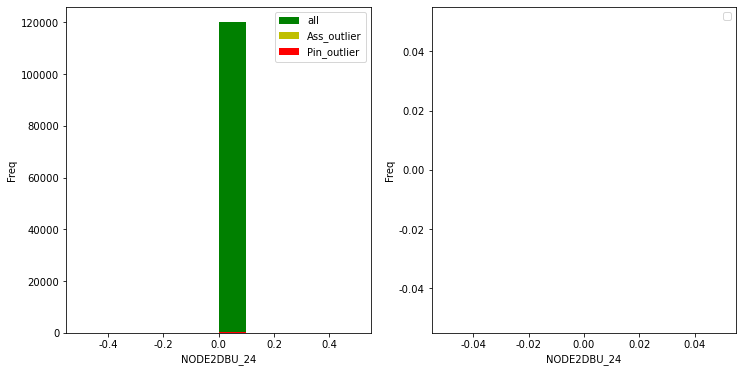

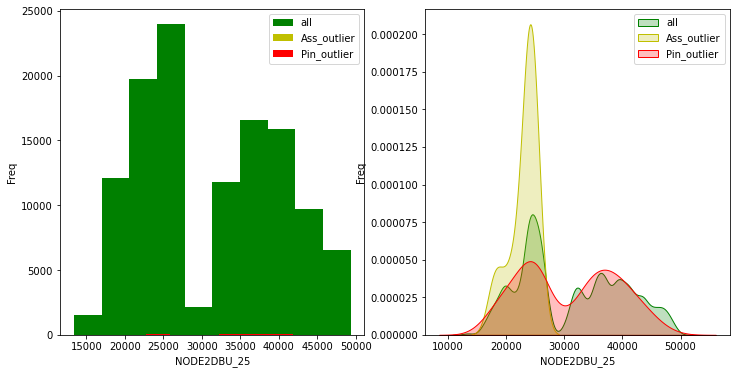

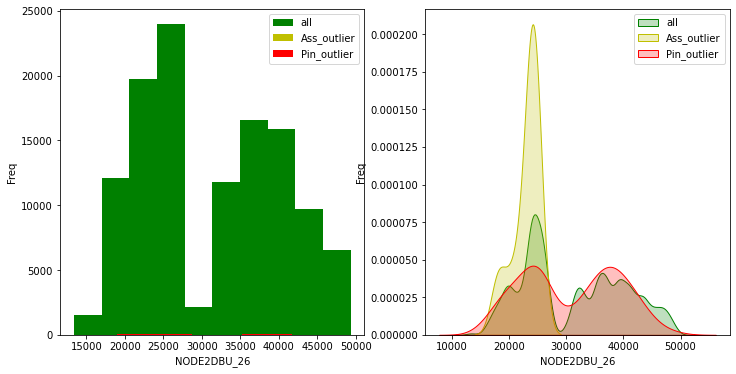

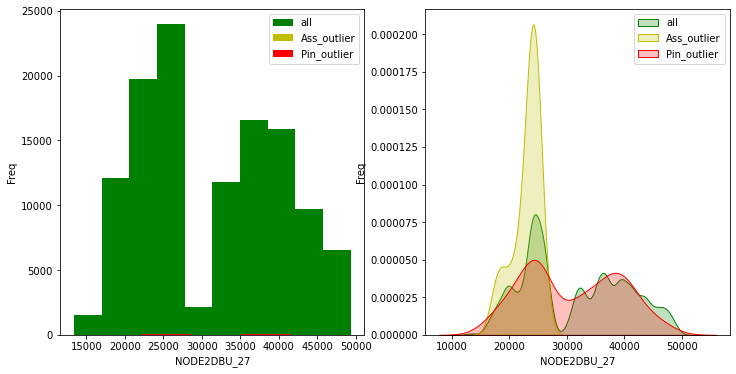

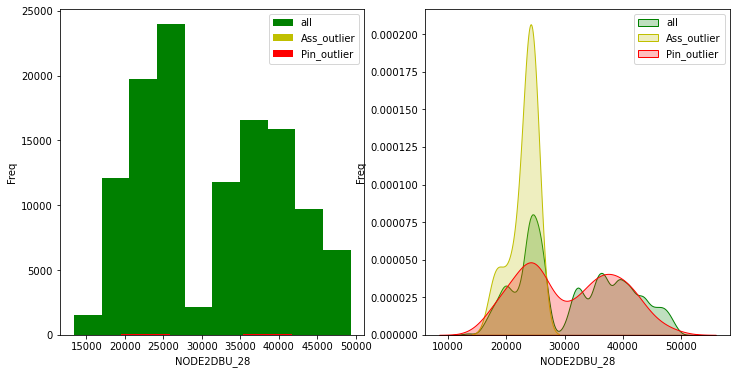

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


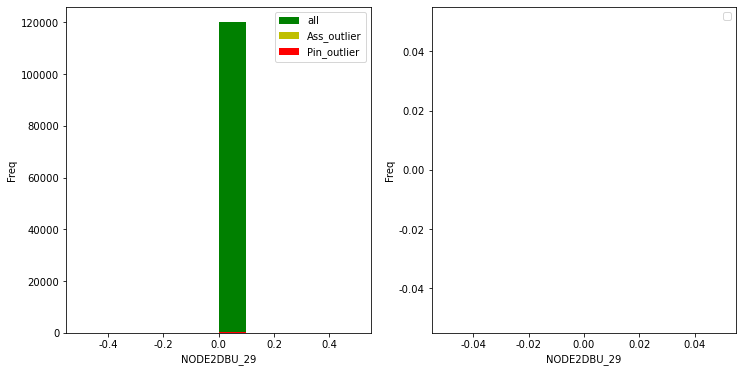

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


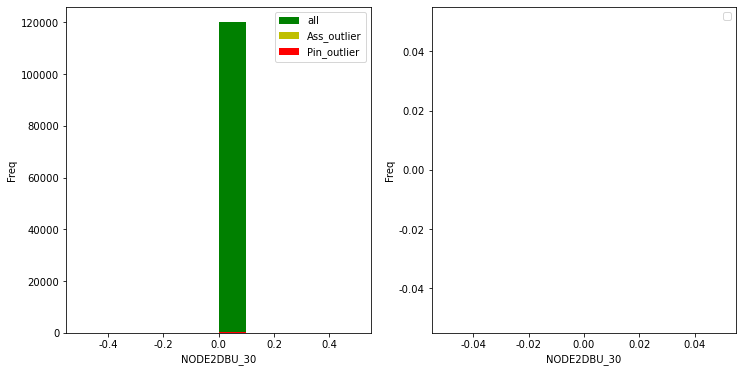

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


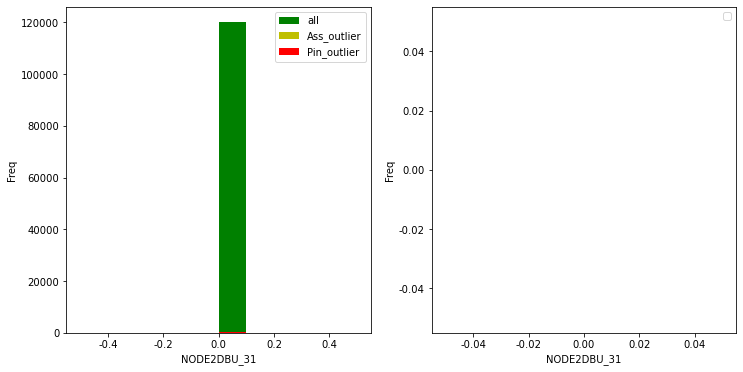

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


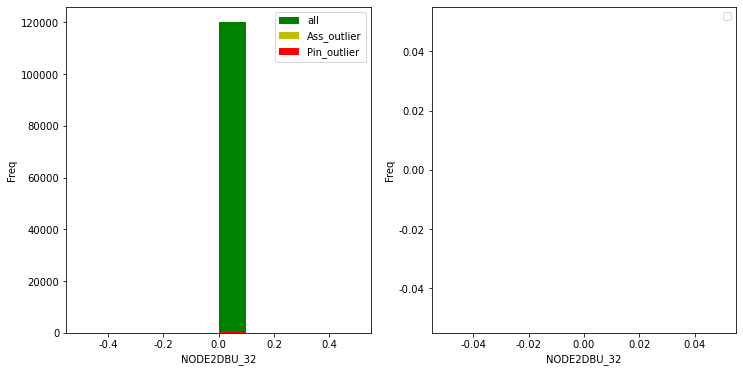

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


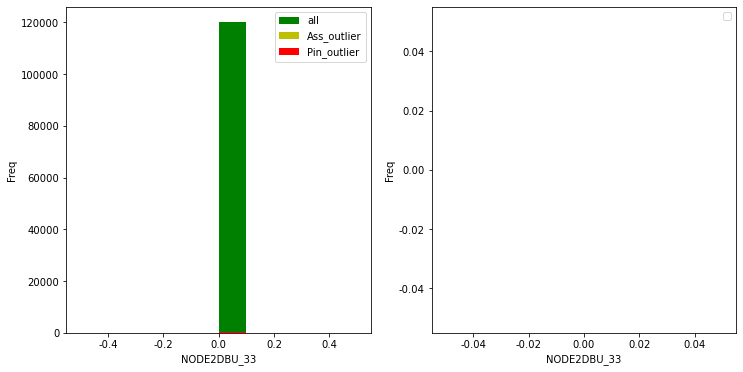

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


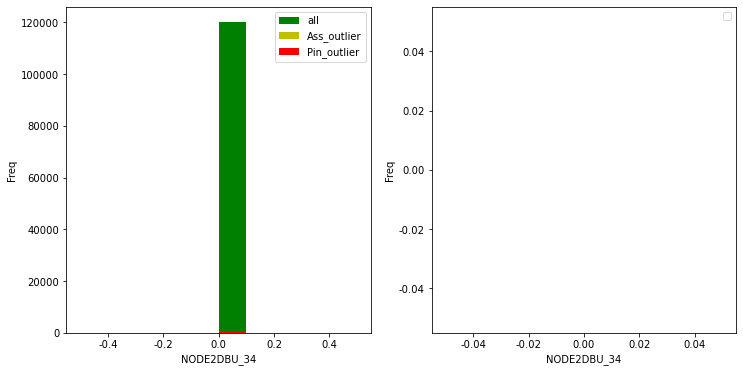

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


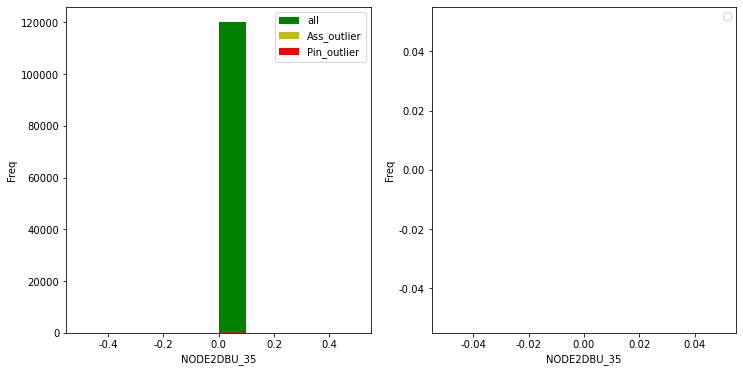

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


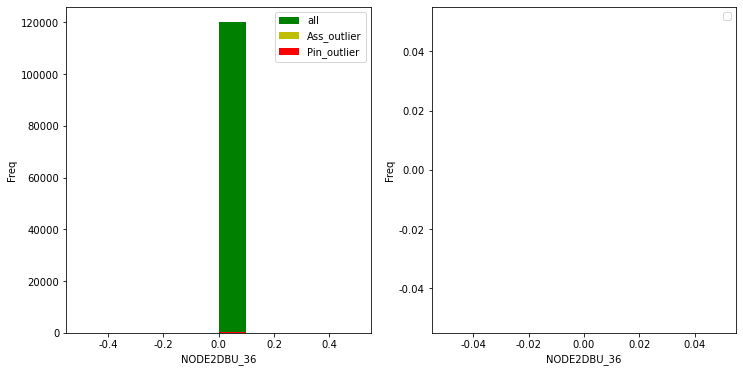

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


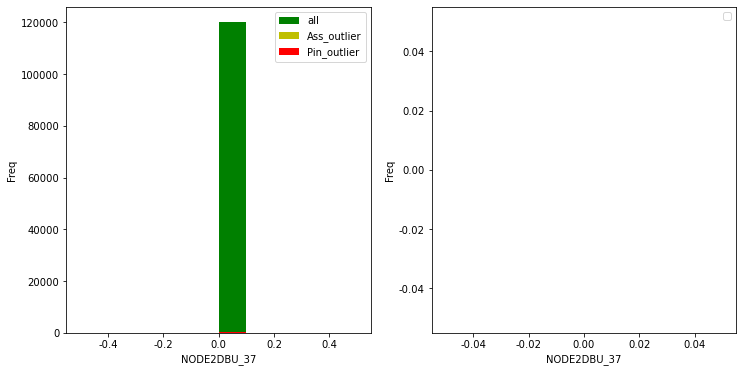

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


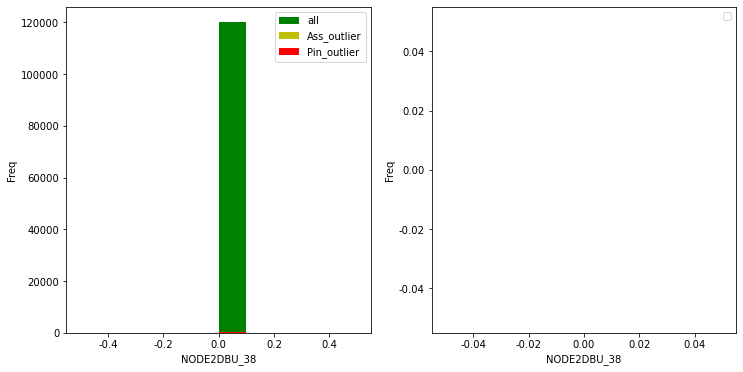

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


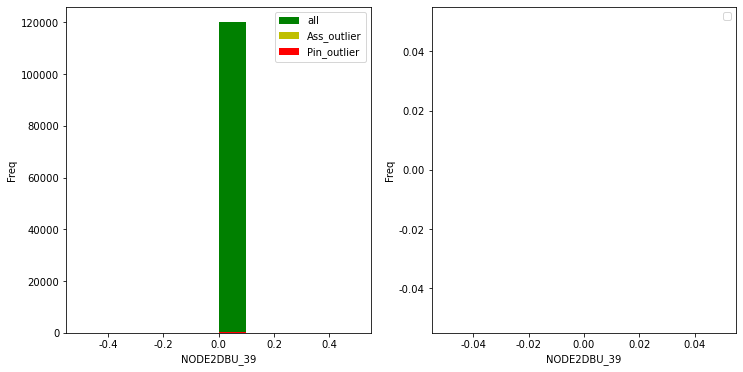

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


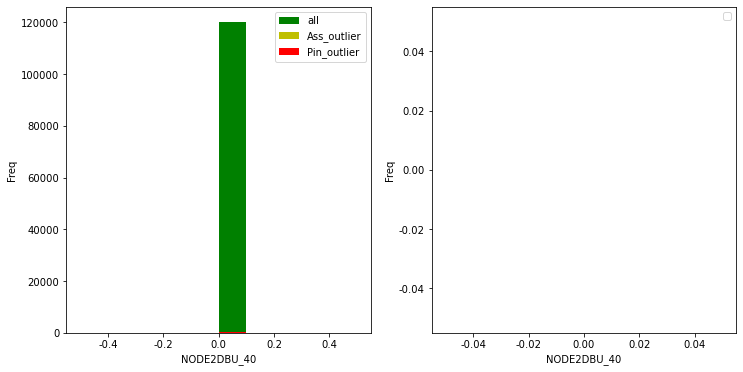

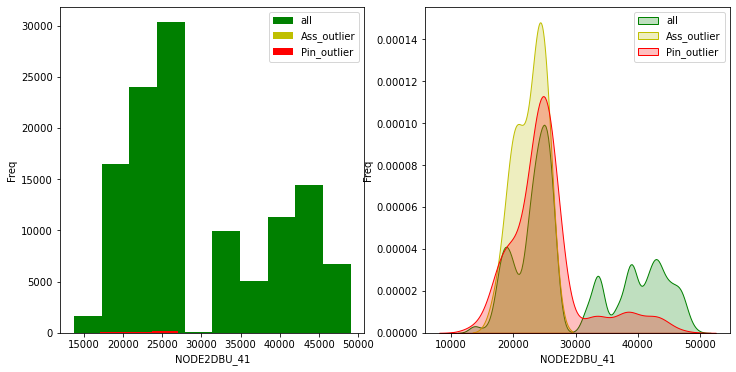

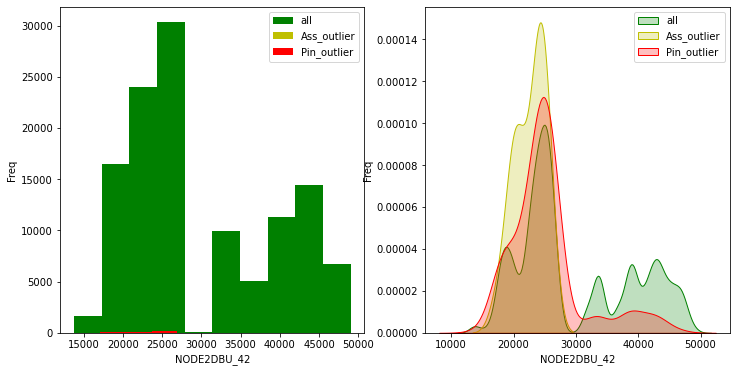

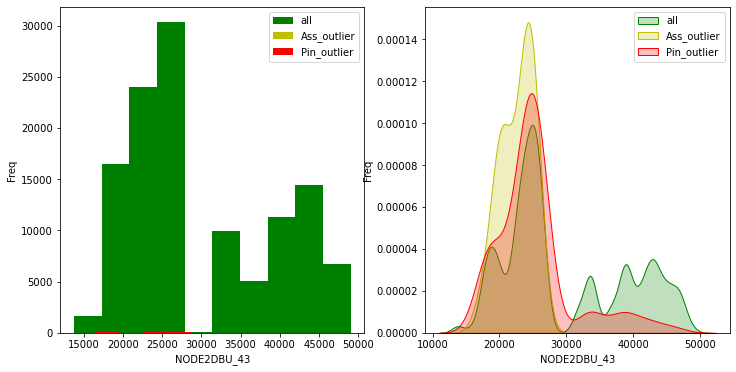

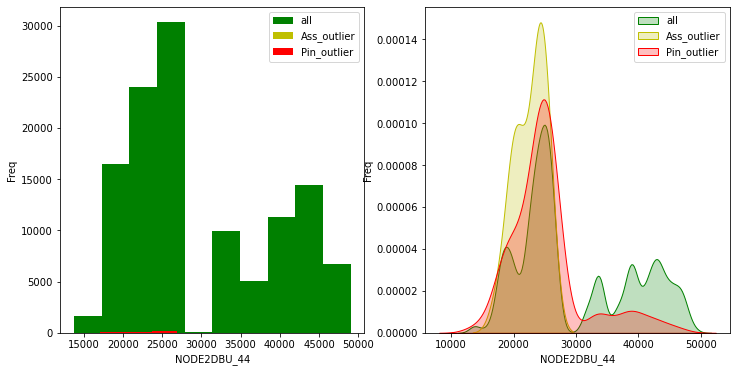

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


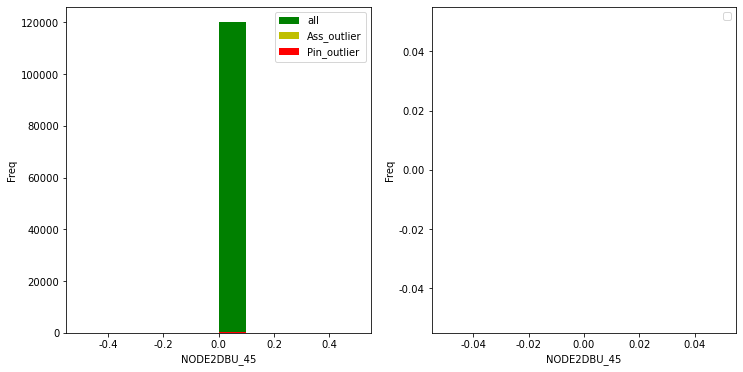

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


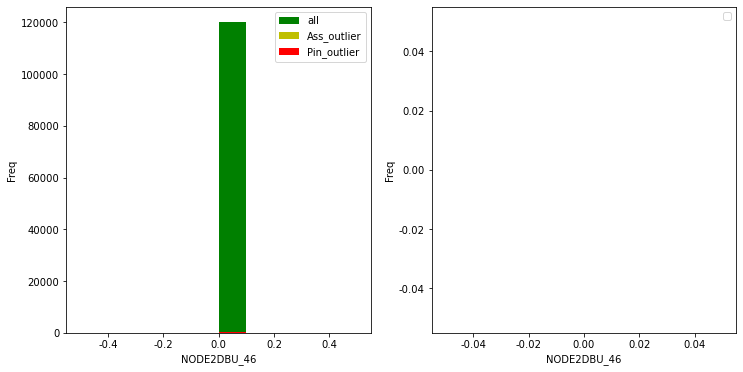

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


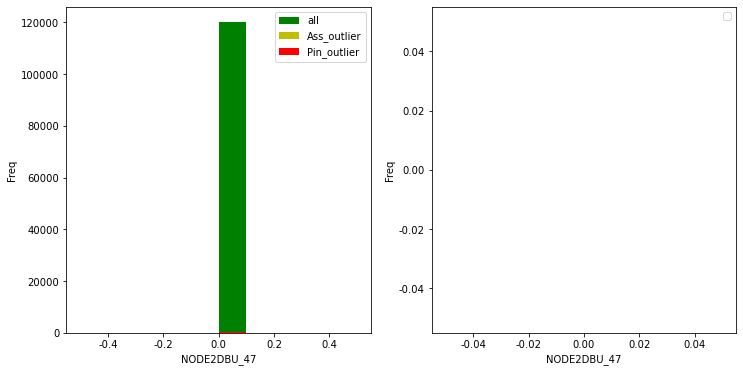

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


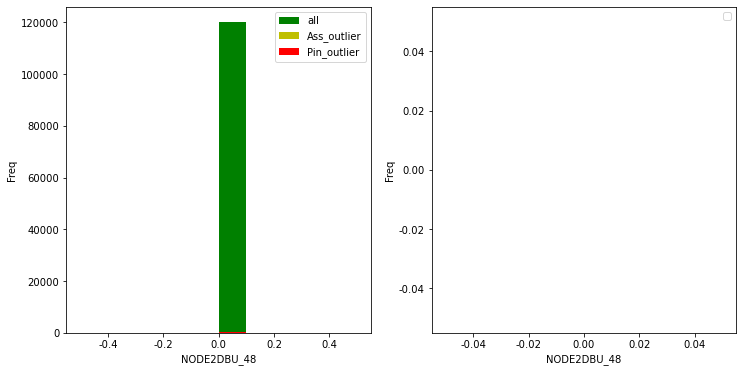

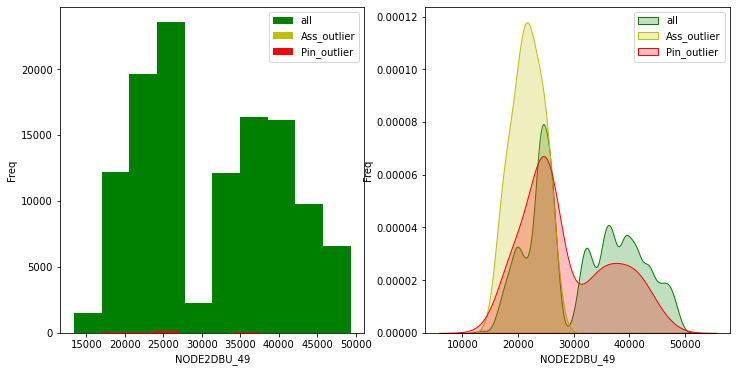

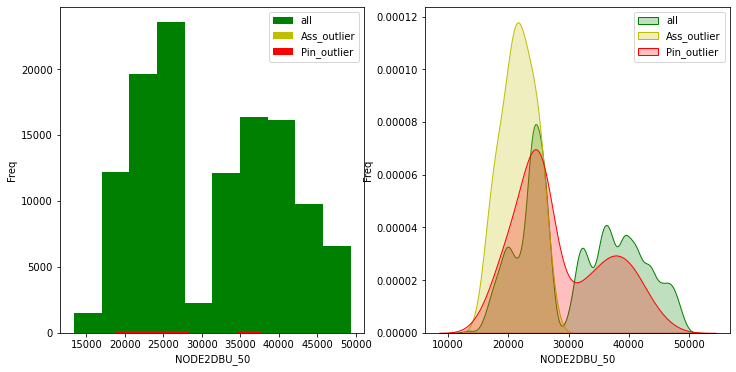

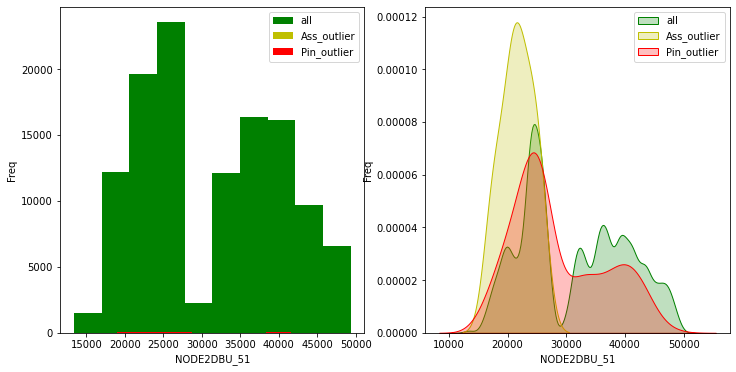

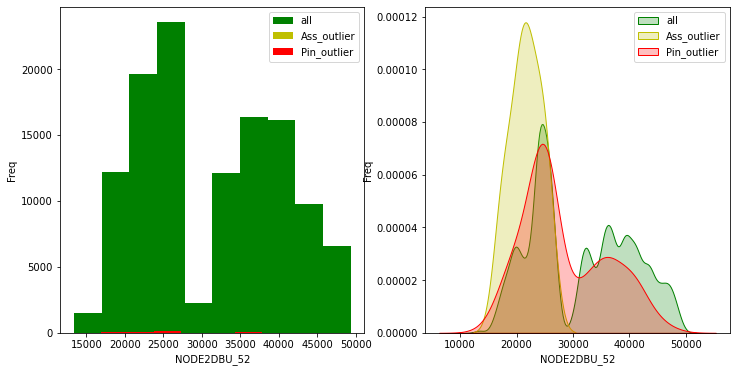

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


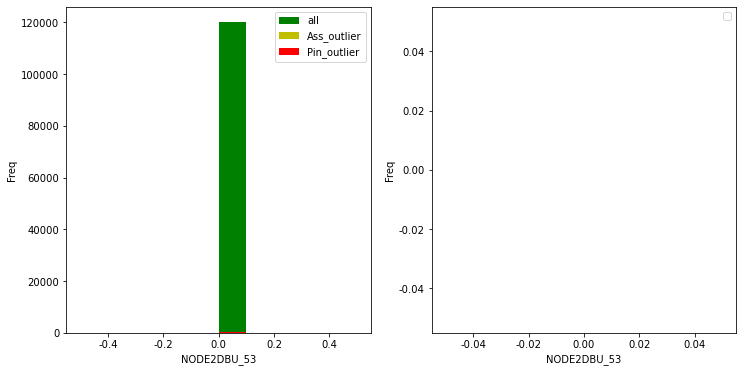

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


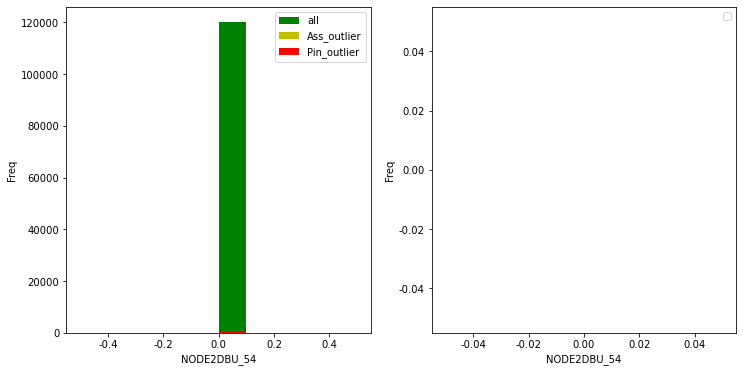

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


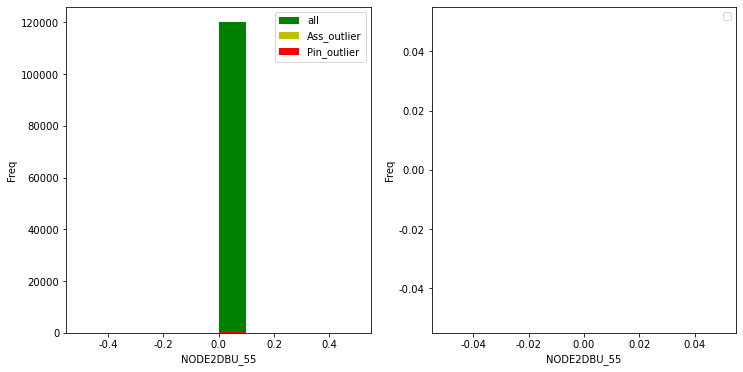

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


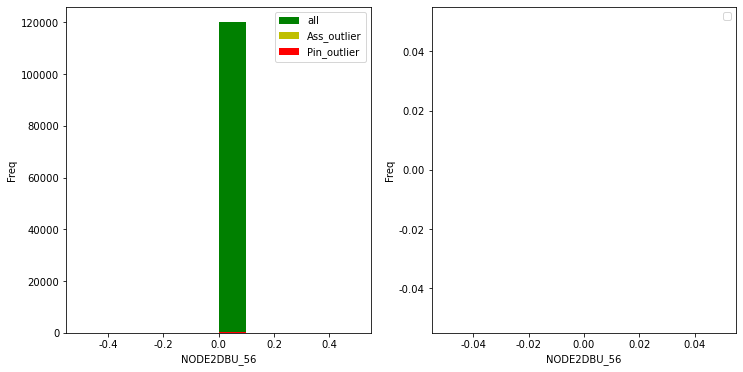

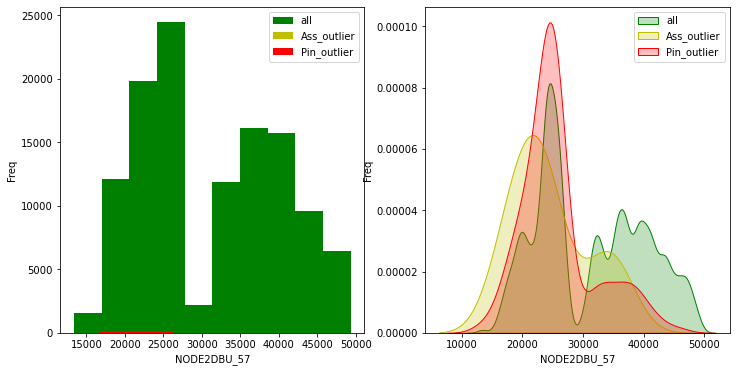

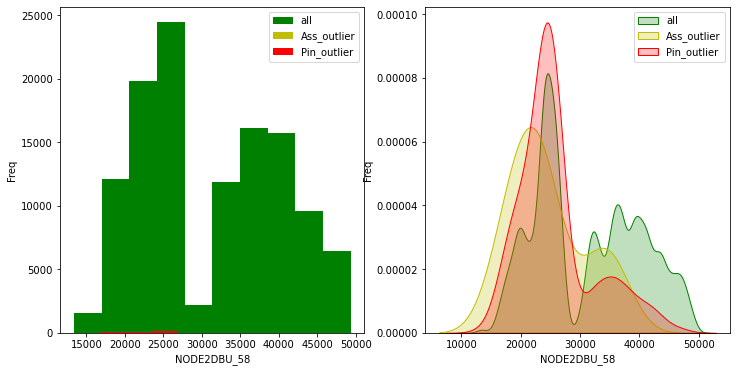

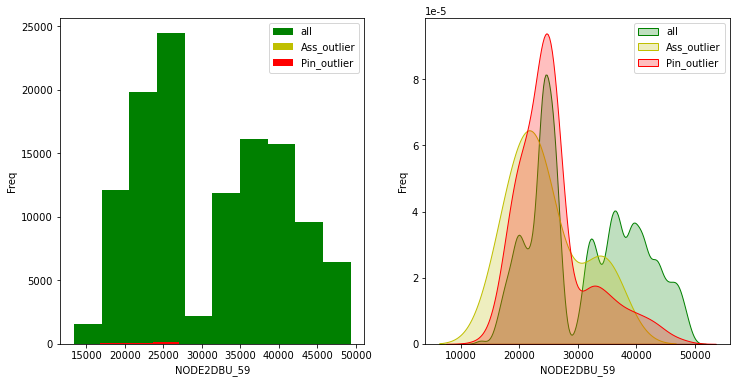

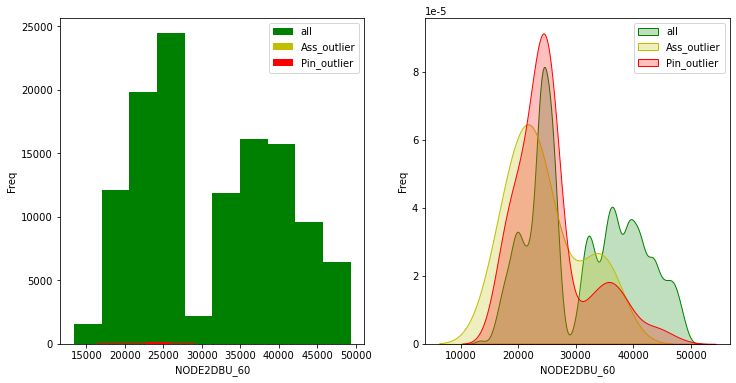

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


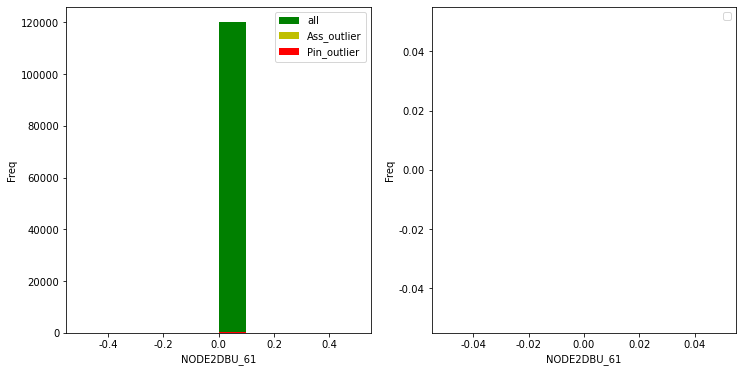

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


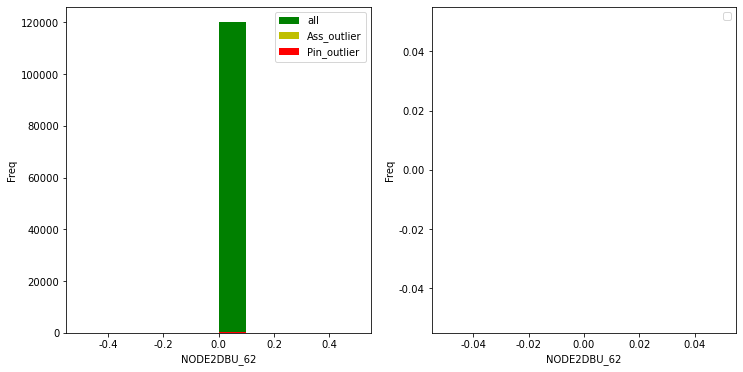

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


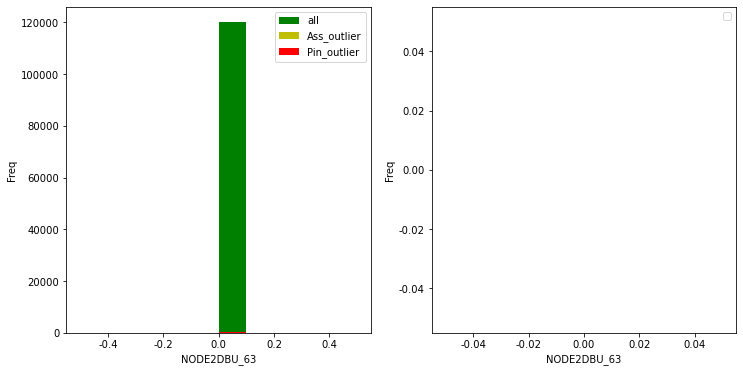

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


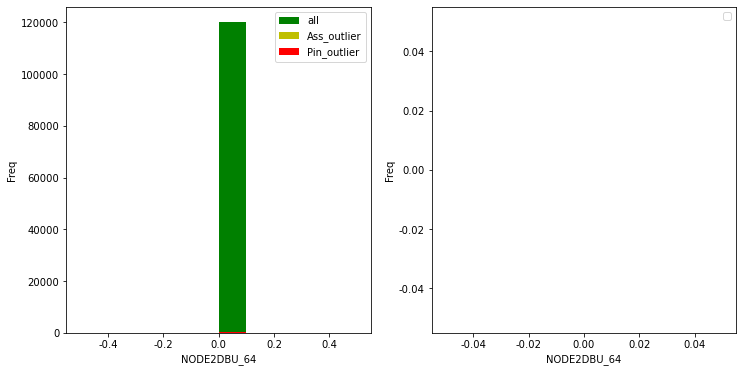

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


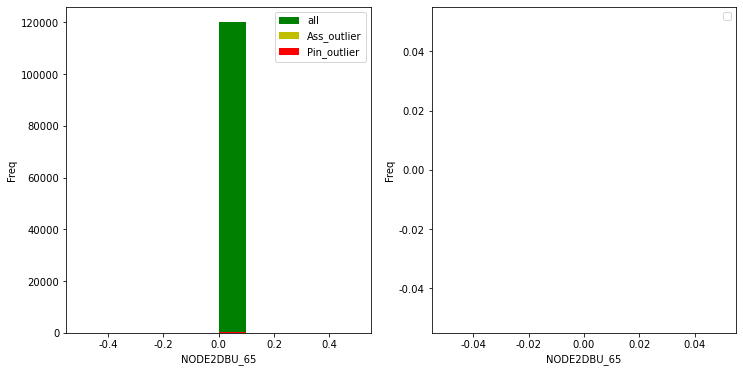

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


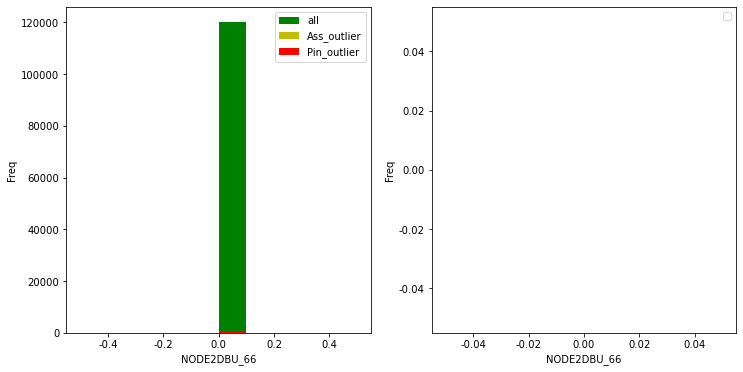

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


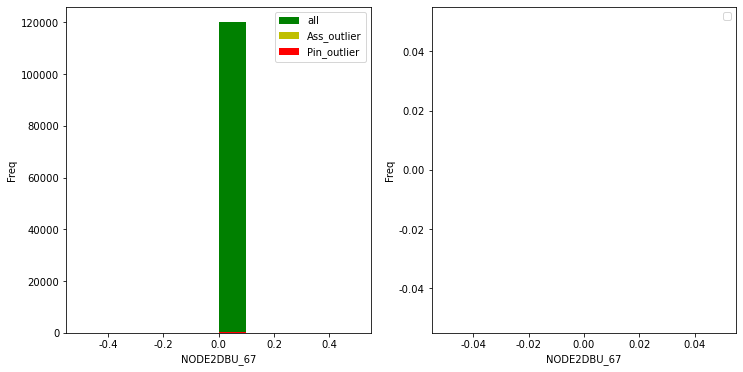

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


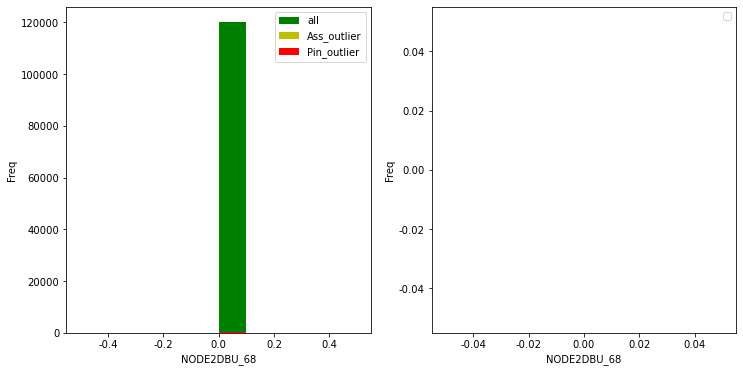

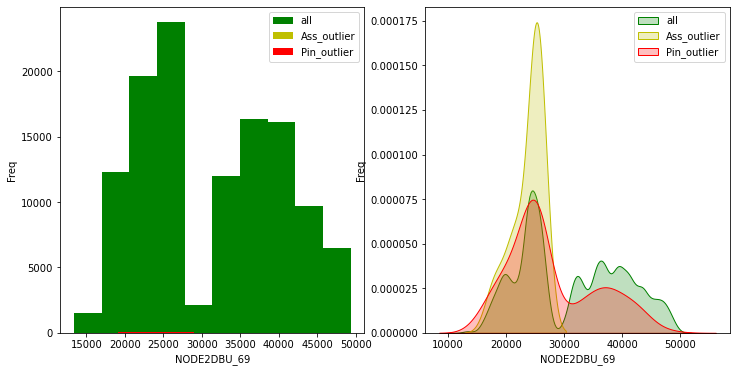

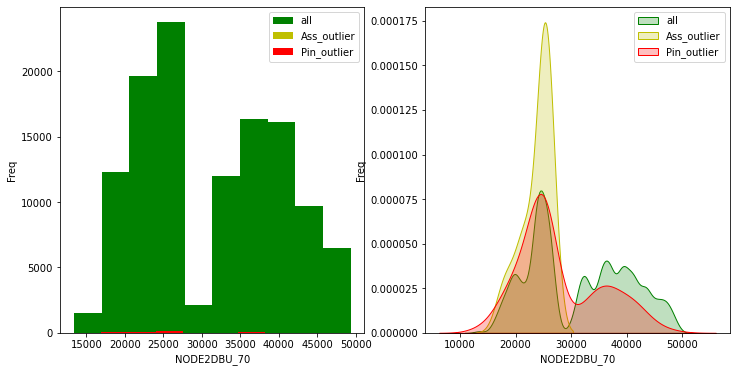

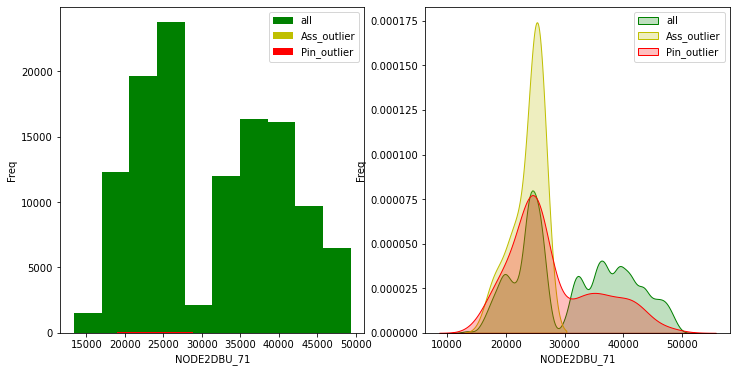

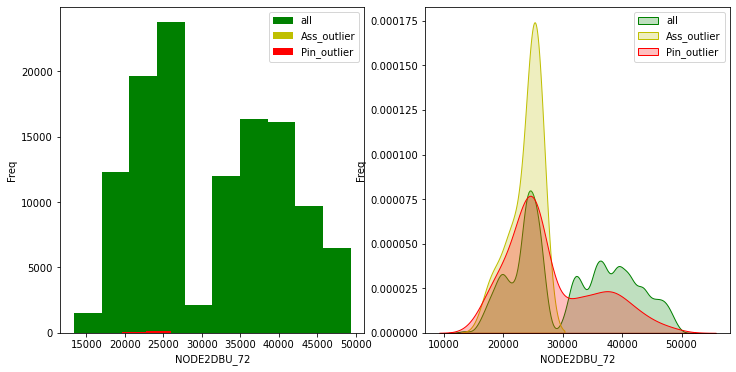

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


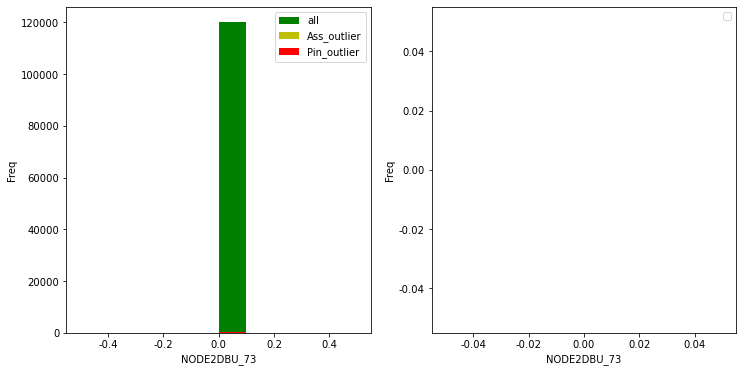

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


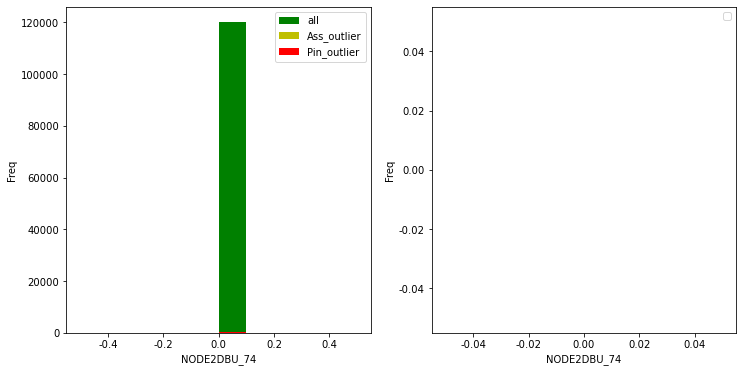

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


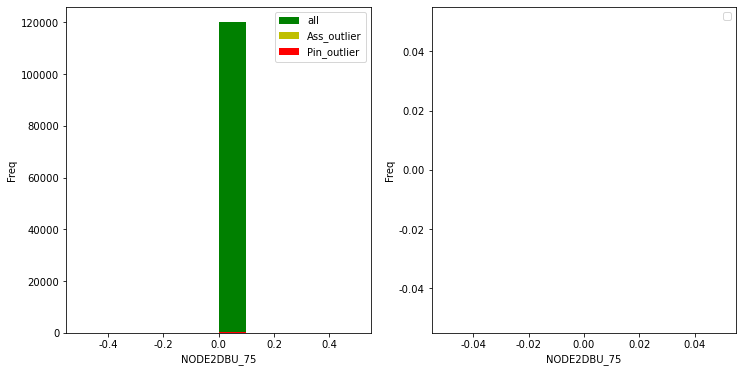

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


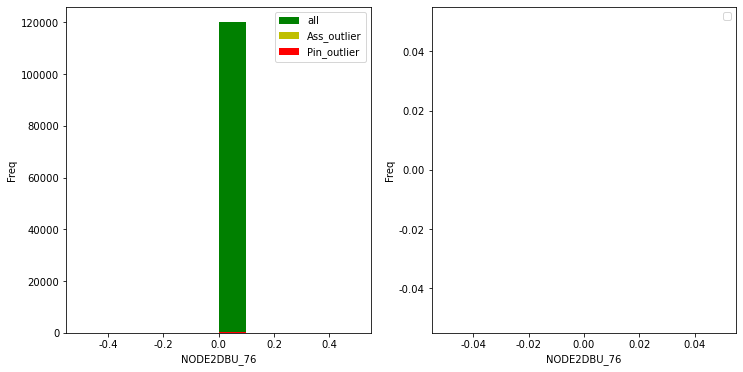

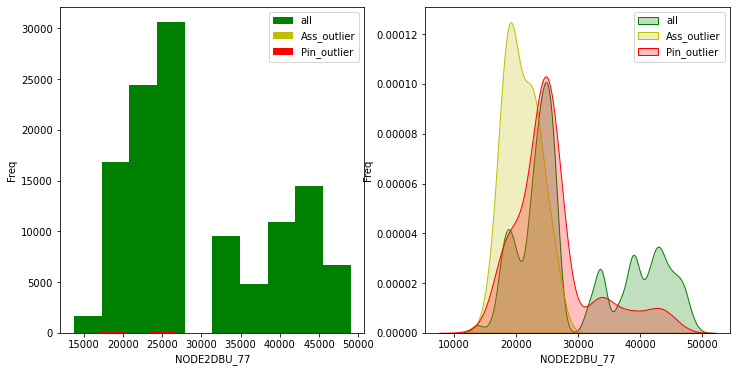

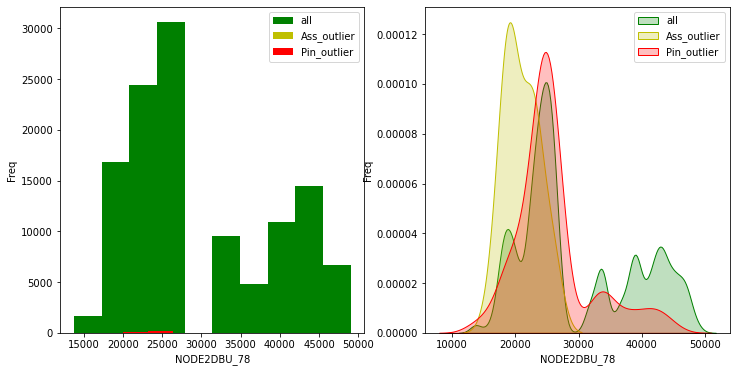

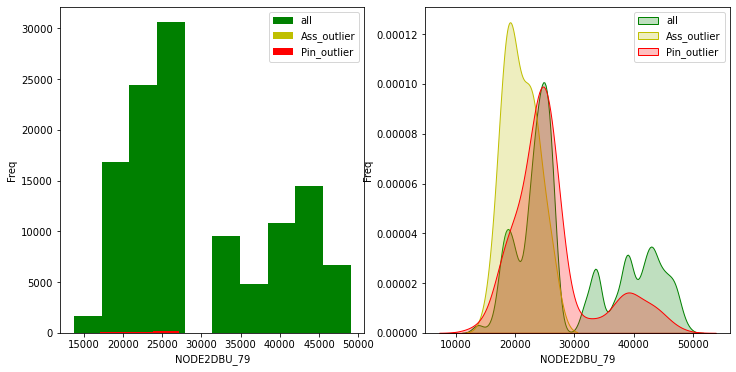

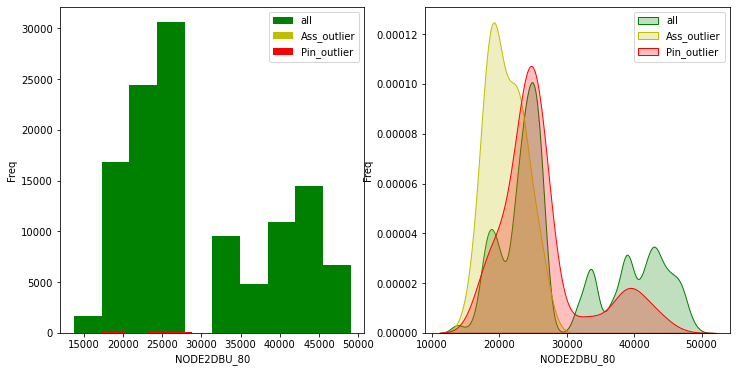

...

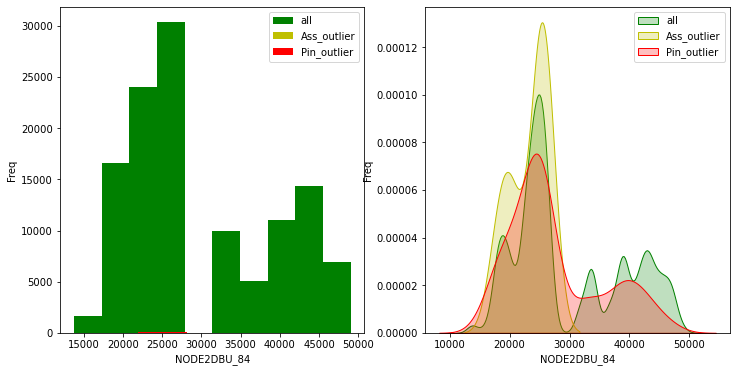

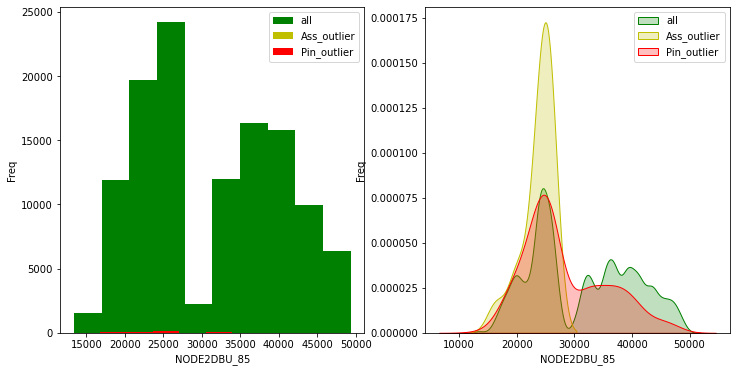

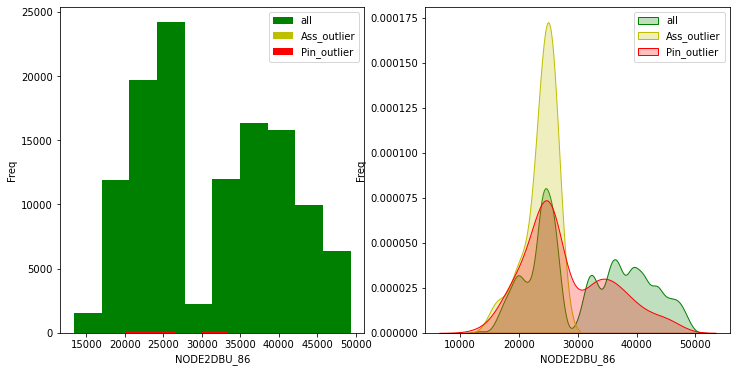

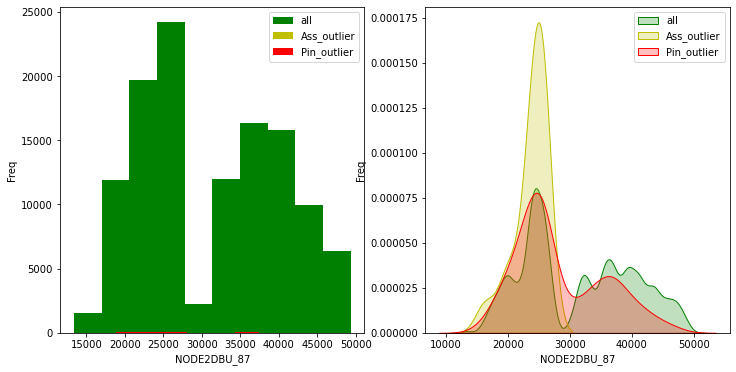

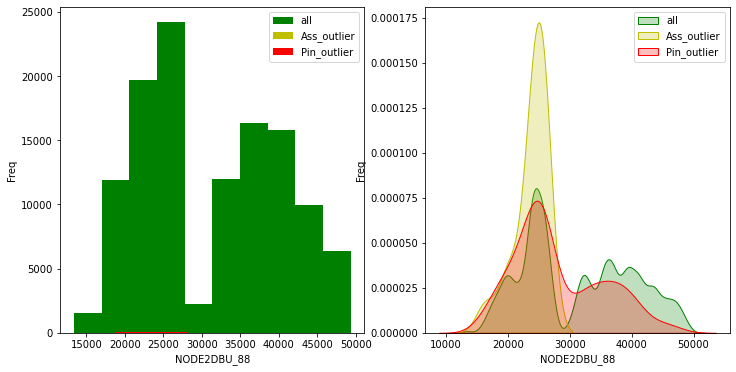

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


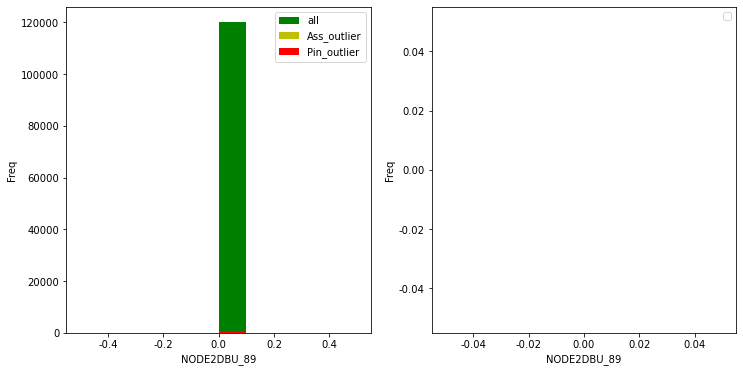

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


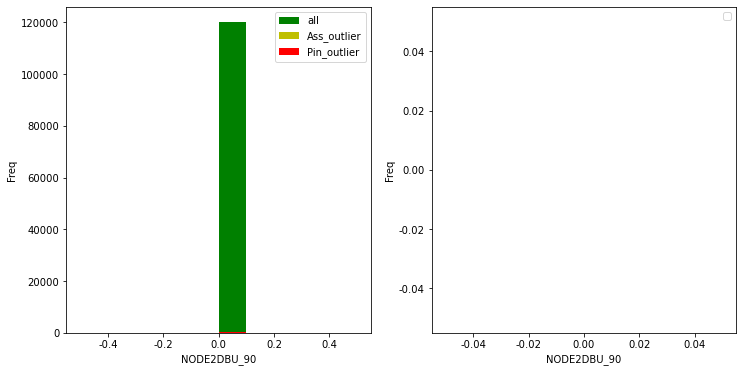

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


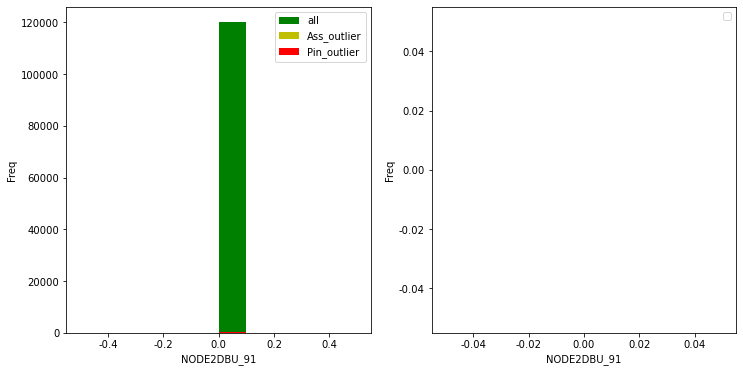

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


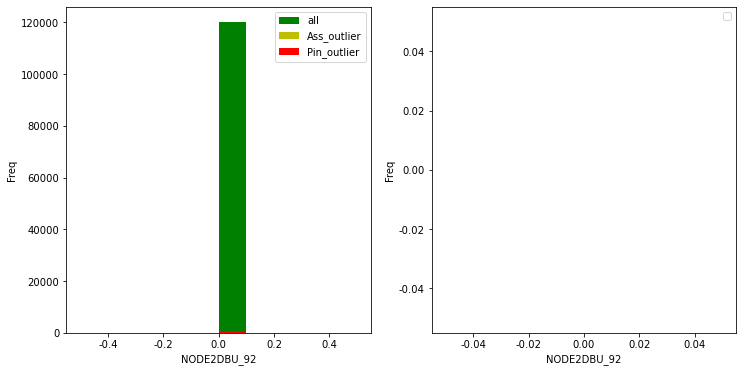

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


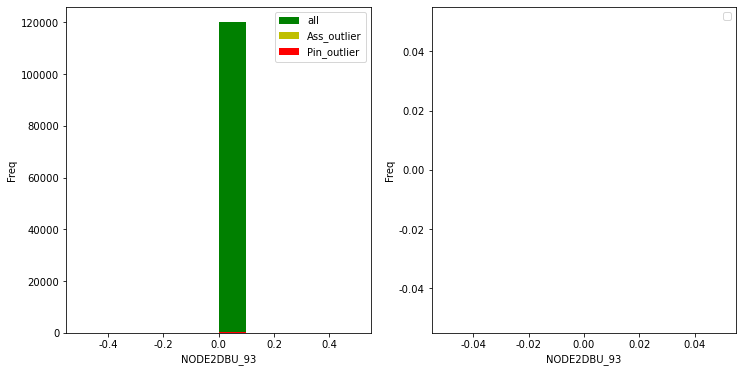

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


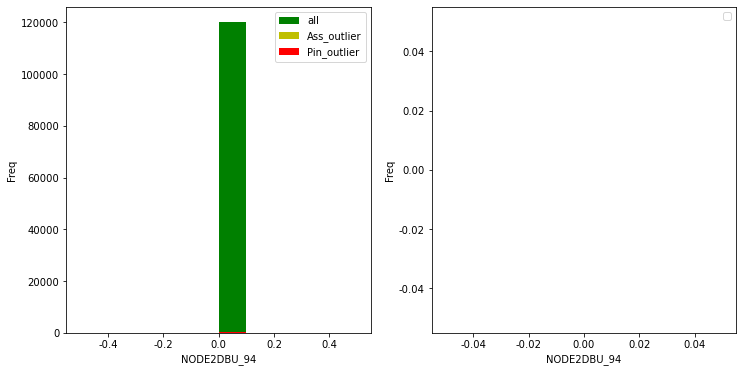

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


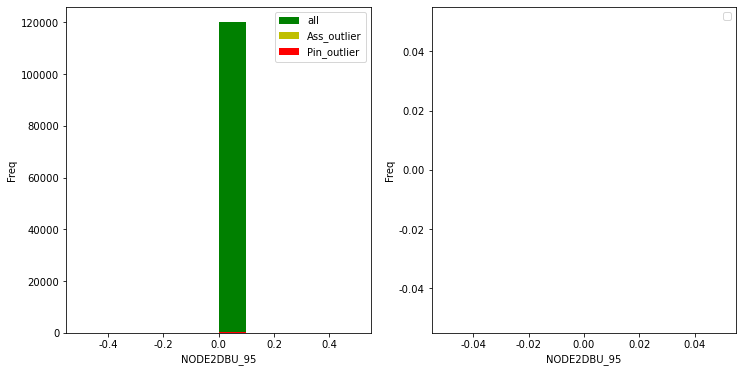

/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
/home/adt/anaconda3/envs/gpu_test/lib/python3.7/site-packages/seaborn/distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


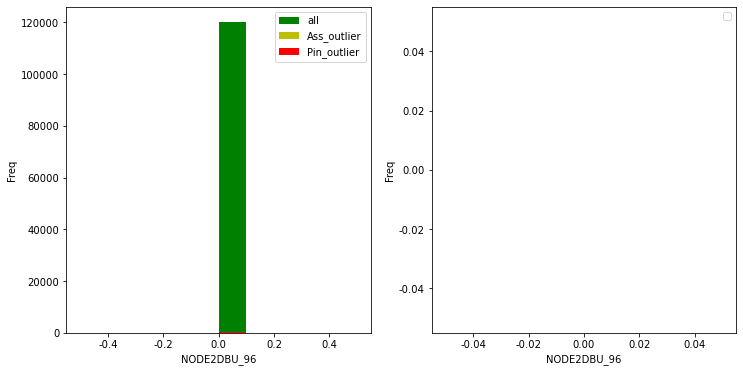

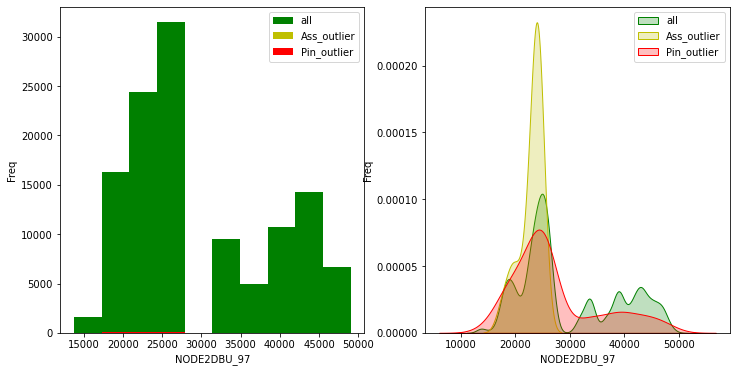

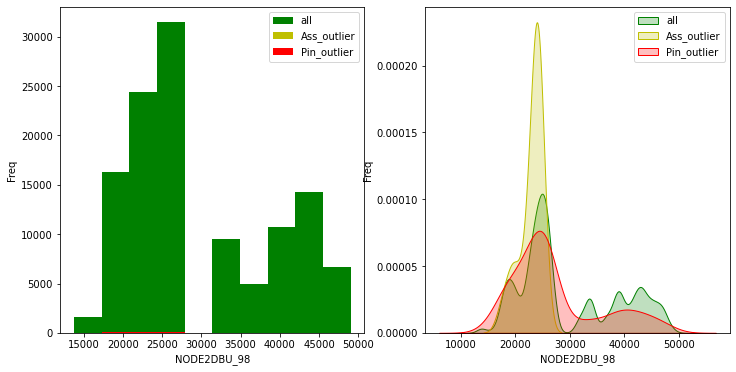

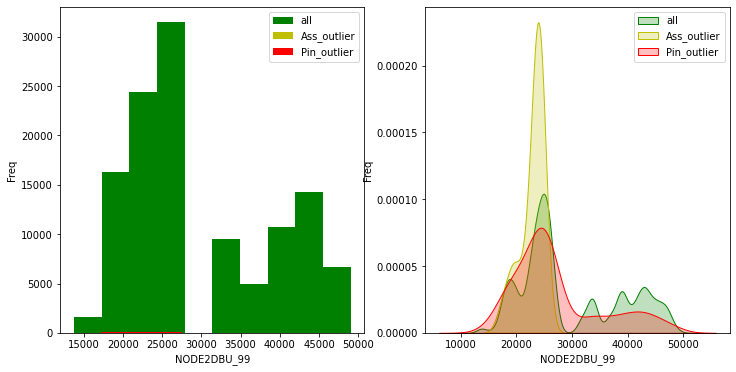

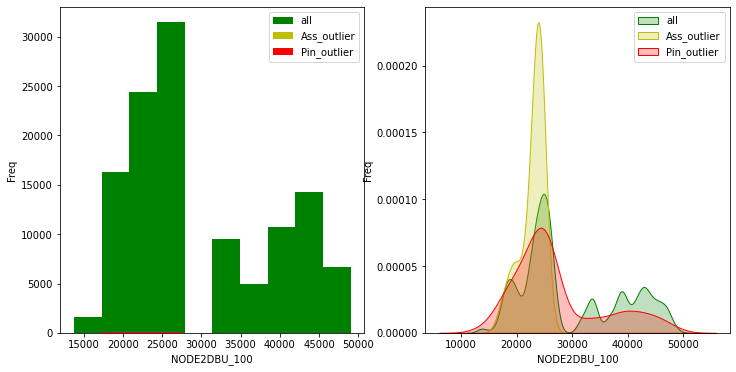

...

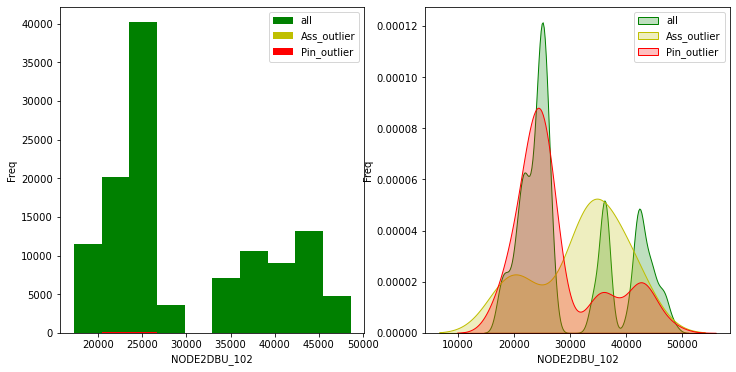

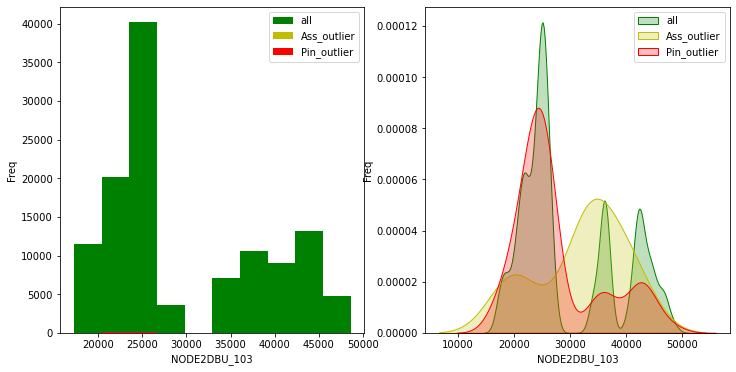

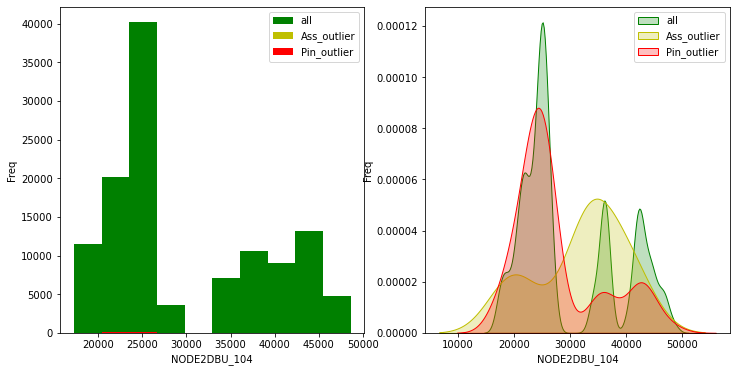

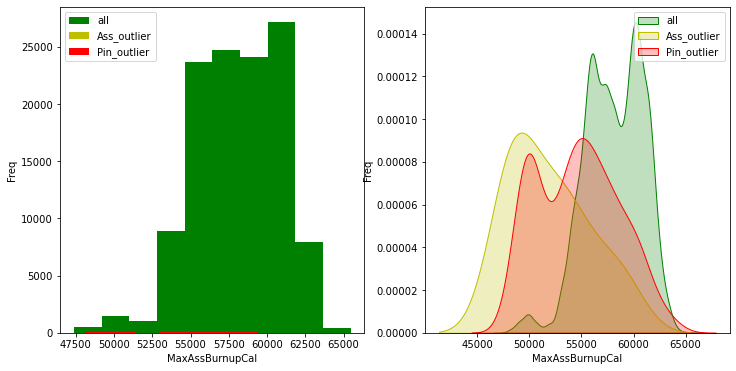

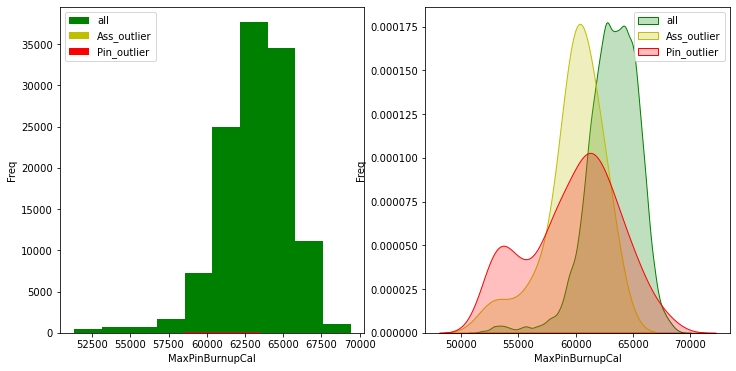

TypeError: '<' not supported between instances of 'pandas._libs.interval.Interval' and 'float'

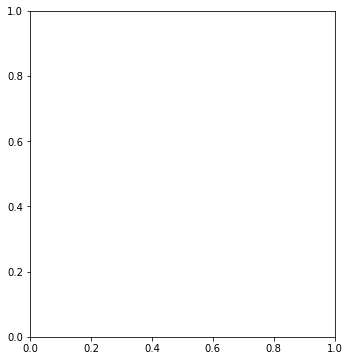

In [135]:
import seaborn as sns

for column in all_data.columns:

    plt.figure(figsize=(12,6))
    plt.subplot(1,2,1)
    plt.hist(pre_data[column], color='g')
    plt.hist(pre_data[pre_data.error_label==1][column], color='y')
    plt.hist(pre_data[pre_data.error_label==2][column], color='r')
    plt.xlabel(column)
    plt.ylabel('Freq')
    plt.legend(['all','Ass_outlier', 'Pin_outlier'])
    
    plt.subplot(1,2,2)
    sns.kdeplot(pre_data[column], shade=True, color='g')
    sns.kdeplot(pre_data[pre_data.error_label==1][column], shade=True, color='y')
    sns.kdeplot(pre_data[pre_data.error_label==2][column], shade=True, color='r')
    plt.xlabel(column)
    plt.ylabel('Freq')
    plt.legend(['all','Ass_outlier', 'Pin_outlier'])
    plt.show()